# Golden  Beetle Species Classifier Neural Network
## Authors: Vinicio Soto y Marcela Hernández
### CICIMA UCR

- Trains and tests a neural network for species classification.
- Works with L1050 data and fiber optics data
- Calculates the probability of a specimen being of a certain species.

In [1]:
import sys
import os
from pathlib import Path
import seaborn as sns
from sklearn.model_selection import train_test_split
# Get the current directory
current_directory = os.getcwd()
base_directory = Path(current_directory).parent
libraries_directory = base_directory/"libraries"
directories_in_path = [current_directory, base_directory, libraries_directory]

# Convert paths to strings and normalize for Windows
directories_in_path = [
    current_directory,
    str(base_directory),
    str(libraries_directory)
]

# Add directories to sys.path if not already present
for path in directories_in_path:
    path = os.path.normpath(path)  # Normalize path for Windows
    if path not in sys.path:
        sys.path.append(path)
        print(f"Added {path} to sys.path")


from spectraltools import Specimen_Collection, Spectrum, create_path_if_not_exists
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import os
import math
import re
import scipy
import socket #gets the machine name
import tensorflow as tf
from metrics import Metric, feature_and_label_extractor 
from metrics import (Gamma_First_Two_Peaks_Golden,
                    Gamma_Arbitrary_Limits_Golden, 
                    Gamma_Area_Under_Curve_Naive_Golden, 
                    Gamma_Area_Under_Curve_First_Min_Cut, 
                    Gamma_Vector_Relative_Reflectance,
                    Wavelength_Vector, 
                    Critical_Points_Golden, 
                    Metric_Testbench, 
                    Gamma_Gaussian_Fit, 
                    Gamma_First_Two_Peaks_Simple)
from feature_engineering import get_aggregated_data
import seaborn as sns
from visualizations import scatter_plot_2_variables, scatter_plot_3_variables
import warnings


Added C:\Users\esteb\escarabajos\gamma factor calculation and neural network training to sys.path
Added C:\Users\esteb\escarabajos to sys.path
Added C:\Users\esteb\escarabajos\libraries to sys.path


# Collection main paths

In [2]:
"""This section allows the user to choose their workplace location.
This is important if the user has multiple locations and operating systems in which this
script is run"""

# Training data is used when we are already certain of species and genera for a particular sample
training_data_is_used = True
debug = True

# Base folder 
base_folder = Path(base_directory)  # Same folder

# Define the location of the tables with information about the collections and its parent directory
collection_tables_main_path = base_folder / "collections"
l1050_collection_files_main_path = base_folder / "L1050_data"
fiber_optics_collection_files_main_path = base_folder / "avalight_spectrometer_data"

#Configuration file location

#configuration for collections
config_file_main_path = base_folder / "libraries" / "spectraltools"/ "spectral_config"

config_file_cicimaucr_l050_golden = config_file_main_path / "CICIMAUCR_L1050_GOLDEN.ini"
config_file_cicimaucr_l050_silver = config_file_main_path / "CICIMAUCR_L1050_SILVER.ini"
config_file_inbucr_avalight_silver = config_file_main_path / "INBUCR_AVALIGHT_SILVER.ini"
config_file_inbucr_l1050_golden = config_file_main_path / "INBUCR_L1050_GOLDEN.ini"
config_file_cicimaucr_avalight_silver = config_file_main_path / "CICIMAUCR_AVALIGHT_SILVER.ini"

#configuration for metrics
metric_configuration_file = base_folder / "libraries" / "metrics" / "spectral_config" / "metrics.ini"

# Define report location
report_location = base_folder / "reports" / "data_analysis"

# Define image counter generator
def yield_image_counter():
    for val in range(1, 100):
        yield val
image_counter = yield_image_counter()


### check existence of directories

In [3]:
from pathlib import Path

def check_paths_exist():
    # Define all paths in a dictionary for clarity
    paths = {
        "collection_tables_main_path": collection_tables_main_path,
        "l1050_collection_files_main_path": l1050_collection_files_main_path,
        "fiber_optics_collection_files_main_path": fiber_optics_collection_files_main_path,
        "config_file_main_path": config_file_main_path,
        "config_file_cicimaucr_l050_golden": config_file_cicimaucr_l050_golden,
        "config_file_cicimaucr_l050_silver": config_file_cicimaucr_l050_silver,
        "config_file_inbucr_avalight_silver": config_file_inbucr_avalight_silver,
        "config_file_inbucr_l1050_golden": config_file_inbucr_l1050_golden,
        "config_file_cicimaucr_avalight_silver": config_file_cicimaucr_avalight_silver,
        "metric_configuration_file": metric_configuration_file,
        "report_location": report_location,
    }

    print("\n=== Checking required paths ===")
    for name, path in paths.items():
        if path.is_dir():
            if path.exists():
                print(f"[OK] Directory exists: {name} -> {path}")
            else:
                print(f"[MISSING] Directory: {name} -> {path}")
        elif path.is_file():
            if path.exists():
                print(f"[OK] File exists: {name} -> {path}")
            else:
                print(f"[MISSING] File: {name} -> {path}")
        else:
            # If extension suggests file but doesn't exist yet, handle
            if path.suffix:
                print(f"[MISSING] Expected file: {name} -> {path}")
            else:
                print(f"[MISSING] Expected directory: {name} -> {path}")

# Run check
check_paths_exist()



=== Checking required paths ===
[OK] Directory exists: collection_tables_main_path -> C:\Users\esteb\escarabajos\collections
[OK] Directory exists: l1050_collection_files_main_path -> C:\Users\esteb\escarabajos\L1050_data
[OK] Directory exists: fiber_optics_collection_files_main_path -> C:\Users\esteb\escarabajos\avalight_spectrometer_data
[OK] Directory exists: config_file_main_path -> C:\Users\esteb\escarabajos\libraries\spectraltools\spectral_config
[OK] File exists: config_file_cicimaucr_l050_golden -> C:\Users\esteb\escarabajos\libraries\spectraltools\spectral_config\CICIMAUCR_L1050_GOLDEN.ini
[OK] File exists: config_file_cicimaucr_l050_silver -> C:\Users\esteb\escarabajos\libraries\spectraltools\spectral_config\CICIMAUCR_L1050_SILVER.ini
[OK] File exists: config_file_inbucr_avalight_silver -> C:\Users\esteb\escarabajos\libraries\spectraltools\spectral_config\INBUCR_AVALIGHT_SILVER.ini
[OK] File exists: config_file_inbucr_l1050_golden -> C:\Users\esteb\escarabajos\libraries\spec

## Spectrometer data main paths: L1050 data

In [4]:

# File location and metadata location for collection 1
l1050_angsol_collection_path = l1050_collection_files_main_path / "ANGSOL" / "average"
angsol_collection_metadata = collection_tables_main_path / "CICIMA-beetles-general-inventory - ANGSOL.txt"

# File location and metadata location for collection 2
l1050_cicimaucr_collection_path = l1050_collection_files_main_path / "TRA_data_CICIMA_INBUCR" / "CICIMAUCR" / "reflectance"
l1050_cicimaucr_collection_2_path = l1050_collection_files_main_path / "CICIMA-2024-01-REFLECTANCE" / "average"
l1050_cicimaucr_collection_3_path = l1050_collection_files_main_path / "CICIMA-2024-03-REFLECTANCE" / "without iris nor lens" / "average"
l1050_cicimaucr_collection_4_path = l1050_collection_files_main_path / "CICIMA-2024-05-REFLECTANCE" / "DORSAL" / "average" #elitros



cicima_ucr_metadata = collection_tables_main_path / "CICIMA-beetles-general-inventory - CICIMAUCR.txt"

# File location and metadata location for collection 3
l1050_inbucr_collection_path = l1050_collection_files_main_path / "INBUCR" / "average"
inbucr_metadata = collection_tables_main_path / "CICIMA-beetles-general-inventory - INBUCR.txt"

# File location and metadata location for collection 4
l1050_bioucr_collection_path = l1050_collection_files_main_path / "BIOUCR" / "average"
bioucr_metadata = collection_tables_main_path / "CICIMA-beetles-general-inventory - BIOUCR.txt"

# Aggregated data location, where averages and std will be saved when training data and retrieved when classifying spectra
agregated_data_location = base_folder / "aggregated_data"

## Spectrometer data main paths: Fiber optics data

In [5]:
fiber_optics_cicimaucr_collection_5_path = fiber_optics_collection_files_main_path / "ELITROS"/"CICIMAUCR" #Elitros
fiber_optics_inbucr_collection_2_path = fiber_optics_collection_files_main_path / "ELITROS"/ "INBUCR"       #Elitros
fiber_optics_cicimaucr_collection_6_path = fiber_optics_collection_files_main_path / "COMPLETOS" /"20250829" / "CICIMAUCR" #escarabajos completos

## Select collections for training and testing

In [6]:
#Set Specimen Collection objects

# Function to verify and print path
def verify_and_print_path(name, path):
    print(f"Input {name}: {path}")
    if not path.exists():
        print(f"Warning: Path does not exist: {path}")

# Create collections with debug output
print("Creating Specimen_Collection instances:")
verify_and_print_path("l1050_angsol_collection_path", l1050_angsol_collection_path)
verify_and_print_path("angsol_collection_metadata", angsol_collection_metadata)
angsol_collection = Specimen_Collection(
    name="ANGSOL",
    data_folder_path=l1050_angsol_collection_path,
    metadata_path=angsol_collection_metadata,
    quality="HIGH",
    config_file = config_file_cicimaucr_l050_golden,
)
angsol_collection.set_description(
    "ANGSOL collection has specimens that belong to Angel Solís. The confidence that we have about specimen identification is high."
)

verify_and_print_path("l1050_cicimaucr_collection_path", l1050_cicimaucr_collection_path)
verify_and_print_path("cicima_ucr_metadata", cicima_ucr_metadata)
l1050_cicimaucr_collection = Specimen_Collection(
    name="CICIMAUCR1",
    data_folder_path=l1050_cicimaucr_collection_path,
    metadata_path=cicima_ucr_metadata,
    quality="HIGH",
    config_file = config_file_cicimaucr_l050_golden,
)

verify_and_print_path("l1050_cicimaucr_collection_2_path", l1050_cicimaucr_collection_2_path)
l1050_cicimaucr_collection_2 = Specimen_Collection(
    name="CICIMAUCR2",
    data_folder_path=l1050_cicimaucr_collection_2_path,
    metadata_path=cicima_ucr_metadata,
    quality="HIGH",
    config_file = config_file_cicimaucr_l050_golden,
)

verify_and_print_path("l1050_cicimaucr_collection_3_path", l1050_cicimaucr_collection_3_path)
l1050_cicimaucr_collection_3 = Specimen_Collection(
    name="CICIMAUCR3",
    data_folder_path=l1050_cicimaucr_collection_3_path,
    metadata_path=cicima_ucr_metadata,
    quality="HIGH",
    config_file = config_file_cicimaucr_l050_golden,
)
#THIS
verify_and_print_path("fiber_optics_cicimaucr_collection_5_path", fiber_optics_cicimaucr_collection_5_path)
fiber_optics_cicimaucr_collection_5 = Specimen_Collection(
    name="CICIMAUCR5",
    data_folder_path=fiber_optics_cicimaucr_collection_5_path,
    metadata_path=cicima_ucr_metadata,
    quality="HIGH",
    config_file = config_file_cicimaucr_avalight_silver,
)
#THIS
verify_and_print_path("fiber_optics_cicimaucr_collection_6_path", fiber_optics_cicimaucr_collection_6_path)
fiber_optics_cicimaucr_collection_6 = Specimen_Collection(
    name="CICIMAUCR6",
    data_folder_path=fiber_optics_cicimaucr_collection_6_path,
    metadata_path=cicima_ucr_metadata,
    quality="HIGH",
    config_file = config_file_cicimaucr_avalight_silver,
)
#THIS
verify_and_print_path("fiber_optics_inbucr_collection_2_path", fiber_optics_inbucr_collection_2_path)
fiber_optics_inbucr_collection_2 = Specimen_Collection(
    name="INBUCR2",
    data_folder_path=fiber_optics_inbucr_collection_2_path,
    metadata_path=inbucr_metadata,
    quality="HIGH",
    config_file = config_file_inbucr_avalight_silver,
)

verify_and_print_path("l1050_inbucr_collection_path", l1050_inbucr_collection_path)
verify_and_print_path("inbucr_metadata", inbucr_metadata)
l1050_inbucr_collection = Specimen_Collection(
    name="INBUCR",
    data_folder_path=l1050_inbucr_collection_path,
    metadata_path=inbucr_metadata,
    quality="MID",
    config_file = config_file_inbucr_l1050_golden,
)

verify_and_print_path("l1050_bioucr_collection_path", l1050_bioucr_collection_path)
verify_and_print_path("bioucr_metadata", bioucr_metadata)
l1050_bioucr_collection = Specimen_Collection(
    name="BIOUCR",
    data_folder_path=l1050_bioucr_collection_path,
    metadata_path=bioucr_metadata,
    quality="LOW",
    config_file = config_file_inbucr_l1050_golden, #todo create config file
)

training_collection_list = [
                    #angsol_collection,
                    #l1050_cicimaucr_collection, #DORADOS
                    #l1050_cicimaucr_collection_2, #DORADOS
                    #l1050_cicimaucr_collection_3, #DORADOS
                    #fiber_optics_cicimaucr_collection_5,#ELITROS MIXTOS
                    #fiber_optics_inbucr_collection_2,#ELITROS MIXTOS
                    fiber_optics_cicimaucr_collection_6,# COMPLETOS PLATEADOS
                    l1050_inbucr_collection, #
                    #l1050_bioucr_collection, #

    
                    ]
collection_names_set = set([collection.name for collection in training_collection_list])
collection_names = " ".join( sorted(collection_names_set))

prediction_collection_list = [
                    angsol_collection,
                    #l1050_cicimaucr_collection,
                    #l1050_cicimaucr_collection_2,
                    #l1050_cicimaucr_collection_3,
                    #fiber_optics_cicimaucr_collection_5, #ELITROS MIXTOS
                    #fiber_optics_inbucr_collection_2,    #ELITROS MIXTOS
                    #fiber_optics_cicimaucr_collection_6,  #COMPLETOS PLATEADOS
                    l1050_inbucr_collection,
                    l1050_bioucr_collection,
                    ]
prediction_collection_names_set = set([collection.name for collection in training_collection_list])
prediction_collection_names = " ".join( sorted(collection_names_set))


Creating Specimen_Collection instances:
Input l1050_angsol_collection_path: C:\Users\esteb\escarabajos\L1050_data\ANGSOL\average
Input angsol_collection_metadata: C:\Users\esteb\escarabajos\collections\CICIMA-beetles-general-inventory - ANGSOL.txt
Input l1050_cicimaucr_collection_path: C:\Users\esteb\escarabajos\L1050_data\TRA_data_CICIMA_INBUCR\CICIMAUCR\reflectance
Input cicima_ucr_metadata: C:\Users\esteb\escarabajos\collections\CICIMA-beetles-general-inventory - CICIMAUCR.txt
Input l1050_cicimaucr_collection_2_path: C:\Users\esteb\escarabajos\L1050_data\CICIMA-2024-01-REFLECTANCE\average
Input l1050_cicimaucr_collection_3_path: C:\Users\esteb\escarabajos\L1050_data\CICIMA-2024-03-REFLECTANCE\without iris nor lens\average
Input fiber_optics_cicimaucr_collection_5_path: C:\Users\esteb\escarabajos\avalight_spectrometer_data\ELITROS\CICIMAUCR
Input fiber_optics_cicimaucr_collection_6_path: C:\Users\esteb\escarabajos\avalight_spectrometer_data\COMPLETOS\20250829\CICIMAUCR
Input fiber_op

## Set Spectrum class parameters
# These parameters help calculate maxima and minima, set the range of valid wavelengths, distance between valid peaks.

## Filter spectra
#### Filters to only the target species


In [7]:
#helpers

def get_filtered_spectra(collection_list, debug):

    all_spectra = []
    
    for collection in collection_list:
        if debug:
            print("collection:", collection)
        all_spectra += collection.get_spectra()
        if debug:
            print("all_spectra", len(all_spectra))
            print("species", set([item.get_species() for item in all_spectra]))
            for spectrum in all_spectra:
                print(f"{spectrum.get_code()} {spectrum.get_genus()} {spectrum.get_species()}")
    filtered_spectra_by_species = [item for item in all_spectra if item.get_species() in target_species]
    return filtered_spectra_by_species

### Training Data and Test Data

In [8]:
debug = False
target_species = ["kalinini", "resplendens", "cupreomarginata"]

get_test_spectra_from_training_data = True



if get_test_spectra_from_training_data:
    # Get all spectra
    complete_spectra = get_filtered_spectra(training_collection_list, debug=debug)
    print(f"Total spectra: {len(complete_spectra)}")

    # Split 80% train, 20% test
    train_spectra, test_spectra = train_test_split(
        complete_spectra,
        test_size=0.2,        # 20% test
        random_state=42,      # for reproducibility
        shuffle=True          # shuffle before splitting
    )

    print(f"Train spectra: {len(train_spectra)}")
    print(f"Test spectra: {len(test_spectra)}")
    
#train_spectra = get_filtered_spectra(training_collection_list, debug= debug)
#test_spectra  = get_filtered_spectra(prediction_collection_list, debug= debug) 

print("# of collections used in training: ", len(training_collection_list), "# of collections used in prediction: ", len(prediction_collection_list) )
print("# of spectra used in training: ", len(train_spectra), "# of spectra used in prediction: ", len(test_spectra) )
#date

from datetime import datetime
current_date = datetime.now().date()

    


print("Number of valid spectra: ", len(train_spectra))
if debug:
    for spectrum in train_spectra:
        print(spectrum.get_species())

Utils: No genus data for BIOUCRA1 in collection CICIMAUCR3
No species data for BIOUCRA1 in collection CICIMAUCR3
Utils: No genus data for Sample2198 in collection CICIMAUCR3
No species data for Sample2198 in collection CICIMAUCR3


C:\Users\esteb\escarabajos\libraries\spectraltools\utils.py:729: UserWarning: Failed to parse slit PMT aperture from input: 3350/2 860,8/2. Missing slit_pmt.
  warnings.warn(f"Failed to parse slit PMT aperture from input: {str}. Missing slit_pmt.", UserWarning)
C:\Users\esteb\escarabajos\libraries\spectraltools\utils.py:729: UserWarning: Failed to parse slit PMT aperture from input: 3350/2 860,8/2. Missing slit_pmt.
  warnings.warn(f"Failed to parse slit PMT aperture from input: {str}. Missing slit_pmt.", UserWarning)
C:\Users\esteb\escarabajos\libraries\spectraltools\utils.py:729: UserWarning: Failed to parse slit PMT aperture from input: 3350/2 860,8/2. Missing slit_pmt.
  warnings.warn(f"Failed to parse slit PMT aperture from input: {str}. Missing slit_pmt.", UserWarning)


Total spectra: 33
Train spectra: 26
Test spectra: 7
# of collections used in training:  4 # of collections used in prediction:  3
# of spectra used in training:  26 # of spectra used in prediction:  7
Number of valid spectra:  26


## Feature extraction
### This section will create, for each metric, a list with three sublists:
- code (Useful to retrieve additional information in the future, according to research needs)
- metric values (Values for that particular metric)
- species (labels used in training the neural network for species classification)
information will be used in feature engineering, metric and statistics

#### Gamma First Two Peaks

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

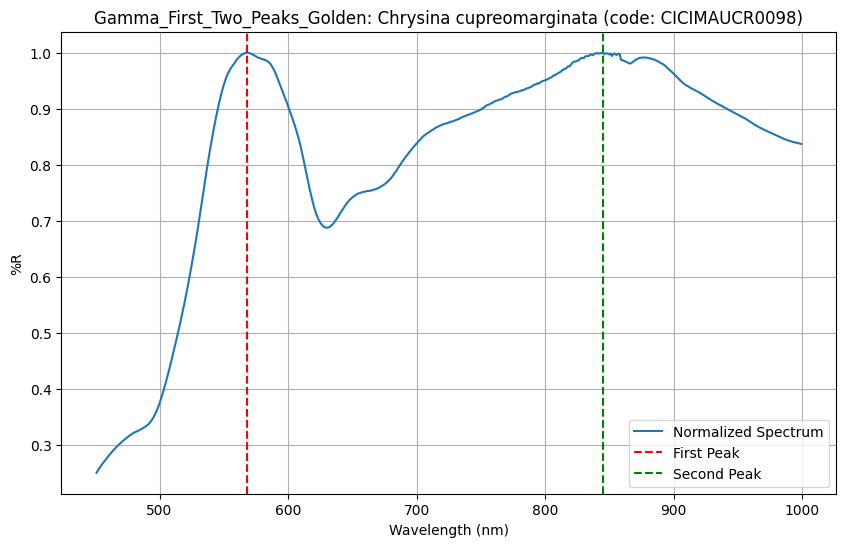

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

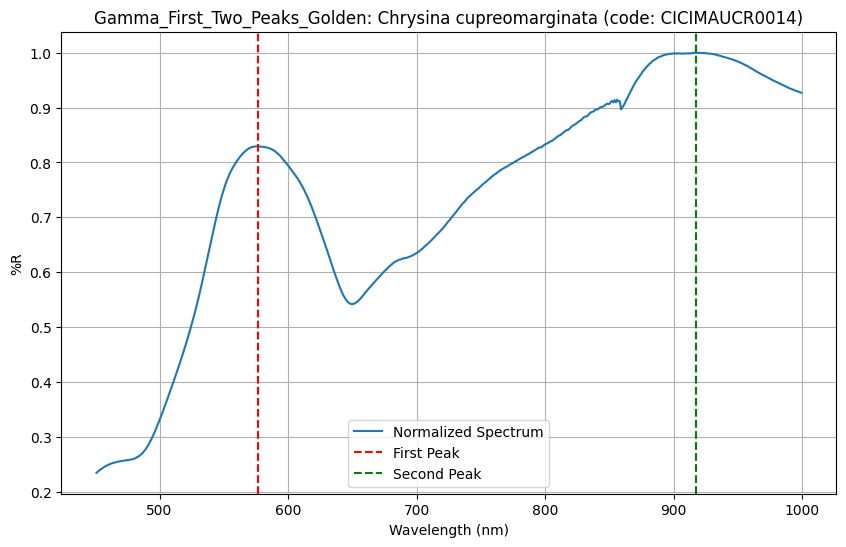

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

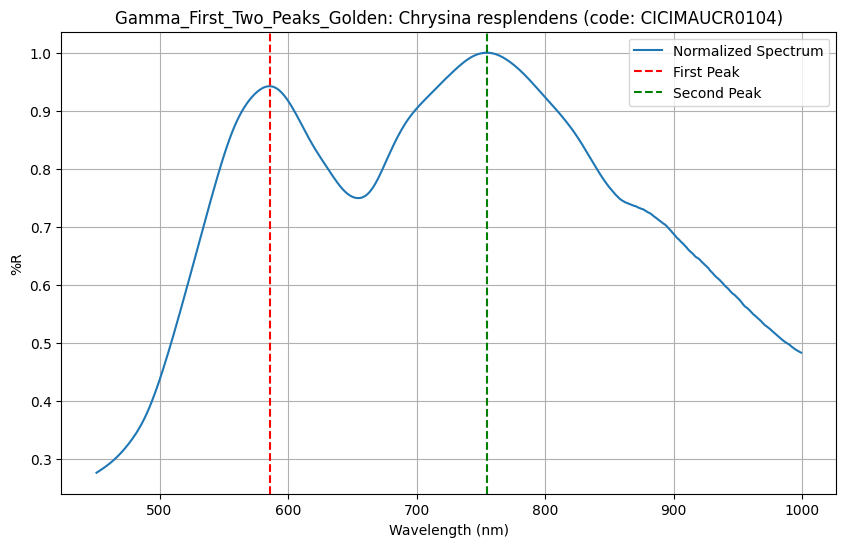

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

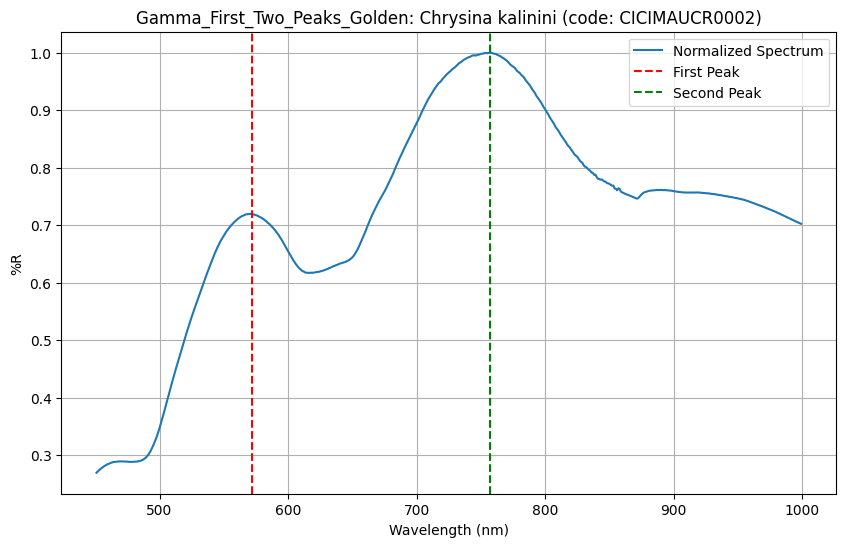

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

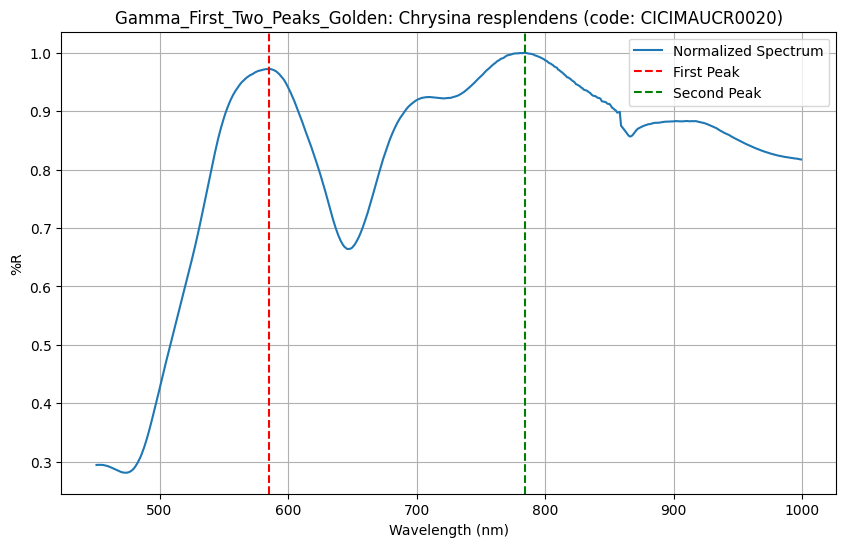

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

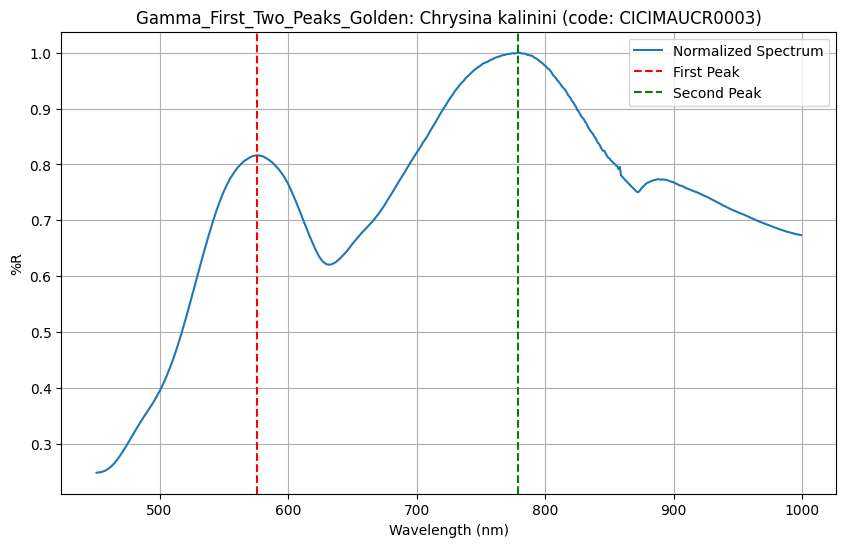

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

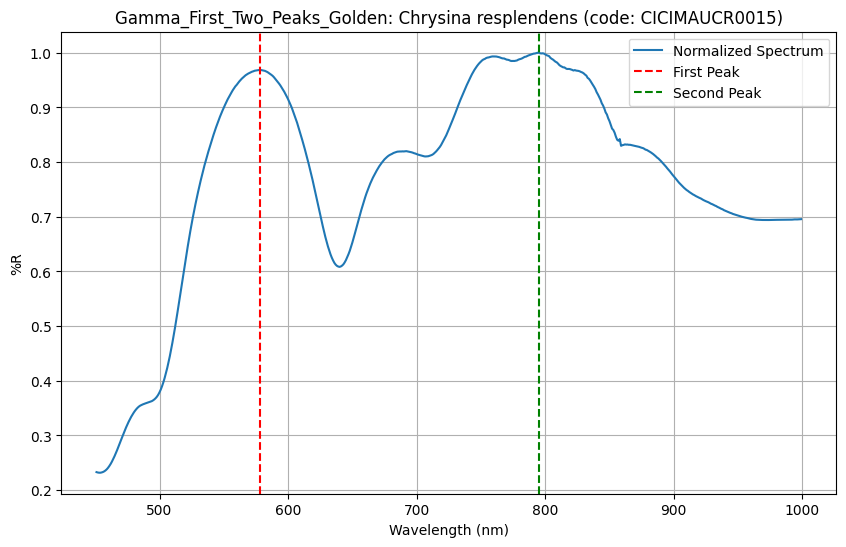

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

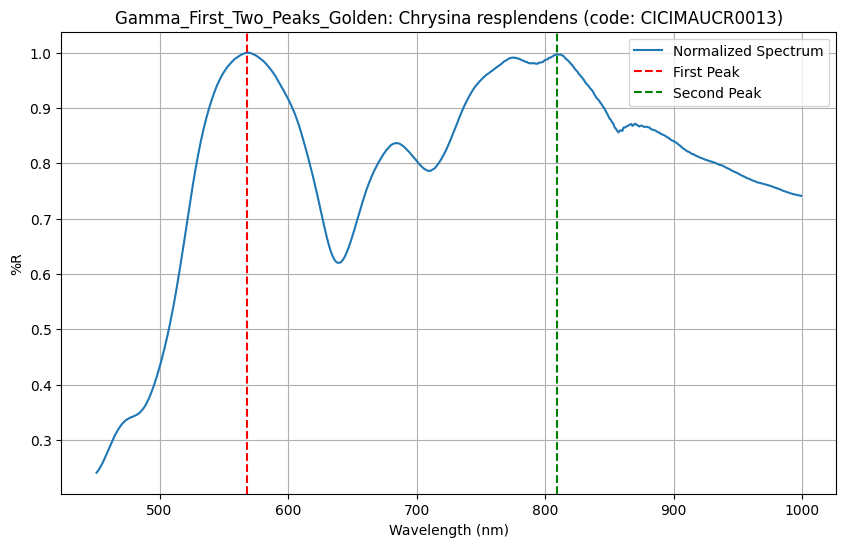

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

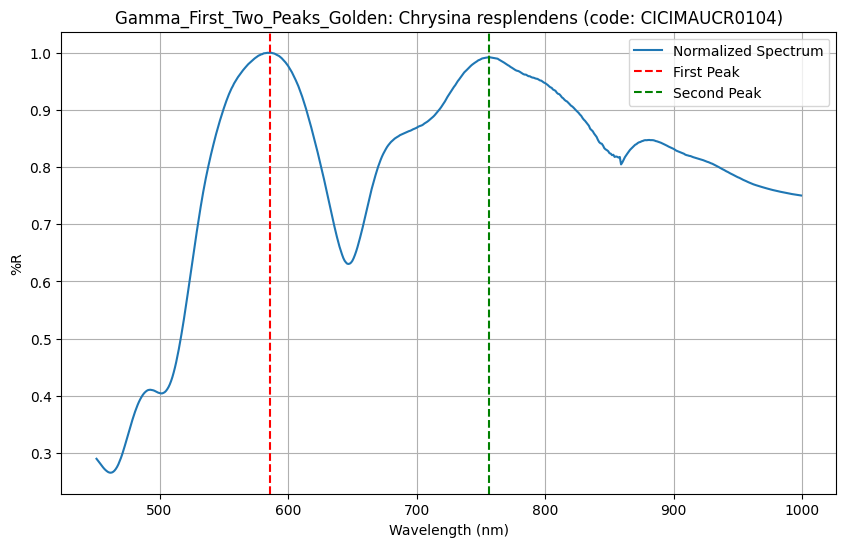

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

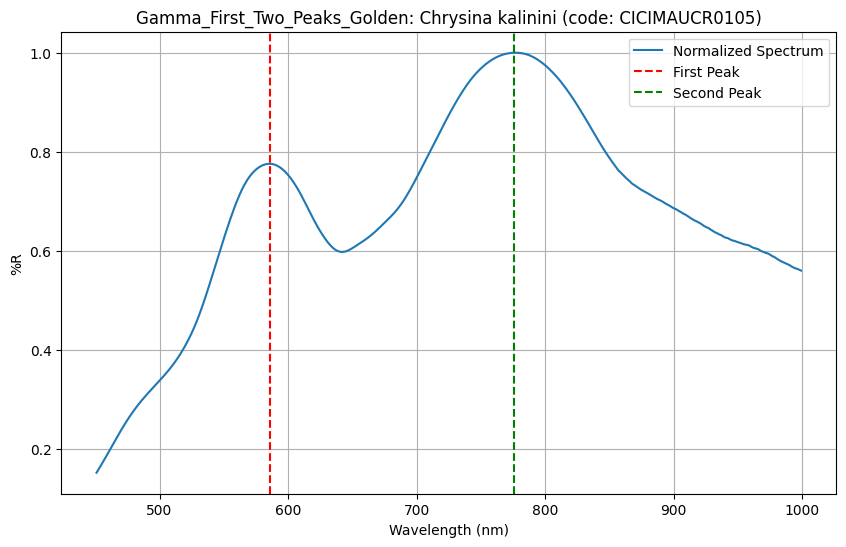

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

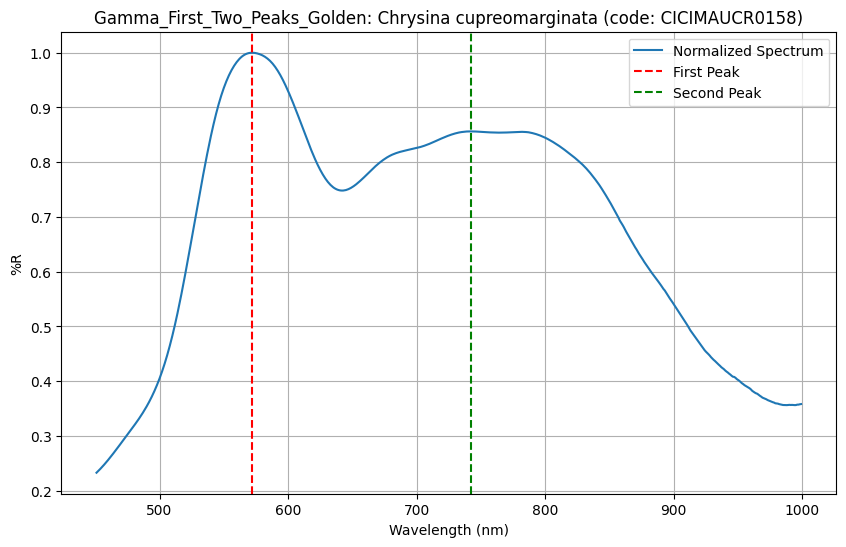

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

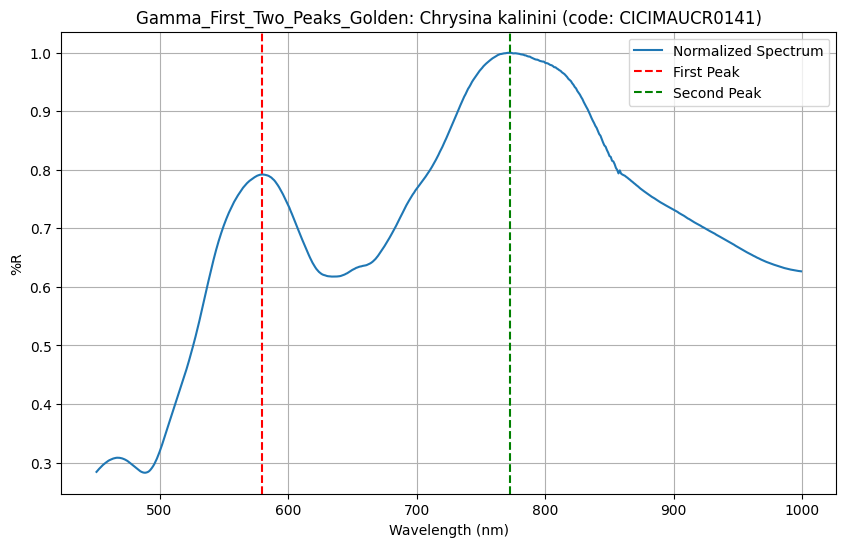

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

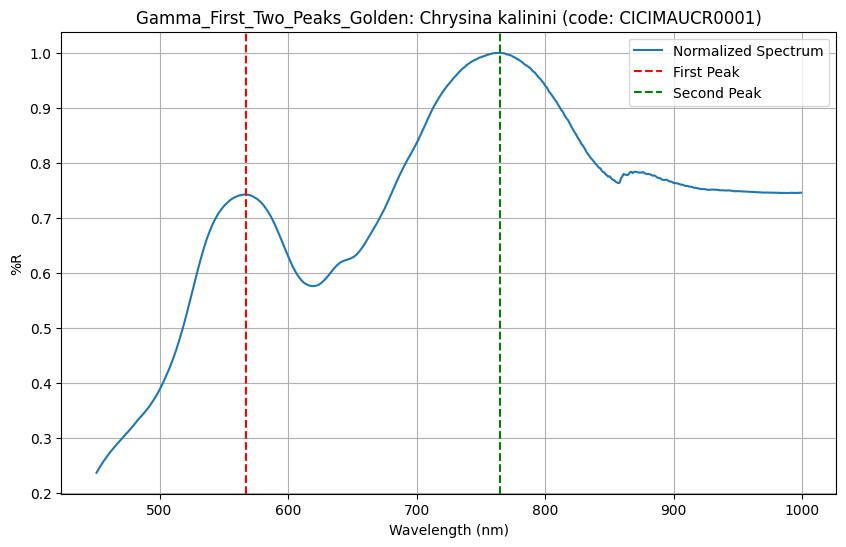

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

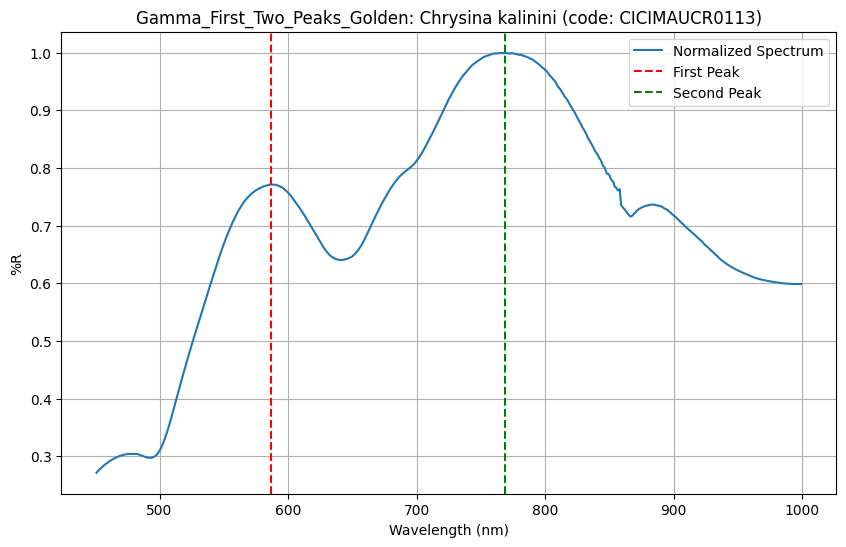

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

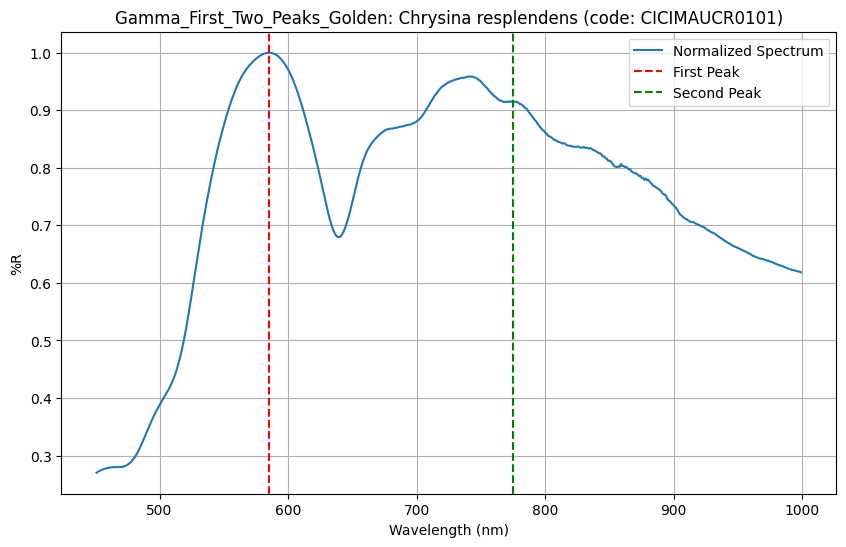

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

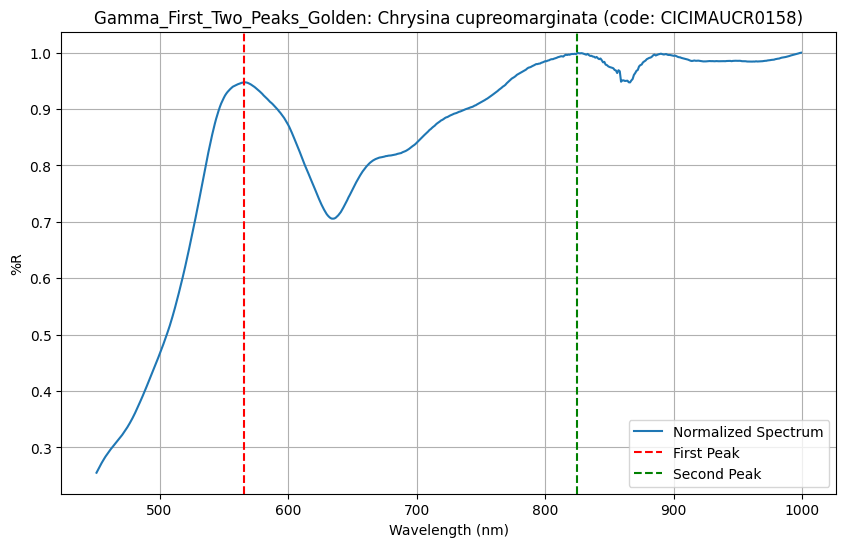

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

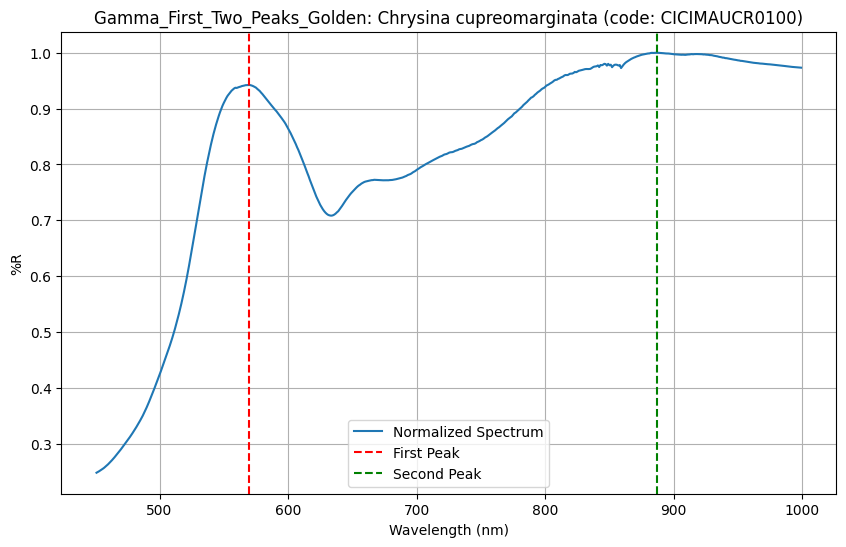

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

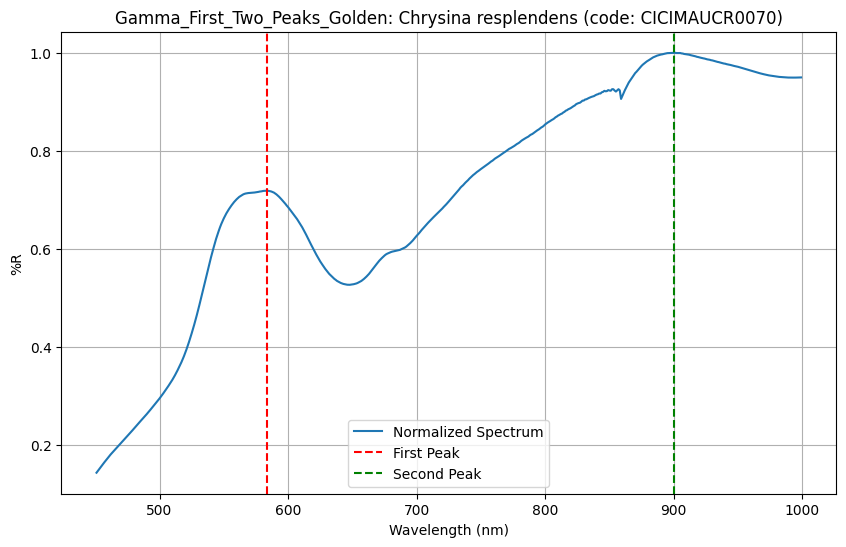

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

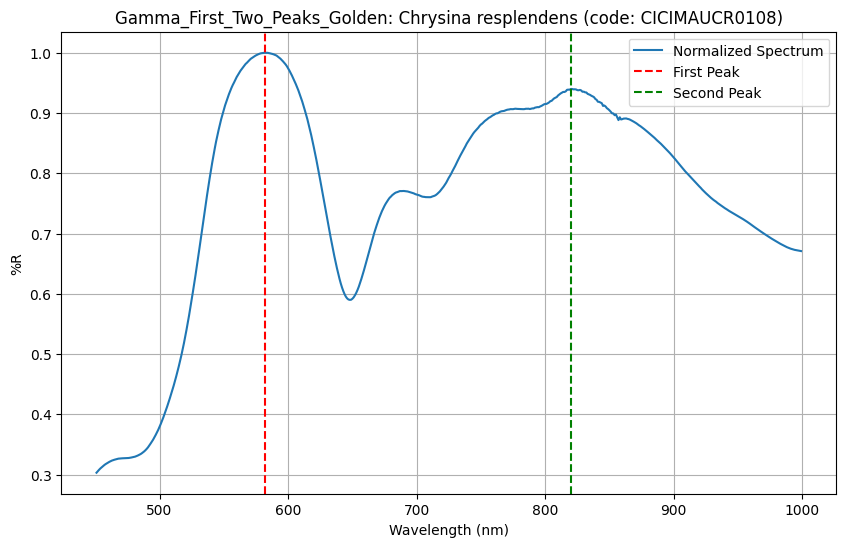

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

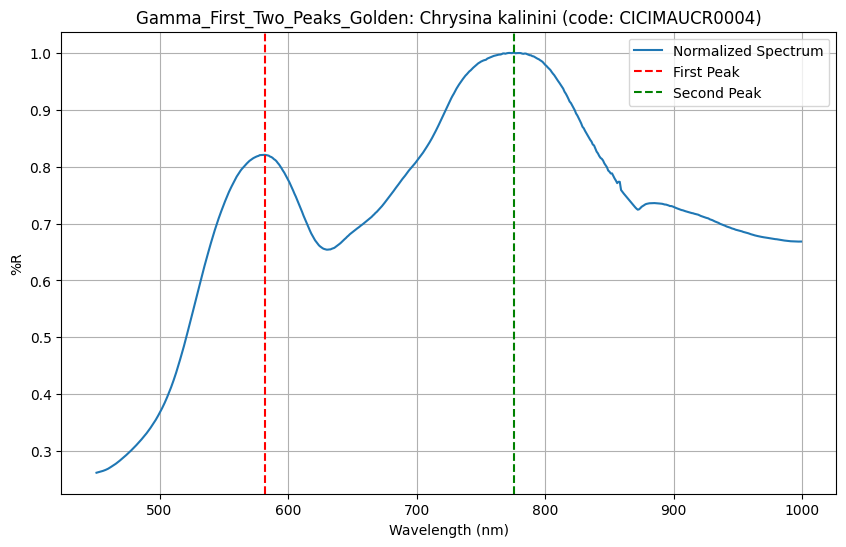

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

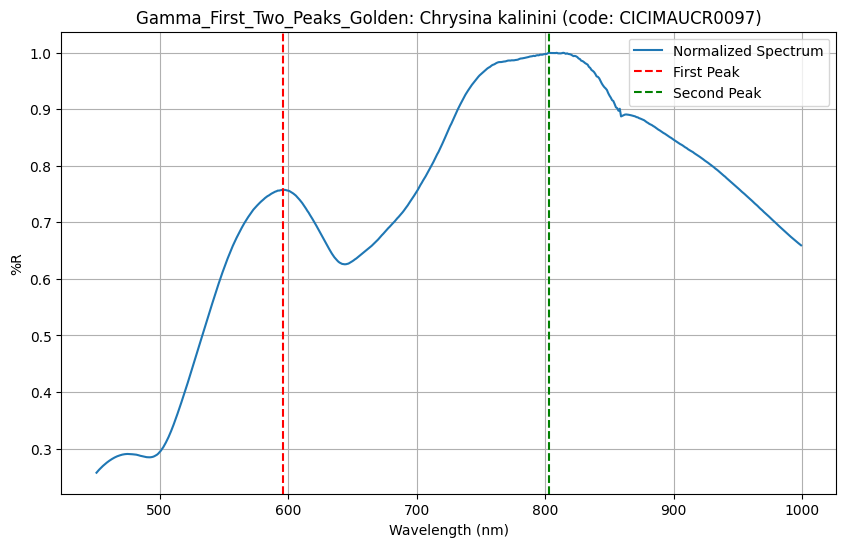

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

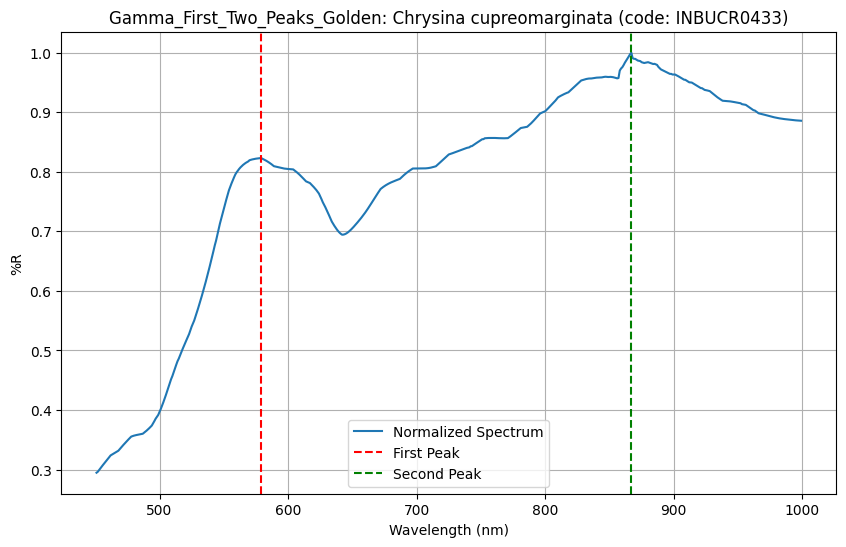

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

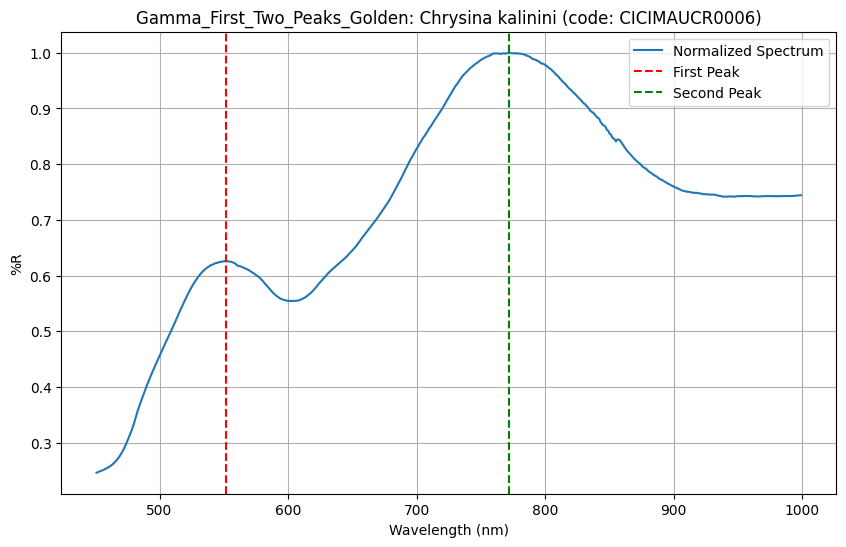

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

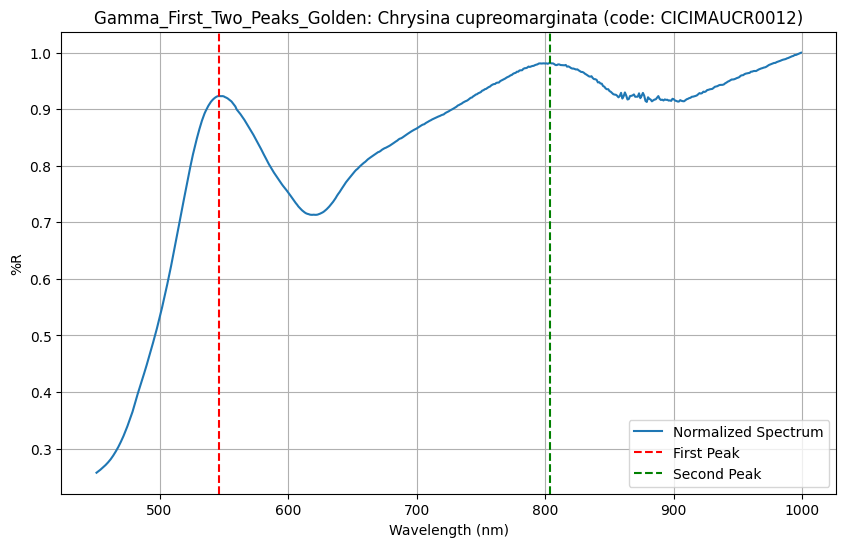

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

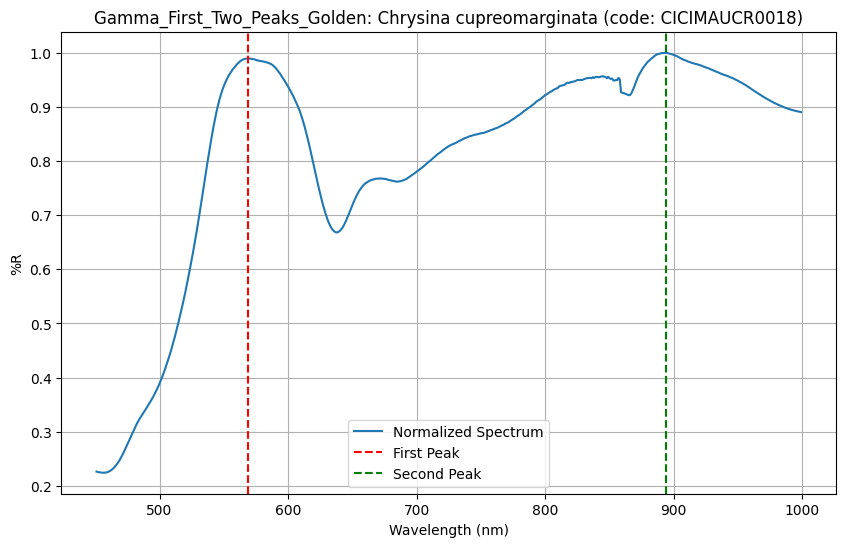

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

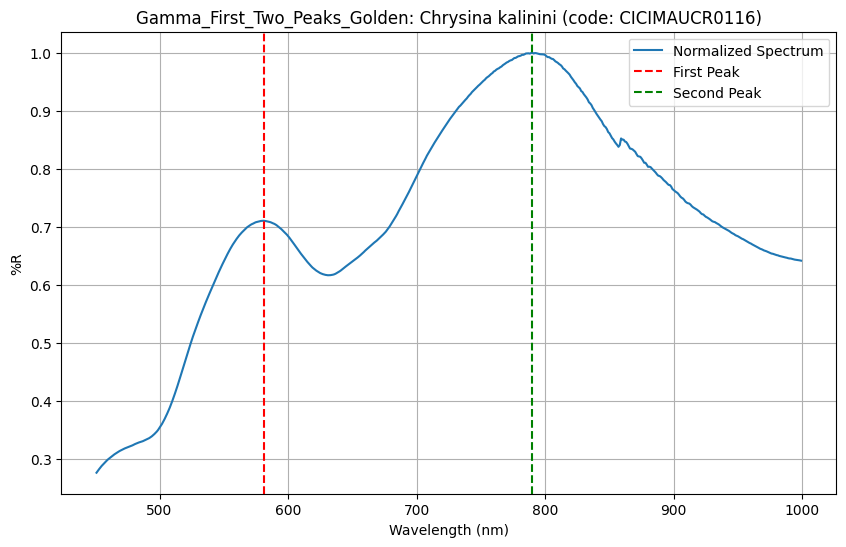

[['CICIMAUCR0098', 'CICIMAUCR0014', 'CICIMAUCR0104', 'CICIMAUCR0002', 'CICIMAUCR0020', 'CICIMAUCR0003', 'CICIMAUCR0015', 'CICIMAUCR0013', 'CICIMAUCR0104', 'CICIMAUCR0105', 'CICIMAUCR0158', 'CICIMAUCR0141', 'CICIMAUCR0001', 'CICIMAUCR0113', 'CICIMAUCR0101', 'CICIMAUCR0158', 'CICIMAUCR0100', 'CICIMAUCR0070', 'CICIMAUCR0108', 'CICIMAUCR0004', 'CICIMAUCR0097', 'INBUCR0433', 'CICIMAUCR0006', 'CICIMAUCR0012', 'CICIMAUCR0018', 'CICIMAUCR0116'], [np.float64(0.9997946715741182), np.float64(1.2058207872110318), np.float64(1.061263556672878), np.float64(1.3894857926038329), np.float64(1.0285942589874786), np.float64(1.2251516694200988), np.float64(1.0325354216782034), np.float64(0.9971201326836476), np.float64(0.9920349559910941), np.float64(1.2894620099264786), np.float64(0.856289595722265), np.float64(1.2624276598192257), np.float64(1.3470690683438888), np.float64(1.2963532867380805), np.float64(0.9158003516333134), np.float64(1.0547216580625591), np.float64(1.061321002683337), np.float64(1.390

In [9]:
gamma_first_two_peaks_data = feature_and_label_extractor(Metric = Gamma_First_Two_Peaks_Golden, 
                                                          config_file = metric_configuration_file, 
                                                          spectra =  train_spectra, 
                                                          debug = debug,
                                                          collection_list = training_collection_list)

print(gamma_first_two_peaks_data)

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

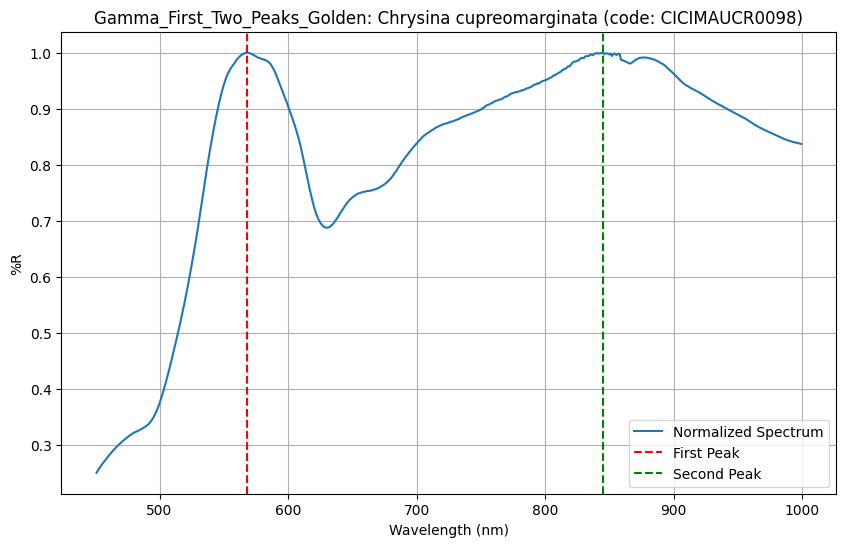

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

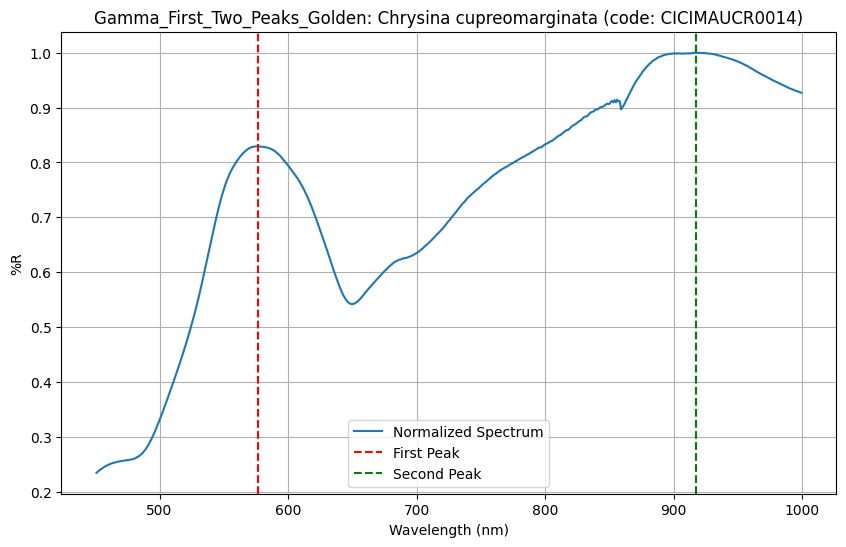

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

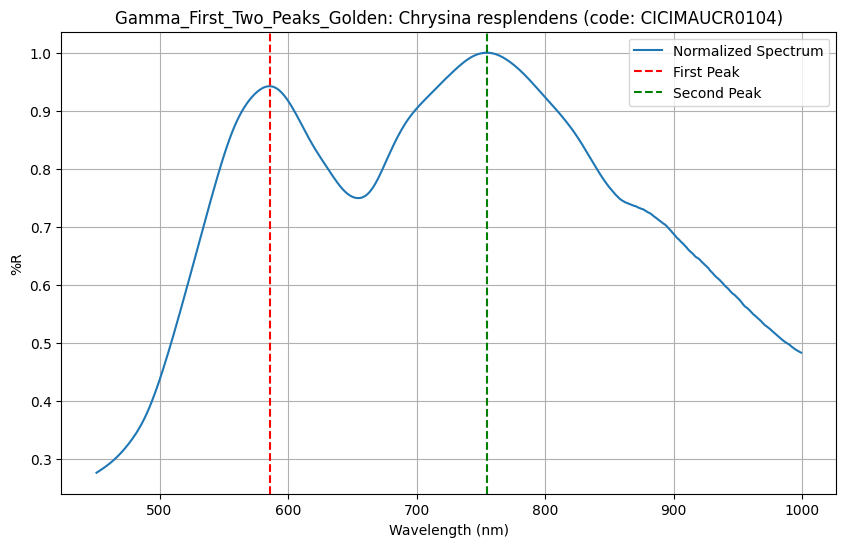

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

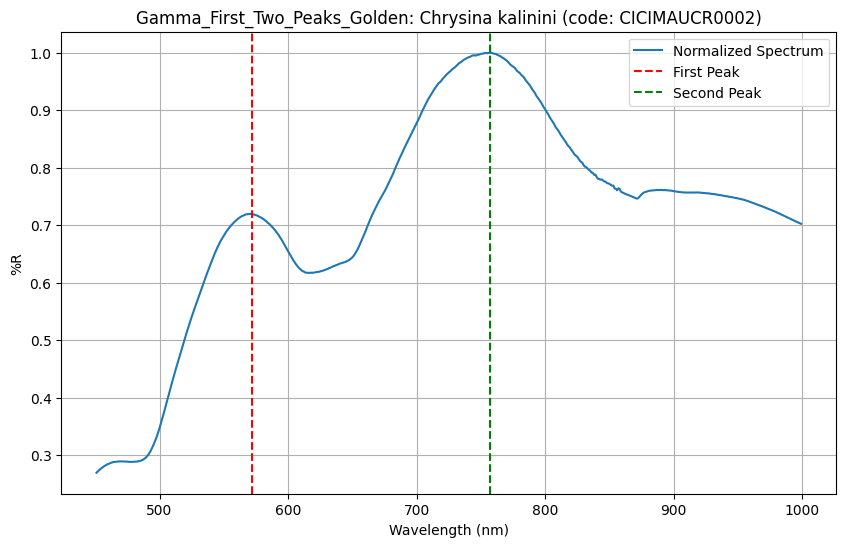

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

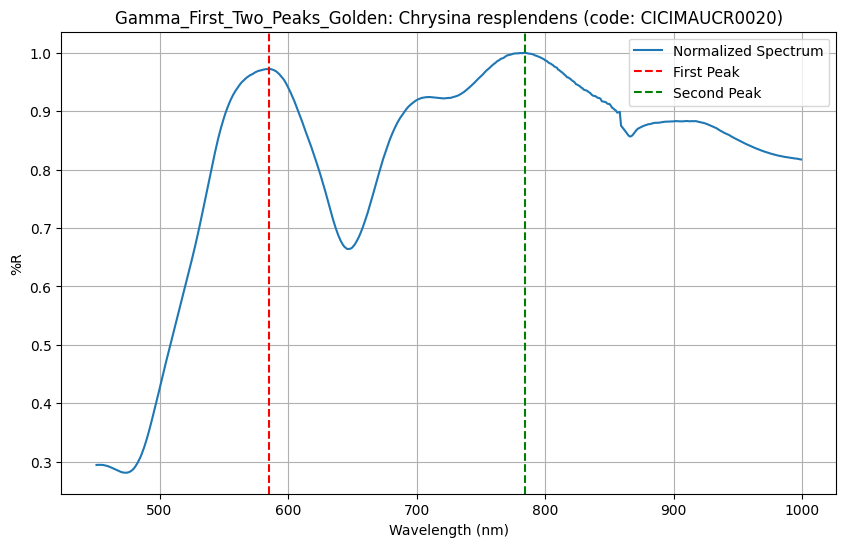

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

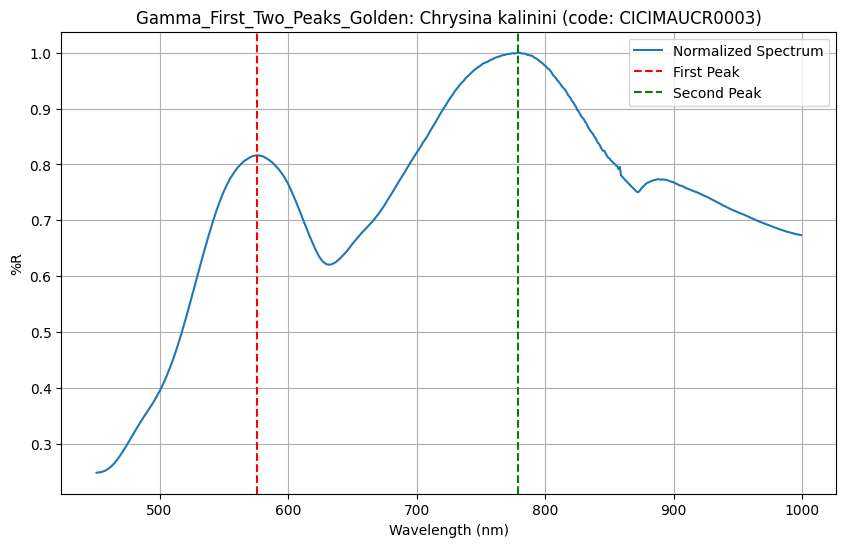

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

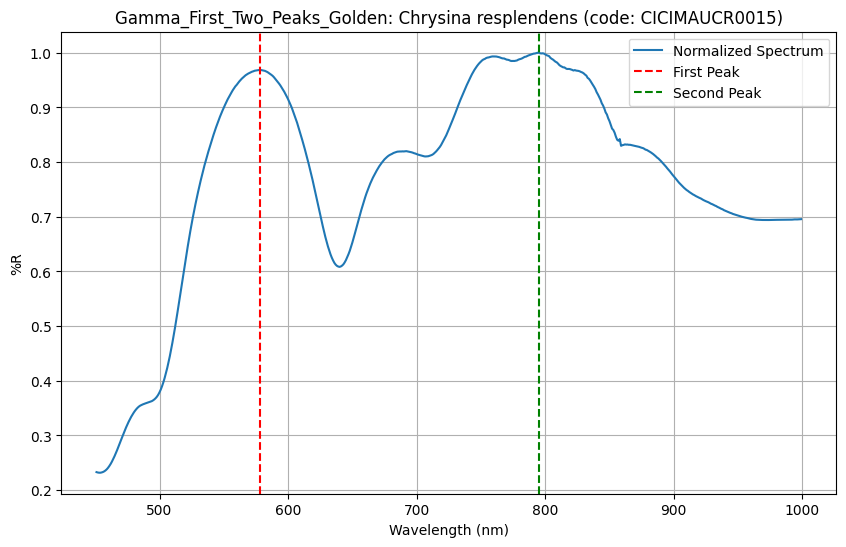

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

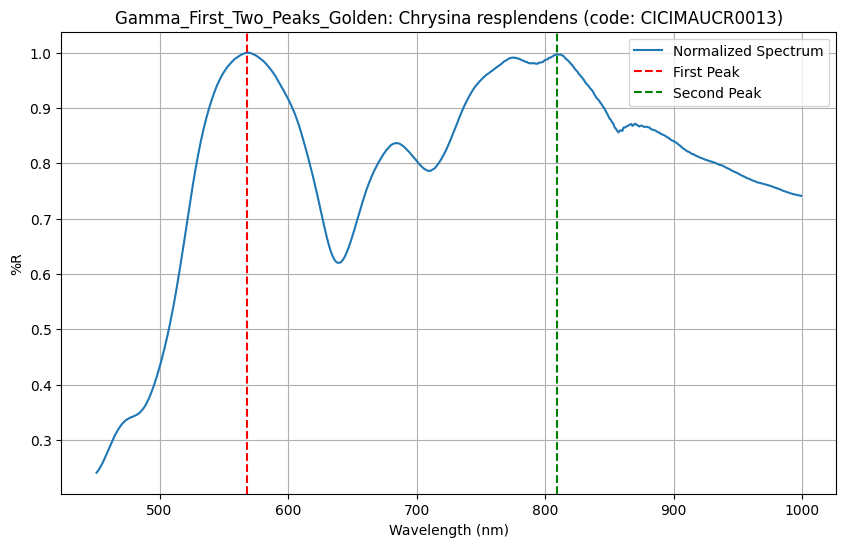

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

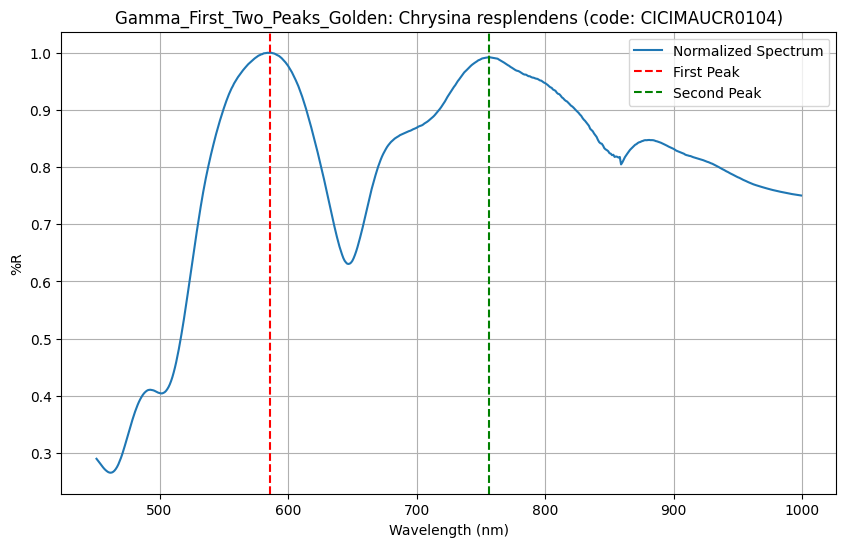

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

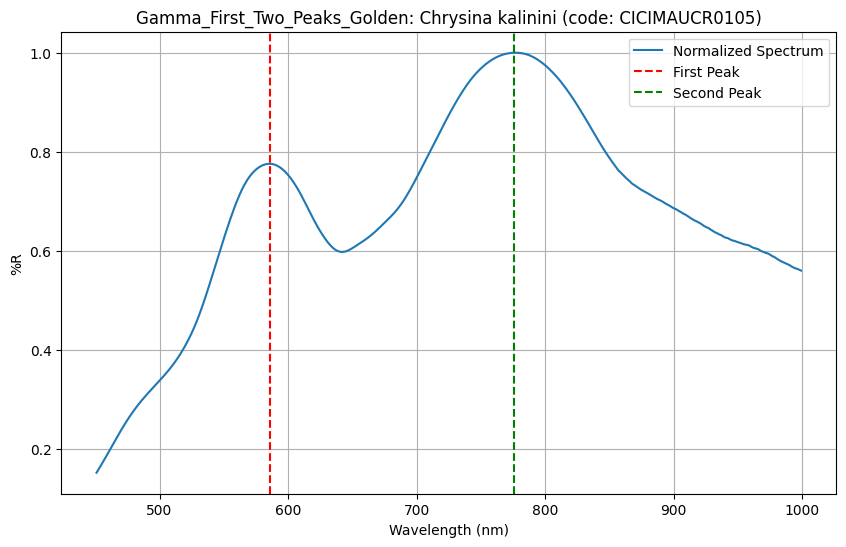

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

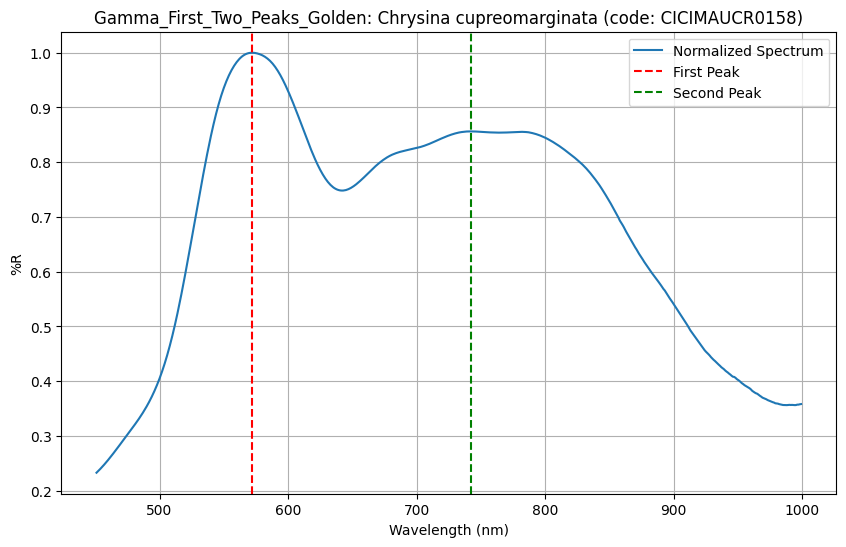

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

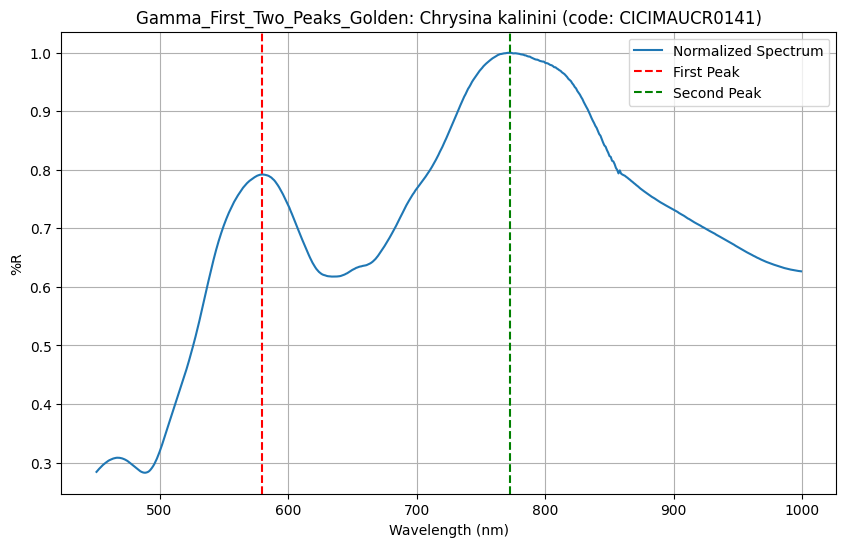

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

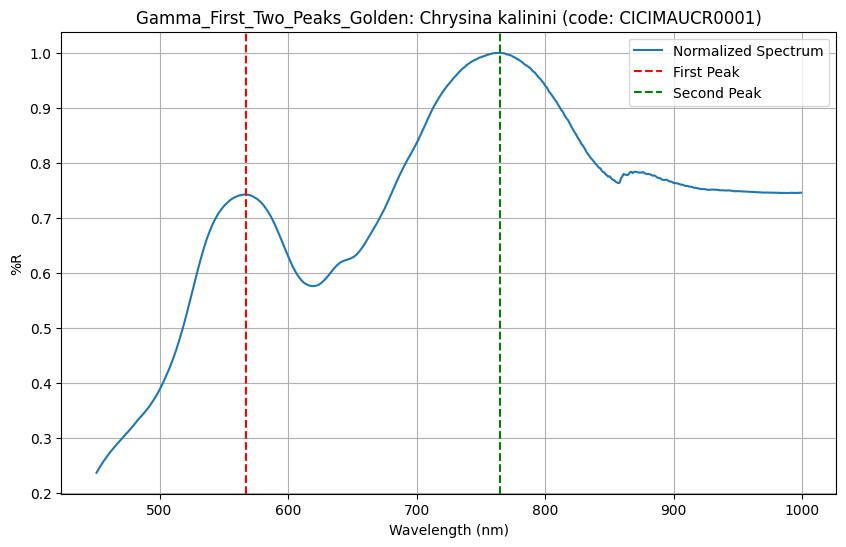

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

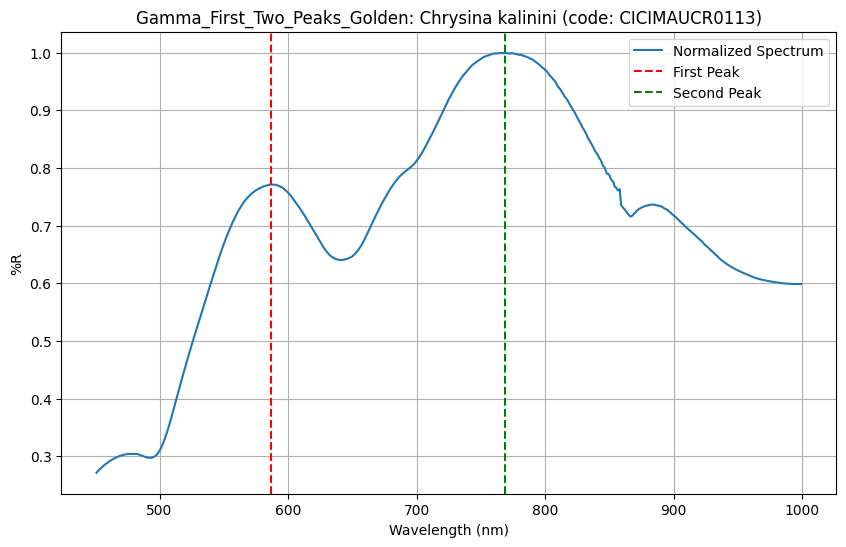

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

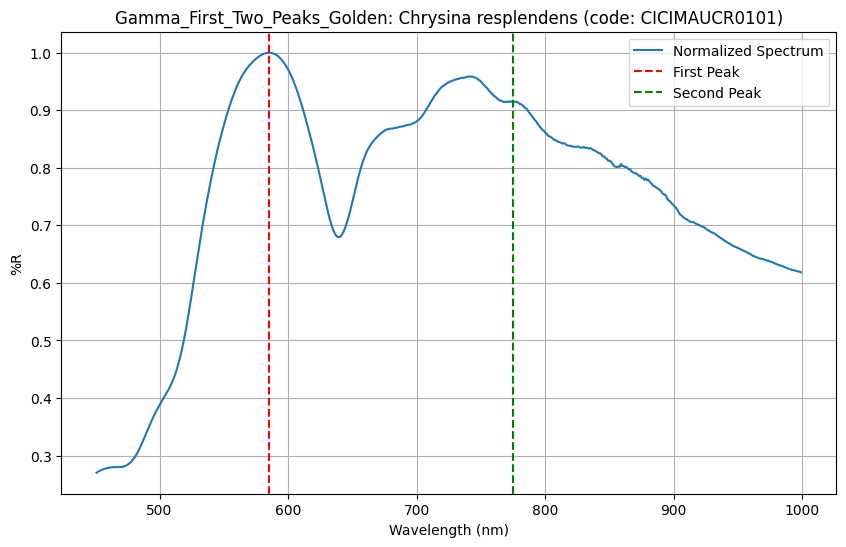

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

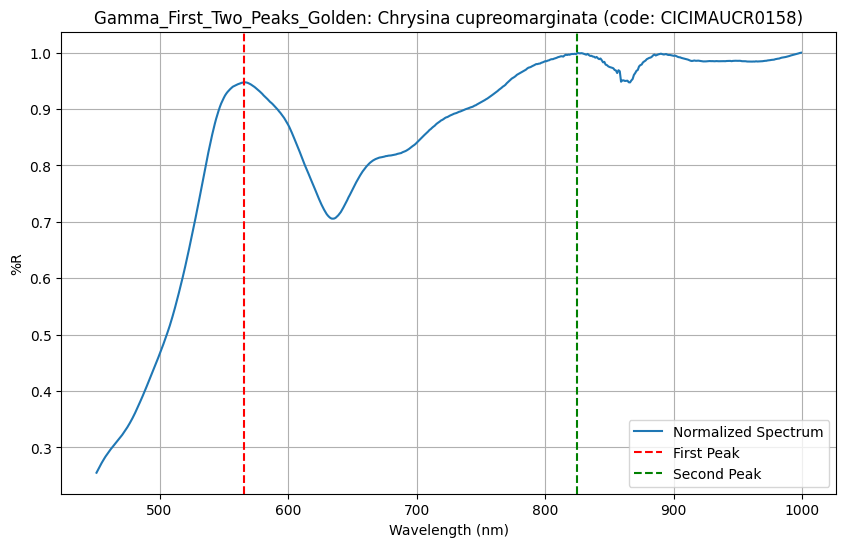

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

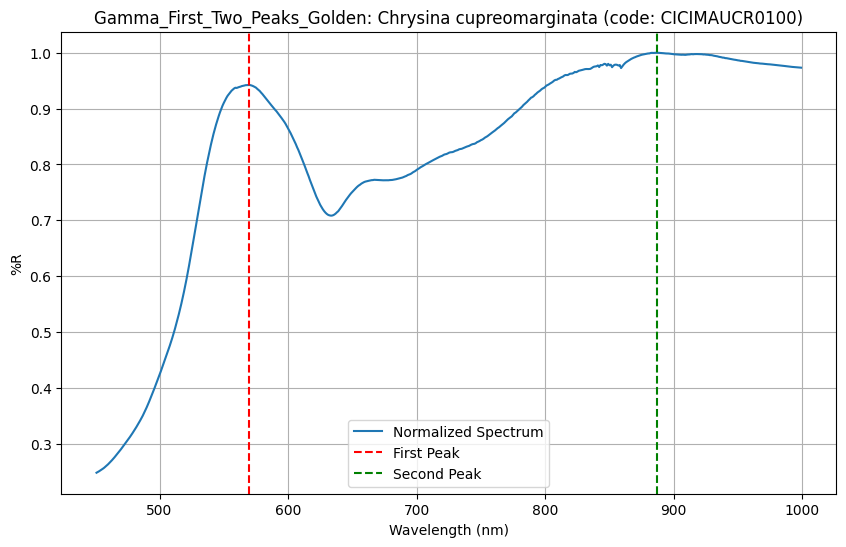

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

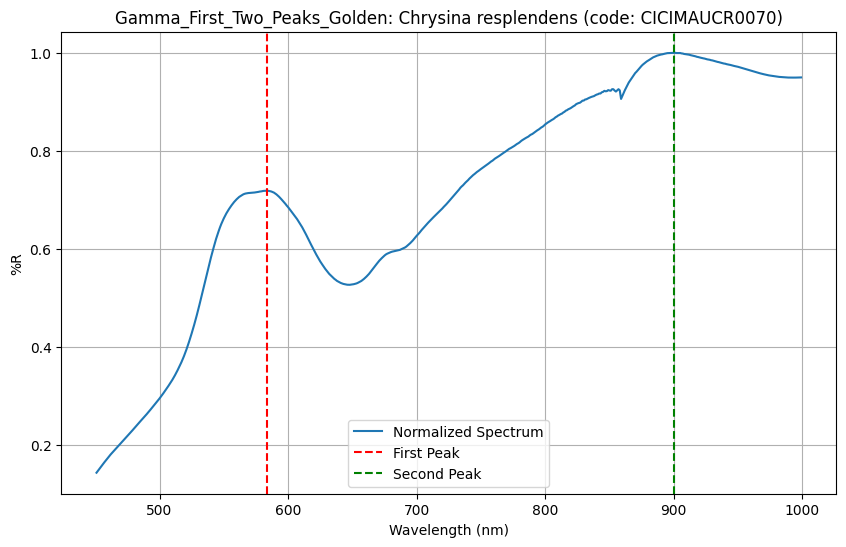

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

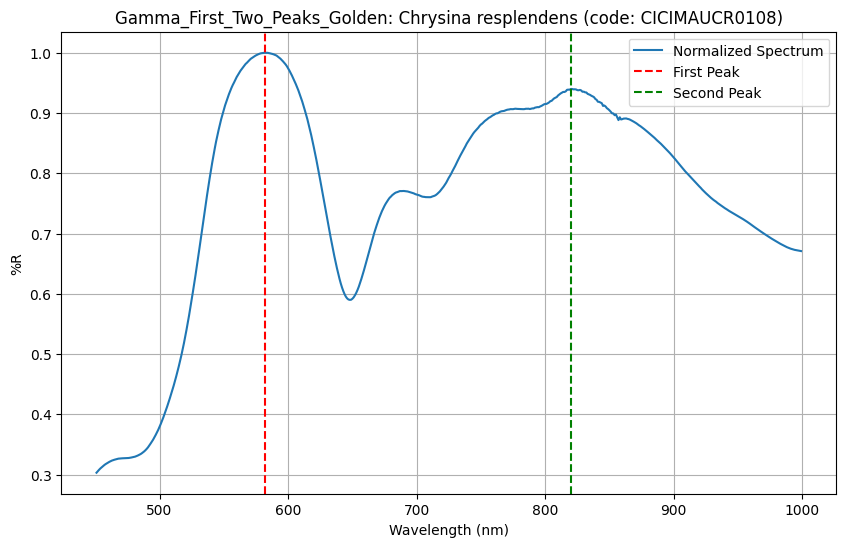

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

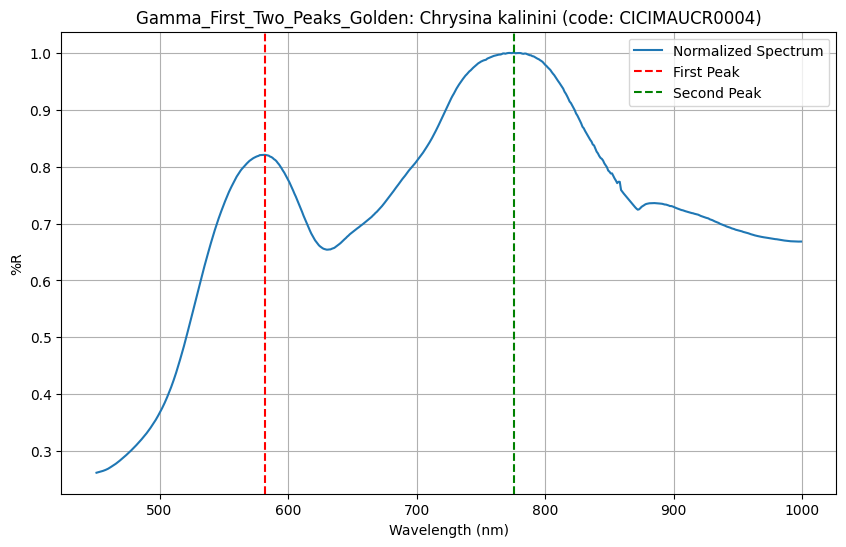

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

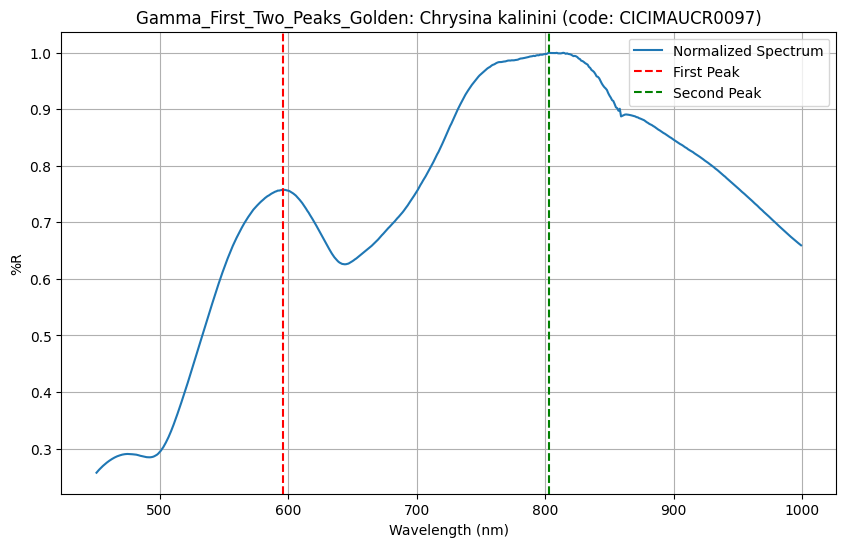

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

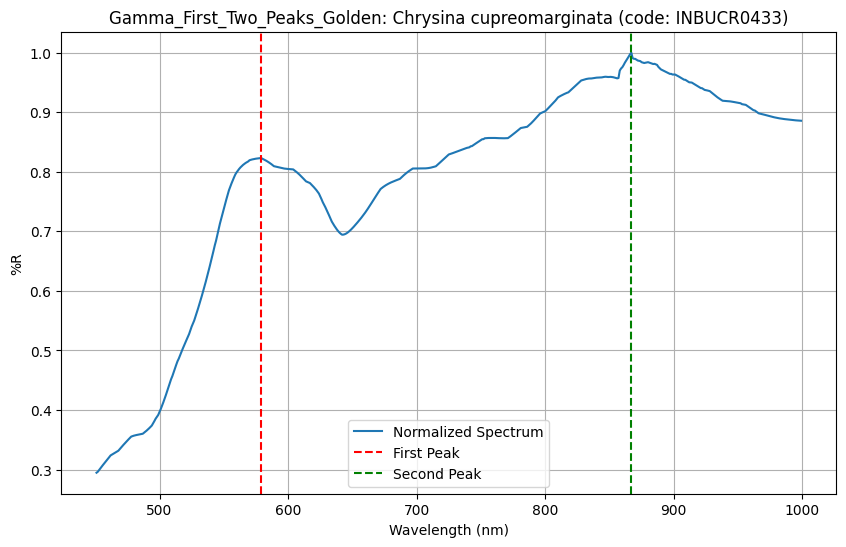

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

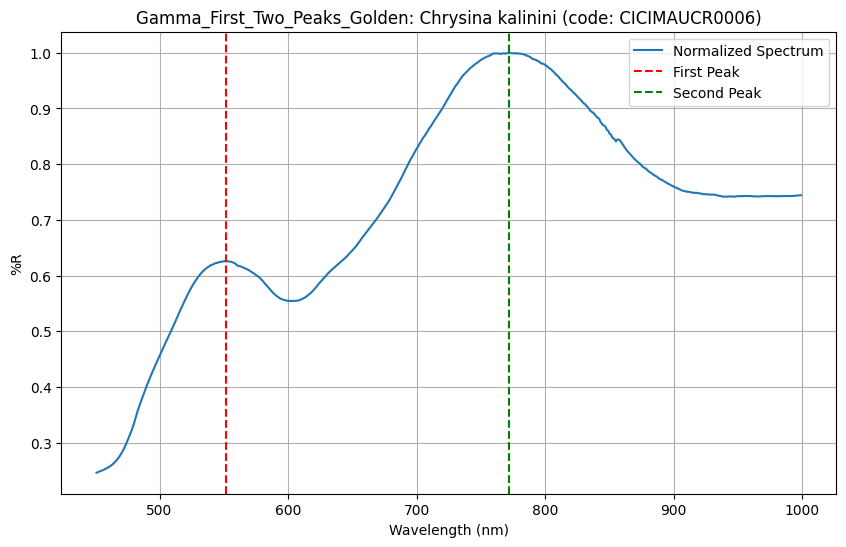

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

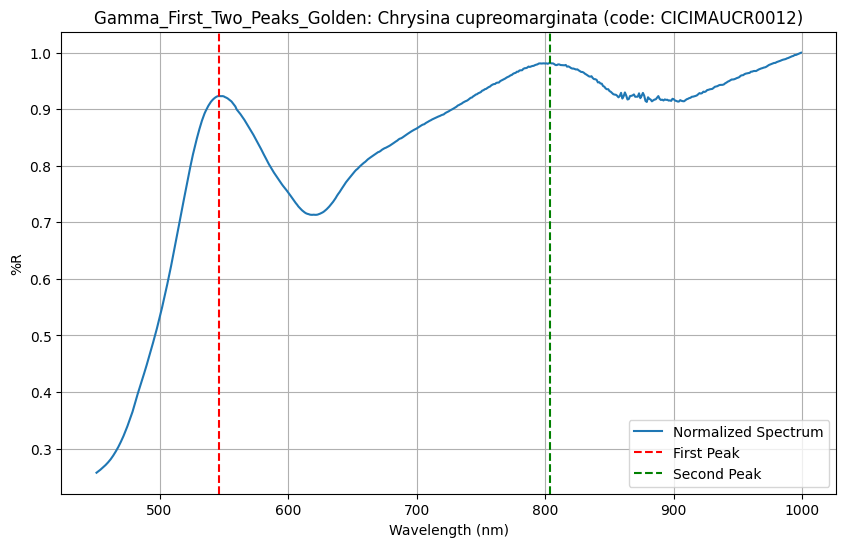

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

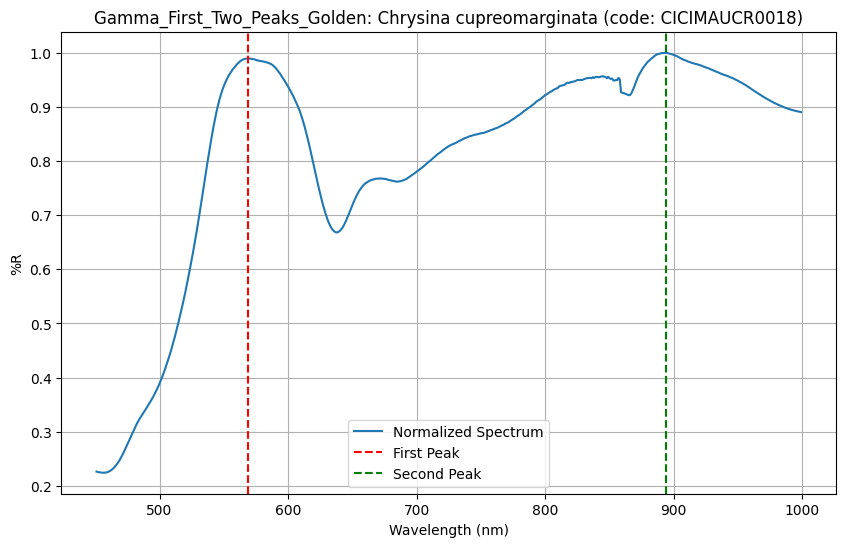

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

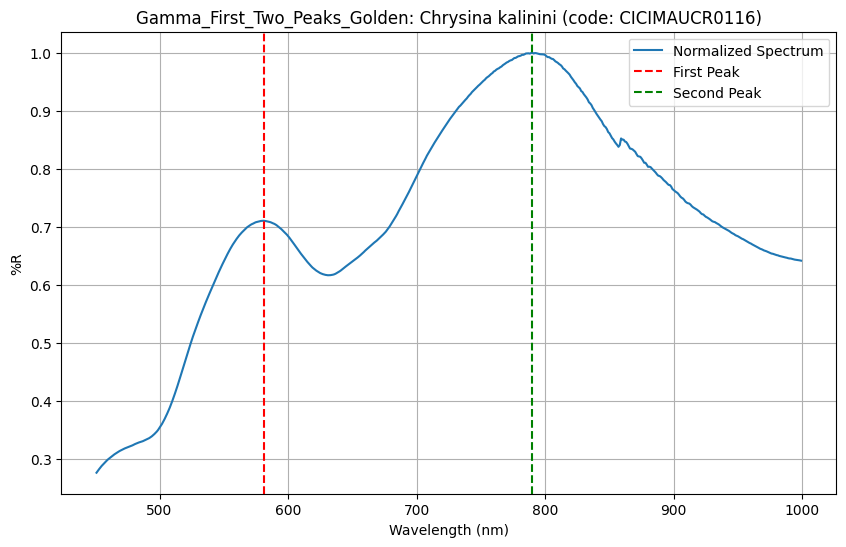

[['CICIMAUCR0098', 'CICIMAUCR0014', 'CICIMAUCR0104', 'CICIMAUCR0002', 'CICIMAUCR0020', 'CICIMAUCR0003', 'CICIMAUCR0015', 'CICIMAUCR0013', 'CICIMAUCR0104', 'CICIMAUCR0105', 'CICIMAUCR0158', 'CICIMAUCR0141', 'CICIMAUCR0001', 'CICIMAUCR0113', 'CICIMAUCR0101', 'CICIMAUCR0158', 'CICIMAUCR0100', 'CICIMAUCR0070', 'CICIMAUCR0108', 'CICIMAUCR0004', 'CICIMAUCR0097', 'INBUCR0433', 'CICIMAUCR0006', 'CICIMAUCR0012', 'CICIMAUCR0018', 'CICIMAUCR0116'], [np.float64(0.9997946715741182), np.float64(1.2058207872110318), np.float64(1.061263556672878), np.float64(1.3894857926038329), np.float64(1.0285942589874786), np.float64(1.2251516694200988), np.float64(1.0325354216782034), np.float64(0.9971201326836476), np.float64(0.9920349559910941), np.float64(1.2894620099264786), np.float64(0.856289595722265), np.float64(1.2624276598192257), np.float64(1.3470690683438888), np.float64(1.2963532867380805), np.float64(0.9158003516333134), np.float64(1.0547216580625591), np.float64(1.061321002683337), np.float64(1.390

In [10]:
gamma_first_two_peaks_data = feature_and_label_extractor(Metric = Gamma_First_Two_Peaks_Golden, 
                                                          config_file = metric_configuration_file, 
                                                          spectra =  train_spectra, 
                                                          debug = debug,
                                                          collection_list = training_collection_list,
                                                          plot = True)

print(gamma_first_two_peaks_data)

### Gamma_Gaussian_Fit

In [11]:
gamma_arbitrary_limits_data = feature_and_label_extractor(Metric = Gamma_Gaussian_Fit, 
                                                          config_file = metric_configuration_file, 
                                                          spectra =  train_spectra, 
                                                          debug = debug,
                                                          collection_list = training_collection_list)


print(gamma_arbitrary_limits_data)

self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.uv_vis_min_wavelength=475.0
        self.uv_vis_max_wavelength=625.0
        self.ir_min_wavelength=700.0
        self.ir_max_wavelength=900.0
        self.prominence_threshold_for_min=0.15
        self.prominence_threshold_for_max=0.4
        self.height_bottom_threshold_for_minimum=0.6
        self.height_bottom_threshold_for_maximum=0.6
        self.smallest_distance_between_peaks_for_min=None
        self.smallest_distance_between_peaks_for_max=None
        1.0
range _fit_gaussian_peak:  475.0 625.0
range _fit_gaussian_peak:  700.0 900.0
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.uv_vis_min_wavelength=475.0
        self.uv_vis_max_wavelength=625.0
        self.ir_min_wavelength=700.0
        self.ir_max_wavelength=900.0
        self.prominence_threshold_for_min=0.15
        self

### Gamma_Area_Under_Curve_Naive_Golden

Getting equipment. Spectrum


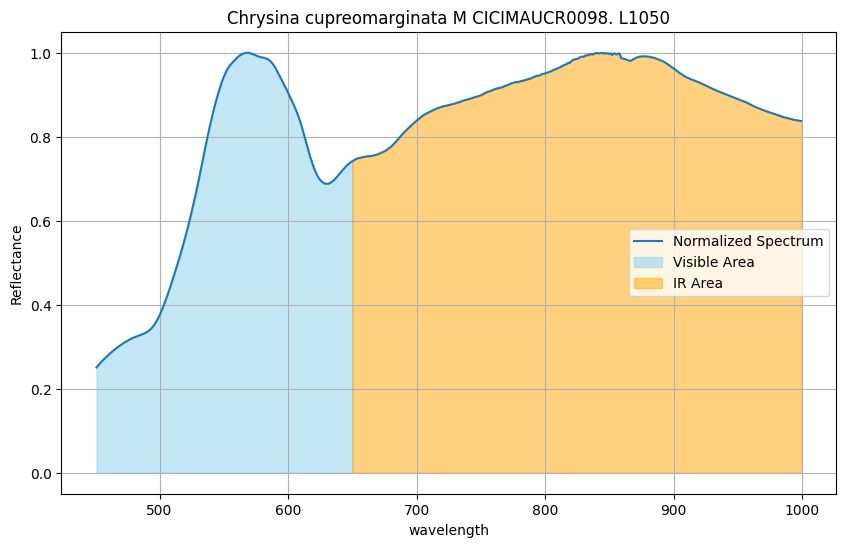

Getting equipment. Spectrum


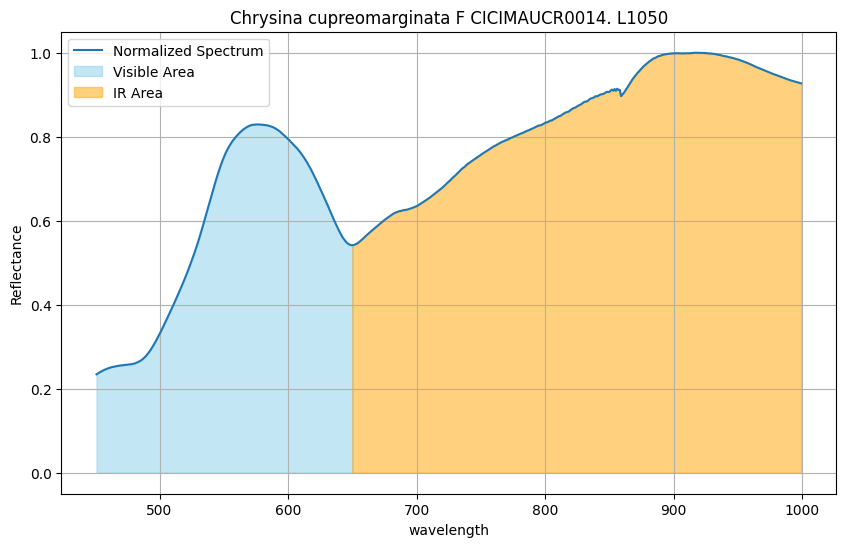

Getting equipment. Spectrum


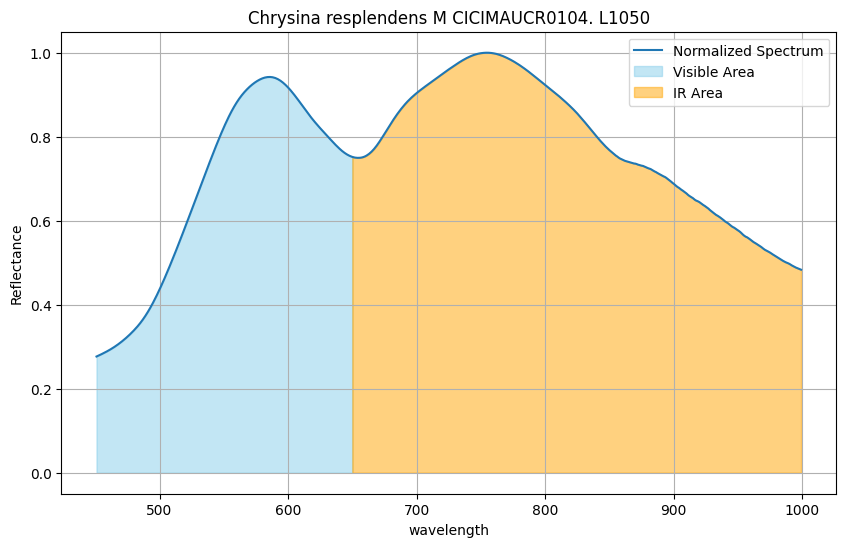

Getting equipment. Spectrum


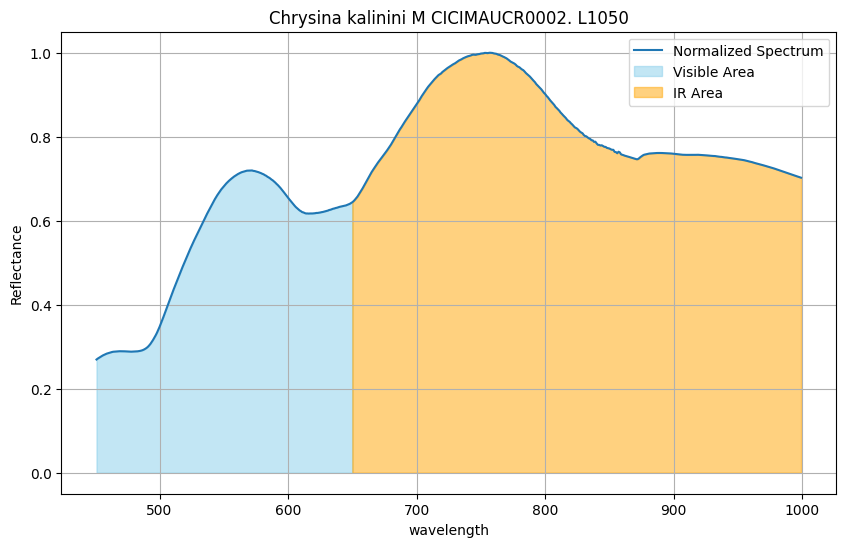

Getting equipment. Spectrum


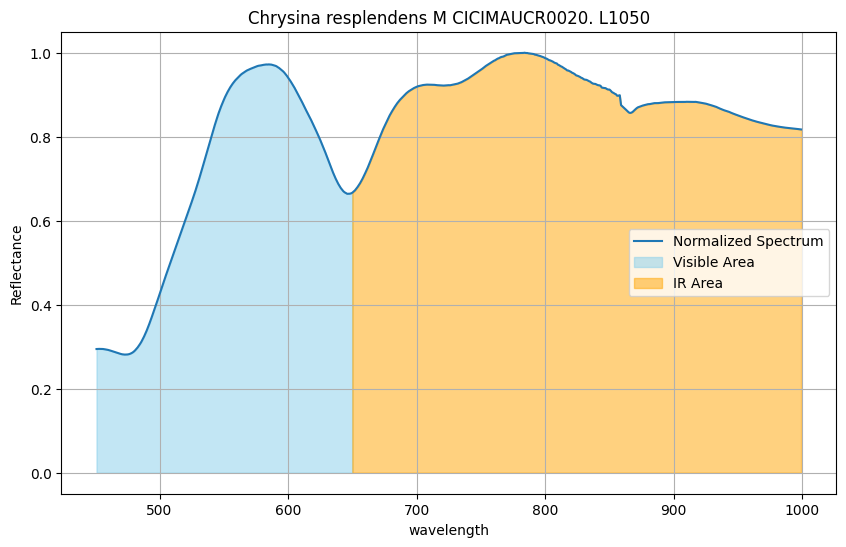

Getting equipment. Spectrum


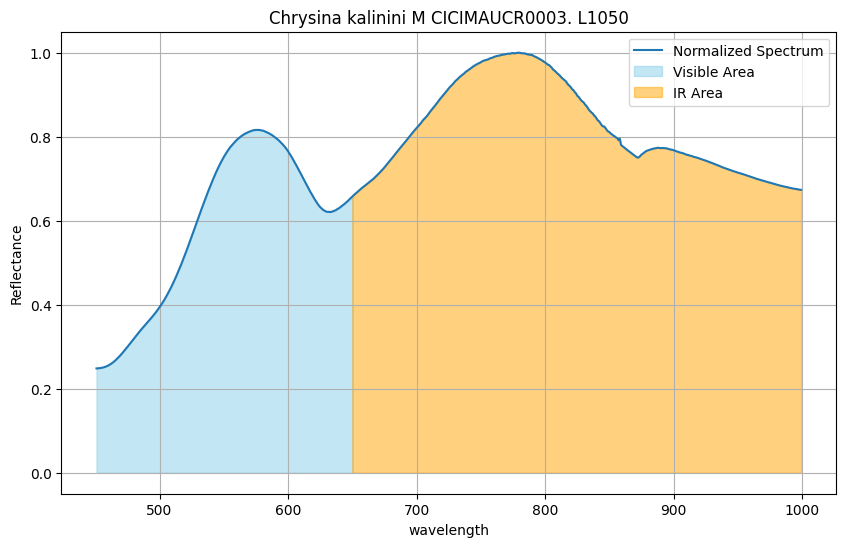

Getting equipment. Spectrum


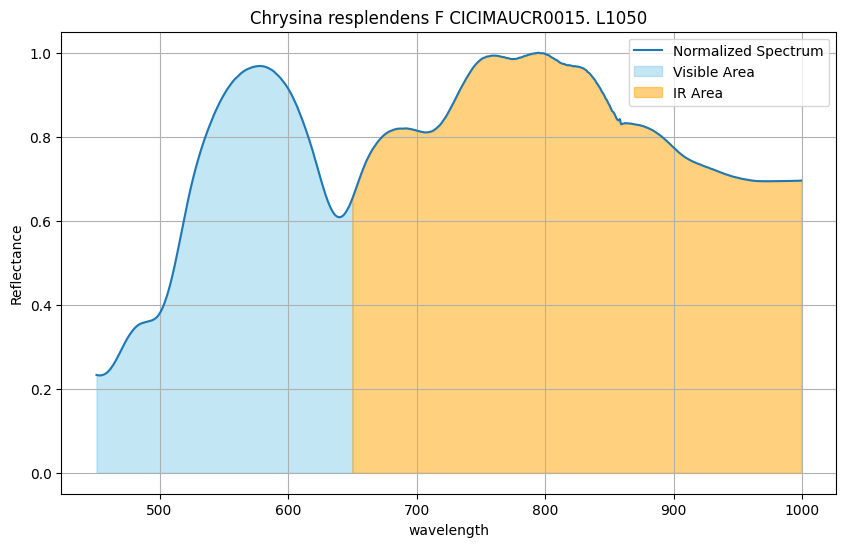

Getting equipment. Spectrum


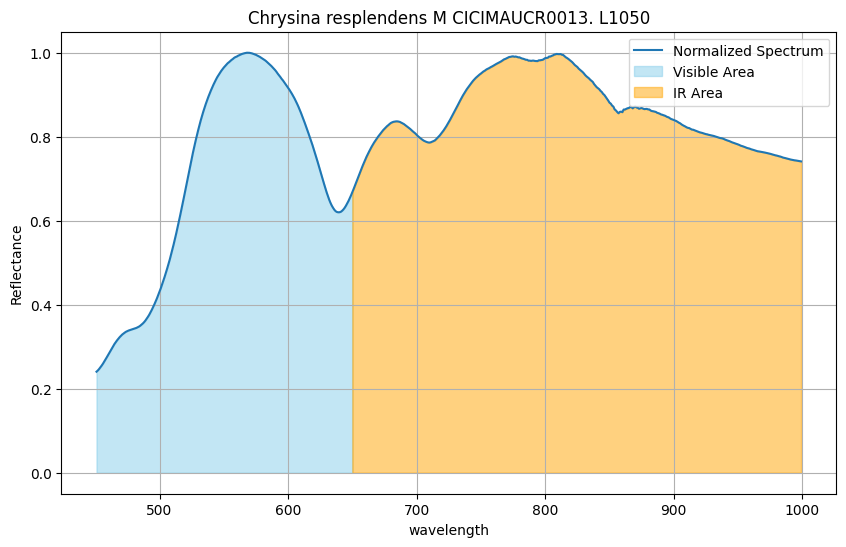

Getting equipment. Spectrum


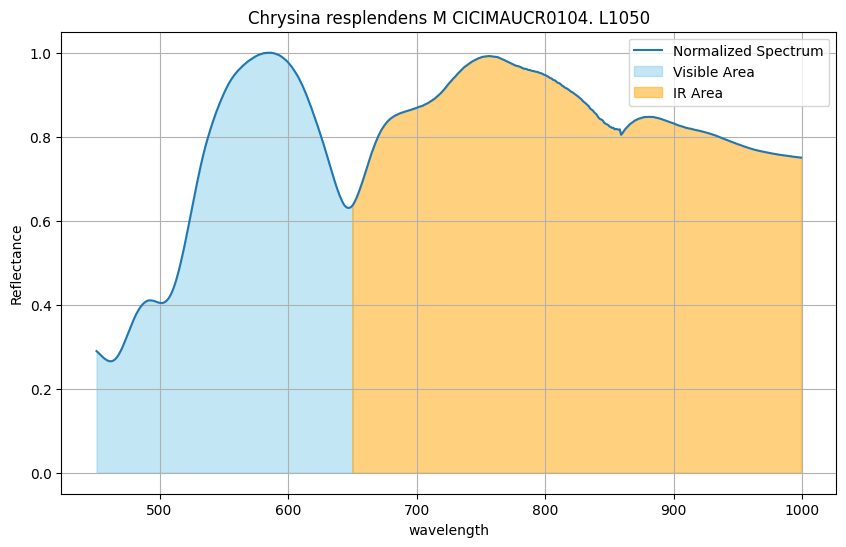

Getting equipment. Spectrum


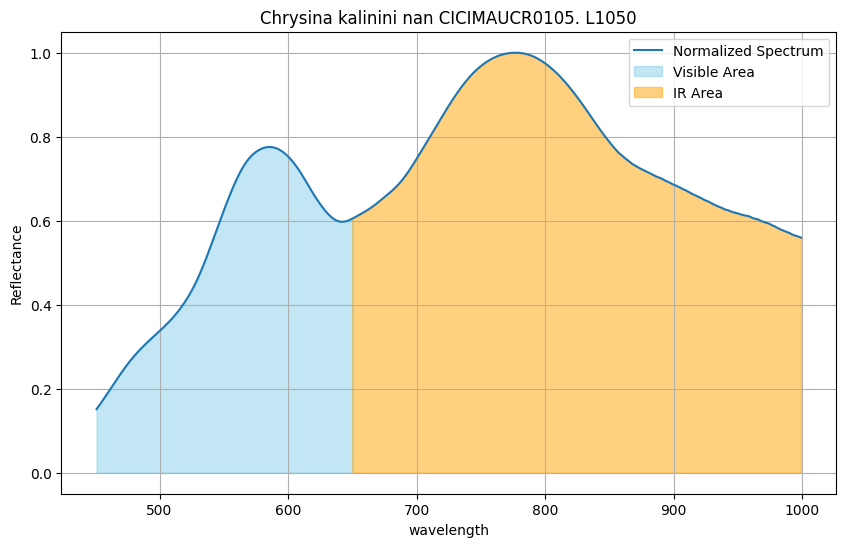

Getting equipment. Spectrum


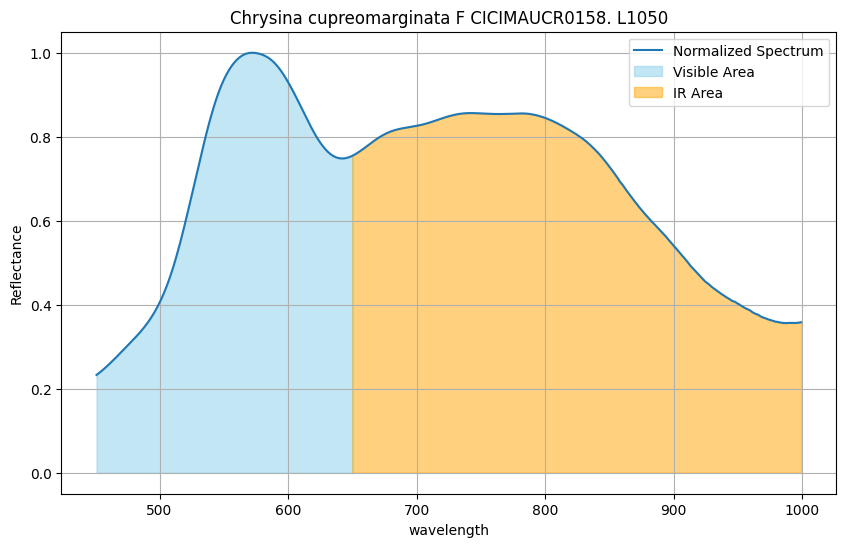

Getting equipment. Spectrum


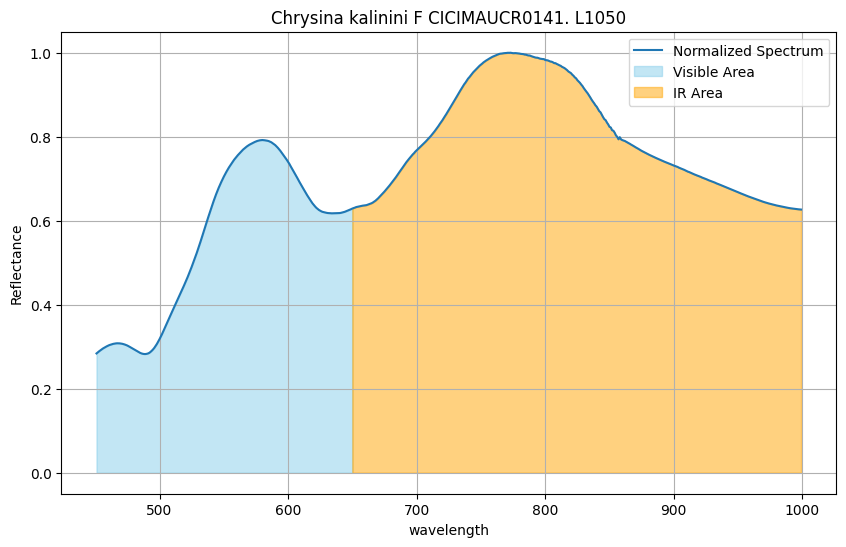

Getting equipment. Spectrum


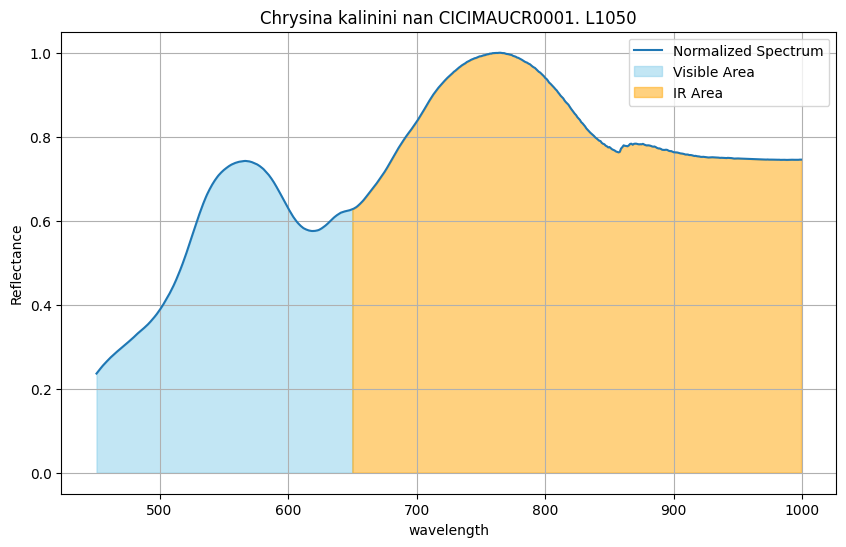

Getting equipment. Spectrum


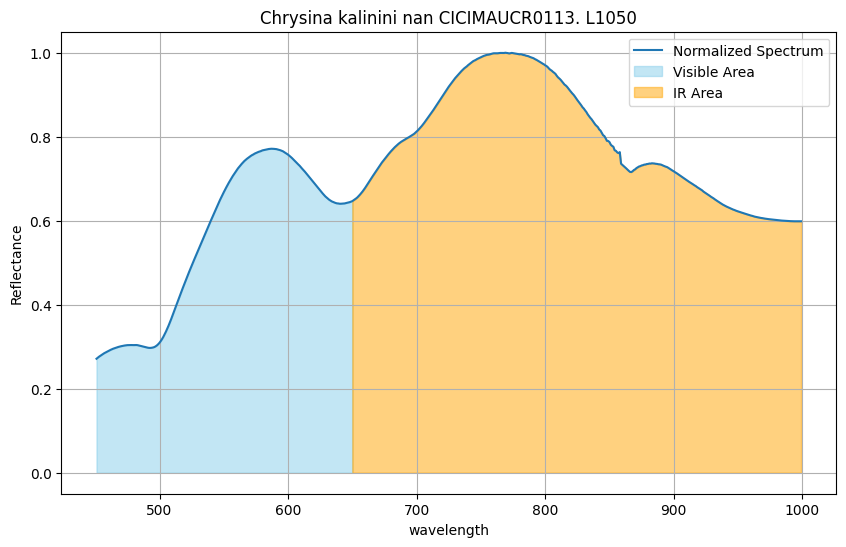

Getting equipment. Spectrum


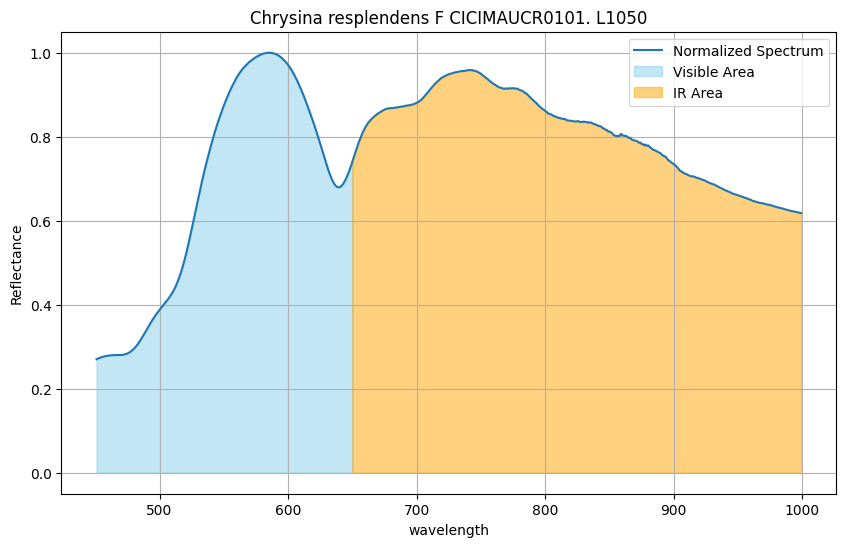

Getting equipment. Spectrum


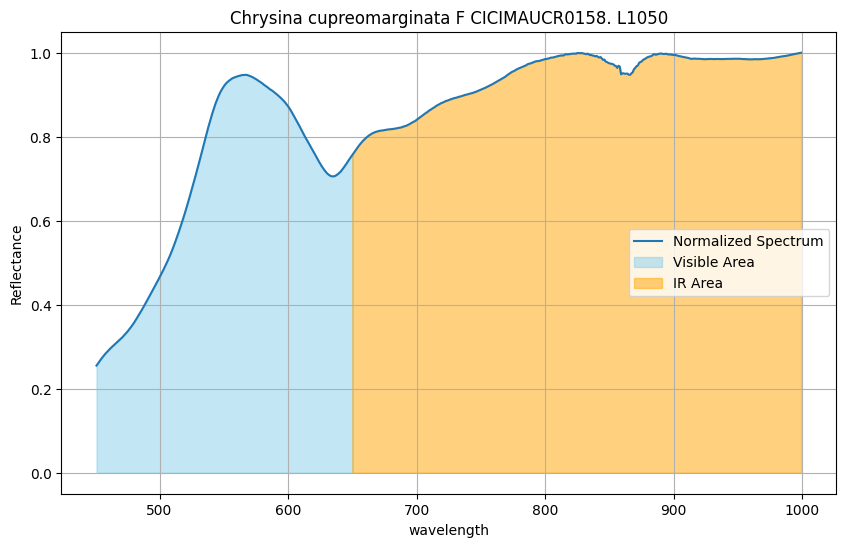

Getting equipment. Spectrum


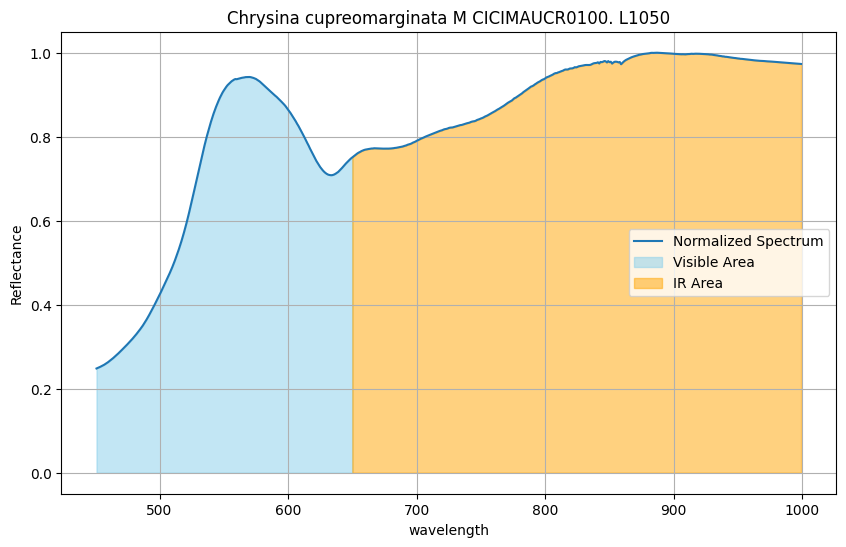

Getting equipment. Spectrum


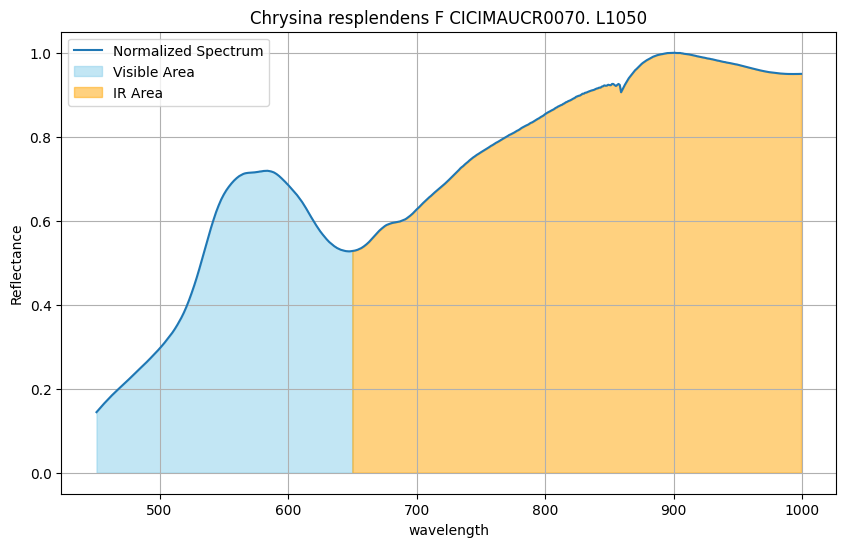

Getting equipment. Spectrum


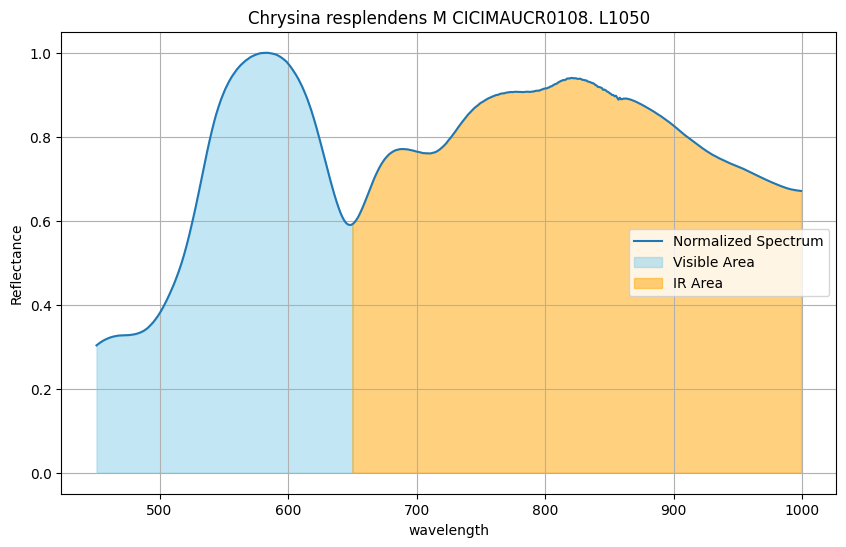

Getting equipment. Spectrum


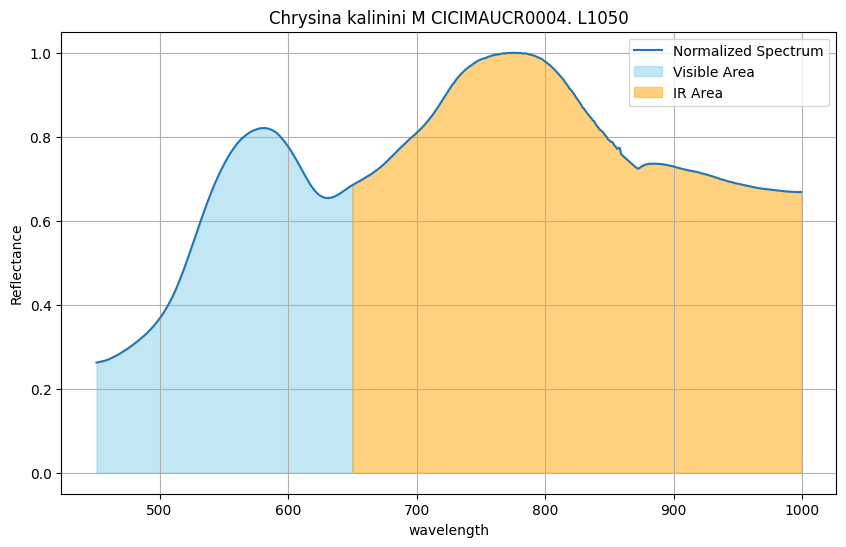

Getting equipment. Spectrum


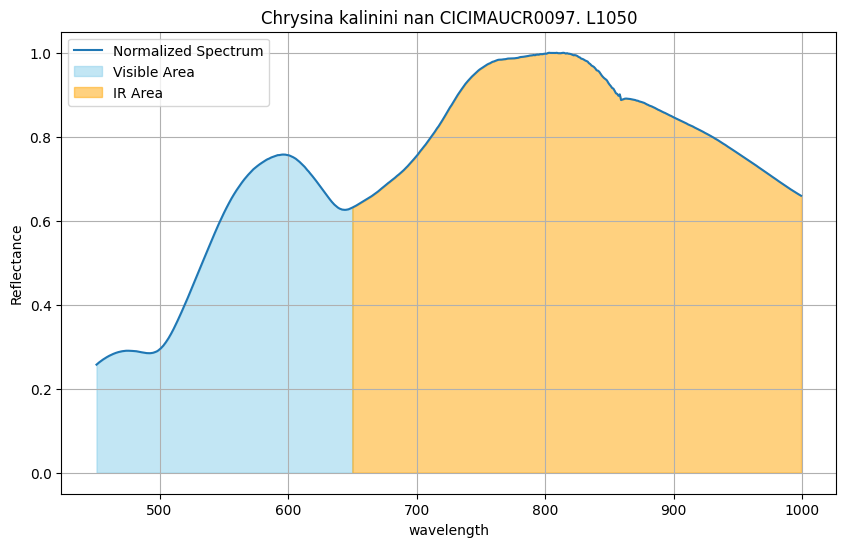

Getting equipment. Spectrum


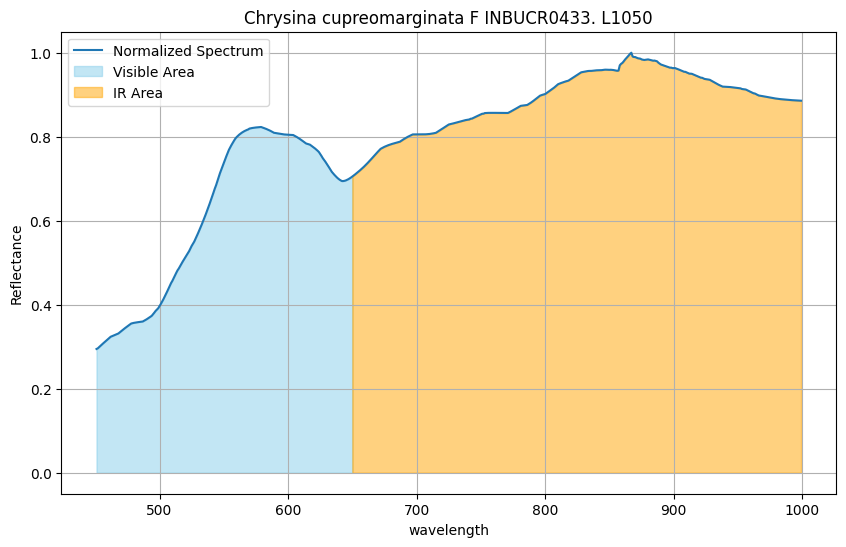

Getting equipment. Spectrum


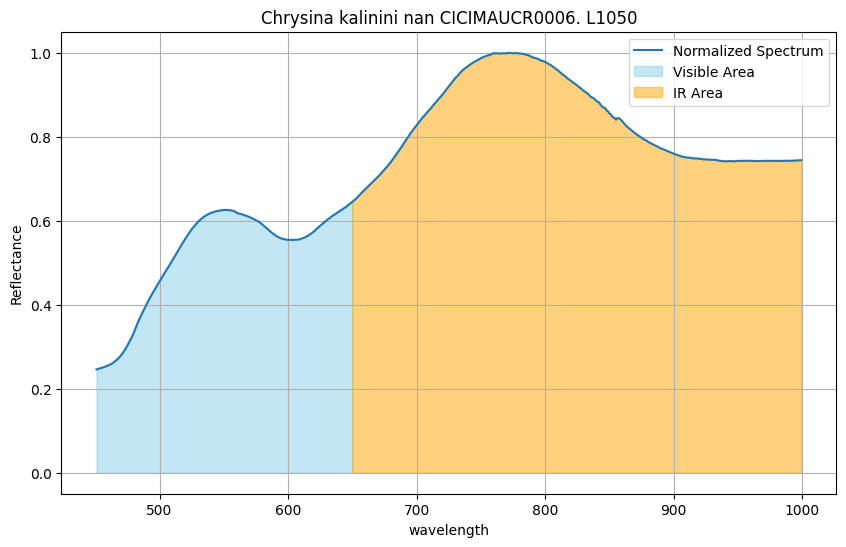

Getting equipment. Spectrum


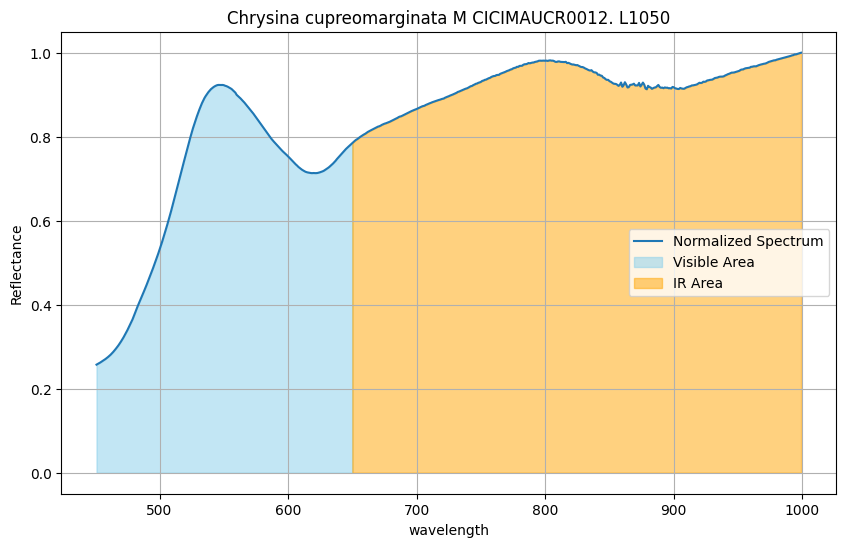

Getting equipment. Spectrum


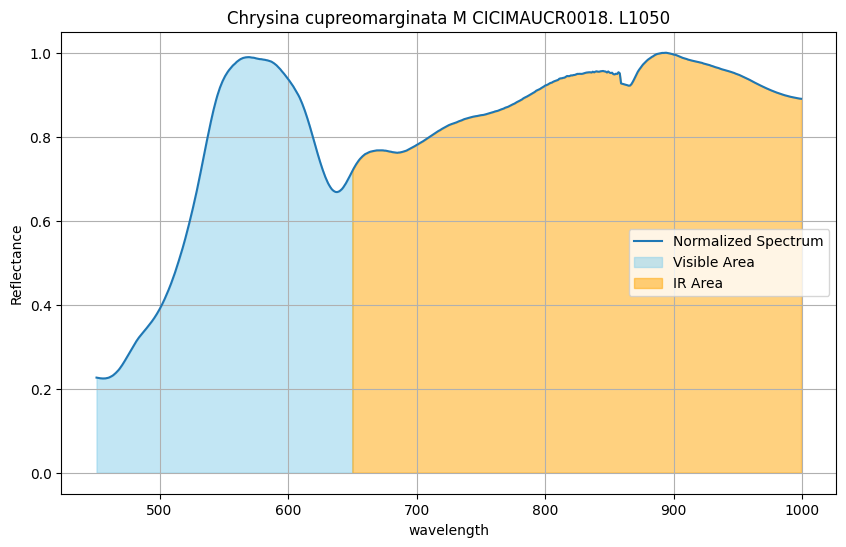

Getting equipment. Spectrum


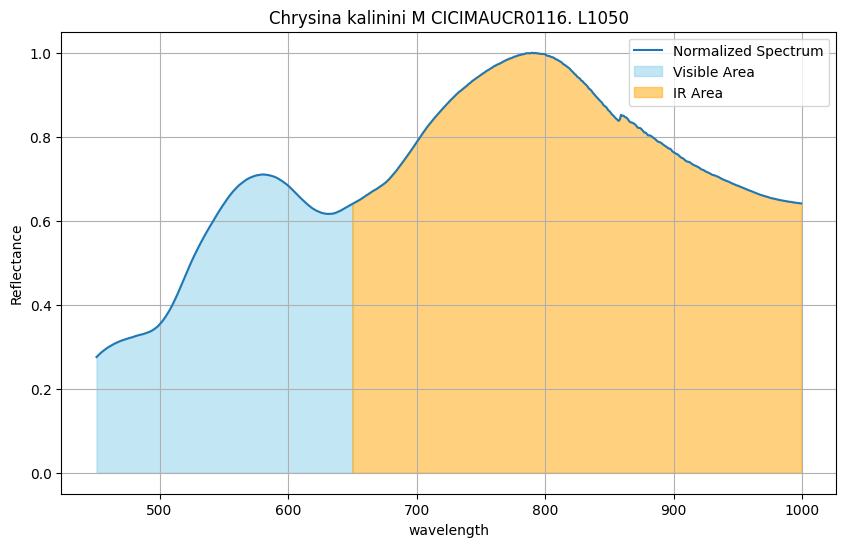

In [12]:
gamma_area_under_curve_data = feature_and_label_extractor(Metric = Gamma_Area_Under_Curve_Naive_Golden, 
                                                          config_file = metric_configuration_file, 
                                                          spectra =  train_spectra, 
                                                          debug = debug,
                                                          collection_list = training_collection_list,
                                                          plot = True)

#print(gamma_area_under_curve_data)

### Gamma_Area_Under_Curve_First_Min_Cut

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.250804
202       452.0  0.254517
203       453.0  0.258051
204       454.0  0.261454
205       455.0  0.264814
..          ...       ...
745       995.0  0.839594
746       996.0  0.839097
747       997.0  0.838577
748       998.0  0.837956
749       999.0  0.837397

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.059033
1          251.0   6.052233
2          252.0   6.033967
3          253.0   6.025833
4          254.0   5.993167
...          ...        ...
1745      1995.0  11.156570
1746      1996.0  11.178961
1747      1997.0  11.205560
1748      1998.0  11.239035
1749      1999.0  11.260341

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [117 394] [568. 845.] [65.2613 65.2479]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=48.893533000000005, 
                  bottom_thr=0.0, top_thr=

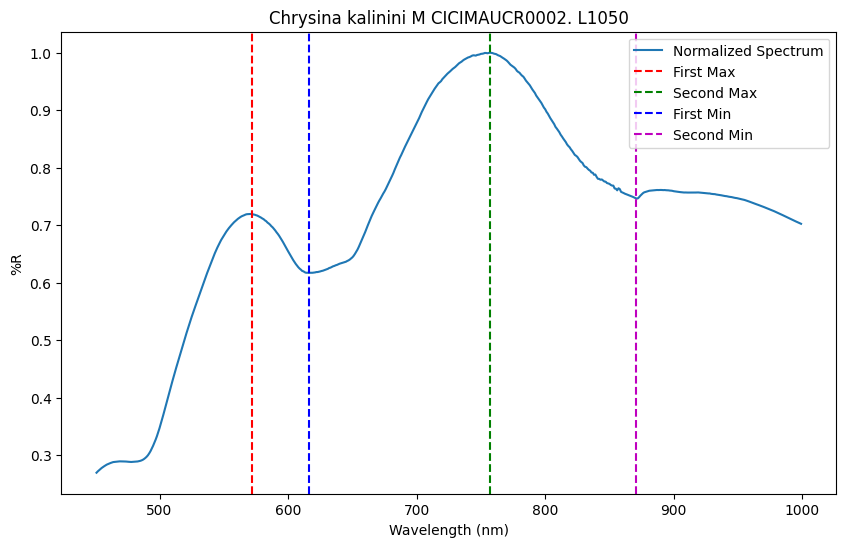

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.294518
202       452.0  0.294798
203       453.0  0.294848
204       454.0  0.294756
205       455.0  0.294713
..          ...       ...
745       995.0  0.818920
746       996.0  0.818662
747       997.0  0.818118
748       998.0  0.817665
749       999.0  0.817347

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   5.691060
1          251.0   5.661860
2          252.0   5.673480
3          253.0   5.679480
4          254.0   5.647980
...          ...        ...
1745      1995.0  18.102704
1746      1996.0  18.168534
1747      1997.0  18.218921
1748      1998.0  18.262135
1749      1999.0  18.307018

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [134 333 459] [585. 784. 910.] [75.0878   77.23488  68.210945]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=55.50916000000001, 
                  bo

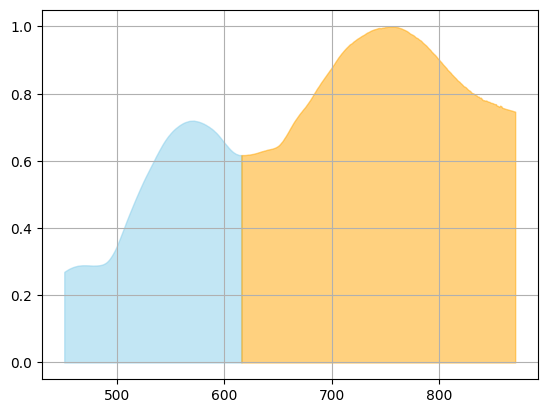

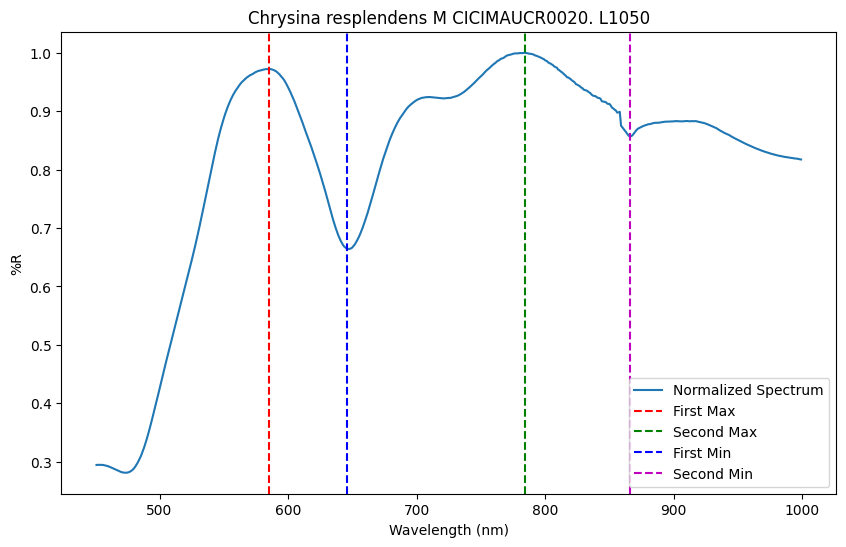

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.248321
202       452.0  0.248594
203       453.0  0.248813
204       454.0  0.249158
205       455.0  0.249765
..          ...       ...
745       995.0  0.675611
746       996.0  0.674960
747       997.0  0.674461
748       998.0  0.673890
749       999.0  0.673556

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.264300
1          251.0   6.269200
2          252.0   6.246400
3          253.0   6.215900
4          254.0   6.196933
...          ...        ...
1745      1995.0  21.554323
1746      1996.0  21.613598
1747      1997.0  21.652972
1748      1998.0  21.694313
1749      1999.0  21.724248

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [125 328 437] [576. 779. 888.] [80.9293   99.150667 76.711305]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=74.529467, 
                  bottom_thr

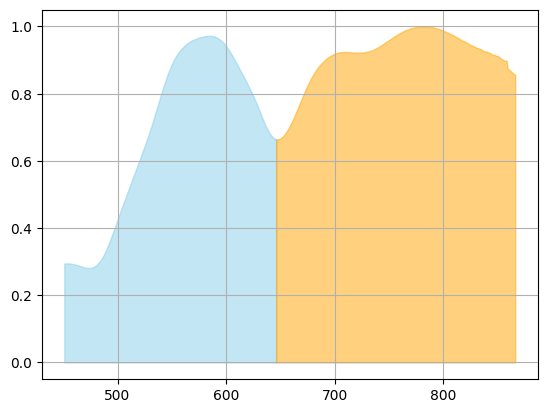

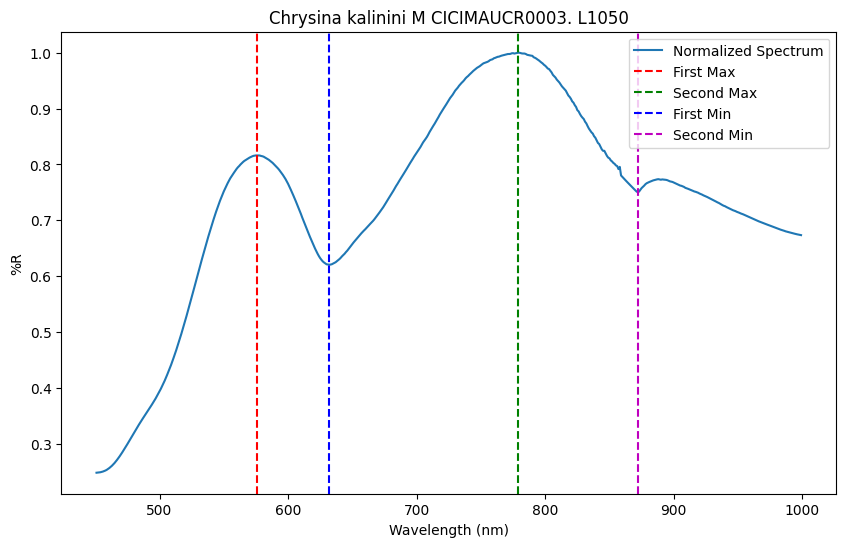

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.232822
202       452.0  0.232116
203       453.0  0.231735
204       454.0  0.231716
205       455.0  0.232214
..          ...       ...
745       995.0  0.694974
746       996.0  0.695055
747       997.0  0.695269
748       998.0  0.695421
749       999.0  0.695535

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.108967
1          251.0   6.101900
2          252.0   6.079567
3          253.0   6.068200
4          254.0   6.084167
...          ...        ...
1745      1995.0  21.369957
1746      1996.0  21.406533
1747      1997.0  21.467083
1748      1998.0  21.489857
1749      1999.0  21.513057

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [127 241 344 543] [578. 692. 795. 994.] [86.700367 73.402367 89.5212   62.225325]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=68.777667, 
         

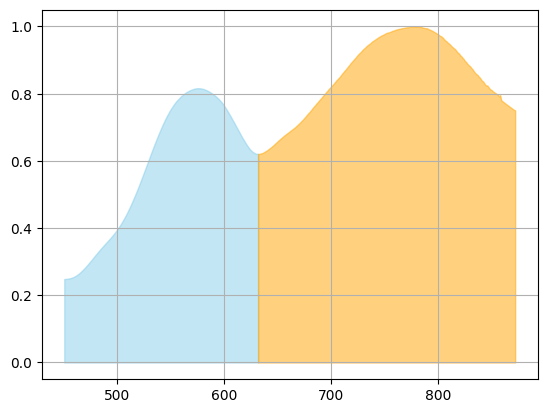

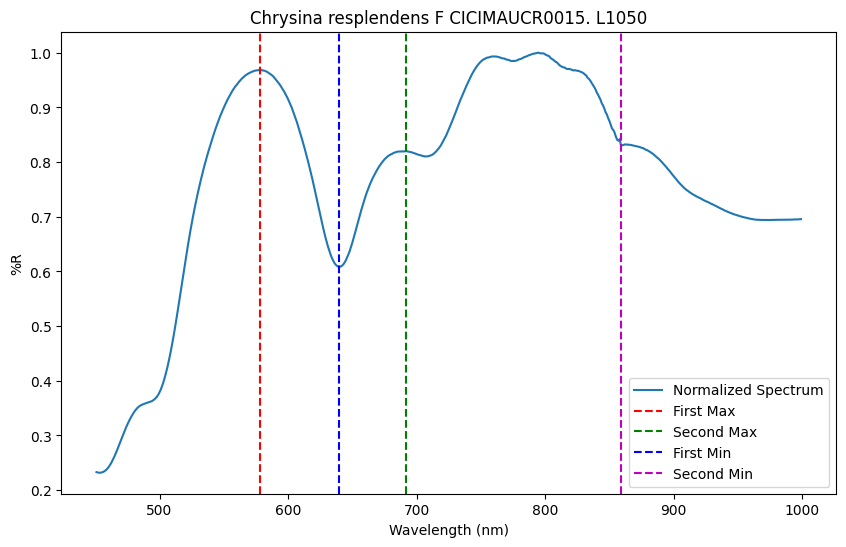

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.240541
202       452.0  0.243406
203       453.0  0.246896
204       454.0  0.250813
205       455.0  0.255074
..          ...       ...
745       995.0  0.743455
746       996.0  0.742815
747       997.0  0.742113
748       998.0  0.741787
749       999.0  0.741254

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.227900
1          251.0   6.212500
2          252.0   6.174433
3          253.0   6.191967
4          254.0   6.170433
...          ...        ...
1745      1995.0  19.510730
1746      1996.0  19.579398
1747      1997.0  19.636737
1748      1998.0  19.681657
1749      1999.0  19.693297

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [117 233 358] [568. 684. 809.] [84.4716   70.665633 84.228333]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=64.1527, 
                  bottom_thr=0

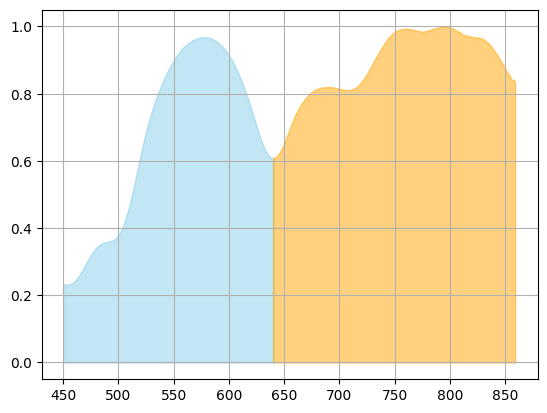

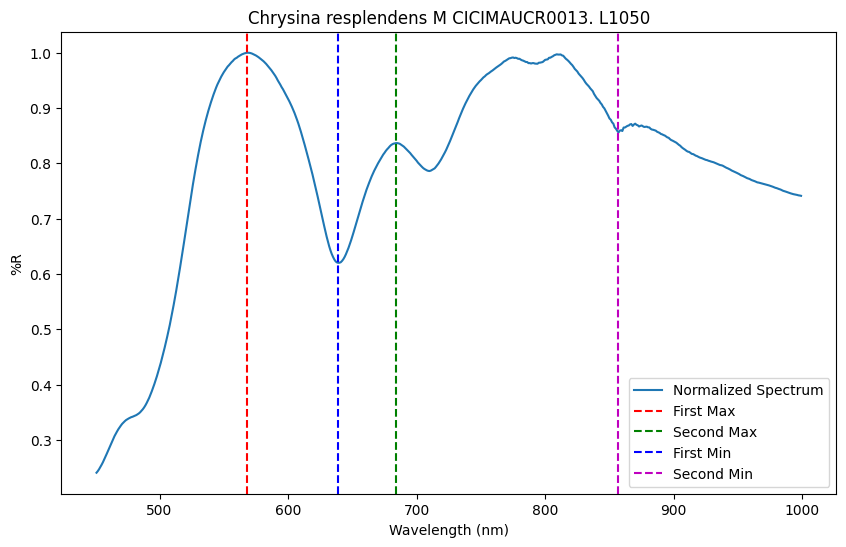

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.289721
202       452.0  0.286862
203       453.0  0.283899
204       454.0  0.280942
205       455.0  0.277948
..          ...       ...
745       995.0  0.751731
746       996.0  0.751282
747       997.0  0.750913
748       998.0  0.750612
749       999.0  0.750269

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.735933
1          251.0   6.753967
2          252.0   6.719933
3          253.0   6.718033
4          254.0   6.693367
...          ...        ...
1745      1995.0  25.450630
1746      1996.0  25.529126
1747      1997.0  25.583074
1748      1998.0  25.643778
1749      1999.0  25.706195

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [135 305 430] [586. 756. 881.] [93.416433 92.672367 79.160728]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=68.632466, 
                  bottom_thr

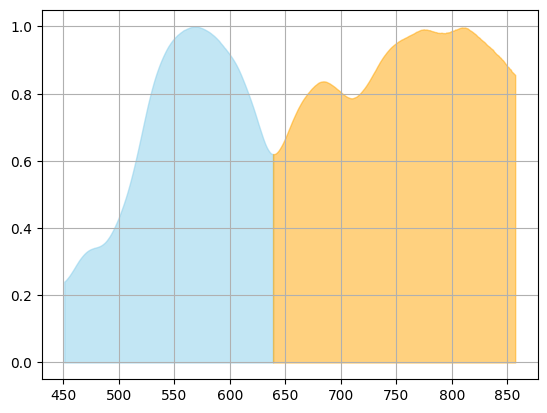

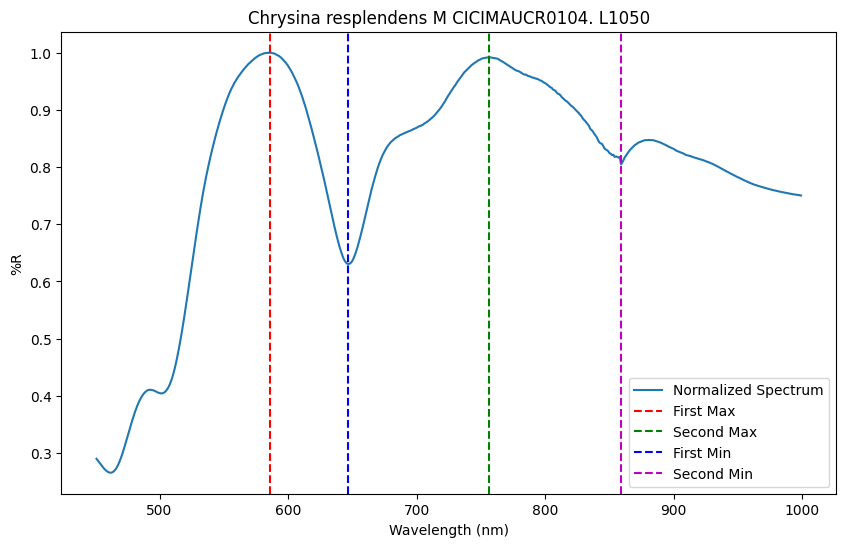

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
167       451.0  0.151221
168       452.0  0.155388
169       453.0  0.159644
170       454.0  0.163968
171       455.0  0.168357
..          ...       ...
711       995.0  0.564075
712       996.0  0.563258
713       997.0  0.561996
714       998.0  0.560905
715       999.0  0.559747

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          284.0   1.005921
1          285.0   1.130663
2          286.0   1.250340
3          287.0   1.369472
4          288.0   1.481847
...          ...        ...
1711      1995.0  18.162503
1712      1996.0  18.240729
1713      1997.0  18.277948
1714      1998.0  18.348353
1715      1999.0  18.375664

[1716 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [135 325] [586. 776.] [63.605839 82.017313]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=69.614549, 
                  bottom_thr=0.0, top_thr=69.61

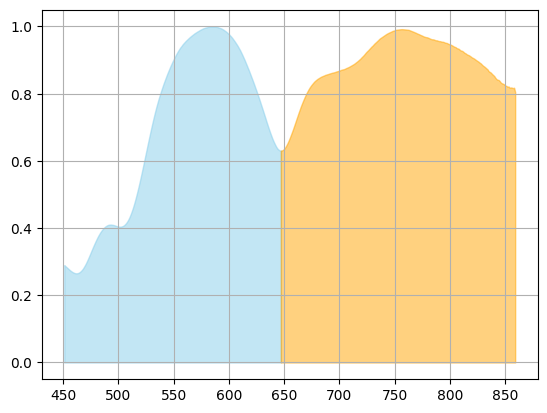

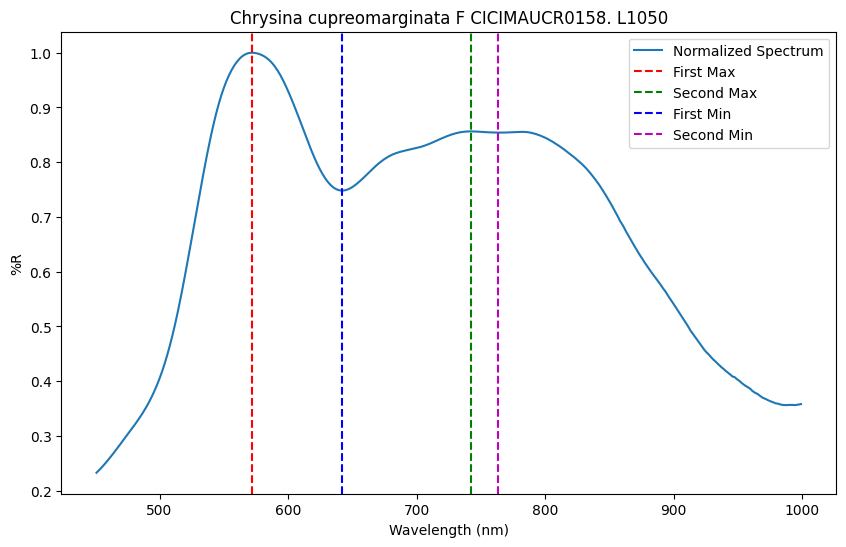

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.284006
202       452.0  0.286629
203       453.0  0.289090
204       454.0  0.291411
205       455.0  0.293722
..          ...       ...
745       995.0  0.627935
746       996.0  0.627558
747       997.0  0.627178
748       998.0  0.626884
749       999.0  0.626628

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.390333
1          251.0   6.389500
2          252.0   6.380300
3          253.0   6.354200
4          254.0   6.367300
...          ...        ...
1745      1995.0  21.051944
1746      1996.0  21.140525
1747      1997.0  21.215391
1748      1998.0  21.294900
1749      1999.0  21.366582

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [129 322] [580. 773.] [77.3671   97.670367]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=70.071434, 
                  bottom_thr=0.0, top_thr=70.07

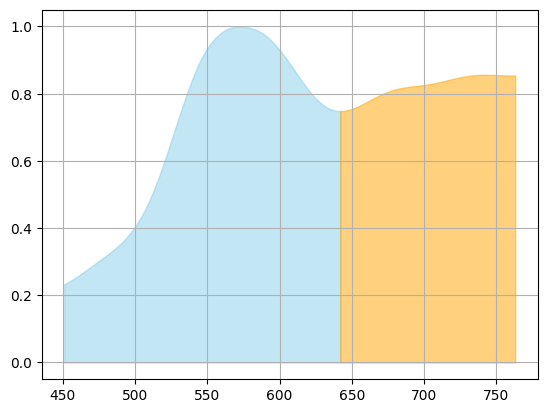

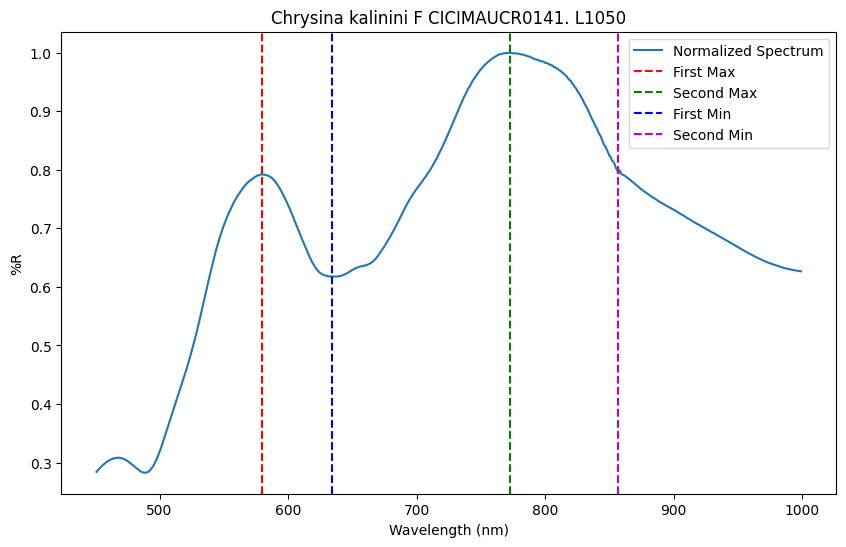

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.236114
202       452.0  0.240141
203       453.0  0.244019
204       454.0  0.247833
205       455.0  0.251590
..          ...       ...
745       995.0  0.745043
746       996.0  0.745027
747       997.0  0.745072
748       998.0  0.745450
749       999.0  0.745449

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   5.702700
1          251.0   5.706900
2          252.0   5.700400
3          253.0   5.654850
4          254.0   5.641550
...          ...        ...
1745      1995.0  26.643802
1746      1996.0  26.747612
1747      1997.0  26.857658
1748      1998.0  26.933957
1749      1999.0  26.996144

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [116 314 419 522] [567. 765. 870. 973.] [68.32725  92.041525 72.116726 68.648007]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=70.30927499999999, 
 

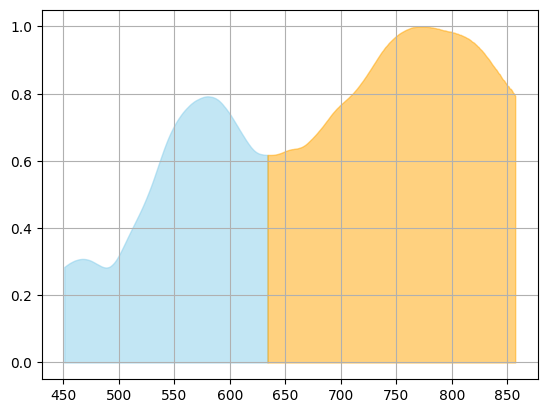

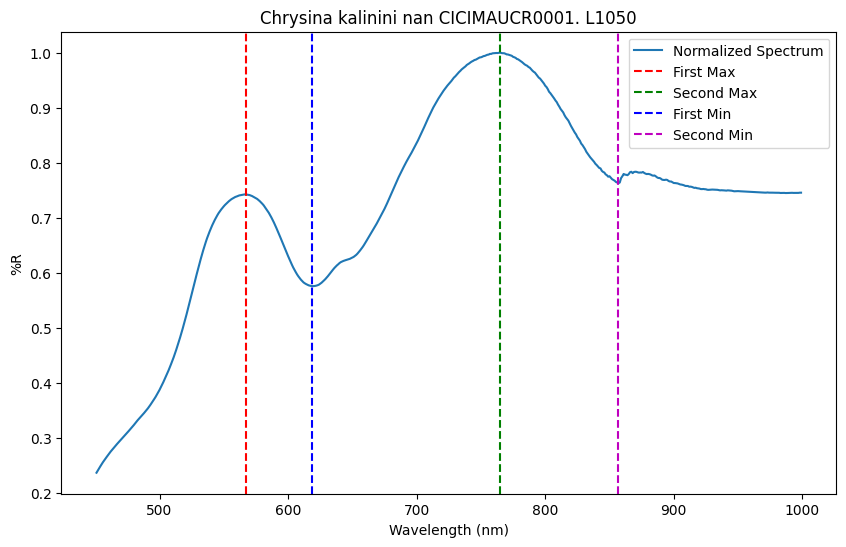

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.271377
202       452.0  0.273909
203       453.0  0.276355
204       454.0  0.278475
205       455.0  0.280605
..          ...       ...
745       995.0  0.598676
746       996.0  0.598629
747       997.0  0.598504
748       998.0  0.598511
749       999.0  0.598651

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.259033
1          251.0   6.240933
2          252.0   6.239333
3          253.0   6.206267
4          254.0   6.186733
...          ...        ...
1745      1995.0  14.655396
1746      1996.0  14.684346
1747      1997.0  14.717271
1748      1998.0  14.721940
1749      1999.0  14.748202

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [136 318 432 544] [587. 769. 883. 995.] [75.351167 97.681733 71.968049 58.479705]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=71.173166, 
         

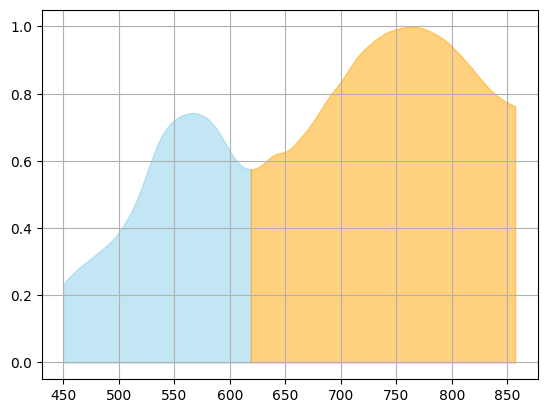

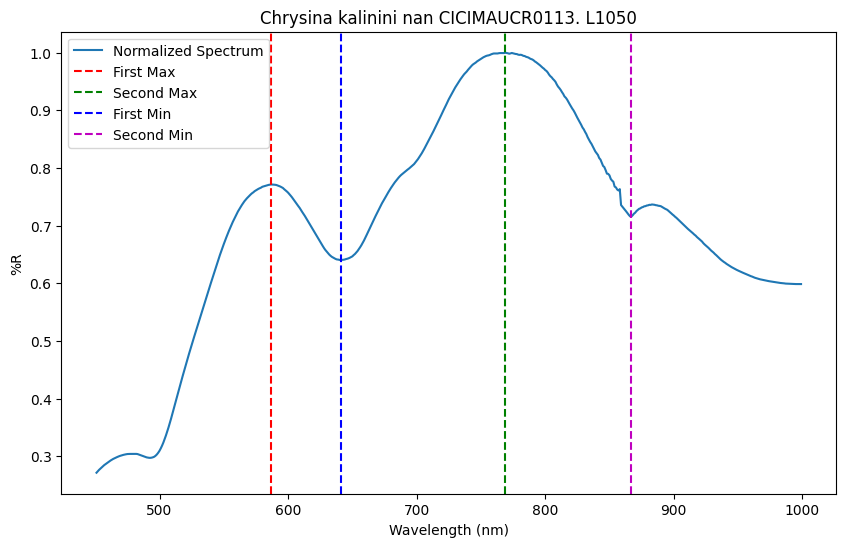

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.270238
202       452.0  0.271730
203       453.0  0.273022
204       454.0  0.274175
205       455.0  0.275005
..          ...       ...
745       995.0  0.620965
746       996.0  0.620320
747       997.0  0.619884
748       998.0  0.619229
749       999.0  0.618357

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.822967
1          251.0   6.775467
2          252.0   6.775167
3          253.0   6.801867
4          254.0   6.749833
...          ...        ...
1745      1995.0  12.911374
1746      1996.0  12.928366
1747      1997.0  12.949518
1748      1998.0  12.973254
1749      1999.0  12.961911

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [134 290 399] [585. 741. 850.] [92.031667 88.234667 74.780867]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=67.1612, 
                  bottom_thr=0

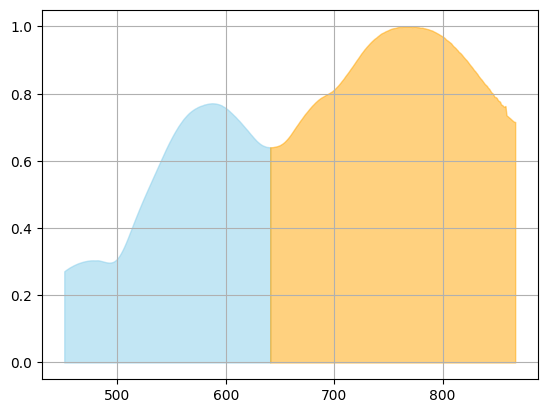

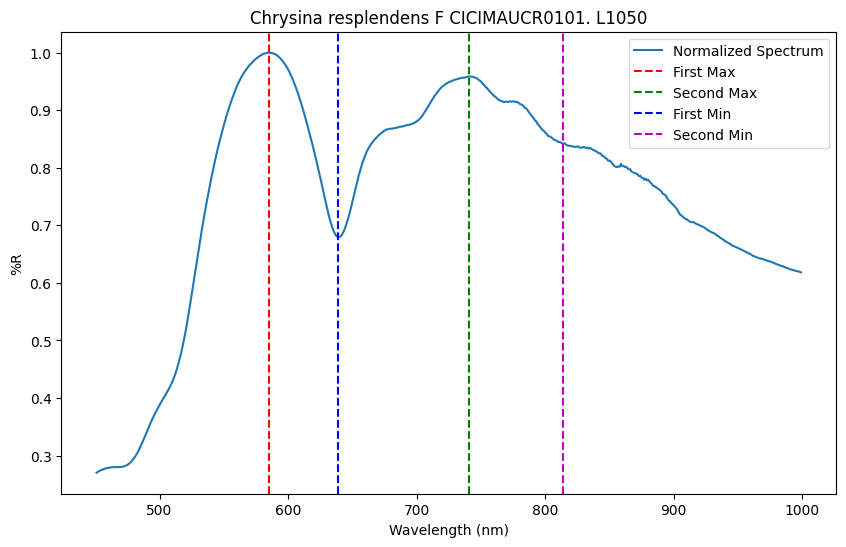

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.255107
202       452.0  0.259471
203       453.0  0.263991
204       454.0  0.268285
205       455.0  0.272403
..          ...       ...
745       995.0  0.997543
746       996.0  0.998148
747       997.0  0.998755
748       998.0  0.999492
749       999.0  1.000000

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.008450
1          251.0   5.972775
2          252.0   5.954625
3          253.0   5.952850
4          254.0   5.908875
...          ...        ...
1745      1995.0  29.522203
1746      1996.0  29.621899
1747      1997.0  29.713628
1748      1998.0  29.778892
1749      1999.0  29.870986

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [115 374 497] [566. 825. 948.] [64.537975 68.0696   67.139431]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=50.734972, 
                  bottom_thr

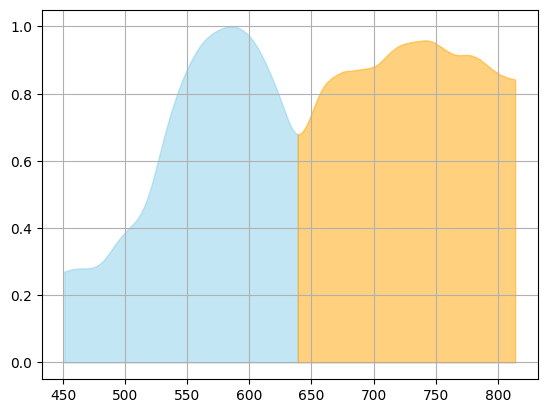

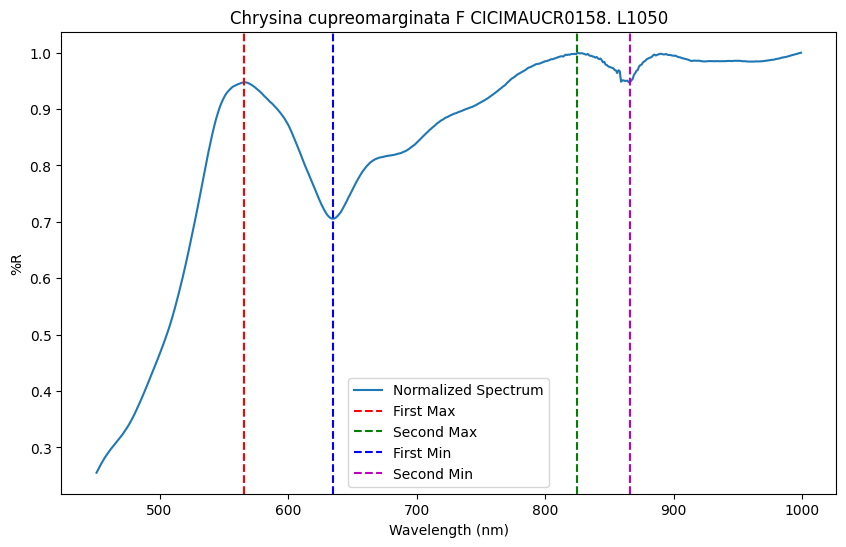

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.248185
202       452.0  0.249468
203       453.0  0.250788
204       454.0  0.252318
205       455.0  0.253867
..          ...       ...
745       995.0  0.974123
746       996.0  0.973917
747       997.0  0.973641
748       998.0  0.973452
749       999.0  0.973248

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   5.191600
1          251.0   5.191933
2          252.0   5.193233
3          253.0   5.187600
4          254.0   5.191667
...          ...        ...
1745      1995.0  21.857982
1746      1996.0  21.912365
1747      1997.0  21.975321
1748      1998.0  22.028556
1749      1999.0  22.073970

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [119 220 436] [570. 671. 887.] [61.9378   50.755933 65.735888]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=49.421255, 
                  bottom_thr

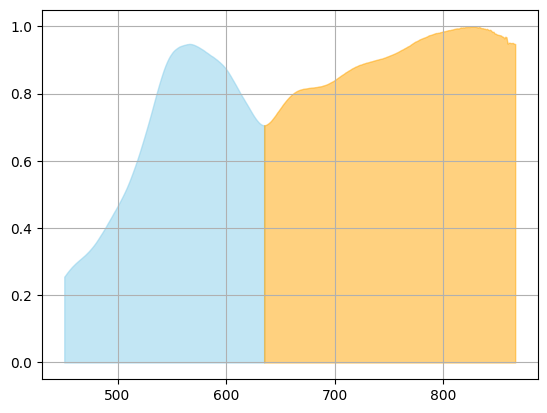

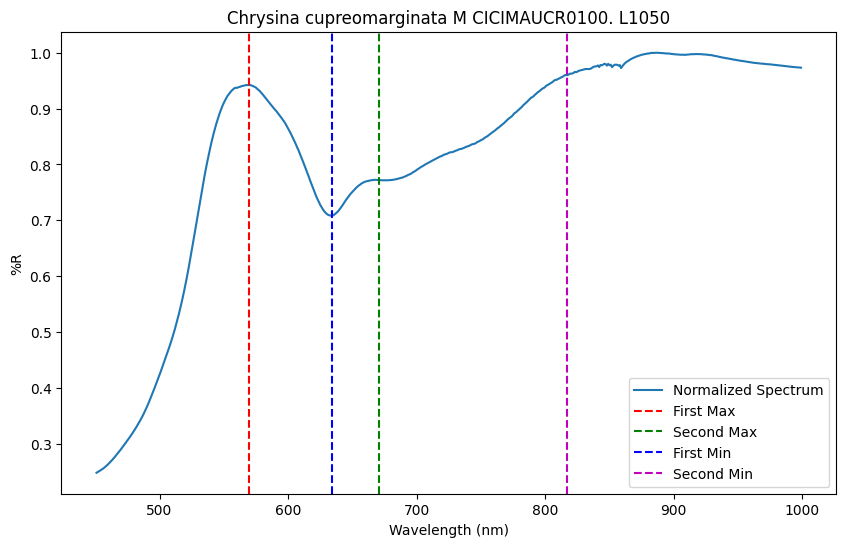

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.144195
202       452.0  0.147730
203       453.0  0.151315
204       454.0  0.154857
205       455.0  0.158380
..          ...       ...
745       995.0  0.949347
746       996.0  0.949369
747       997.0  0.949441
748       998.0  0.949492
749       999.0  0.949637

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.293233
1          251.0   6.296733
2          252.0   6.277967
3          253.0   6.295500
4          254.0   6.254967
...          ...        ...
1745      1995.0  39.886466
1746      1996.0  39.997934
1747      1997.0  40.090784
1748      1998.0  40.189198
1749      1999.0  40.271696

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [133 449] [584. 900.] [65.870167 91.62302 ]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=78.41141999999999, 
                  bottom_thr=0.0, top_t

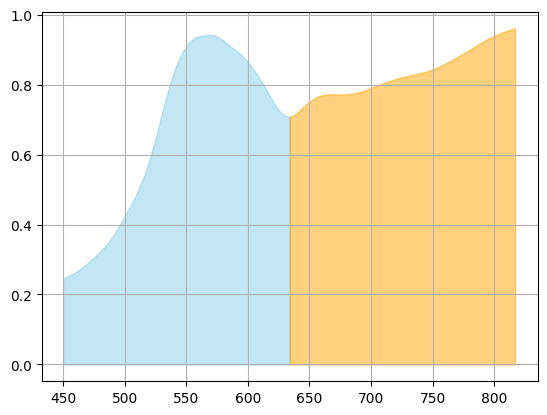

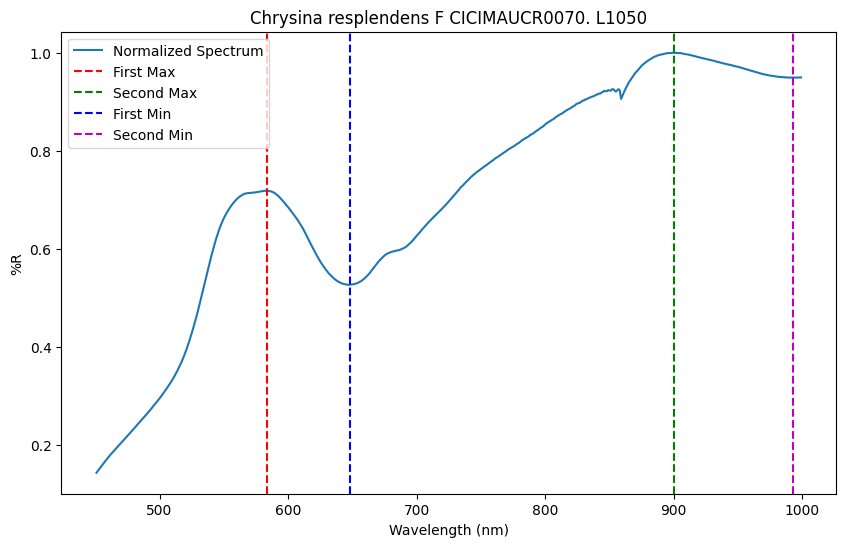

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.303192
202       452.0  0.305645
203       453.0  0.308070
204       454.0  0.310266
205       455.0  0.312147
..          ...       ...
745       995.0  0.672518
746       996.0  0.672118
747       997.0  0.671676
748       998.0  0.671264
749       999.0  0.670936

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   5.869533
1          251.0   5.887500
2          252.0   5.873467
3          253.0   5.862267
4          254.0   5.839167
...          ...        ...
1745      1995.0  21.380497
1746      1996.0  21.433174
1747      1997.0  21.484960
1748      1998.0  21.528167
1749      1999.0  21.580069

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [131 239 369] [582. 690. 820.] [87.7686   67.6363   82.497833]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=61.15786700000001, 
                  bo

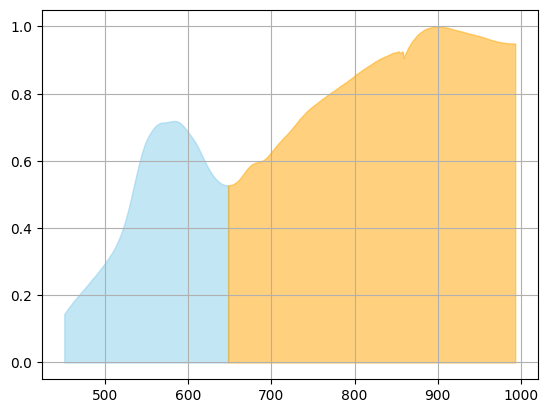

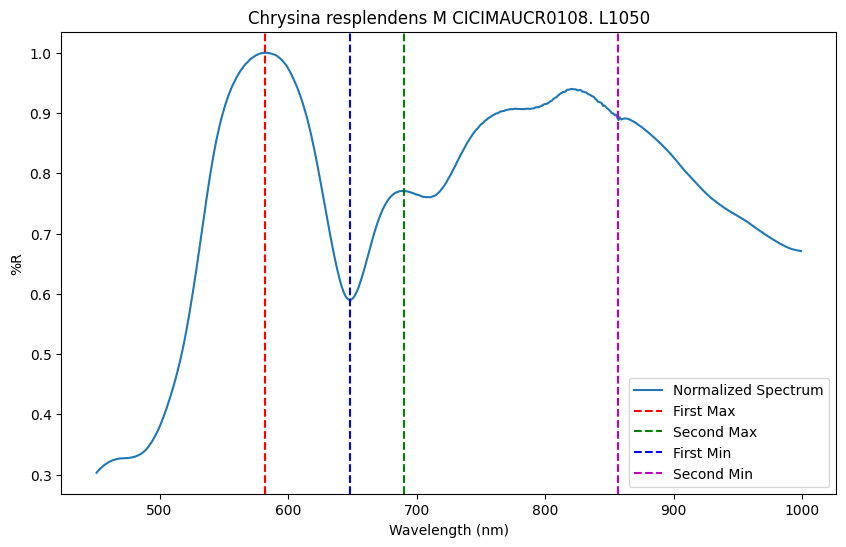

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.262282
202       452.0  0.262907
203       453.0  0.263421
204       454.0  0.264008
205       455.0  0.264688
..          ...       ...
745       995.0  0.668284
746       996.0  0.668207
747       997.0  0.668288
748       998.0  0.668279
749       999.0  0.668341

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.194200
1          251.0   6.197733
2          252.0   6.177767
3          253.0   6.188833
4          254.0   6.157033
...          ...        ...
1745      1995.0  22.713185
1746      1996.0  22.758276
1747      1997.0  22.786411
1748      1998.0  22.830100
1749      1999.0  22.854833

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [131 325 432 546] [582. 776. 883. 997.] [79.316367 96.655833 71.136403 64.59397 ]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=71.3047, 
           

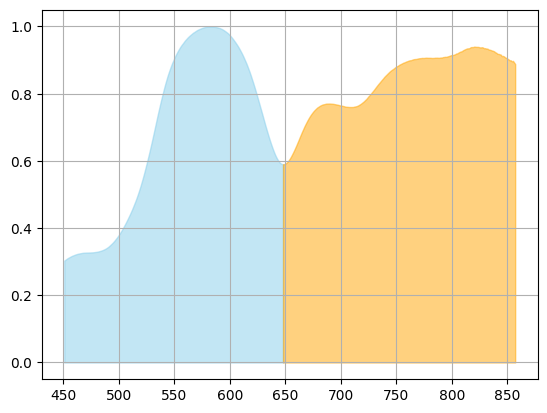

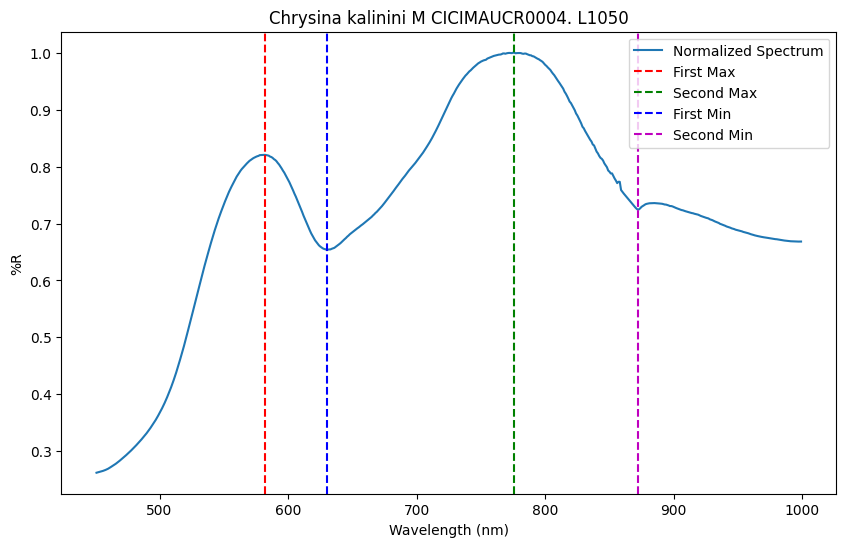

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.257340
202       452.0  0.260039
203       453.0  0.262594
204       454.0  0.264921
205       455.0  0.267197
..          ...       ...
745       995.0  0.666757
746       996.0  0.664854
747       997.0  0.663077
748       998.0  0.661286
749       999.0  0.659467

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   5.846467
1          251.0   5.821533
2          252.0   5.819633
3          253.0   5.814900
4          254.0   5.776500
...          ...        ...
1745      1995.0  25.560632
1746      1996.0  25.613848
1747      1997.0  25.674020
1748      1998.0  25.727900
1749      1999.0  25.779044

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [145 352] [596. 803.] [68.202033 90.0212  ]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=66.855167, 
                  bottom_thr=0.0, top_thr=66.85

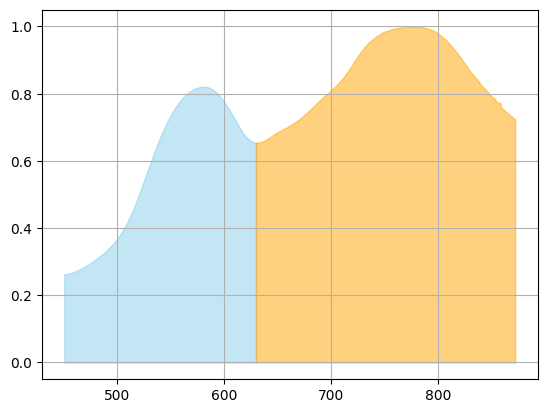

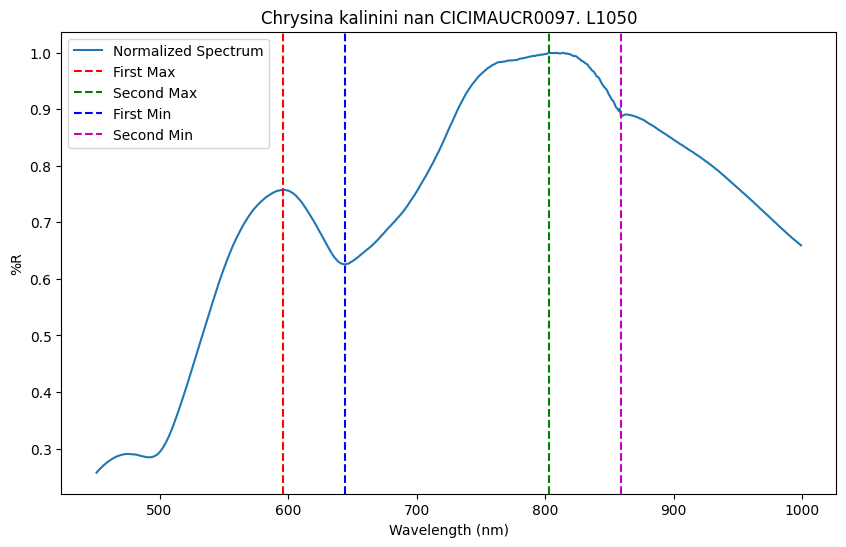

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
192       451.0  0.294595
193       452.0  0.296199
194       453.0  0.299093
195       454.0  0.301954
196       455.0  0.304765
..          ...       ...
736       995.0  0.886400
737       996.0  0.886241
738       997.0  0.886059
739       998.0  0.885927
740       999.0  0.885777

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          259.0   3.762066
1          260.0   3.759897
2          261.0   3.755702
3          262.0   3.752036
4          263.0   3.749770
...          ...        ...
1736      1995.0  10.968492
1737      1996.0  10.979798
1738      1997.0  11.014905
1739      1998.0  11.050137
1740      1999.0  11.059130

[1741 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [128 307 416] [579. 758. 867.] [18.157826 18.901424 22.058561]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=15.560224000000002, 
                  b

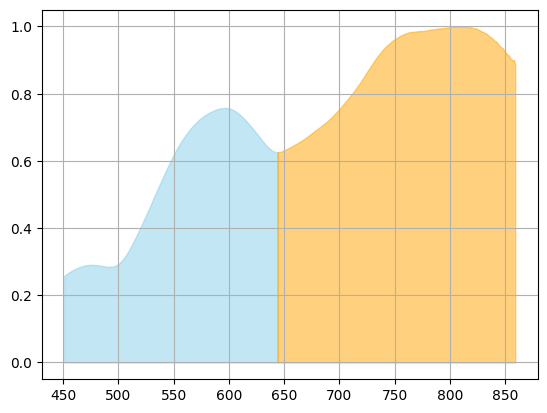

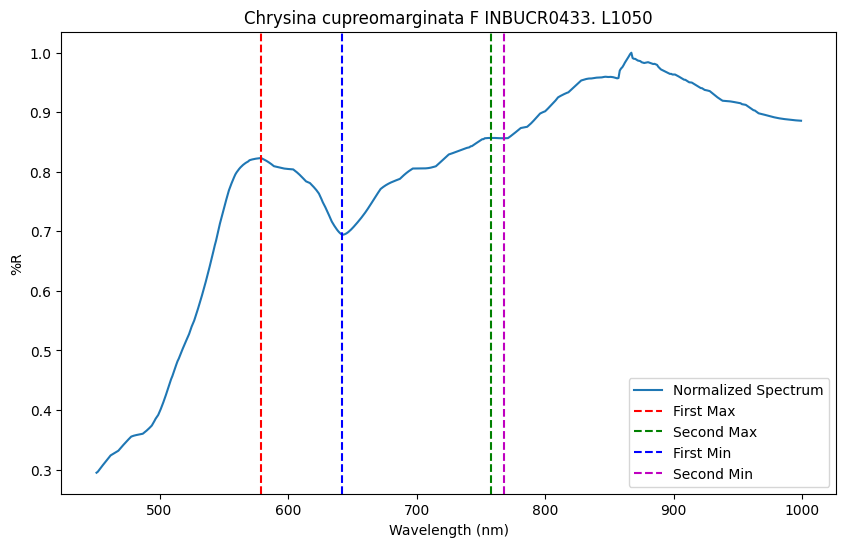

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.245954
202       452.0  0.246864
203       453.0  0.247939
204       454.0  0.248846
205       455.0  0.249678
..          ...       ...
745       995.0  0.743330
746       996.0  0.743598
747       997.0  0.743757
748       998.0  0.743964
749       999.0  0.744083

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   3.783033
1          251.0   3.775633
2          252.0   3.797833
3          253.0   3.752567
4          254.0   3.771033
...          ...        ...
1745      1995.0  14.908235
1746      1996.0  14.936671
1747      1997.0  14.975531
1748      1998.0  15.019068
1749      1999.0  15.052768

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [101 321 467] [552. 772. 918.] [38.339233 61.2709   45.859368]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=46.201066999999995, 
                  b

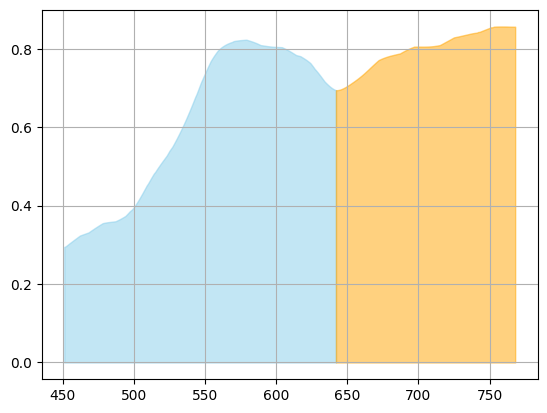

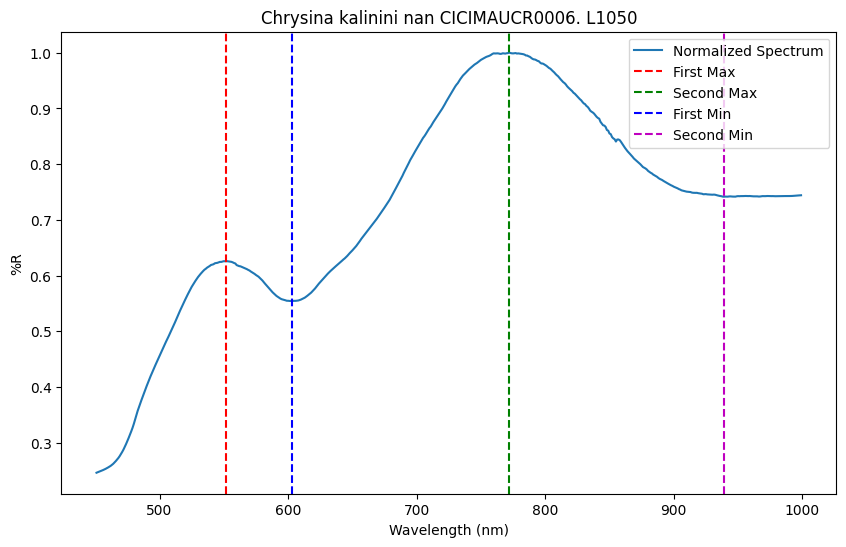

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.257333
202       452.0  0.259025
203       453.0  0.260838
204       454.0  0.262592
205       455.0  0.264601
..          ...       ...
745       995.0  0.996044
746       996.0  0.996987
747       997.0  0.998028
748       998.0  0.998680
749       999.0  1.000000

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   4.707333
1          251.0   4.727667
2          252.0   4.693633
3          253.0   4.685000
4          254.0   4.715367
...          ...        ...
1745      1995.0  13.829563
1746      1996.0  13.893894
1747      1997.0  13.916141
1748      1998.0  13.920316
1749      1999.0  13.955846

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [ 95 353 512] [546. 804. 963.] [46.767033 49.726467 49.015611]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=37.615502, 
                  bottom_thr

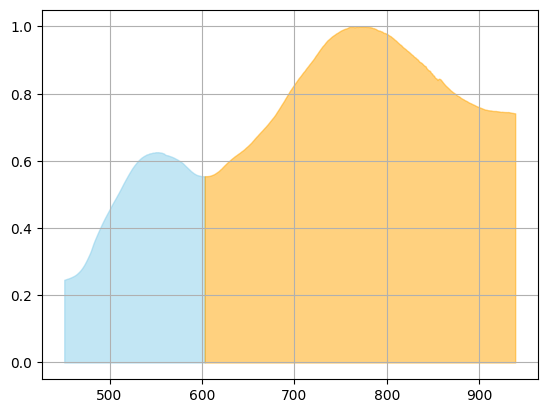

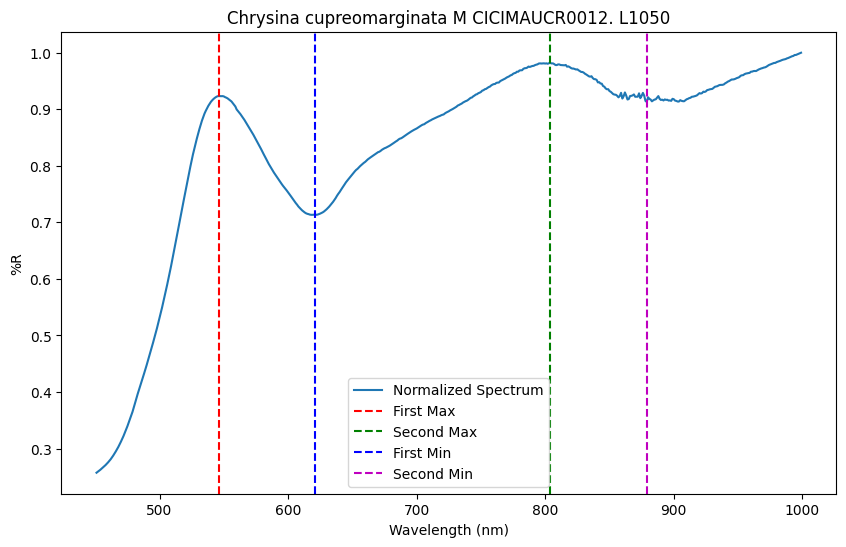

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.226461
202       452.0  0.225857
203       453.0  0.225260
204       454.0  0.224872
205       455.0  0.224605
..          ...       ...
745       995.0  0.892387
746       996.0  0.891848
747       997.0  0.891238
748       998.0  0.890729
749       999.0  0.890379

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.522400
1          251.0   6.509100
2          252.0   6.472900
3          253.0   6.470850
4          254.0   6.405500
...          ...        ...
1745      1995.0  15.842243
1746      1996.0  15.878753
1747      1997.0  15.918560
1748      1998.0  15.960838
1749      1999.0  15.995246

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [118 221 443] [569. 672. 894.] [70.669425 54.838825 71.421432]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=55.395157, 
                  bottom_thr

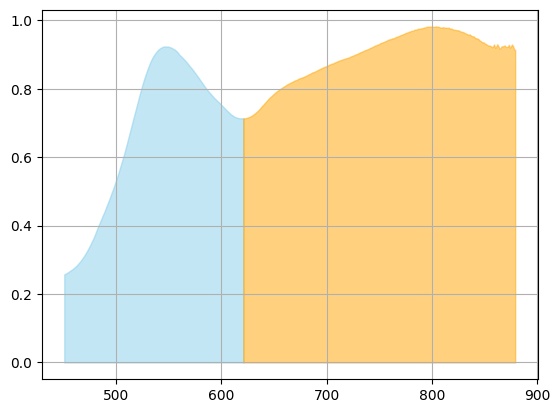

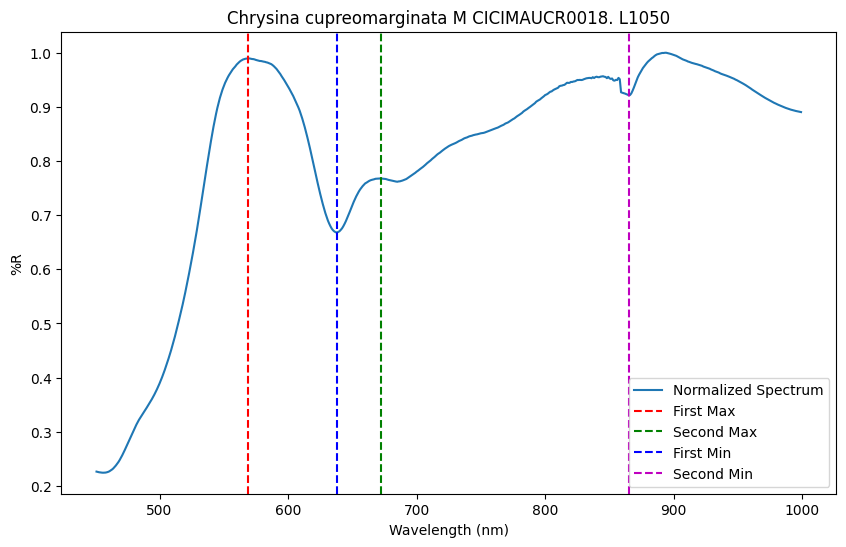

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.275482
202       452.0  0.278677
203       453.0  0.281548
204       454.0  0.284380
205       455.0  0.287160
..          ...       ...
745       995.0  0.642810
746       996.0  0.642426
747       997.0  0.642305
748       998.0  0.641784
749       999.0  0.641297

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.077967
1          251.0   6.042900
2          252.0   6.015433
3          253.0   6.005967
4          254.0   6.013433
...          ...        ...
1745      1995.0  22.518141
1746      1996.0  22.600915
1747      1997.0  22.618767
1748      1998.0  22.663347
1749      1999.0  22.726412

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [130 339] [581. 790.] [69.402067 97.7267  ]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=70.804767, 
                  bottom_thr=0.0, top_thr=70.80

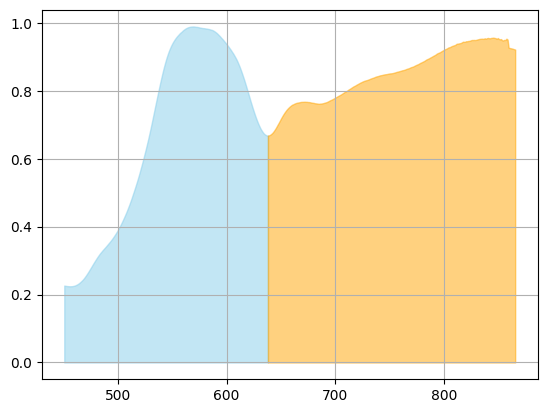

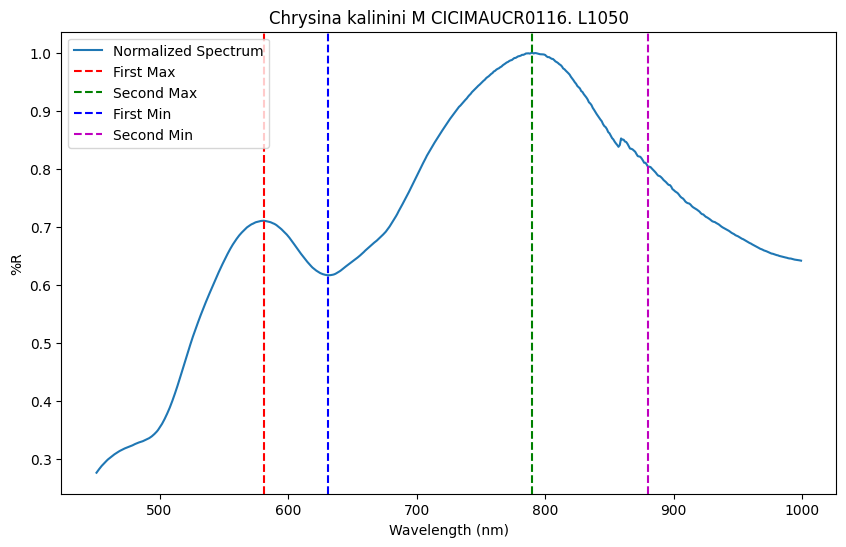

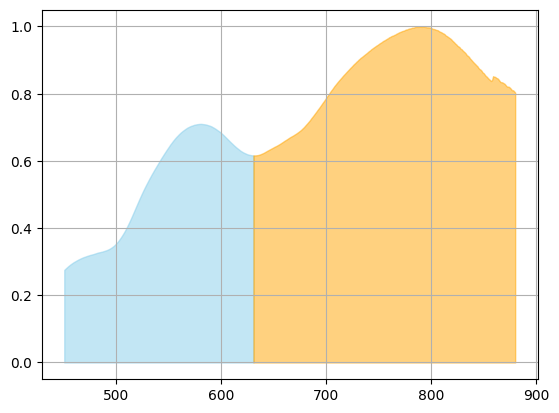

In [13]:
gamma_area_under_curve_first_min_cut_data = feature_and_label_extractor(Metric = Gamma_Area_Under_Curve_First_Min_Cut, 
                                                          config_file = metric_configuration_file, 
                                                          spectra =  train_spectra, 
                                                          debug = debug,
                                                          collection_list = training_collection_list,
                                                          plot = True)

#print(gamma_area_under_curve_first_min_cut_data)

### Gamma_Vector_Relative_Reflectance

df peaklist get max       wavelength         %R
0          250.0   6.059033
1          251.0   6.052233
2          252.0   6.033967
3          253.0   6.025833
4          254.0   5.993167
...          ...        ...
1745      1995.0  11.156570
1746      1996.0  11.178961
1747      1997.0  11.205560
1748      1998.0  11.239035
1749      1999.0  11.260341

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


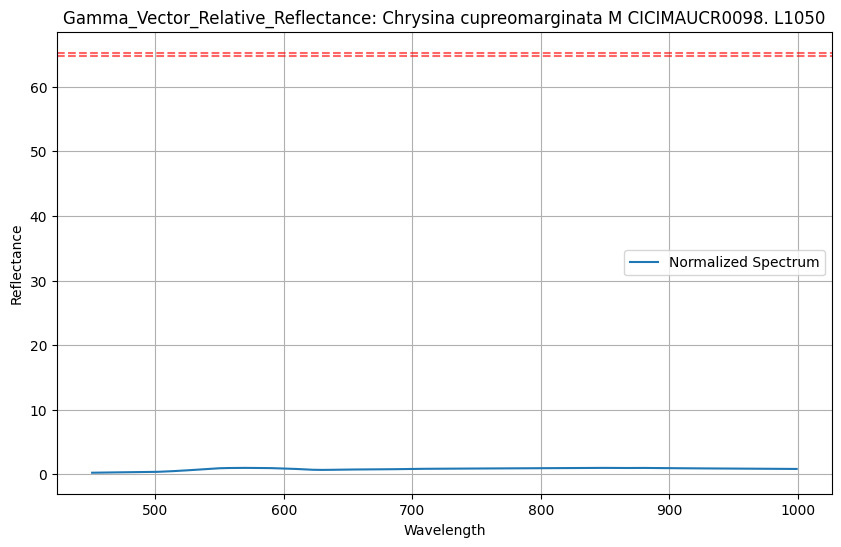

df peaklist get max       wavelength         %R
0          250.0   6.627333
1          251.0   6.592200
2          252.0   6.599233
3          253.0   6.566000
4          254.0   6.547600
...          ...        ...
1745      1995.0  19.848957
1746      1996.0  19.924566
1747      1997.0  19.976946
1748      1998.0  20.043284
1749      1999.0  20.093886

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


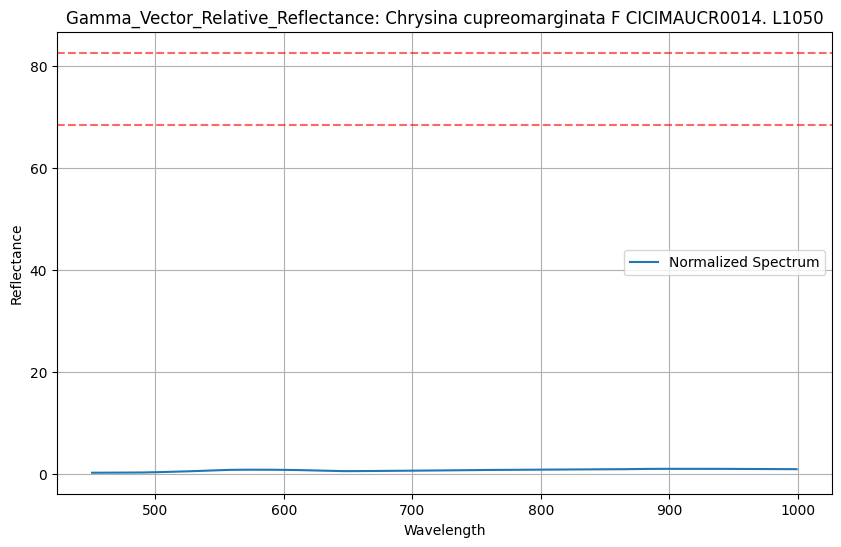

df peaklist get max       wavelength         %R
0          284.0   6.686712
1          285.0   6.674540
2          286.0   6.661835
3          287.0   6.651822
4          288.0   6.641055
...          ...        ...
1711      1995.0  14.717545
1712      1996.0  14.771121
1713      1997.0  14.844056
1714      1998.0  14.915941
1715      1999.0  14.952284

[1716 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


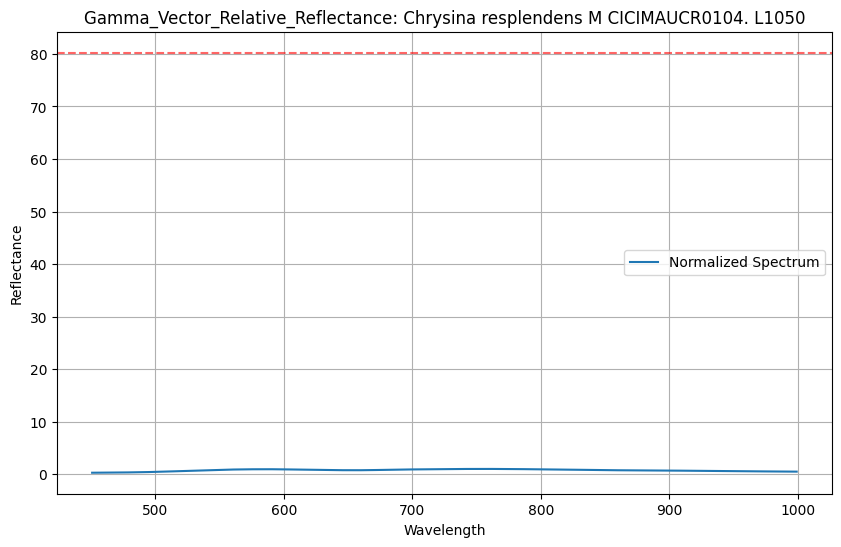

df peaklist get max       wavelength         %R
0          250.0   6.387750
1          251.0   6.331750
2          252.0   6.312100
3          253.0   6.257850
4          254.0   6.327550
...          ...        ...
1745      1995.0  18.687320
1746      1996.0  18.731023
1747      1997.0  18.770373
1748      1998.0  18.795870
1749      1999.0  18.845905

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


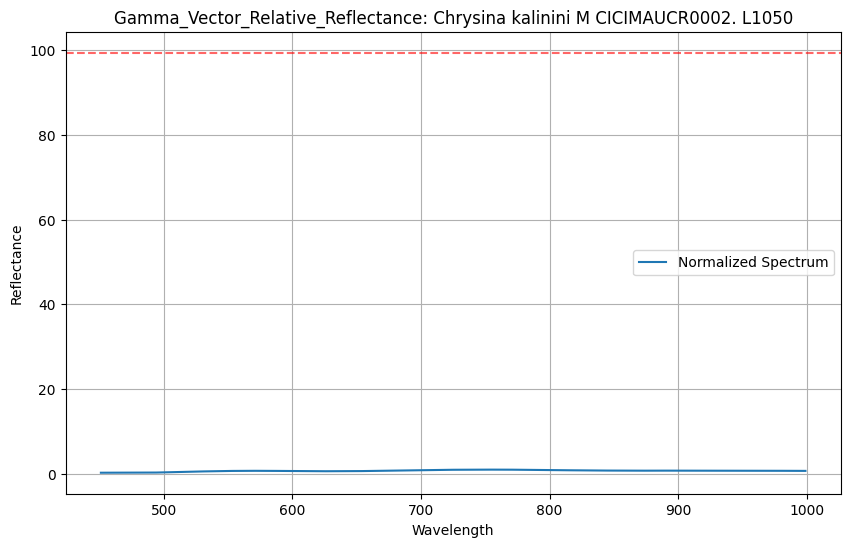

df peaklist get max       wavelength         %R
0          250.0   5.691060
1          251.0   5.661860
2          252.0   5.673480
3          253.0   5.679480
4          254.0   5.647980
...          ...        ...
1745      1995.0  18.102704
1746      1996.0  18.168534
1747      1997.0  18.218921
1748      1998.0  18.262135
1749      1999.0  18.307018

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


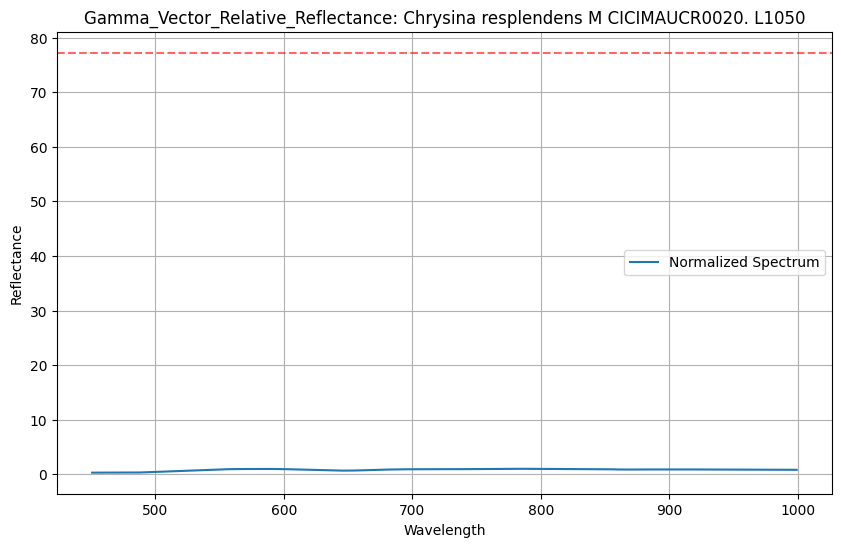

df peaklist get max       wavelength         %R
0          250.0   6.264300
1          251.0   6.269200
2          252.0   6.246400
3          253.0   6.215900
4          254.0   6.196933
...          ...        ...
1745      1995.0  21.554323
1746      1996.0  21.613598
1747      1997.0  21.652972
1748      1998.0  21.694313
1749      1999.0  21.724248

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


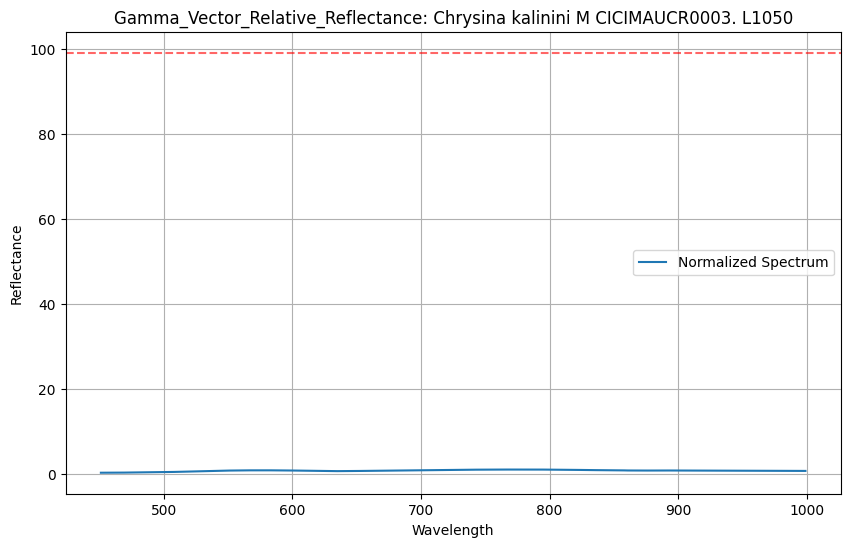

df peaklist get max       wavelength         %R
0          250.0   6.108967
1          251.0   6.101900
2          252.0   6.079567
3          253.0   6.068200
4          254.0   6.084167
...          ...        ...
1745      1995.0  21.369957
1746      1996.0  21.406533
1747      1997.0  21.467083
1748      1998.0  21.489857
1749      1999.0  21.513057

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


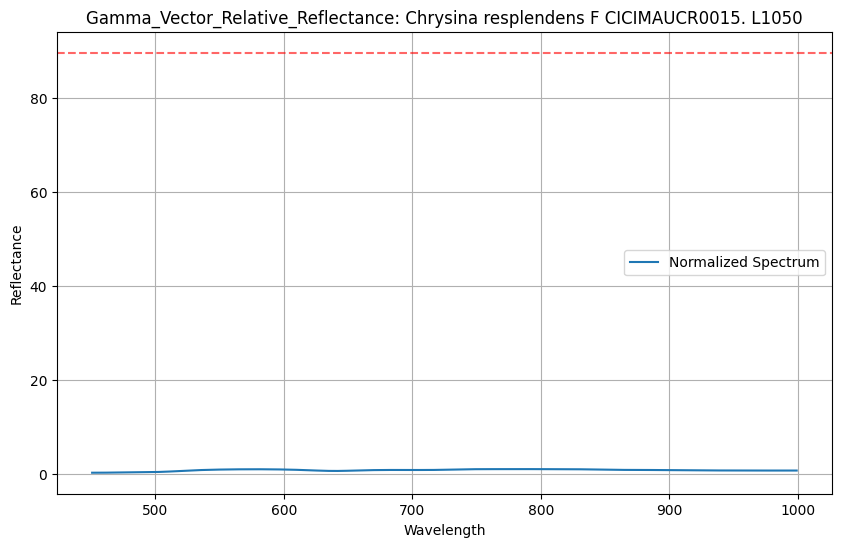

df peaklist get max       wavelength         %R
0          250.0   6.227900
1          251.0   6.212500
2          252.0   6.174433
3          253.0   6.191967
4          254.0   6.170433
...          ...        ...
1745      1995.0  19.510730
1746      1996.0  19.579398
1747      1997.0  19.636737
1748      1998.0  19.681657
1749      1999.0  19.693297

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


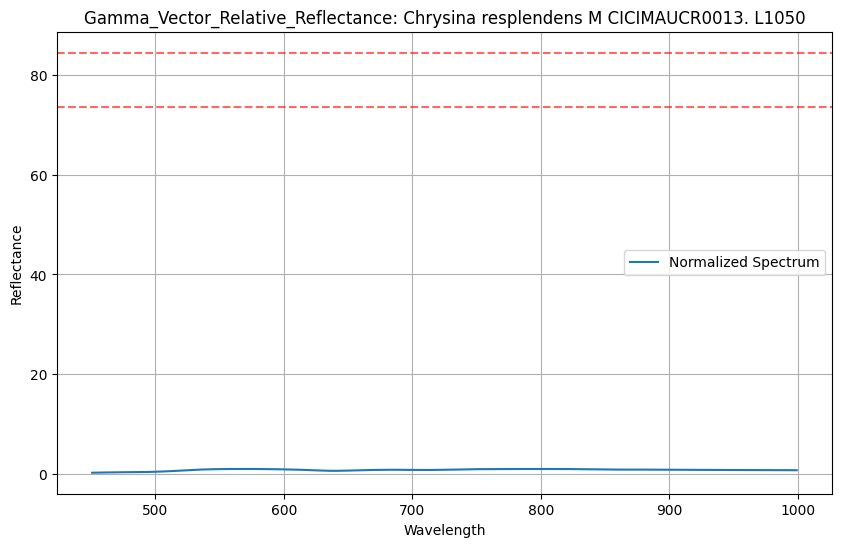

df peaklist get max       wavelength         %R
0          250.0   6.735933
1          251.0   6.753967
2          252.0   6.719933
3          253.0   6.718033
4          254.0   6.693367
...          ...        ...
1745      1995.0  25.450630
1746      1996.0  25.529126
1747      1997.0  25.583074
1748      1998.0  25.643778
1749      1999.0  25.706195

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


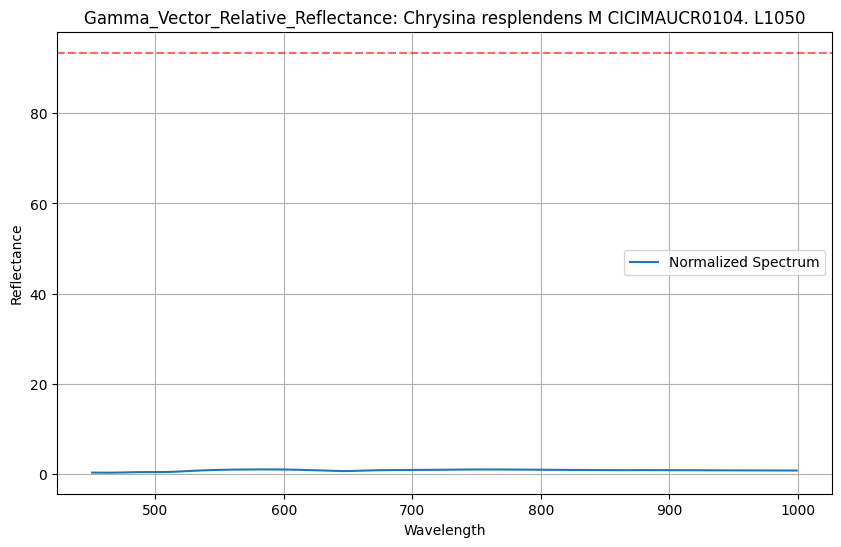

df peaklist get max       wavelength         %R
0          284.0   1.005921
1          285.0   1.130663
2          286.0   1.250340
3          287.0   1.369472
4          288.0   1.481847
...          ...        ...
1711      1995.0  18.162503
1712      1996.0  18.240729
1713      1997.0  18.277948
1714      1998.0  18.348353
1715      1999.0  18.375664

[1716 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


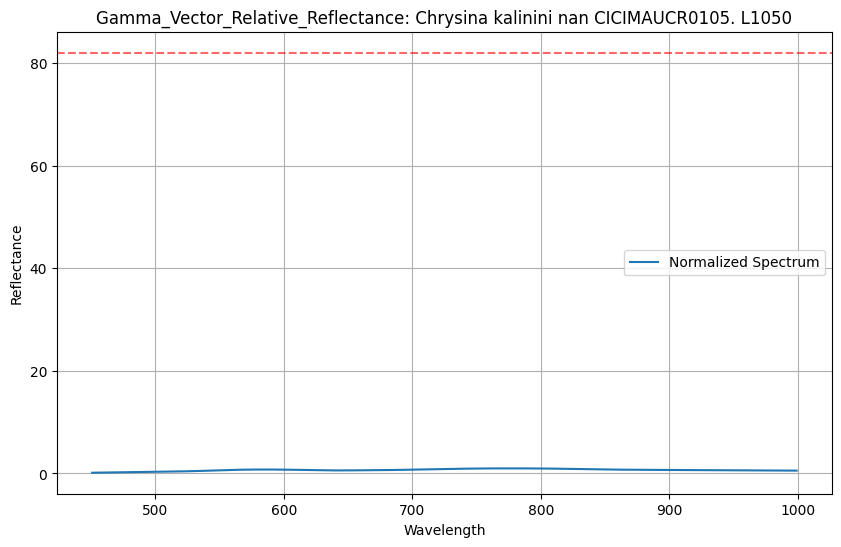

df peaklist get max       wavelength        %R
0          284.0  6.299151
1          285.0  6.281825
2          286.0  6.266644
3          287.0  6.251455
4          288.0  6.236319
...          ...       ...
1711      1995.0  9.722714
1712      1996.0  9.732779
1713      1997.0  9.714617
1714      1998.0  9.703111
1715      1999.0  9.703096

[1716 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


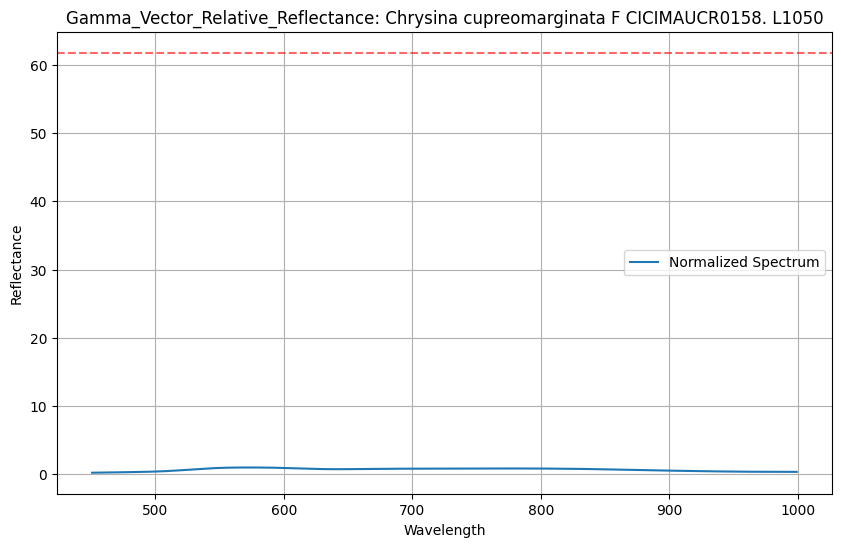

df peaklist get max       wavelength         %R
0          250.0   6.390333
1          251.0   6.389500
2          252.0   6.380300
3          253.0   6.354200
4          254.0   6.367300
...          ...        ...
1745      1995.0  21.051944
1746      1996.0  21.140525
1747      1997.0  21.215391
1748      1998.0  21.294900
1749      1999.0  21.366582

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


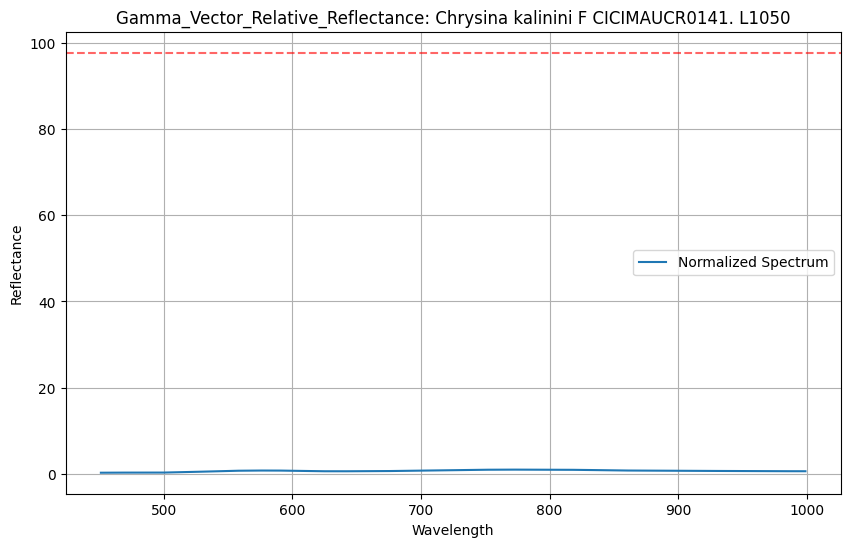

df peaklist get max       wavelength         %R
0          250.0   5.702700
1          251.0   5.706900
2          252.0   5.700400
3          253.0   5.654850
4          254.0   5.641550
...          ...        ...
1745      1995.0  26.643802
1746      1996.0  26.747612
1747      1997.0  26.857658
1748      1998.0  26.933957
1749      1999.0  26.996144

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


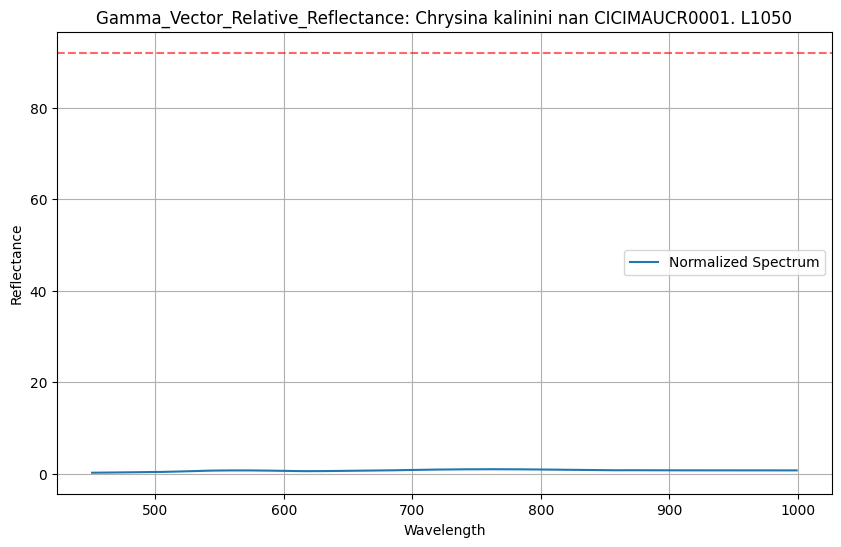

df peaklist get max       wavelength         %R
0          250.0   6.259033
1          251.0   6.240933
2          252.0   6.239333
3          253.0   6.206267
4          254.0   6.186733
...          ...        ...
1745      1995.0  14.655396
1746      1996.0  14.684346
1747      1997.0  14.717271
1748      1998.0  14.721940
1749      1999.0  14.748202

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


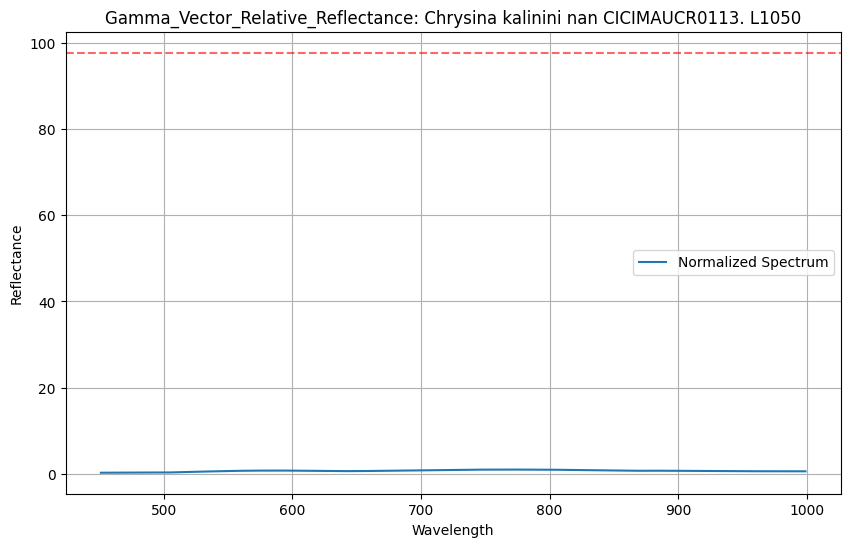

df peaklist get max       wavelength         %R
0          250.0   6.822967
1          251.0   6.775467
2          252.0   6.775167
3          253.0   6.801867
4          254.0   6.749833
...          ...        ...
1745      1995.0  12.911374
1746      1996.0  12.928366
1747      1997.0  12.949518
1748      1998.0  12.973254
1749      1999.0  12.961911

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


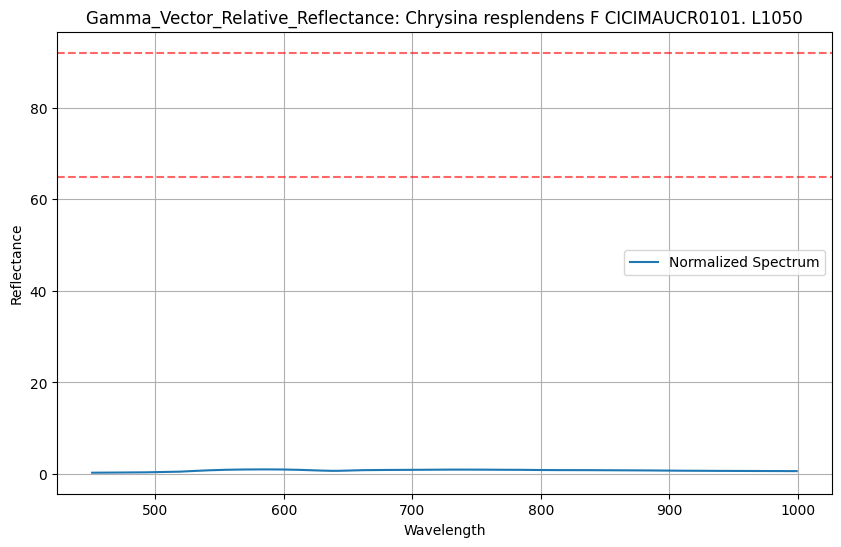

df peaklist get max       wavelength         %R
0          250.0   6.008450
1          251.0   5.972775
2          252.0   5.954625
3          253.0   5.952850
4          254.0   5.908875
...          ...        ...
1745      1995.0  29.522203
1746      1996.0  29.621899
1747      1997.0  29.713628
1748      1998.0  29.778892
1749      1999.0  29.870986

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


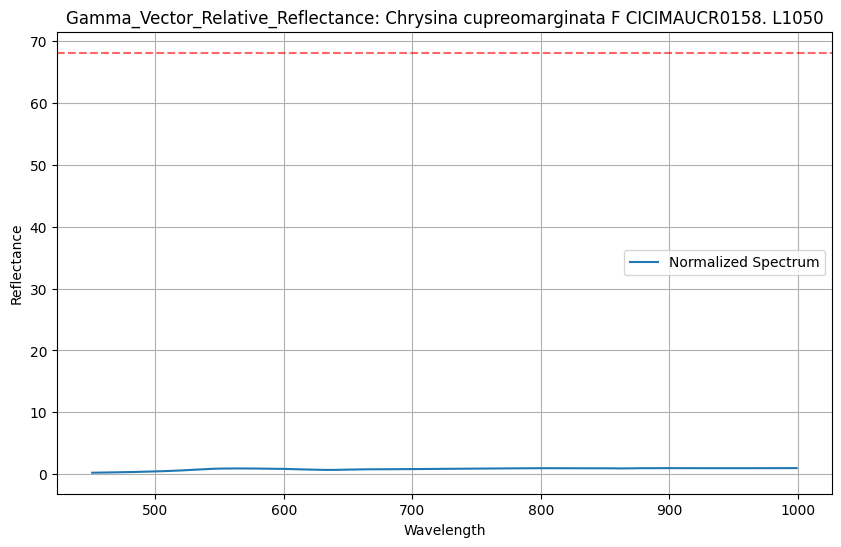

df peaklist get max       wavelength         %R
0          250.0   5.191600
1          251.0   5.191933
2          252.0   5.193233
3          253.0   5.187600
4          254.0   5.191667
...          ...        ...
1745      1995.0  21.857982
1746      1996.0  21.912365
1747      1997.0  21.975321
1748      1998.0  22.028556
1749      1999.0  22.073970

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


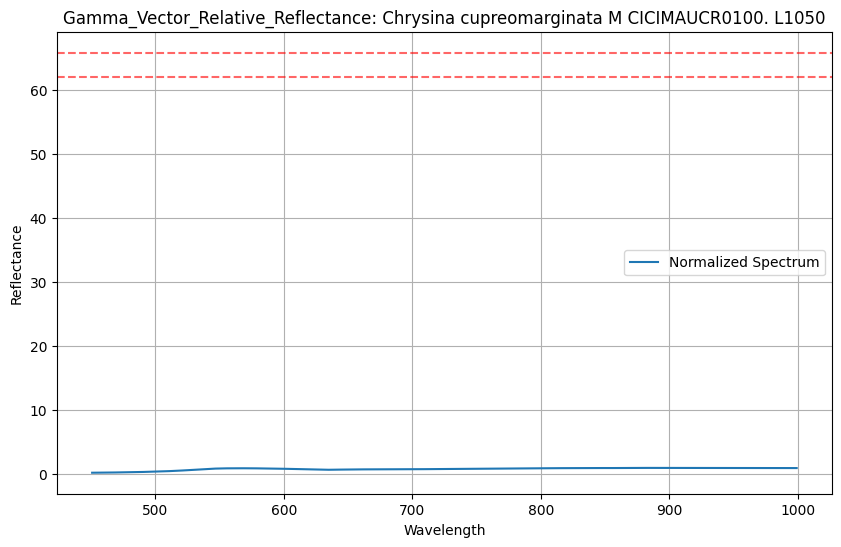

df peaklist get max       wavelength         %R
0          250.0   6.293233
1          251.0   6.296733
2          252.0   6.277967
3          253.0   6.295500
4          254.0   6.254967
...          ...        ...
1745      1995.0  39.886466
1746      1996.0  39.997934
1747      1997.0  40.090784
1748      1998.0  40.189198
1749      1999.0  40.271696

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


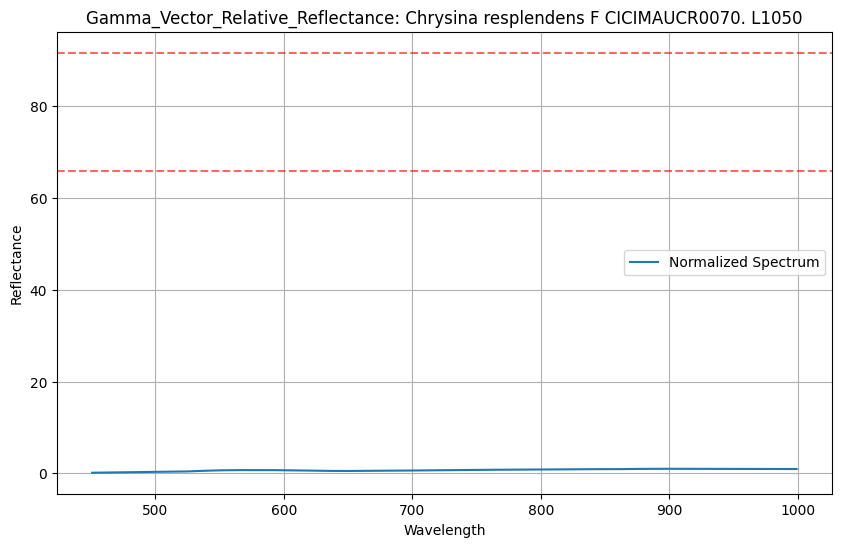

df peaklist get max       wavelength         %R
0          250.0   5.869533
1          251.0   5.887500
2          252.0   5.873467
3          253.0   5.862267
4          254.0   5.839167
...          ...        ...
1745      1995.0  21.380497
1746      1996.0  21.433174
1747      1997.0  21.484960
1748      1998.0  21.528167
1749      1999.0  21.580069

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


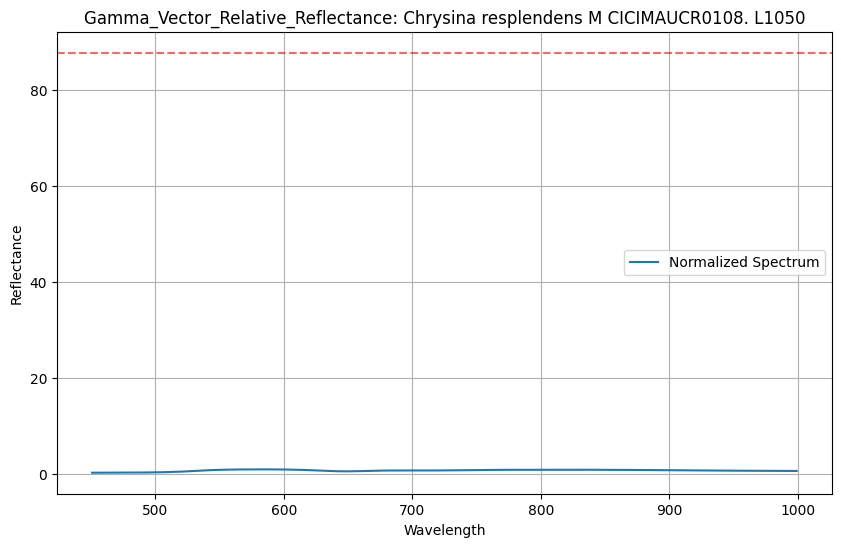

df peaklist get max       wavelength         %R
0          250.0   6.194200
1          251.0   6.197733
2          252.0   6.177767
3          253.0   6.188833
4          254.0   6.157033
...          ...        ...
1745      1995.0  22.713185
1746      1996.0  22.758276
1747      1997.0  22.786411
1748      1998.0  22.830100
1749      1999.0  22.854833

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


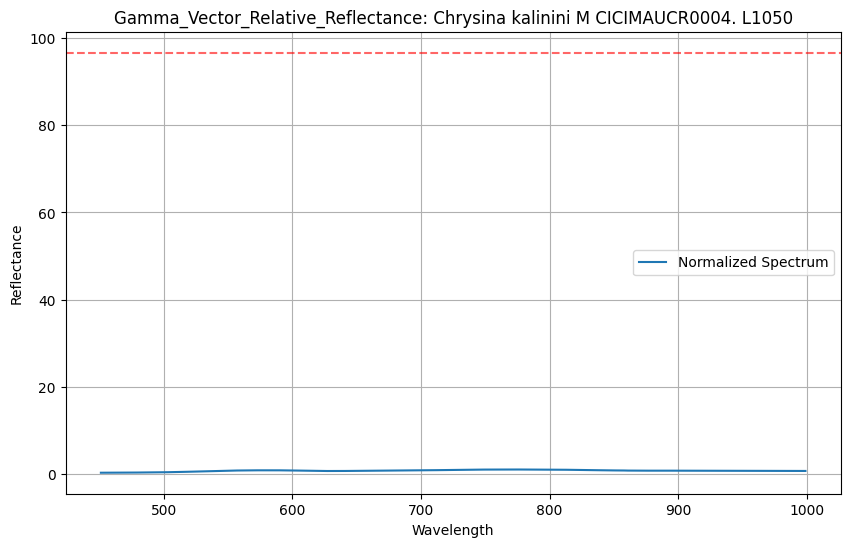

df peaklist get max       wavelength         %R
0          250.0   5.846467
1          251.0   5.821533
2          252.0   5.819633
3          253.0   5.814900
4          254.0   5.776500
...          ...        ...
1745      1995.0  25.560632
1746      1996.0  25.613848
1747      1997.0  25.674020
1748      1998.0  25.727900
1749      1999.0  25.779044

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


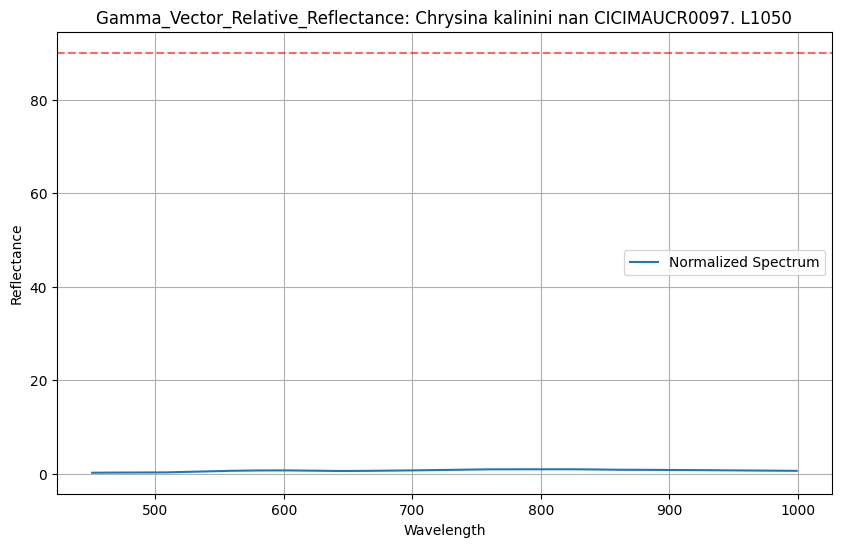

df peaklist get max       wavelength         %R
0          259.0   3.762066
1          260.0   3.759897
2          261.0   3.755702
3          262.0   3.752036
4          263.0   3.749770
...          ...        ...
1736      1995.0  10.968492
1737      1996.0  10.979798
1738      1997.0  11.014905
1739      1998.0  11.050137
1740      1999.0  11.059130

[1741 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


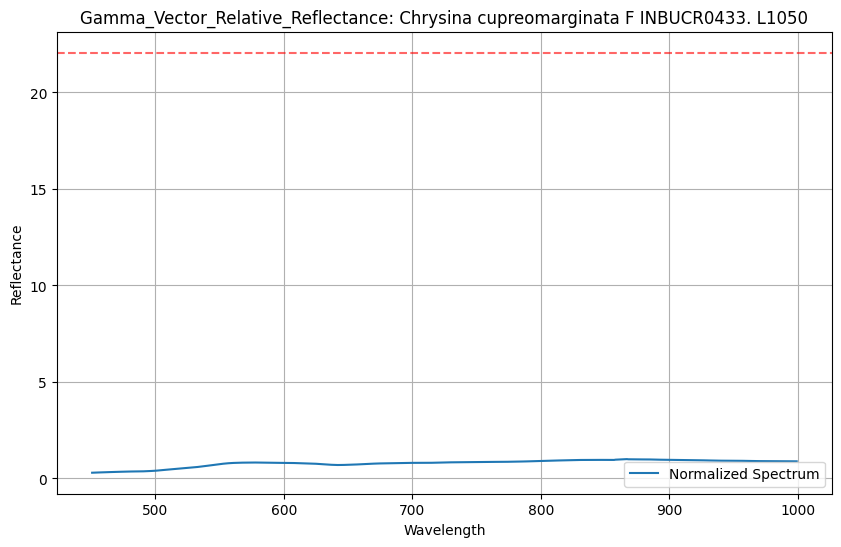

df peaklist get max       wavelength         %R
0          250.0   3.783033
1          251.0   3.775633
2          252.0   3.797833
3          253.0   3.752567
4          254.0   3.771033
...          ...        ...
1745      1995.0  14.908235
1746      1996.0  14.936671
1747      1997.0  14.975531
1748      1998.0  15.019068
1749      1999.0  15.052768

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


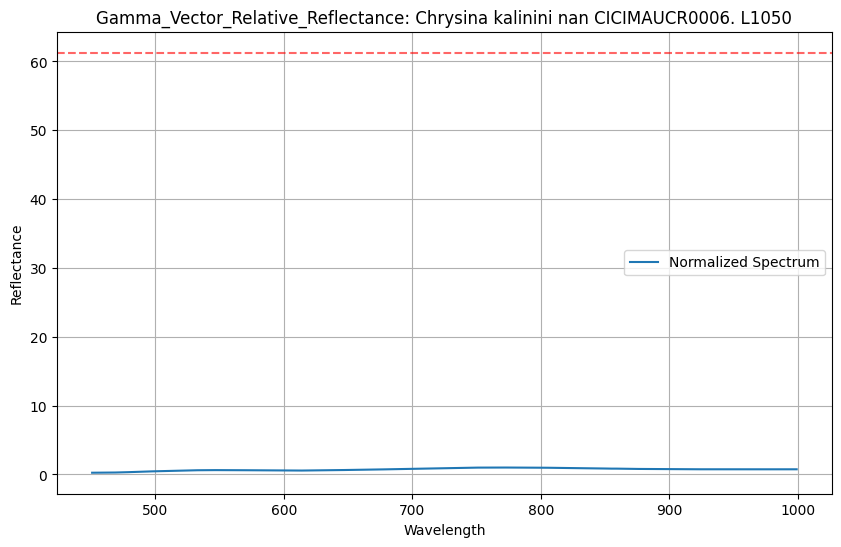

df peaklist get max       wavelength         %R
0          250.0   4.707333
1          251.0   4.727667
2          252.0   4.693633
3          253.0   4.685000
4          254.0   4.715367
...          ...        ...
1745      1995.0  13.829563
1746      1996.0  13.893894
1747      1997.0  13.916141
1748      1998.0  13.920316
1749      1999.0  13.955846

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


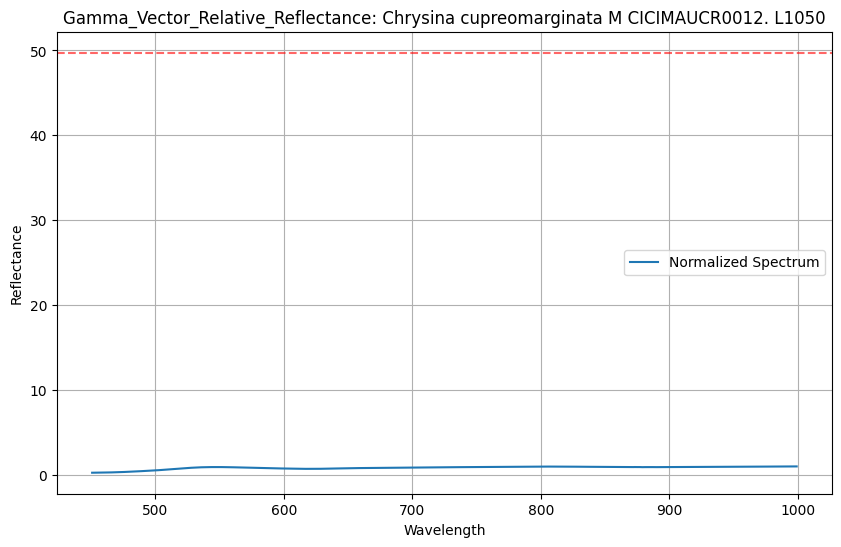

df peaklist get max       wavelength         %R
0          250.0   6.522400
1          251.0   6.509100
2          252.0   6.472900
3          253.0   6.470850
4          254.0   6.405500
...          ...        ...
1745      1995.0  15.842243
1746      1996.0  15.878753
1747      1997.0  15.918560
1748      1998.0  15.960838
1749      1999.0  15.995246

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


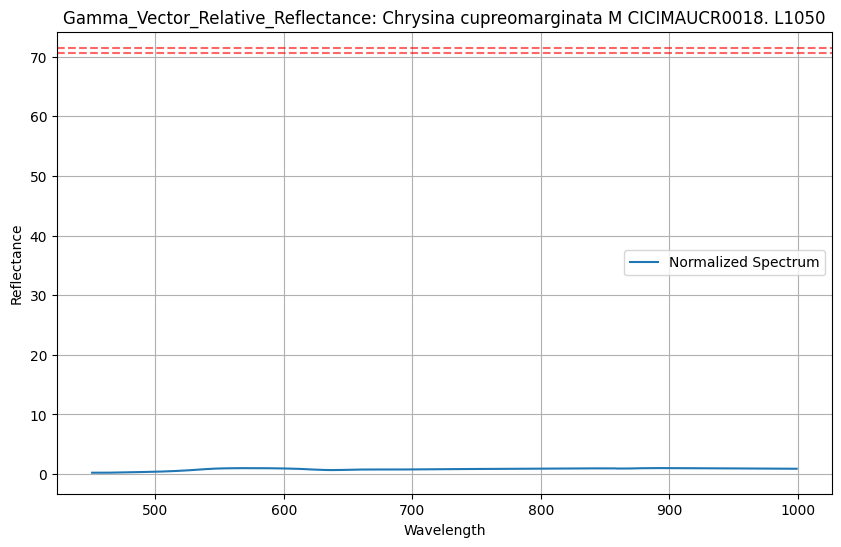

df peaklist get max       wavelength         %R
0          250.0   6.077967
1          251.0   6.042900
2          252.0   6.015433
3          253.0   6.005967
4          254.0   6.013433
...          ...        ...
1745      1995.0  22.518141
1746      1996.0  22.600915
1747      1997.0  22.618767
1748      1998.0  22.663347
1749      1999.0  22.726412

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


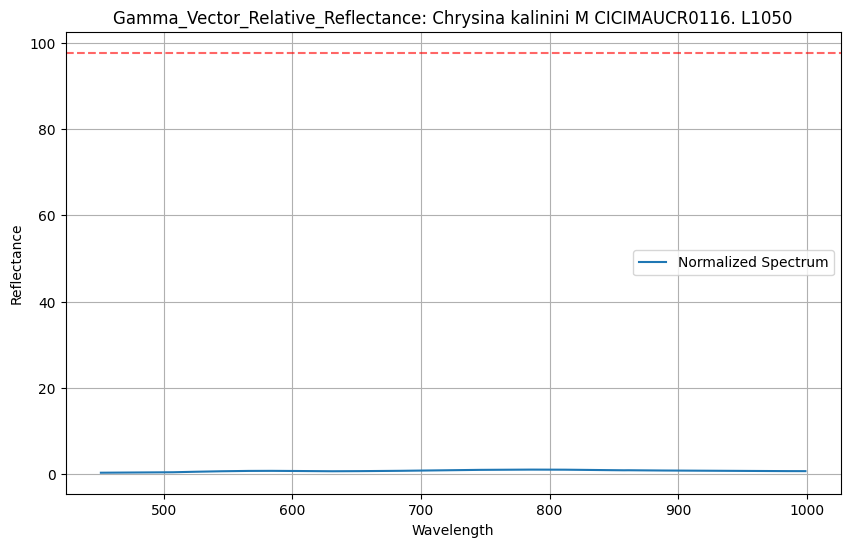

In [14]:
gamma_vector_relative_reflectance_data = feature_and_label_extractor(Metric = Gamma_Vector_Relative_Reflectance, 
                                                          config_file = metric_configuration_file, 
                                                          spectra =  train_spectra, 
                                                          debug = True,
                                                          collection_list = training_collection_list,
                                                          plot = True)


#print(gamma_vector_relative_reflectance_data)


In [15]:
import numpy as np

def pad_list(lst, filler=0):
    metrics = lst[1]

    # Find the maximum length among all arrays
    max_length = max(m.shape[-1] for m in metrics)

    padded_list = []
    for element in metrics:
        # Ensure numpy array
        arr = np.asarray(element)

        current_length = arr.shape[-1]
        if current_length < max_length:
            pad_width = max_length - current_length
            if arr.ndim == 1:
                # Pad 1D vector
                padded = np.pad(arr, (0, pad_width), constant_values=filler)
            elif arr.ndim == 2:
                # Pad 2D matrix along last axis
                pad_shape = ((0, 0), (0, pad_width))
                padded = np.pad(arr, pad_shape, constant_values=filler)
            else:
                raise ValueError(f"Unsupported ndim={arr.ndim} in element {arr}")
        else:
            padded = arr

        padded_list.append(padded)

    return [lst[0], padded_list, lst[2]]


#pad_list(gamma_vector_relative_reflectance_data)

In [16]:
wavelength_vector_data = feature_and_label_extractor(Metric = Wavelength_Vector, 
                                                          config_file = metric_configuration_file, 
                                                          spectra =  train_spectra, 
                                                          debug = debug,
                                                          collection_list = training_collection_list,
                                                          plot = True)


#print(wavelength_vector_data)

data = pad_list(wavelength_vector_data)
#print(data)

df peaklist get max       wavelength         %R
0          250.0   6.059033
1          251.0   6.052233
2          252.0   6.033967
3          253.0   6.025833
4          254.0   5.993167
...          ...        ...
1745      1995.0  11.156570
1746      1996.0  11.178961
1747      1997.0  11.205560
1748      1998.0  11.239035
1749      1999.0  11.260341

[1750 rows x 2 columns]
min 450.0 max 1000.0
df peaklist get max       wavelength         %R
0          250.0   6.627333
1          251.0   6.592200
2          252.0   6.599233
3          253.0   6.566000
4          254.0   6.547600
...          ...        ...
1745      1995.0  19.848957
1746      1996.0  19.924566
1747      1997.0  19.976946
1748      1998.0  20.043284
1749      1999.0  20.093886

[1750 rows x 2 columns]
min 450.0 max 1000.0
df peaklist get max       wavelength         %R
0          284.0   6.686712
1          285.0   6.674540
2          286.0   6.661835
3          287.0   6.651822
4          288.0   6.641055
...     

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=48.893533000000005, 
                  bottom_thr=0.0, top_thr=48.893533000000005, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.059033
1          251.0   6.052233
2          252.0   6.033967
3          253.0   6.025833
4          254.0   5.993167
...          ...        ...
1745      1995.0  11.156570
1746      1996.0  11.178961
1747      1997.0  11.205560
1748      1998.0  11.239035
1749      1999.0  11.260341

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


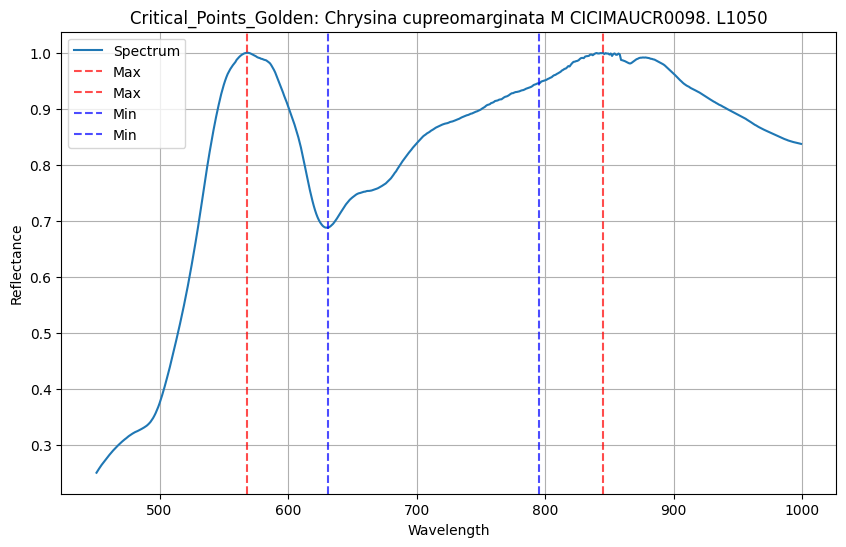

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=63.223845000000004, 
                  bottom_thr=0.0, top_thr=63.223845000000004, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.627333
1          251.0   6.592200
2          252.0   6.599233
3          253.0   6.566000
4          254.0   6.547600
...          ...        ...
1745      1995.0  19.848957
1746      1996.0  19.924566
1747      1997.0  19.976946
1748      1998.0  20.043284
1749      1999.0  20.093886

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


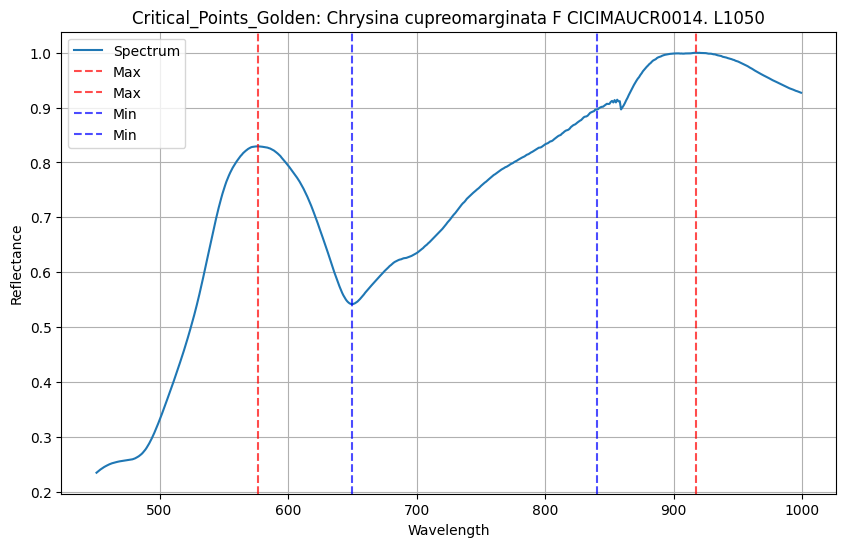

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=58.027733999999995, 
                  bottom_thr=0.0, top_thr=58.027733999999995, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          284.0   6.686712
1          285.0   6.674540
2          286.0   6.661835
3          287.0   6.651822
4          288.0   6.641055
...          ...        ...
1711      1995.0  14.717545
1712      1996.0  14.771121
1713      1997.0  14.844056
1714      1998.0  14.915941
1715      1999.0  14.952284

[1716 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


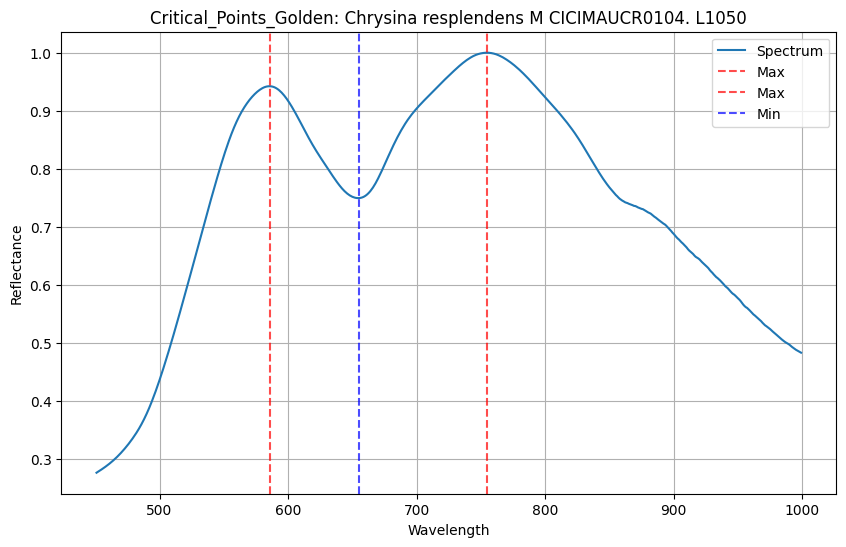

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=72.57525, 
                  bottom_thr=0.0, top_thr=72.57525, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.387750
1          251.0   6.331750
2          252.0   6.312100
3          253.0   6.257850
4          254.0   6.327550
...          ...        ...
1745      1995.0  18.687320
1746      1996.0  18.731023
1747      1997.0  18.770373
1748      1998.0  18.795870
1749      1999.0  18.845905

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


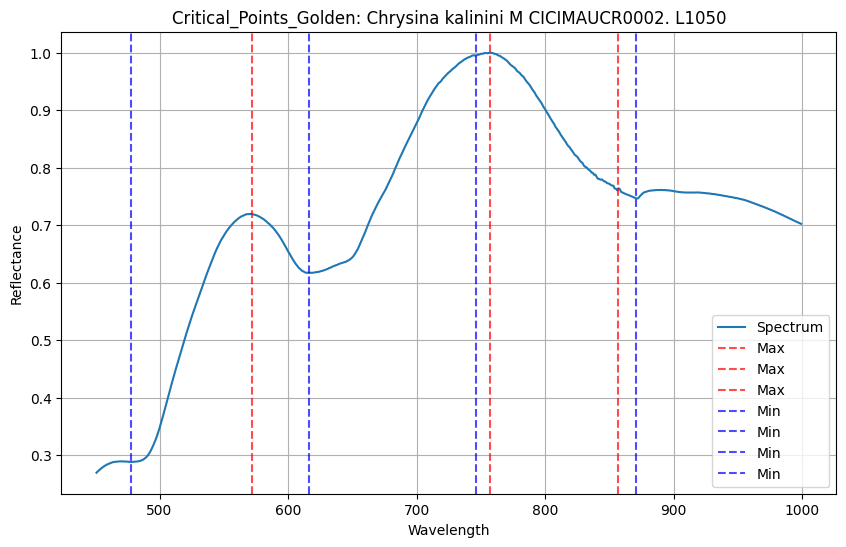

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=55.50916000000001, 
                  bottom_thr=0.0, top_thr=55.50916000000001, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   5.691060
1          251.0   5.661860
2          252.0   5.673480
3          253.0   5.679480
4          254.0   5.647980
...          ...        ...
1745      1995.0  18.102704
1746      1996.0  18.168534
1747      1997.0  18.218921
1748      1998.0  18.262135
1749      1999.0  18.307018

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


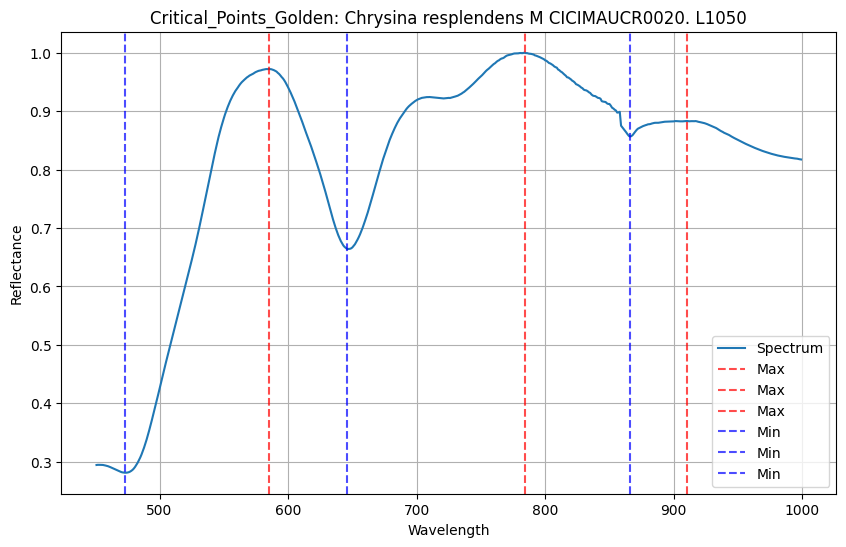

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=74.529467, 
                  bottom_thr=0.0, top_thr=74.529467, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.264300
1          251.0   6.269200
2          252.0   6.246400
3          253.0   6.215900
4          254.0   6.196933
...          ...        ...
1745      1995.0  21.554323
1746      1996.0  21.613598
1747      1997.0  21.652972
1748      1998.0  21.694313
1749      1999.0  21.724248

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


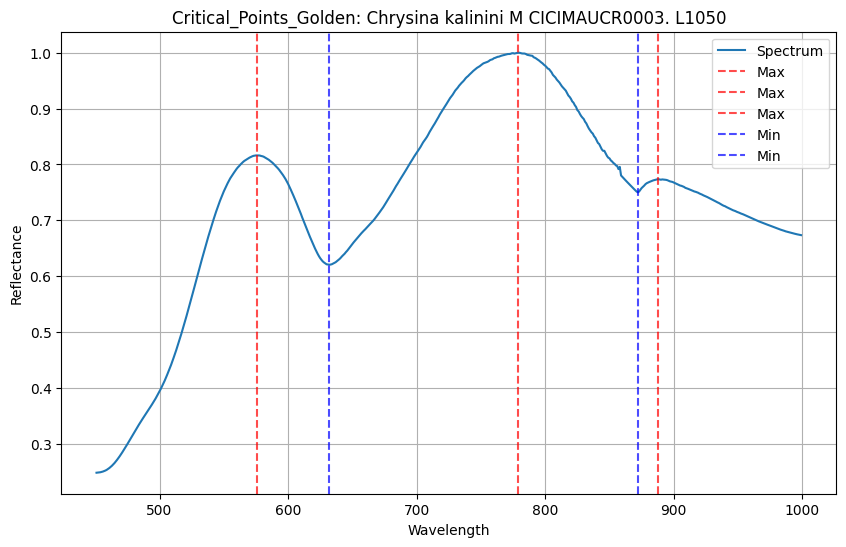

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=68.777667, 
                  bottom_thr=0.0, top_thr=68.777667, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.108967
1          251.0   6.101900
2          252.0   6.079567
3          253.0   6.068200
4          254.0   6.084167
...          ...        ...
1745      1995.0  21.369957
1746      1996.0  21.406533
1747      1997.0  21.467083
1748      1998.0  21.489857
1749      1999.0  21.513057

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


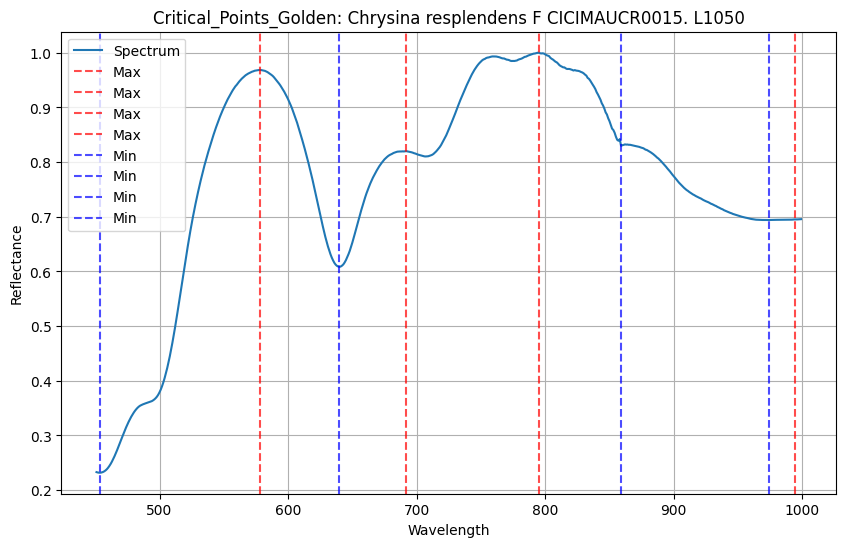

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=64.1527, 
                  bottom_thr=0.0, top_thr=64.1527, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.227900
1          251.0   6.212500
2          252.0   6.174433
3          253.0   6.191967
4          254.0   6.170433
...          ...        ...
1745      1995.0  19.510730
1746      1996.0  19.579398
1747      1997.0  19.636737
1748      1998.0  19.681657
1749      1999.0  19.693297

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


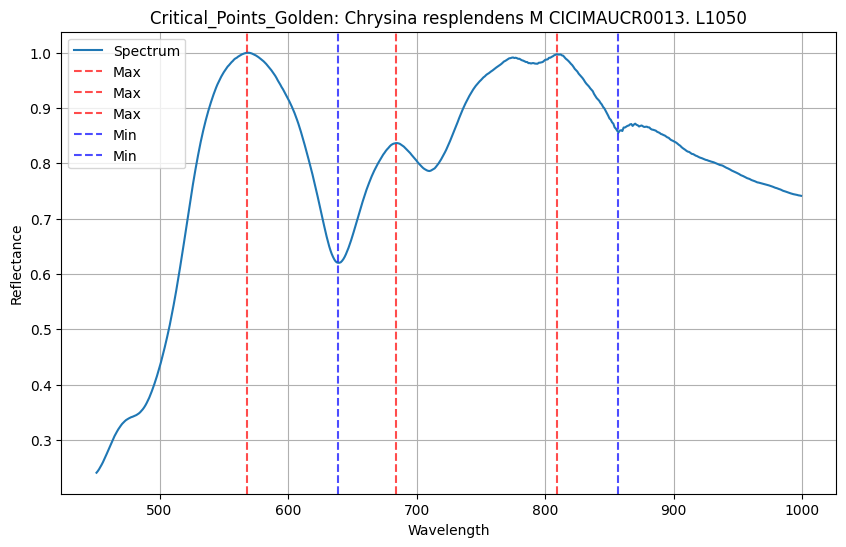

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=68.632466, 
                  bottom_thr=0.0, top_thr=68.632466, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.735933
1          251.0   6.753967
2          252.0   6.719933
3          253.0   6.718033
4          254.0   6.693367
...          ...        ...
1745      1995.0  25.450630
1746      1996.0  25.529126
1747      1997.0  25.583074
1748      1998.0  25.643778
1749      1999.0  25.706195

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


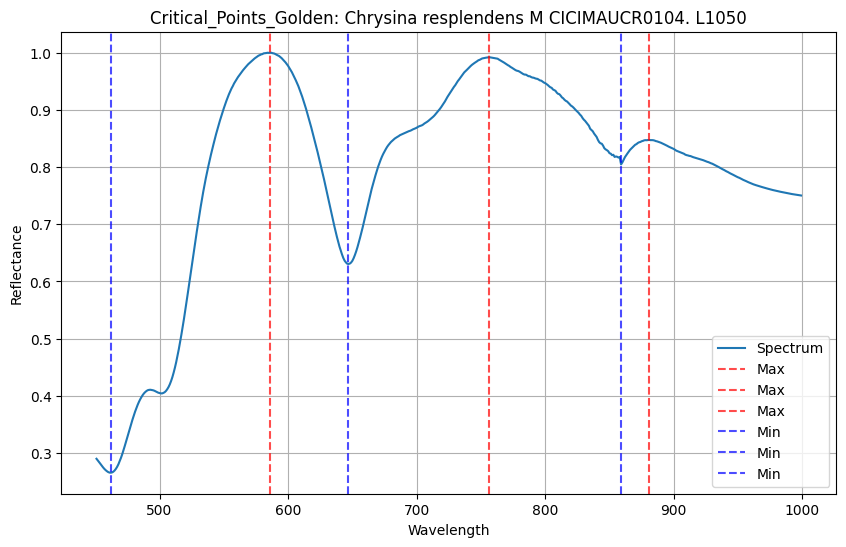

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=69.614549, 
                  bottom_thr=0.0, top_thr=69.614549, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          284.0   1.005921
1          285.0   1.130663
2          286.0   1.250340
3          287.0   1.369472
4          288.0   1.481847
...          ...        ...
1711      1995.0  18.162503
1712      1996.0  18.240729
1713      1997.0  18.277948
1714      1998.0  18.348353
1715      1999.0  18.375664

[1716 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


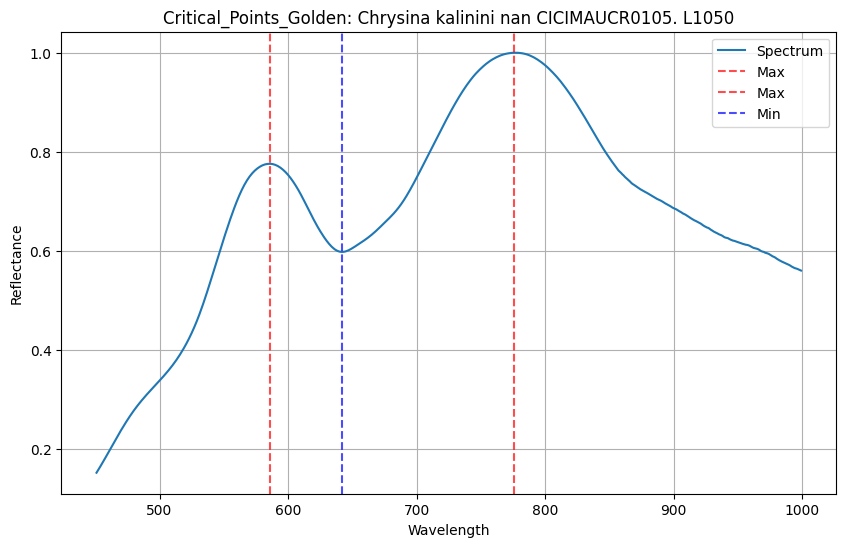

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=47.391498999999996, 
                  bottom_thr=0.0, top_thr=47.391498999999996, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength        %R
0          284.0  6.299151
1          285.0  6.281825
2          286.0  6.266644
3          287.0  6.251455
4          288.0  6.236319
...          ...       ...
1711      1995.0  9.722714
1712      1996.0  9.732779
1713      1997.0  9.714617
1714      1998.0  9.703111
1715      1999.0  9.703096

[1716 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


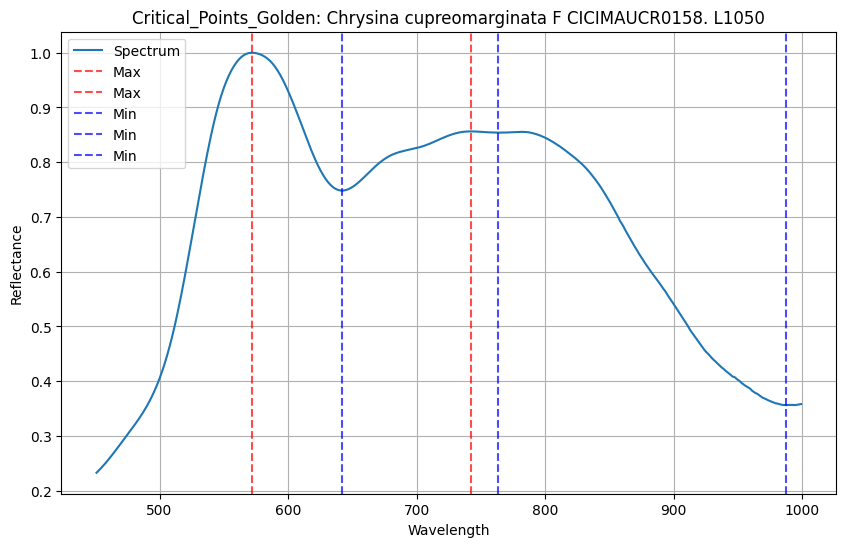

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=70.071434, 
                  bottom_thr=0.0, top_thr=70.071434, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.390333
1          251.0   6.389500
2          252.0   6.380300
3          253.0   6.354200
4          254.0   6.367300
...          ...        ...
1745      1995.0  21.051944
1746      1996.0  21.140525
1747      1997.0  21.215391
1748      1998.0  21.294900
1749      1999.0  21.366582

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


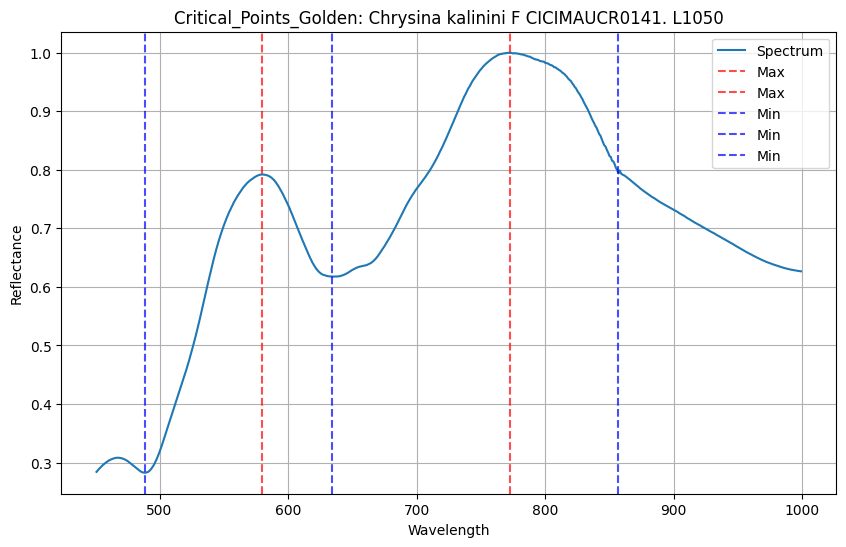

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=70.30927499999999, 
                  bottom_thr=0.0, top_thr=70.30927499999999, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   5.702700
1          251.0   5.706900
2          252.0   5.700400
3          253.0   5.654850
4          254.0   5.641550
...          ...        ...
1745      1995.0  26.643802
1746      1996.0  26.747612
1747      1997.0  26.857658
1748      1998.0  26.933957
1749      1999.0  26.996144

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


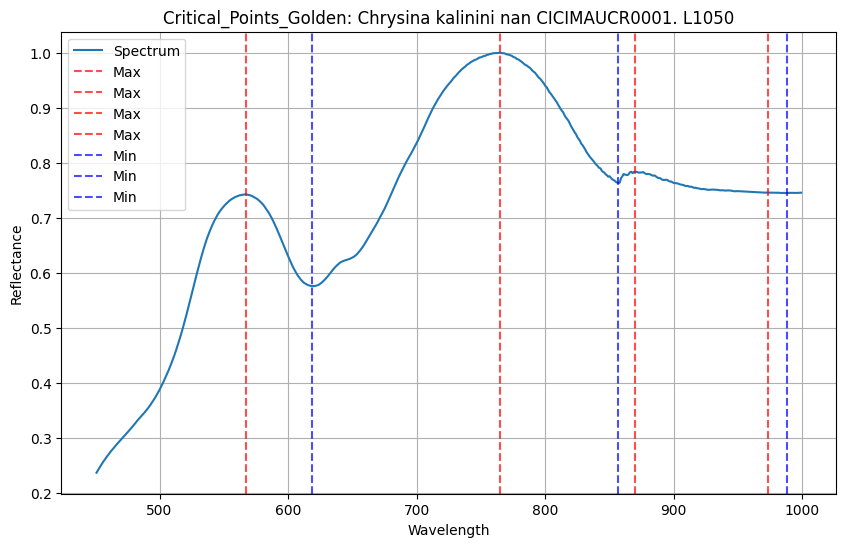

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=71.173166, 
                  bottom_thr=0.0, top_thr=71.173166, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.259033
1          251.0   6.240933
2          252.0   6.239333
3          253.0   6.206267
4          254.0   6.186733
...          ...        ...
1745      1995.0  14.655396
1746      1996.0  14.684346
1747      1997.0  14.717271
1748      1998.0  14.721940
1749      1999.0  14.748202

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


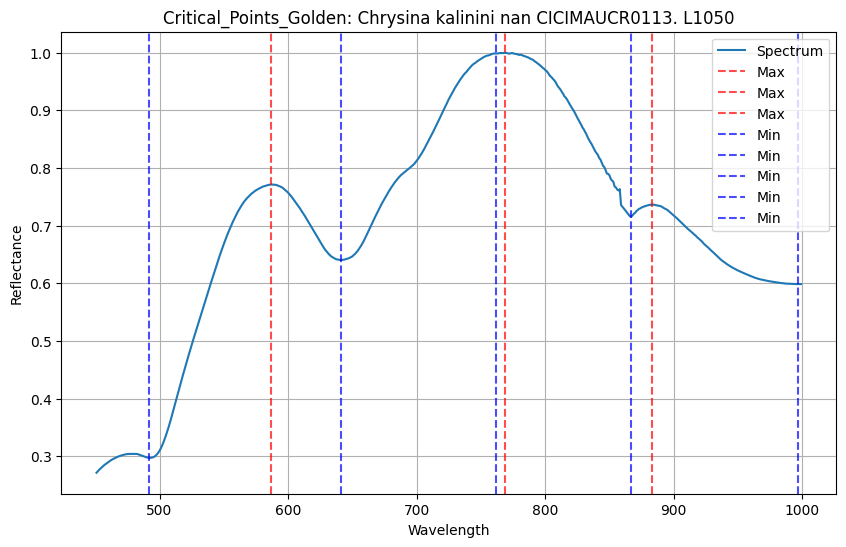

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=67.1612, 
                  bottom_thr=0.0, top_thr=67.1612, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.822967
1          251.0   6.775467
2          252.0   6.775167
3          253.0   6.801867
4          254.0   6.749833
...          ...        ...
1745      1995.0  12.911374
1746      1996.0  12.928366
1747      1997.0  12.949518
1748      1998.0  12.973254
1749      1999.0  12.961911

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


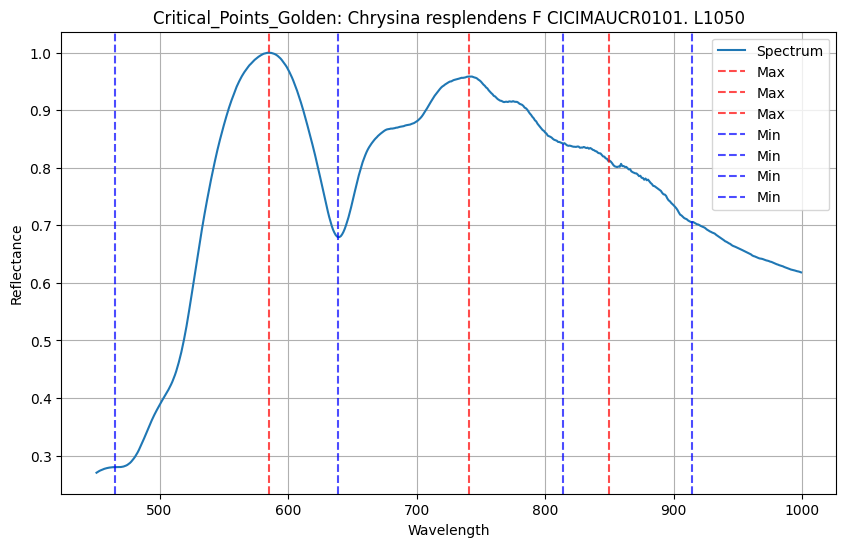

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=50.734972, 
                  bottom_thr=0.0, top_thr=50.734972, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.008450
1          251.0   5.972775
2          252.0   5.954625
3          253.0   5.952850
4          254.0   5.908875
...          ...        ...
1745      1995.0  29.522203
1746      1996.0  29.621899
1747      1997.0  29.713628
1748      1998.0  29.778892
1749      1999.0  29.870986

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


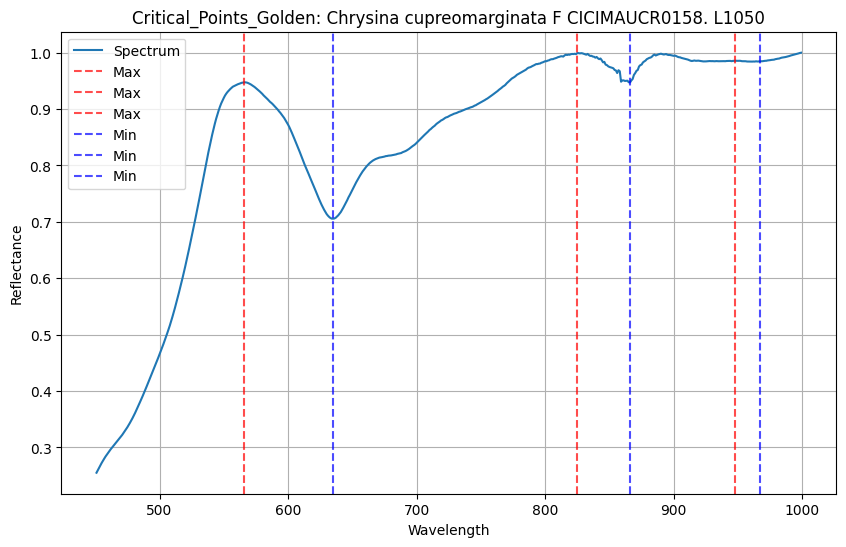

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=49.421255, 
                  bottom_thr=0.0, top_thr=49.421255, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   5.191600
1          251.0   5.191933
2          252.0   5.193233
3          253.0   5.187600
4          254.0   5.191667
...          ...        ...
1745      1995.0  21.857982
1746      1996.0  21.912365
1747      1997.0  21.975321
1748      1998.0  22.028556
1749      1999.0  22.073970

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


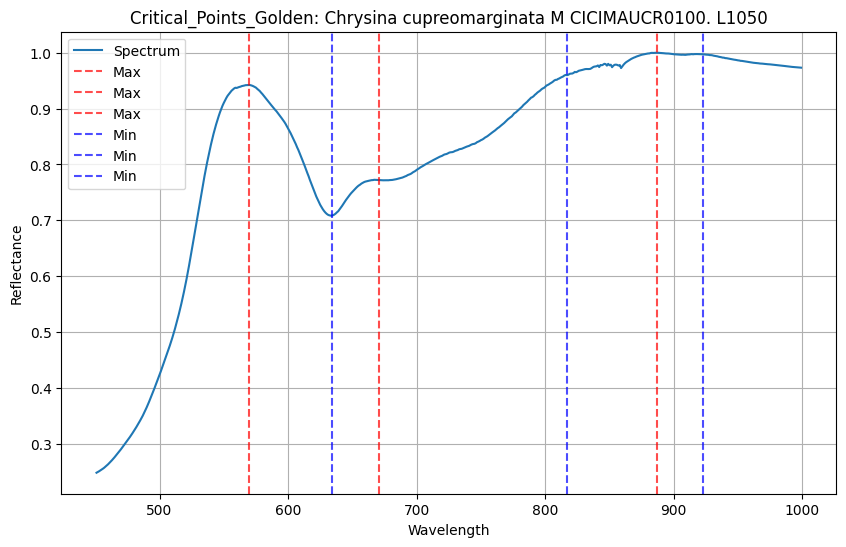

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=78.41141999999999, 
                  bottom_thr=0.0, top_thr=78.41141999999999, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.293233
1          251.0   6.296733
2          252.0   6.277967
3          253.0   6.295500
4          254.0   6.254967
...          ...        ...
1745      1995.0  39.886466
1746      1996.0  39.997934
1747      1997.0  40.090784
1748      1998.0  40.189198
1749      1999.0  40.271696

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


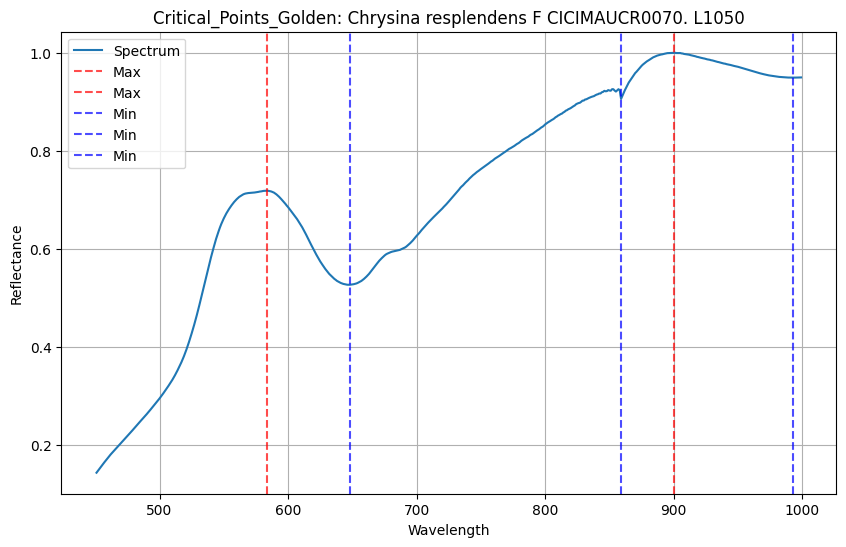

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=61.15786700000001, 
                  bottom_thr=0.0, top_thr=61.15786700000001, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   5.869533
1          251.0   5.887500
2          252.0   5.873467
3          253.0   5.862267
4          254.0   5.839167
...          ...        ...
1745      1995.0  21.380497
1746      1996.0  21.433174
1747      1997.0  21.484960
1748      1998.0  21.528167
1749      1999.0  21.580069

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


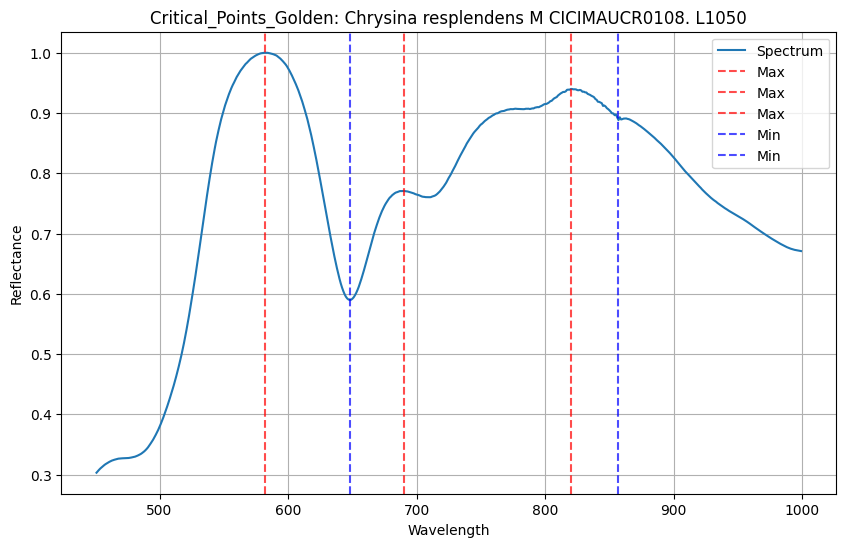

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=71.3047, 
                  bottom_thr=0.0, top_thr=71.3047, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.194200
1          251.0   6.197733
2          252.0   6.177767
3          253.0   6.188833
4          254.0   6.157033
...          ...        ...
1745      1995.0  22.713185
1746      1996.0  22.758276
1747      1997.0  22.786411
1748      1998.0  22.830100
1749      1999.0  22.854833

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


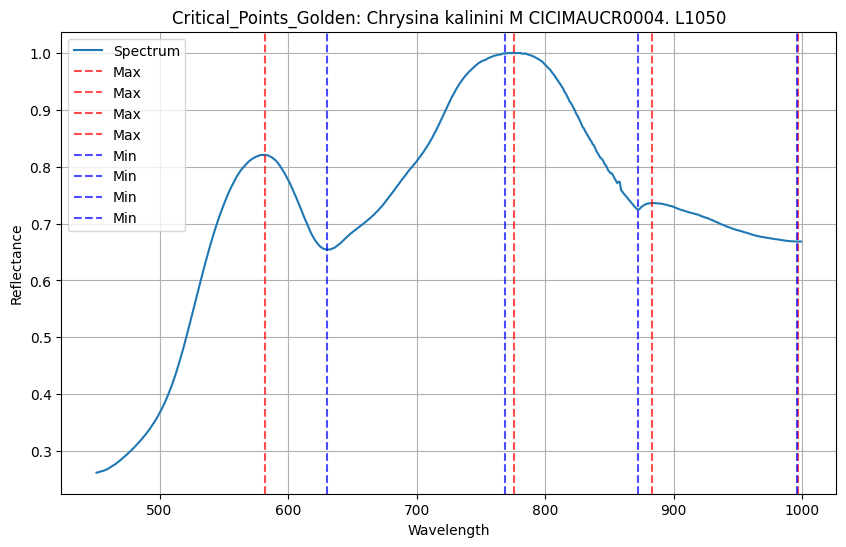

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=66.855167, 
                  bottom_thr=0.0, top_thr=66.855167, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   5.846467
1          251.0   5.821533
2          252.0   5.819633
3          253.0   5.814900
4          254.0   5.776500
...          ...        ...
1745      1995.0  25.560632
1746      1996.0  25.613848
1747      1997.0  25.674020
1748      1998.0  25.727900
1749      1999.0  25.779044

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


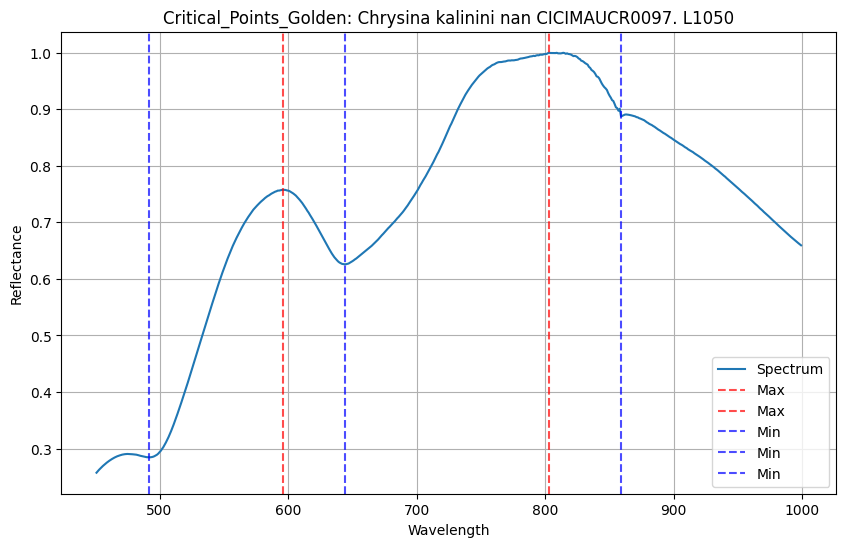

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=15.560224000000002, 
                  bottom_thr=0.0, top_thr=15.560224000000002, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          259.0   3.762066
1          260.0   3.759897
2          261.0   3.755702
3          262.0   3.752036
4          263.0   3.749770
...          ...        ...
1736      1995.0  10.968492
1737      1996.0  10.979798
1738      1997.0  11.014905
1739      1998.0  11.050137
1740      1999.0  11.059130

[1741 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


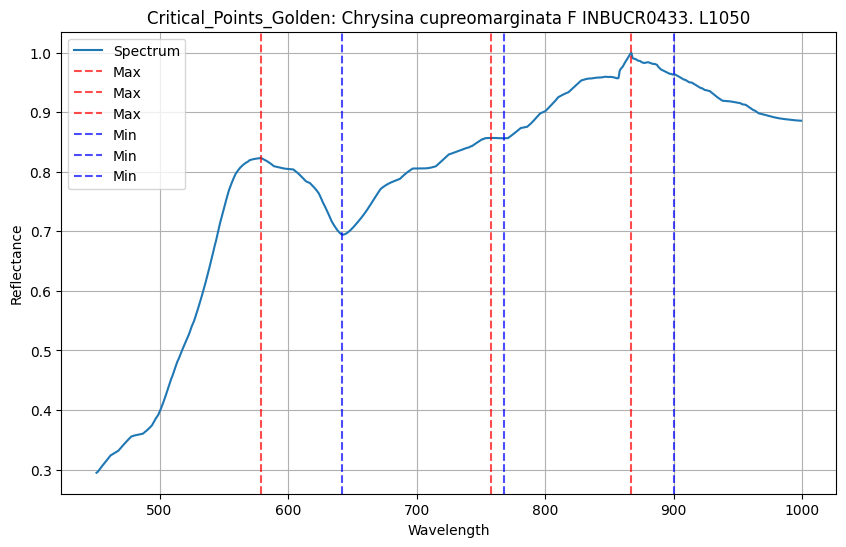

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=46.201066999999995, 
                  bottom_thr=0.0, top_thr=46.201066999999995, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   3.783033
1          251.0   3.775633
2          252.0   3.797833
3          253.0   3.752567
4          254.0   3.771033
...          ...        ...
1745      1995.0  14.908235
1746      1996.0  14.936671
1747      1997.0  14.975531
1748      1998.0  15.019068
1749      1999.0  15.052768

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


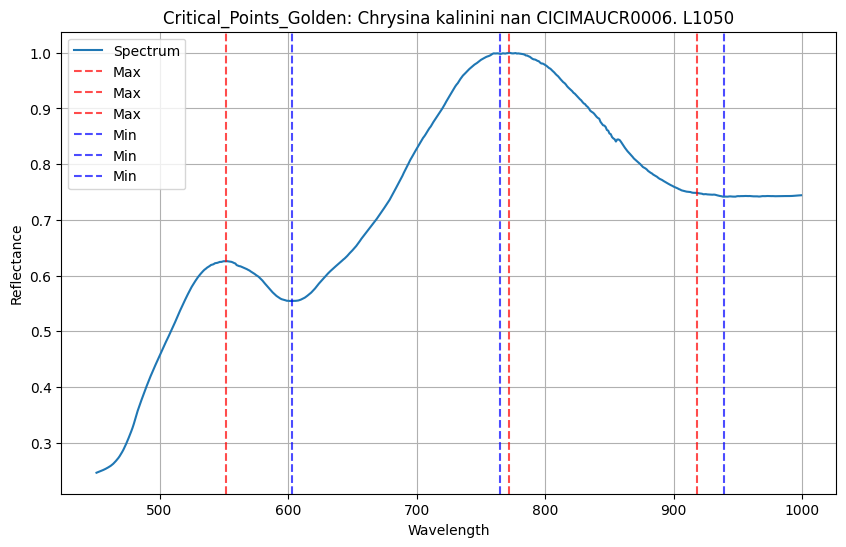

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=37.615502, 
                  bottom_thr=0.0, top_thr=37.615502, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   4.707333
1          251.0   4.727667
2          252.0   4.693633
3          253.0   4.685000
4          254.0   4.715367
...          ...        ...
1745      1995.0  13.829563
1746      1996.0  13.893894
1747      1997.0  13.916141
1748      1998.0  13.920316
1749      1999.0  13.955846

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


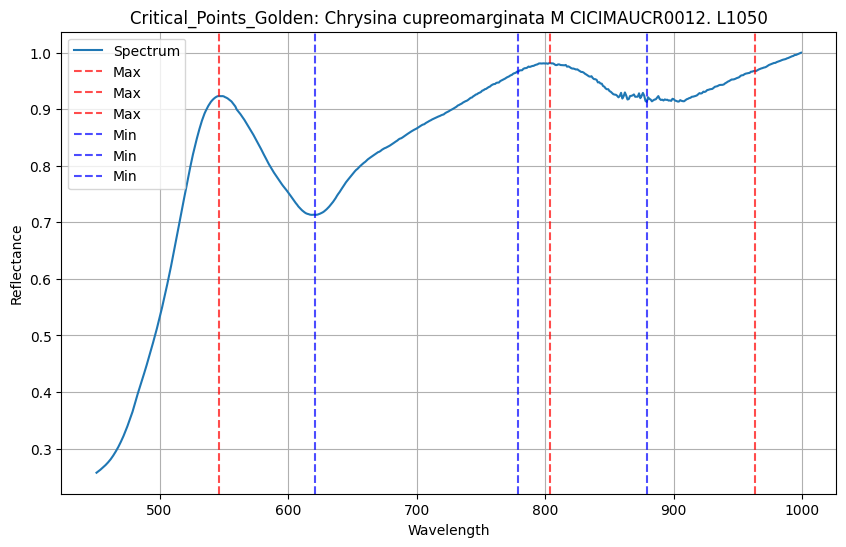

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=55.395157, 
                  bottom_thr=0.0, top_thr=55.395157, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.522400
1          251.0   6.509100
2          252.0   6.472900
3          253.0   6.470850
4          254.0   6.405500
...          ...        ...
1745      1995.0  15.842243
1746      1996.0  15.878753
1747      1997.0  15.918560
1748      1998.0  15.960838
1749      1999.0  15.995246

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


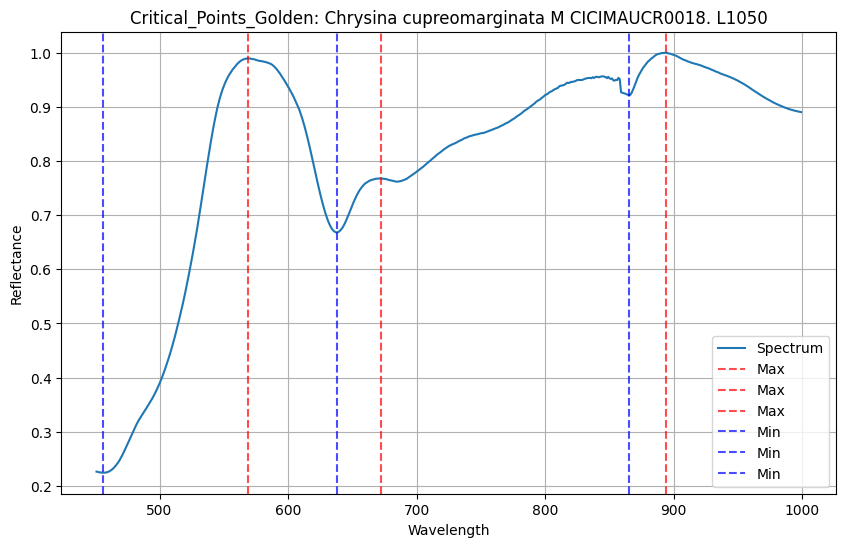

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=70.804767, 
                  bottom_thr=0.0, top_thr=70.804767, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.077967
1          251.0   6.042900
2          252.0   6.015433
3          253.0   6.005967
4          254.0   6.013433
...          ...        ...
1745      1995.0  22.518141
1746      1996.0  22.600915
1747      1997.0  22.618767
1748      1998.0  22.663347
1749      1999.0  22.726412

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


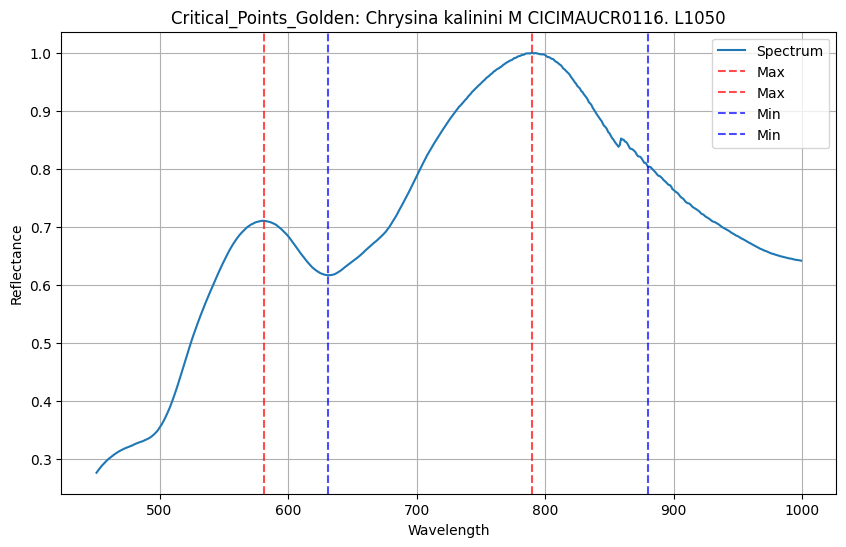

In [17]:
Critical_Points_Golden_data = feature_and_label_extractor(Metric = Critical_Points_Golden, 
                                                          config_file = metric_configuration_file, 
                                                          spectra =  train_spectra, 
                                                          debug = debug,
                                                          collection_list = training_collection_list,
                                                          plot = True)


#print(Critical_Points_Golden_data)
#pad_list(Critical_Points_Golden_data, filler = np.array([0,0]).T)


self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=48.893533000000005, 
                  bottom_thr=0.0, top_thr=48.893533000000005, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.059033
1          251.0   6.052233
2          252.0   6.033967
3          253.0   6.025833
4          254.0   5.993167
...          ...        ...
1745      1995.0  11.156570
1746      1996.0  11.178961
1747      1997.0  11.205560
1748      1998.0  11.239035
1749      1999.0  11.260341

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


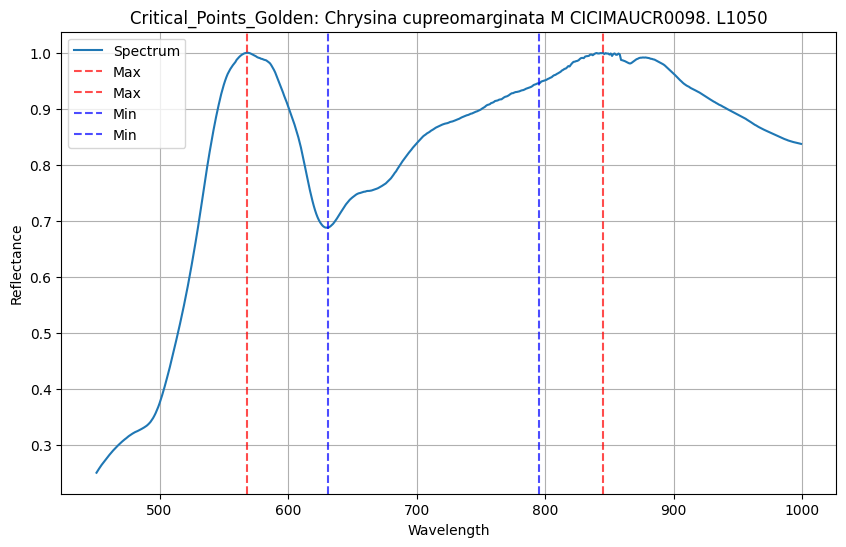

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=63.223845000000004, 
                  bottom_thr=0.0, top_thr=63.223845000000004, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.627333
1          251.0   6.592200
2          252.0   6.599233
3          253.0   6.566000
4          254.0   6.547600
...          ...        ...
1745      1995.0  19.848957
1746      1996.0  19.924566
1747      1997.0  19.976946
1748      1998.0  20.043284
1749      1999.0  20.093886

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


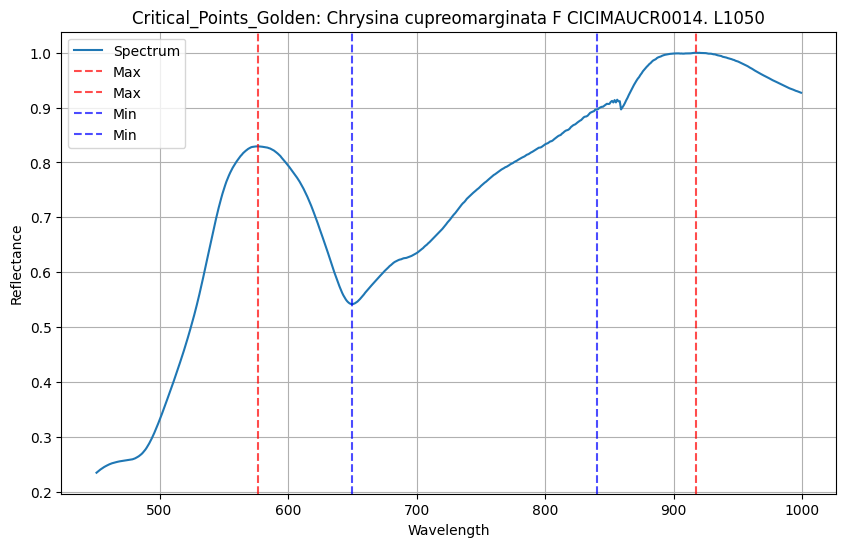

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=58.027733999999995, 
                  bottom_thr=0.0, top_thr=58.027733999999995, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          284.0   6.686712
1          285.0   6.674540
2          286.0   6.661835
3          287.0   6.651822
4          288.0   6.641055
...          ...        ...
1711      1995.0  14.717545
1712      1996.0  14.771121
1713      1997.0  14.844056
1714      1998.0  14.915941
1715      1999.0  14.952284

[1716 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


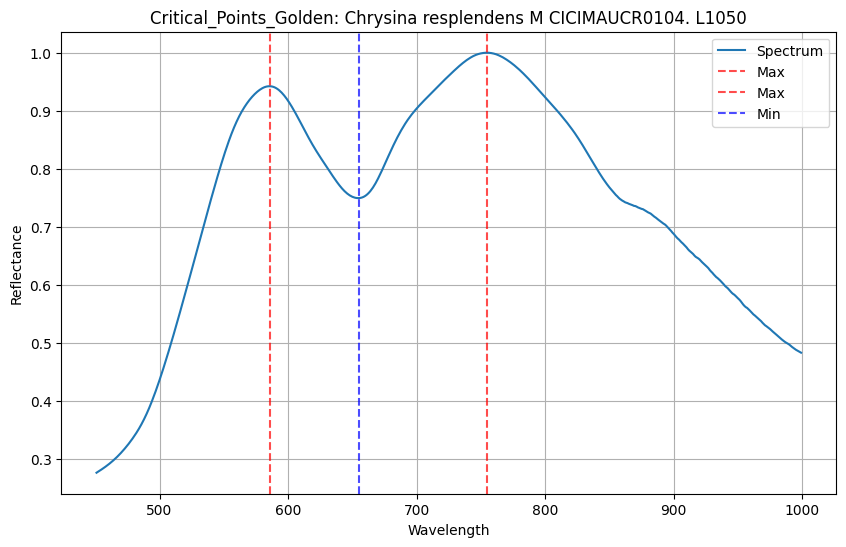

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=72.57525, 
                  bottom_thr=0.0, top_thr=72.57525, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.387750
1          251.0   6.331750
2          252.0   6.312100
3          253.0   6.257850
4          254.0   6.327550
...          ...        ...
1745      1995.0  18.687320
1746      1996.0  18.731023
1747      1997.0  18.770373
1748      1998.0  18.795870
1749      1999.0  18.845905

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


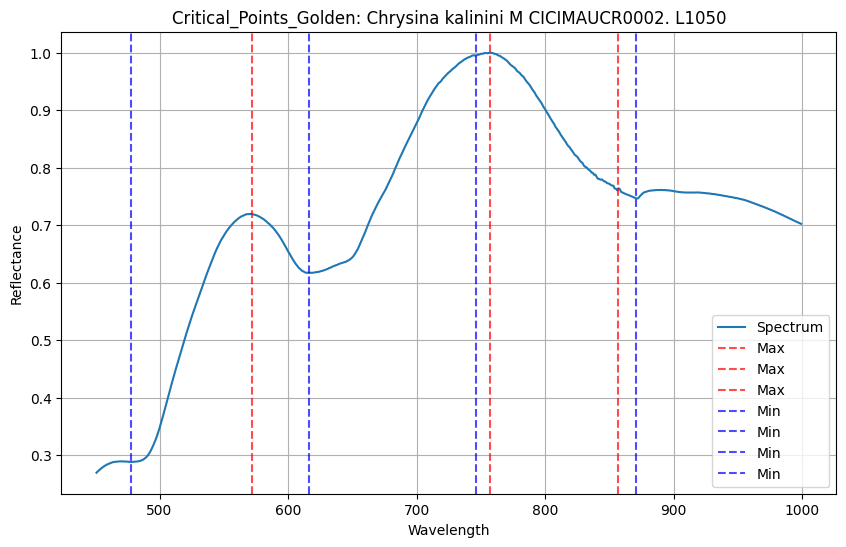

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=55.50916000000001, 
                  bottom_thr=0.0, top_thr=55.50916000000001, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   5.691060
1          251.0   5.661860
2          252.0   5.673480
3          253.0   5.679480
4          254.0   5.647980
...          ...        ...
1745      1995.0  18.102704
1746      1996.0  18.168534
1747      1997.0  18.218921
1748      1998.0  18.262135
1749      1999.0  18.307018

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


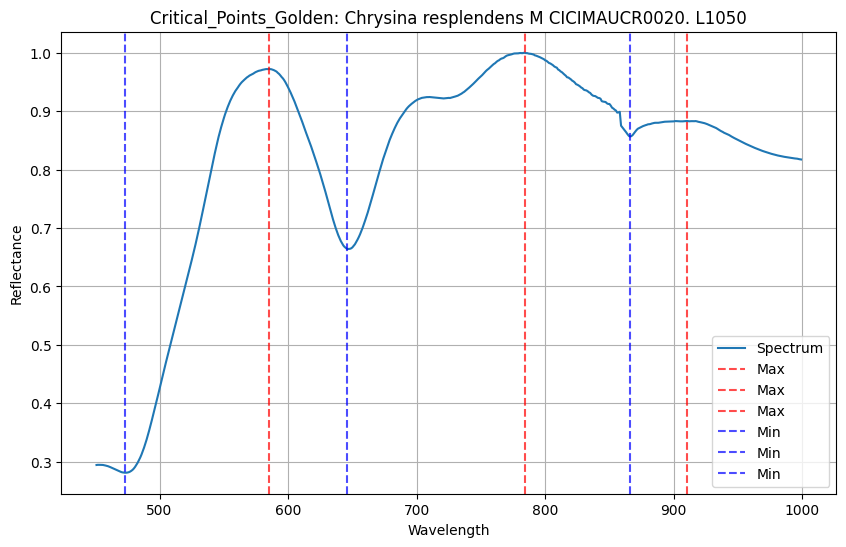

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=74.529467, 
                  bottom_thr=0.0, top_thr=74.529467, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.264300
1          251.0   6.269200
2          252.0   6.246400
3          253.0   6.215900
4          254.0   6.196933
...          ...        ...
1745      1995.0  21.554323
1746      1996.0  21.613598
1747      1997.0  21.652972
1748      1998.0  21.694313
1749      1999.0  21.724248

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


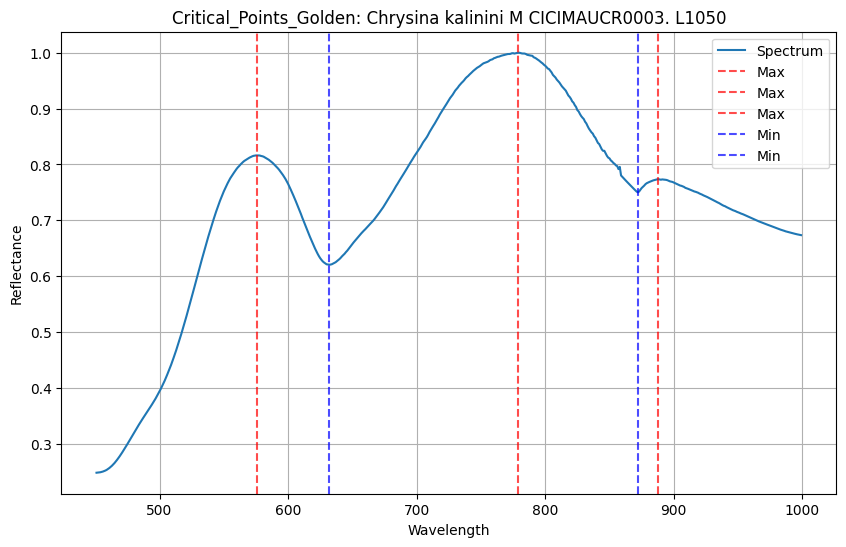

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=68.777667, 
                  bottom_thr=0.0, top_thr=68.777667, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.108967
1          251.0   6.101900
2          252.0   6.079567
3          253.0   6.068200
4          254.0   6.084167
...          ...        ...
1745      1995.0  21.369957
1746      1996.0  21.406533
1747      1997.0  21.467083
1748      1998.0  21.489857
1749      1999.0  21.513057

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


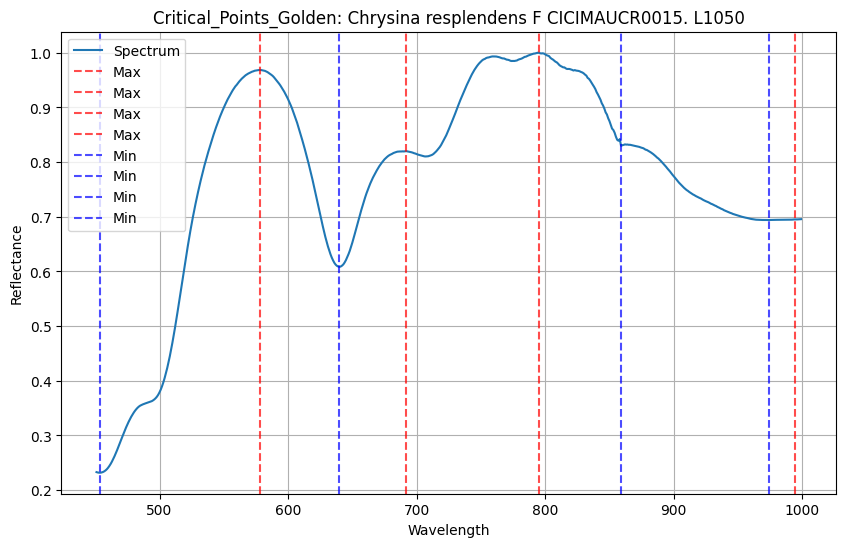

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=64.1527, 
                  bottom_thr=0.0, top_thr=64.1527, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.227900
1          251.0   6.212500
2          252.0   6.174433
3          253.0   6.191967
4          254.0   6.170433
...          ...        ...
1745      1995.0  19.510730
1746      1996.0  19.579398
1747      1997.0  19.636737
1748      1998.0  19.681657
1749      1999.0  19.693297

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


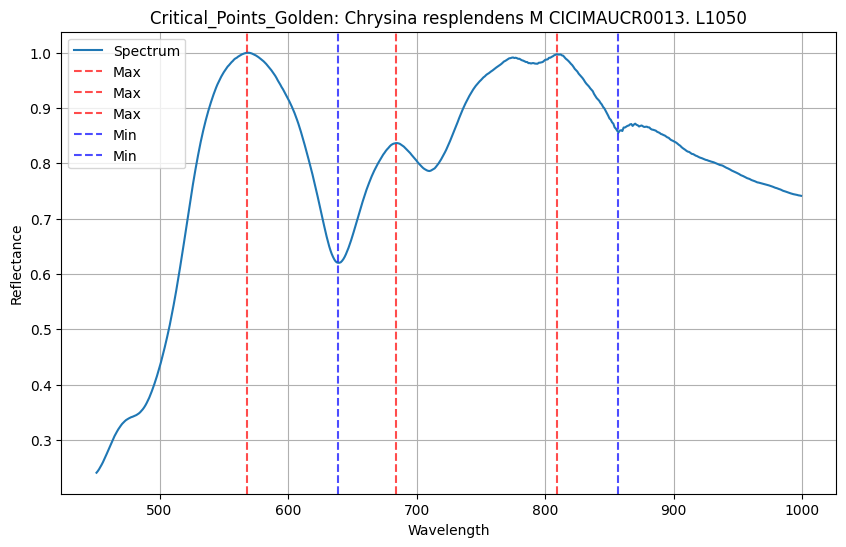

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=68.632466, 
                  bottom_thr=0.0, top_thr=68.632466, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.735933
1          251.0   6.753967
2          252.0   6.719933
3          253.0   6.718033
4          254.0   6.693367
...          ...        ...
1745      1995.0  25.450630
1746      1996.0  25.529126
1747      1997.0  25.583074
1748      1998.0  25.643778
1749      1999.0  25.706195

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


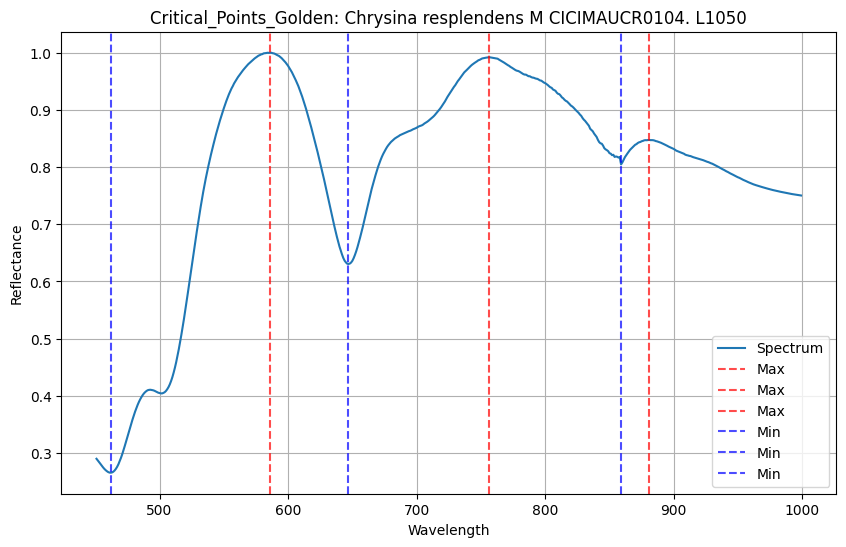

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=69.614549, 
                  bottom_thr=0.0, top_thr=69.614549, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          284.0   1.005921
1          285.0   1.130663
2          286.0   1.250340
3          287.0   1.369472
4          288.0   1.481847
...          ...        ...
1711      1995.0  18.162503
1712      1996.0  18.240729
1713      1997.0  18.277948
1714      1998.0  18.348353
1715      1999.0  18.375664

[1716 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


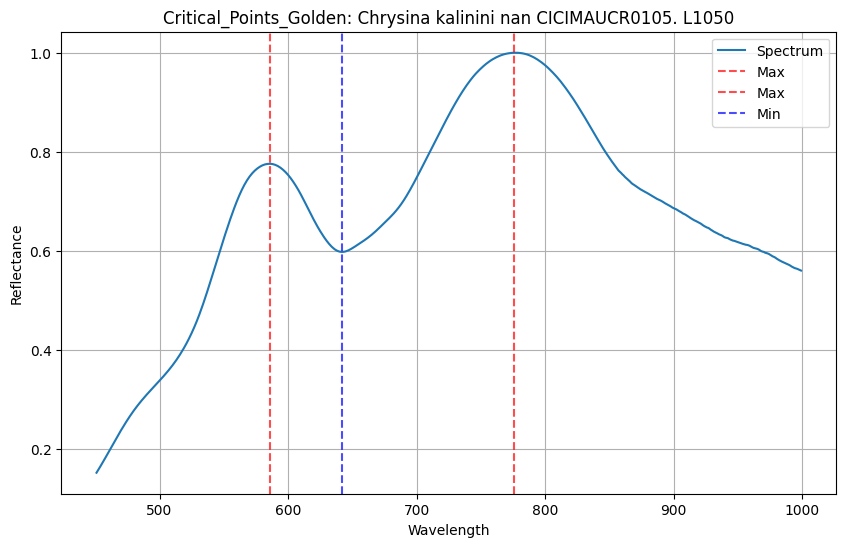

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=47.391498999999996, 
                  bottom_thr=0.0, top_thr=47.391498999999996, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength        %R
0          284.0  6.299151
1          285.0  6.281825
2          286.0  6.266644
3          287.0  6.251455
4          288.0  6.236319
...          ...       ...
1711      1995.0  9.722714
1712      1996.0  9.732779
1713      1997.0  9.714617
1714      1998.0  9.703111
1715      1999.0  9.703096

[1716 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


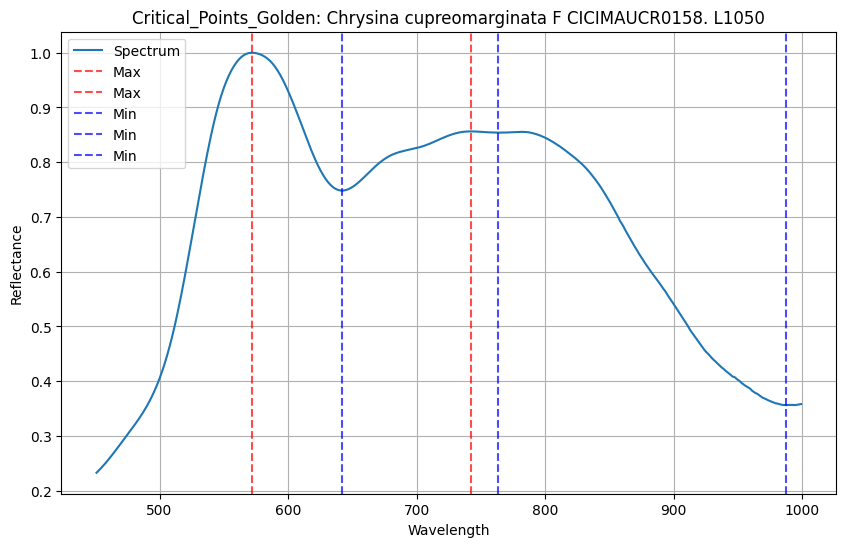

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=70.071434, 
                  bottom_thr=0.0, top_thr=70.071434, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.390333
1          251.0   6.389500
2          252.0   6.380300
3          253.0   6.354200
4          254.0   6.367300
...          ...        ...
1745      1995.0  21.051944
1746      1996.0  21.140525
1747      1997.0  21.215391
1748      1998.0  21.294900
1749      1999.0  21.366582

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


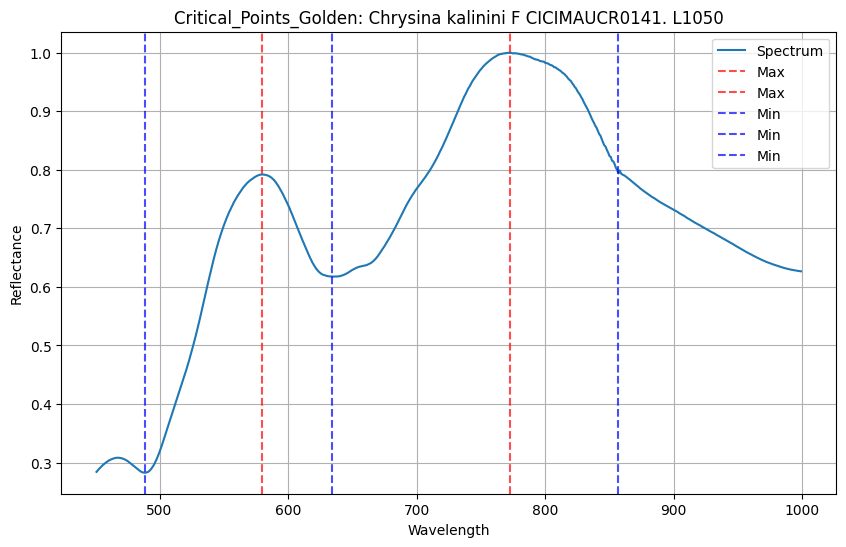

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=70.30927499999999, 
                  bottom_thr=0.0, top_thr=70.30927499999999, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   5.702700
1          251.0   5.706900
2          252.0   5.700400
3          253.0   5.654850
4          254.0   5.641550
...          ...        ...
1745      1995.0  26.643802
1746      1996.0  26.747612
1747      1997.0  26.857658
1748      1998.0  26.933957
1749      1999.0  26.996144

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


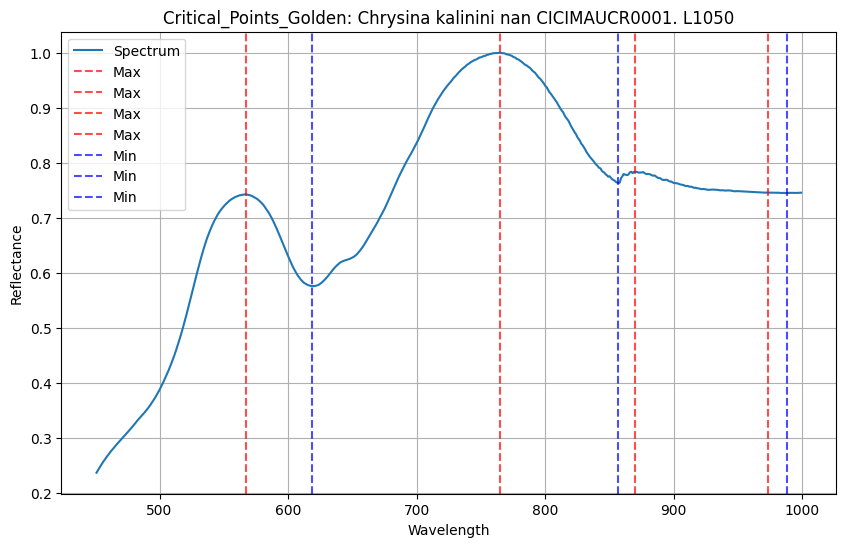

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=71.173166, 
                  bottom_thr=0.0, top_thr=71.173166, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.259033
1          251.0   6.240933
2          252.0   6.239333
3          253.0   6.206267
4          254.0   6.186733
...          ...        ...
1745      1995.0  14.655396
1746      1996.0  14.684346
1747      1997.0  14.717271
1748      1998.0  14.721940
1749      1999.0  14.748202

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


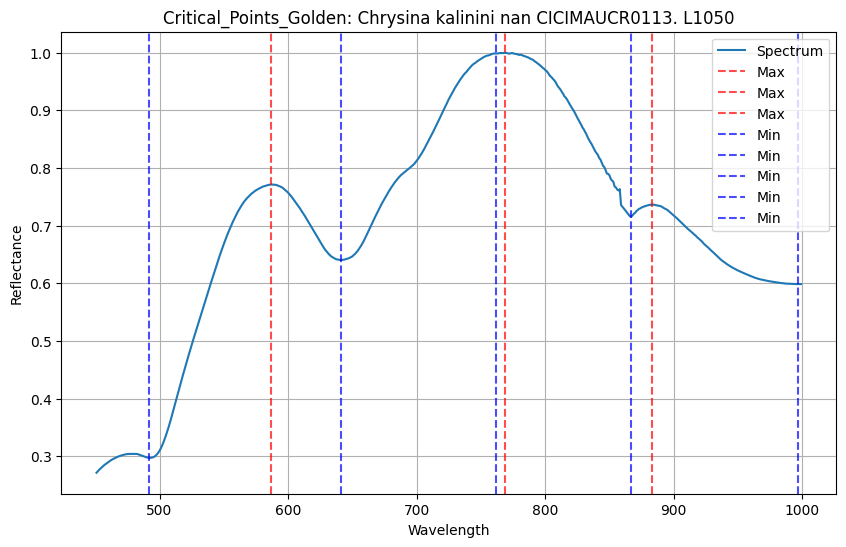

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=67.1612, 
                  bottom_thr=0.0, top_thr=67.1612, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.822967
1          251.0   6.775467
2          252.0   6.775167
3          253.0   6.801867
4          254.0   6.749833
...          ...        ...
1745      1995.0  12.911374
1746      1996.0  12.928366
1747      1997.0  12.949518
1748      1998.0  12.973254
1749      1999.0  12.961911

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


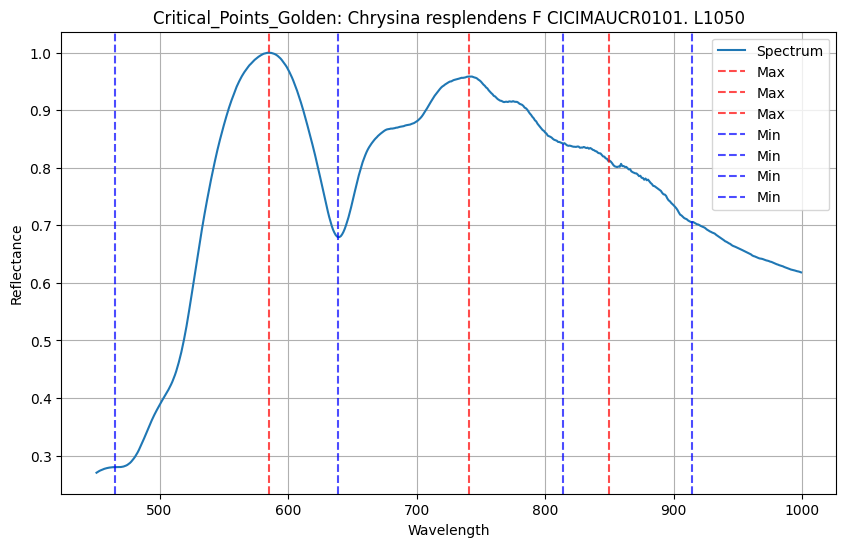

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=50.734972, 
                  bottom_thr=0.0, top_thr=50.734972, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.008450
1          251.0   5.972775
2          252.0   5.954625
3          253.0   5.952850
4          254.0   5.908875
...          ...        ...
1745      1995.0  29.522203
1746      1996.0  29.621899
1747      1997.0  29.713628
1748      1998.0  29.778892
1749      1999.0  29.870986

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


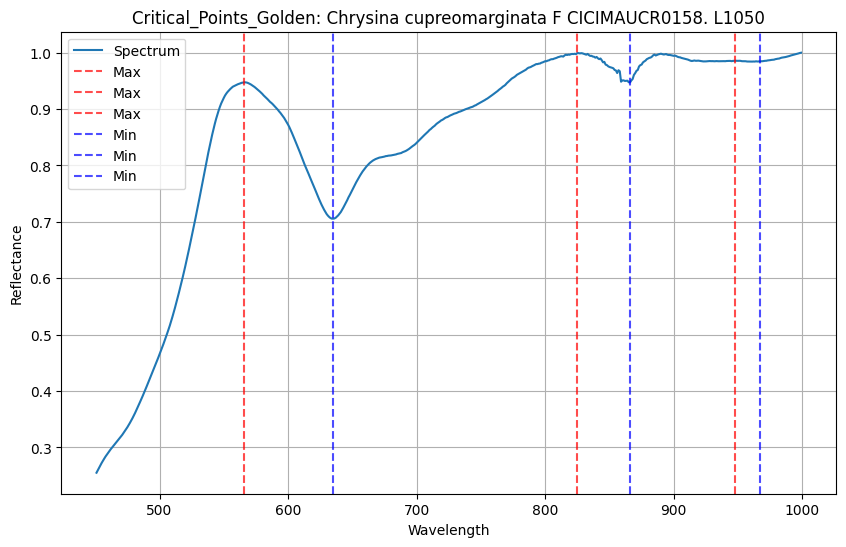

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=49.421255, 
                  bottom_thr=0.0, top_thr=49.421255, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   5.191600
1          251.0   5.191933
2          252.0   5.193233
3          253.0   5.187600
4          254.0   5.191667
...          ...        ...
1745      1995.0  21.857982
1746      1996.0  21.912365
1747      1997.0  21.975321
1748      1998.0  22.028556
1749      1999.0  22.073970

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


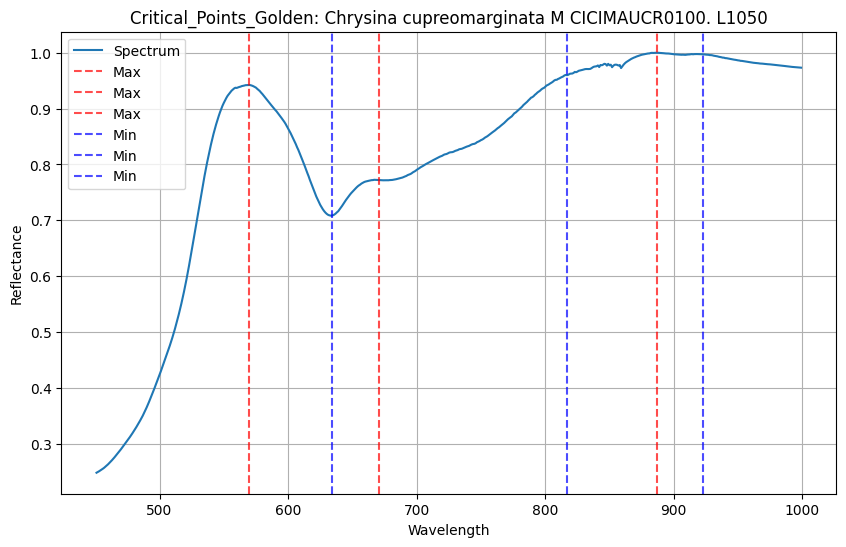

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=78.41141999999999, 
                  bottom_thr=0.0, top_thr=78.41141999999999, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.293233
1          251.0   6.296733
2          252.0   6.277967
3          253.0   6.295500
4          254.0   6.254967
...          ...        ...
1745      1995.0  39.886466
1746      1996.0  39.997934
1747      1997.0  40.090784
1748      1998.0  40.189198
1749      1999.0  40.271696

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


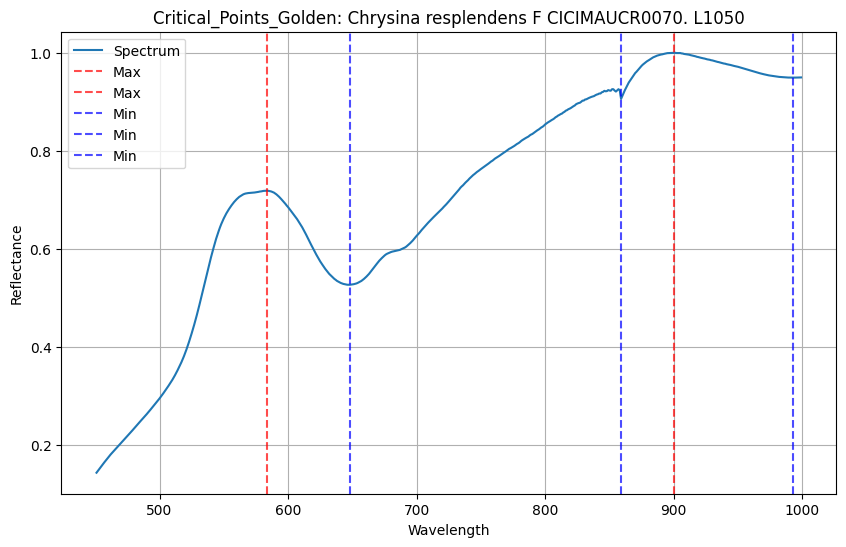

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=61.15786700000001, 
                  bottom_thr=0.0, top_thr=61.15786700000001, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   5.869533
1          251.0   5.887500
2          252.0   5.873467
3          253.0   5.862267
4          254.0   5.839167
...          ...        ...
1745      1995.0  21.380497
1746      1996.0  21.433174
1747      1997.0  21.484960
1748      1998.0  21.528167
1749      1999.0  21.580069

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


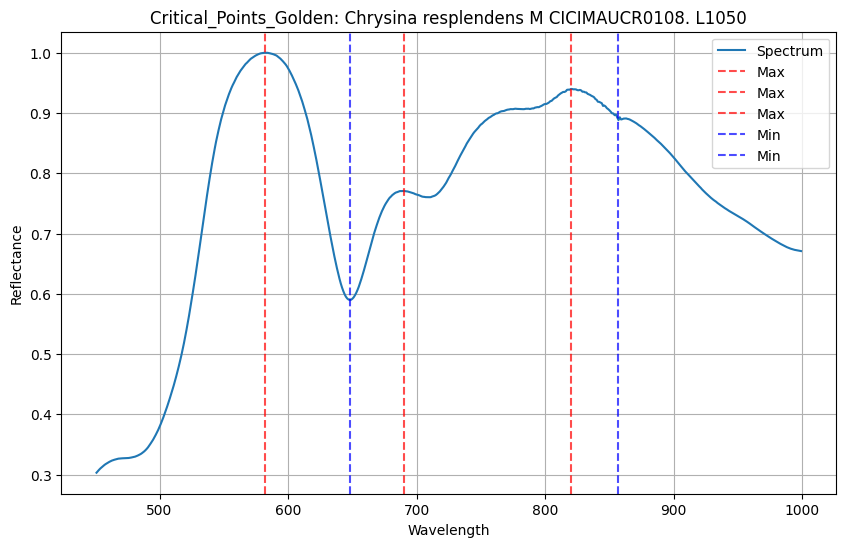

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=71.3047, 
                  bottom_thr=0.0, top_thr=71.3047, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.194200
1          251.0   6.197733
2          252.0   6.177767
3          253.0   6.188833
4          254.0   6.157033
...          ...        ...
1745      1995.0  22.713185
1746      1996.0  22.758276
1747      1997.0  22.786411
1748      1998.0  22.830100
1749      1999.0  22.854833

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


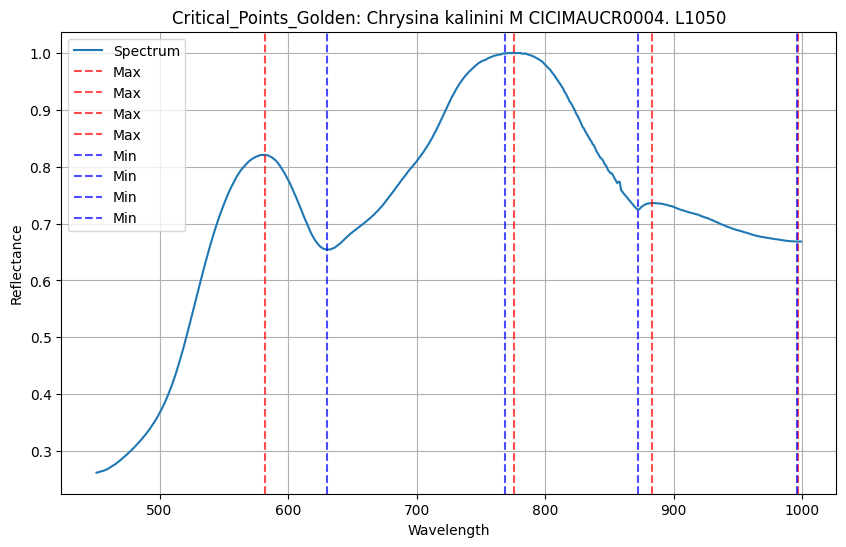

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=66.855167, 
                  bottom_thr=0.0, top_thr=66.855167, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   5.846467
1          251.0   5.821533
2          252.0   5.819633
3          253.0   5.814900
4          254.0   5.776500
...          ...        ...
1745      1995.0  25.560632
1746      1996.0  25.613848
1747      1997.0  25.674020
1748      1998.0  25.727900
1749      1999.0  25.779044

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


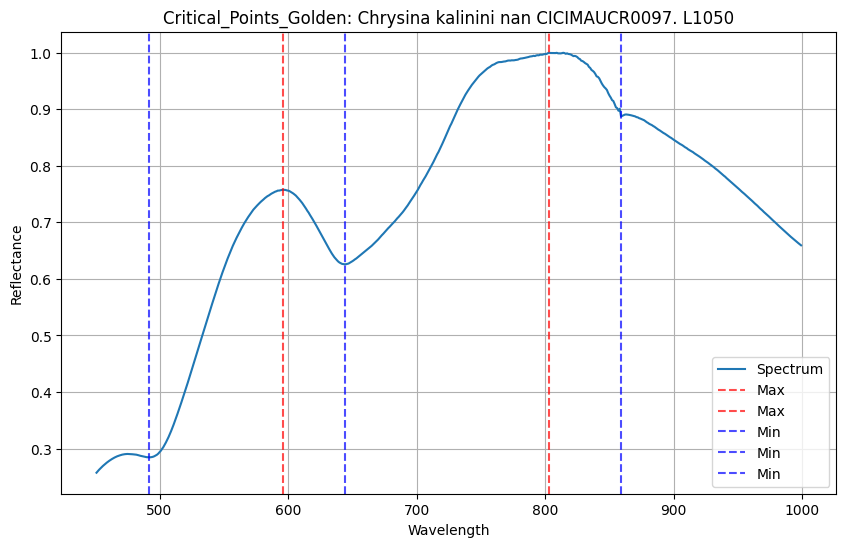

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=15.560224000000002, 
                  bottom_thr=0.0, top_thr=15.560224000000002, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          259.0   3.762066
1          260.0   3.759897
2          261.0   3.755702
3          262.0   3.752036
4          263.0   3.749770
...          ...        ...
1736      1995.0  10.968492
1737      1996.0  10.979798
1738      1997.0  11.014905
1739      1998.0  11.050137
1740      1999.0  11.059130

[1741 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


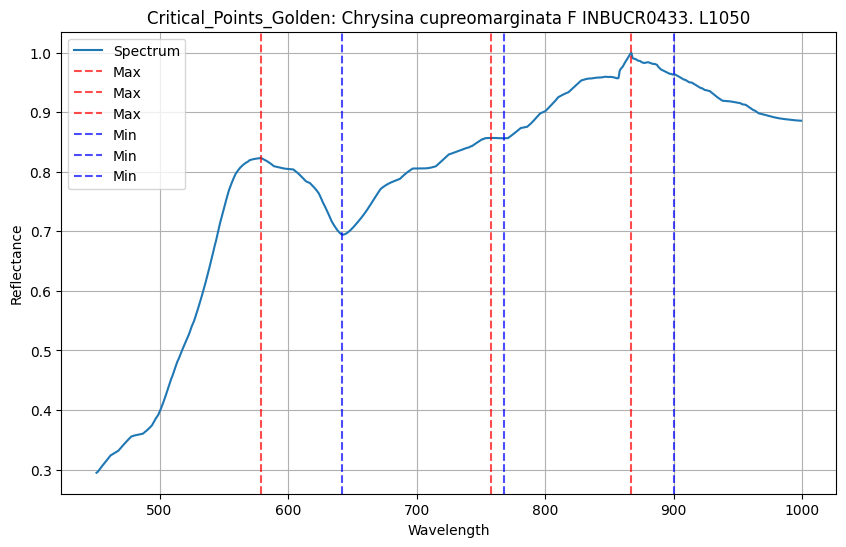

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=46.201066999999995, 
                  bottom_thr=0.0, top_thr=46.201066999999995, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   3.783033
1          251.0   3.775633
2          252.0   3.797833
3          253.0   3.752567
4          254.0   3.771033
...          ...        ...
1745      1995.0  14.908235
1746      1996.0  14.936671
1747      1997.0  14.975531
1748      1998.0  15.019068
1749      1999.0  15.052768

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


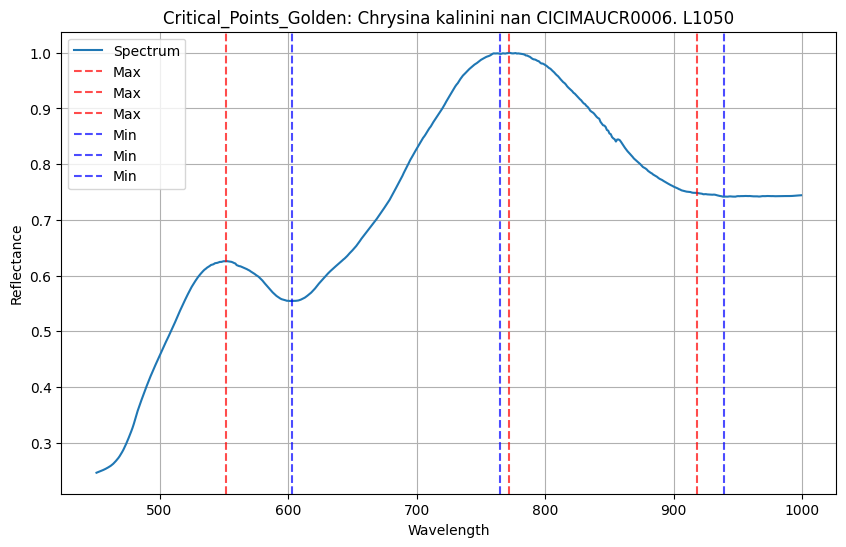

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=37.615502, 
                  bottom_thr=0.0, top_thr=37.615502, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   4.707333
1          251.0   4.727667
2          252.0   4.693633
3          253.0   4.685000
4          254.0   4.715367
...          ...        ...
1745      1995.0  13.829563
1746      1996.0  13.893894
1747      1997.0  13.916141
1748      1998.0  13.920316
1749      1999.0  13.955846

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


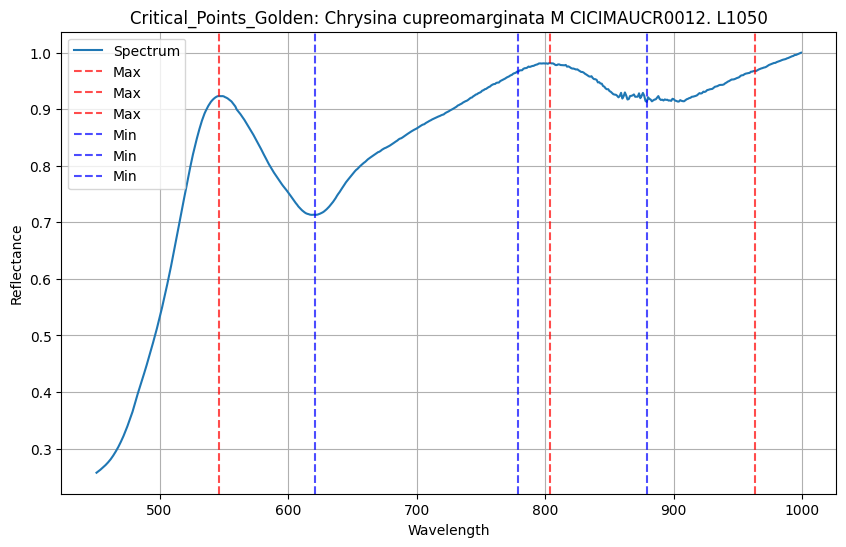

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=55.395157, 
                  bottom_thr=0.0, top_thr=55.395157, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.522400
1          251.0   6.509100
2          252.0   6.472900
3          253.0   6.470850
4          254.0   6.405500
...          ...        ...
1745      1995.0  15.842243
1746      1996.0  15.878753
1747      1997.0  15.918560
1748      1998.0  15.960838
1749      1999.0  15.995246

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


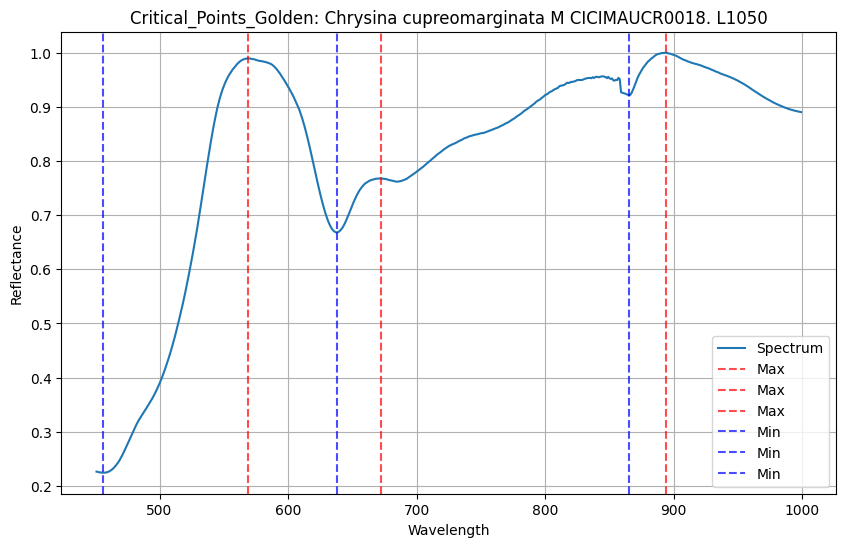

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=70.804767, 
                  bottom_thr=0.0, top_thr=70.804767, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.077967
1          251.0   6.042900
2          252.0   6.015433
3          253.0   6.005967
4          254.0   6.013433
...          ...        ...
1745      1995.0  22.518141
1746      1996.0  22.600915
1747      1997.0  22.618767
1748      1998.0  22.663347
1749      1999.0  22.726412

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


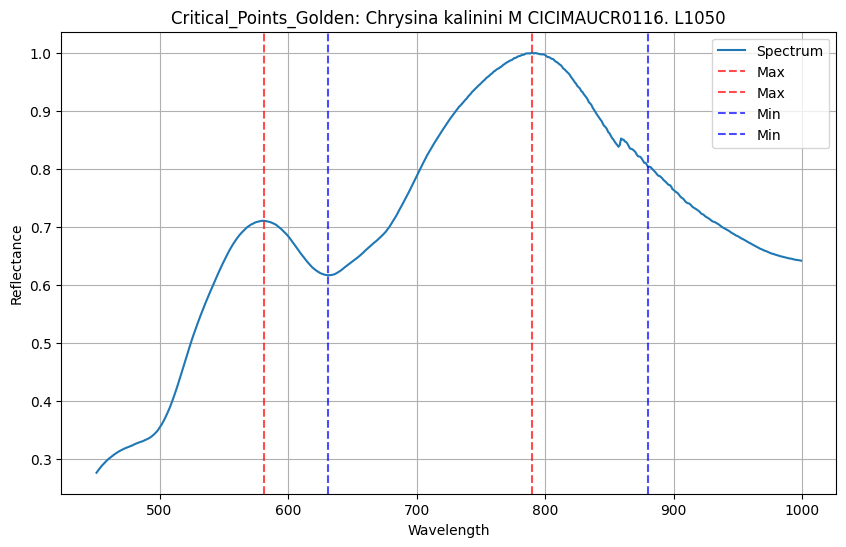

In [18]:
Critical_Points_Golden_data = feature_and_label_extractor(Metric = Critical_Points_Golden, 
                                                          config_file = metric_configuration_file, 
                                                          spectra =  train_spectra, 
                                                          debug = debug,
                                                          collection_list = training_collection_list,
                                                          plot = True)


#print(Critical_Points_Golden_data)
#pad_list(Critical_Points_Golden_data, filler = np.array([0,0]).T)


## Aggregate data for each metric
### Boxplots and histograms for each metric, classified by species

self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelength=1500.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
min wav 450.0 max_wav 1000.0
get_minima: max_val=48.893533000000005, 
                  bottom_thr=0.0, top_thr=48.893533000000005, 
                  prominence_threshold_for_min=Nonemin_wavelength=450.0max_wavelength=1000.0
df peaklist get max       wavelength         %R
0          250.0   6.059033
1          251.0   6.052233
2          252.0   6.033967
3          253.0   6.025833
4          254.0   5.993167
...          ...        ...
1745      1995.0  11.156570
1746      1996.0  11.178961
1747      1997.0  11.205560
1748      1998.0  11.239035
1749      1999.0  11.260341

[1750 rows x 2 columns]
min 450.0 max 1000.0
self.visible_start_wavelength=500.0
        self.visible_end_wavelength=780.0
        self.ir_start_wavelength=780.0
        self.ir_end_wavelengt

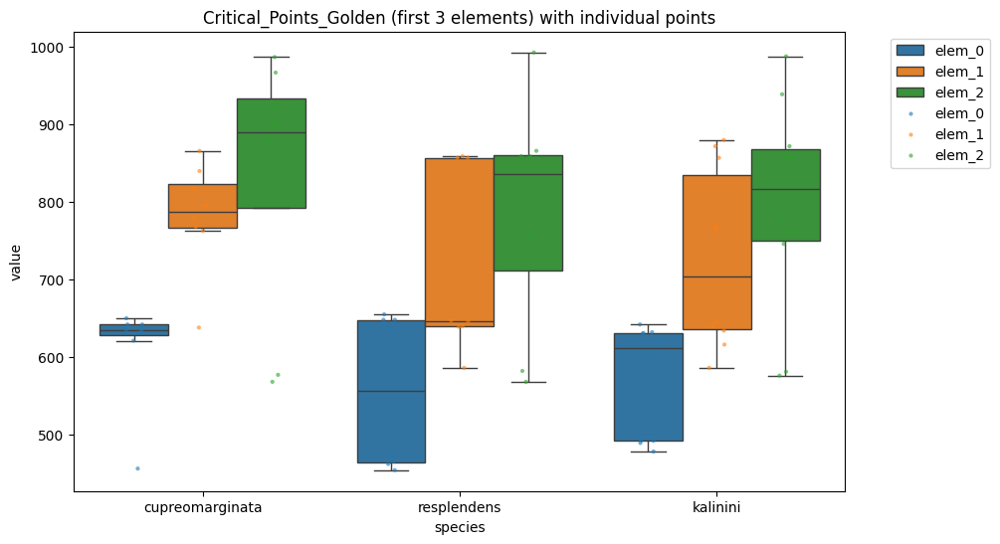

species cupreomarginata                                                    \
metric           elem_0    elem_1    elem_2    elem_3    elem_4    elem_5   
mean           613.8750  783.2500  833.2500  645.5000  570.2038  592.6136   
std             64.3727   68.7682  166.1159  146.9256  328.8403  441.6945   
median         634.5000  787.0000  889.5000  571.0000  707.0000  877.0000   
min            456.0000  638.0000  568.0000  546.0000   44.7323   46.2220   
max            650.0000  866.0000  987.0000  917.0000  825.0000  963.0000   
iqr             13.5000   56.0000  141.0000   77.2500  255.0254  836.5753   
cv               0.1049    0.0878    0.1994    0.2276    0.5767    0.7453   

species                                      ... resplendens            \
metric    elem_6   elem_7   elem_8   elem_9  ...      elem_6    elem_7   
mean     43.5751  51.6269  40.9593  39.3711  ...    240.5944  173.6455   
std      20.0597  22.0795  29.5389  29.0568  ...    360.6973  332.9481   
median   47.3155  56.0234  54.0095  49.8327  ...     75.1252   71.6845   
min      15.3167  18.8888   0.0000   0.0000  ...      0.0000    0.0000   
max      68.4773  82.5713  67.0567  70.6694  ...    850.0000  994.0000   
iqr      24.7794  23.4126  49.6648  48.9695  ...    236.9768   42.2692   
cv        0.4603   0.4277   0.7212   0.7380  ...      1.4992    1.9174   

species                                                                 \
metric    elem_8   elem_9  elem_10  elem_11  elem_12  elem_13  elem_14   
mean     53.5970  69.8502  38.6382  37.6913  21.8669  18.5229  11.1901   
std      27.5006  30.7018  41.9895  41.2028  40.4917  34.2997  31.6505   
median   66.0141  79.9972  32.4635  31.0636   0.0000   0.0000   0.0000   
min       0.0000   0.0000   0.0000   0.0000   0.0000   0.0000   0.0000   
max      75.1671  93.4164  92.6724  92.0317  88.2347  74.7809  89.5212   
iqr      16.3063  16.1483  75.0120  70.9484  21.6751  18.3506   0.0000   
cv        0.5131   0.4395   1.0867   1.0932   1.8517   1.8517   2.8284   

species           
metric   elem_15  
mean      7.7782  
std      22.0000  
median    0.0000  
min       0.0000  
max      62.2253  
iqr       0.0000  
cv        2.8284  

[7 rows x 48 columns]

In [19]:
get_aggregated_data(Critical_Points_Golden,
                    config_file = metric_configuration_file, 
                    spectra =  train_spectra, 
                    collection_list = training_collection_list)

In [20]:
get_aggregated_data(Gamma_First_Two_Peaks_Simple,
                    config_file = metric_configuration_file, 
                    spectra =  train_spectra, 
                    collection_list = training_collection_list,
                    plot = True)

⚠️ Gamma_First_Two_Peaks_Simple: No valid metric values after dropping NaNs.


C:\Users\esteb\escarabajos\libraries\metrics.py:89: UserWarning: Gamma_First_Two_Peaks_Simple: Could not get maxima for CICIMAUCR0098 (Chrysina cupreomarginata): 'Gamma_First_Two_Peaks_Simple' object has no attribute 'height_bottom_threshold_for_maximum'
  warnings.warn(
C:\Users\esteb\escarabajos\libraries\metrics.py:89: UserWarning: Gamma_First_Two_Peaks_Simple: Could not get maxima for CICIMAUCR0014 (Chrysina cupreomarginata): 'Gamma_First_Two_Peaks_Simple' object has no attribute 'height_bottom_threshold_for_maximum'
  warnings.warn(
C:\Users\esteb\escarabajos\libraries\metrics.py:89: UserWarning: Gamma_First_Two_Peaks_Simple: Could not get maxima for CICIMAUCR0104 (Chrysina resplendens): 'Gamma_First_Two_Peaks_Simple' object has no attribute 'height_bottom_threshold_for_maximum'
  warnings.warn(
C:\Users\esteb\escarabajos\libraries\metrics.py:89: UserWarning: Gamma_First_Two_Peaks_Simple: Could not get maxima for CICIMAUCR0002 (Chrysina kalinini): 'Gamma_First_Two_Peaks_Simple' ob

,mean,std,median,min,max,count,iqr,cv


STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

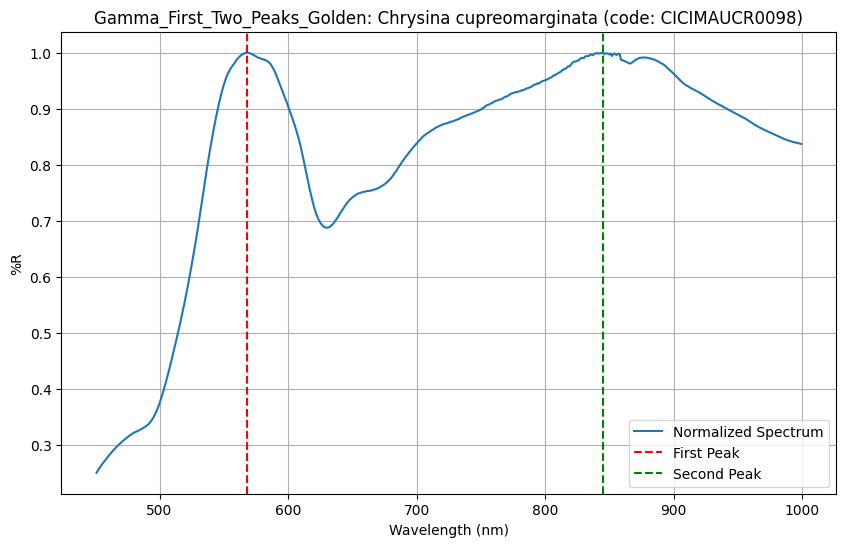

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

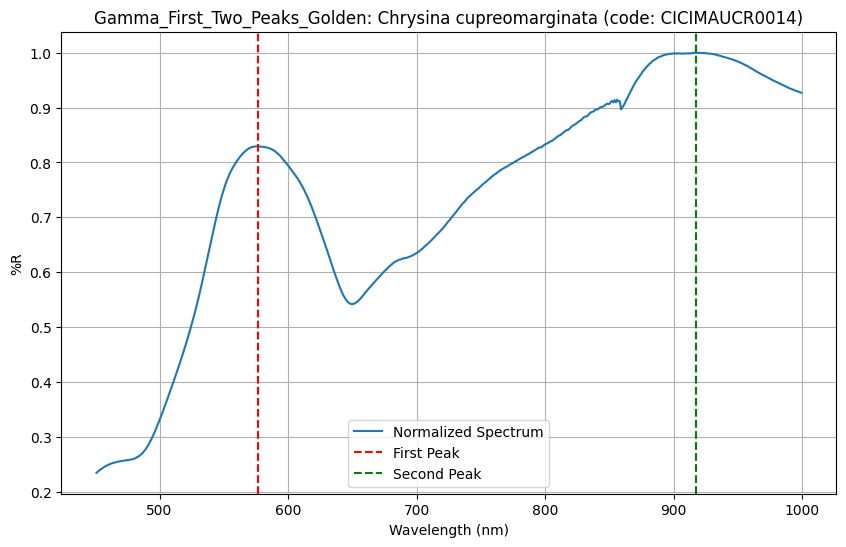

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

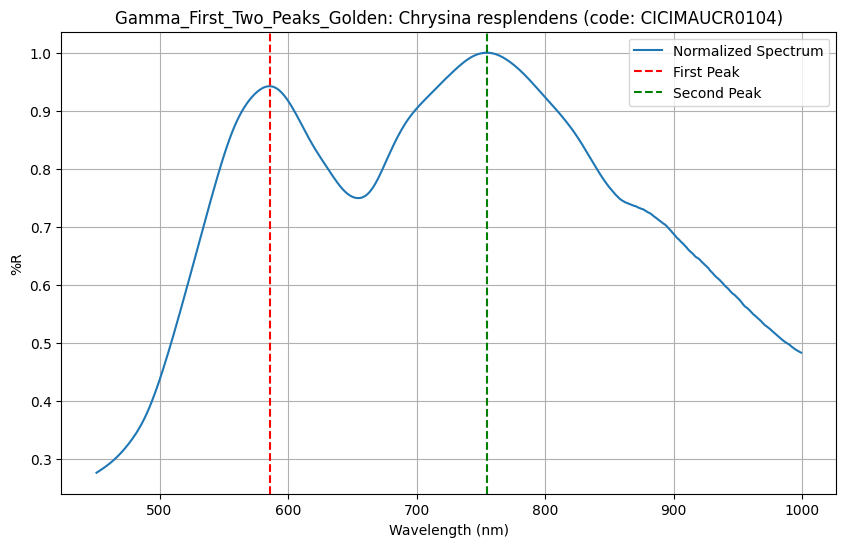

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

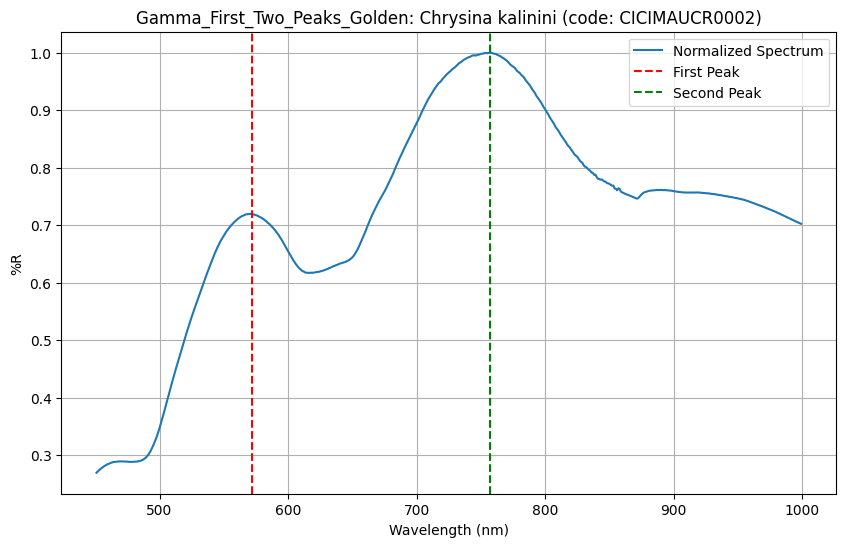

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

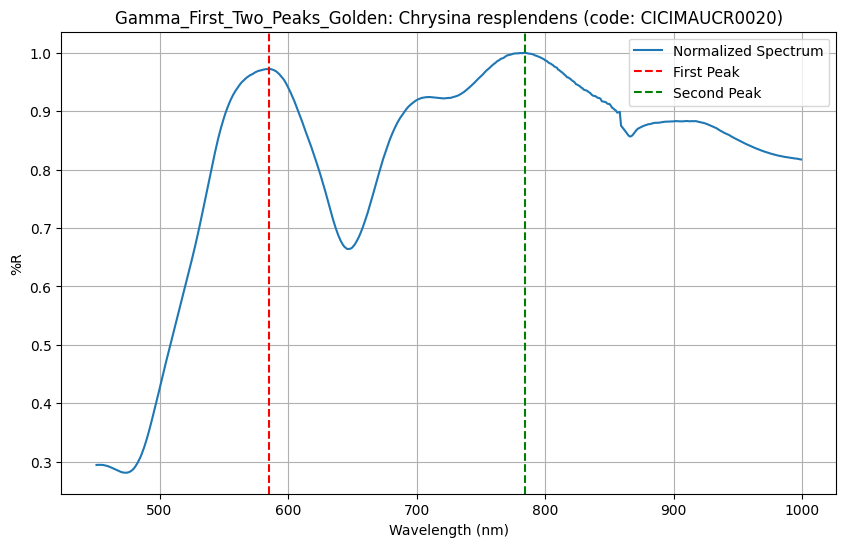

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

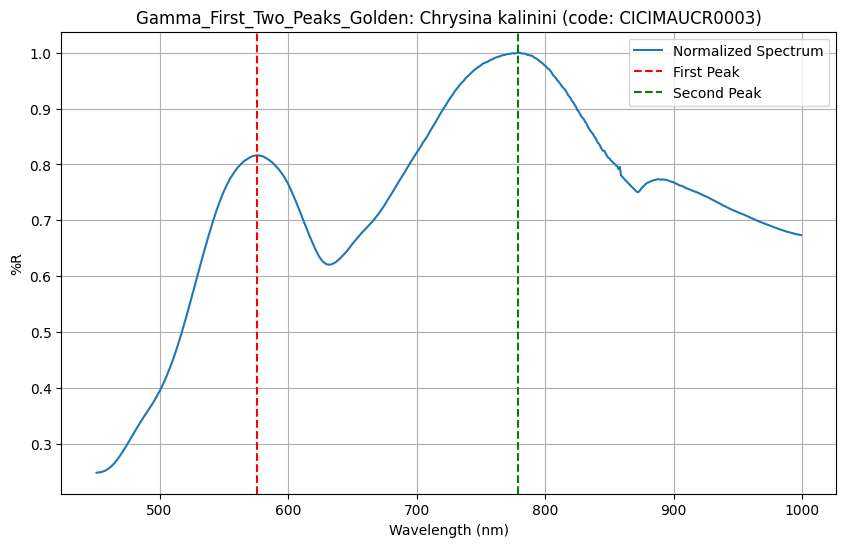

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

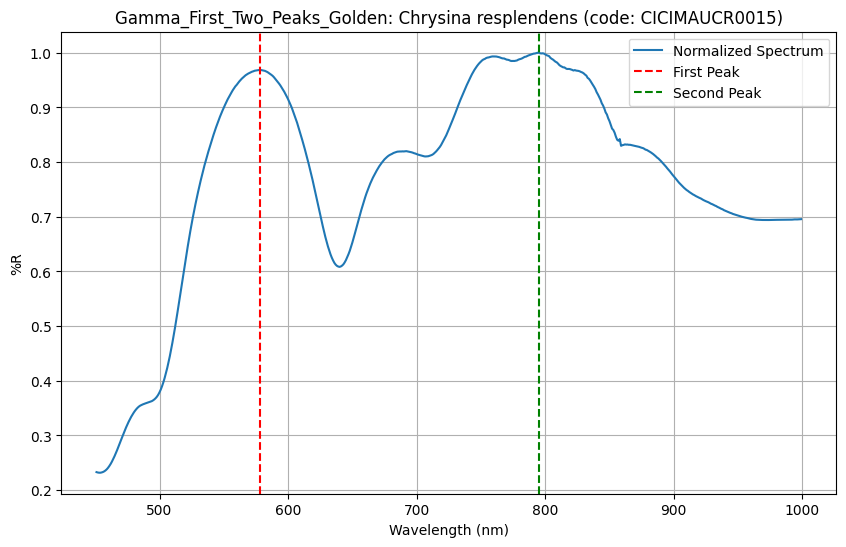

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

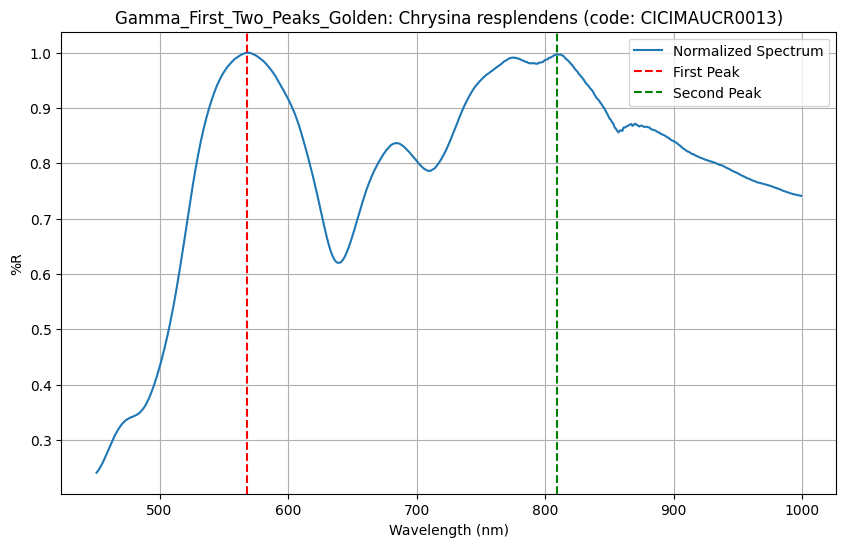

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

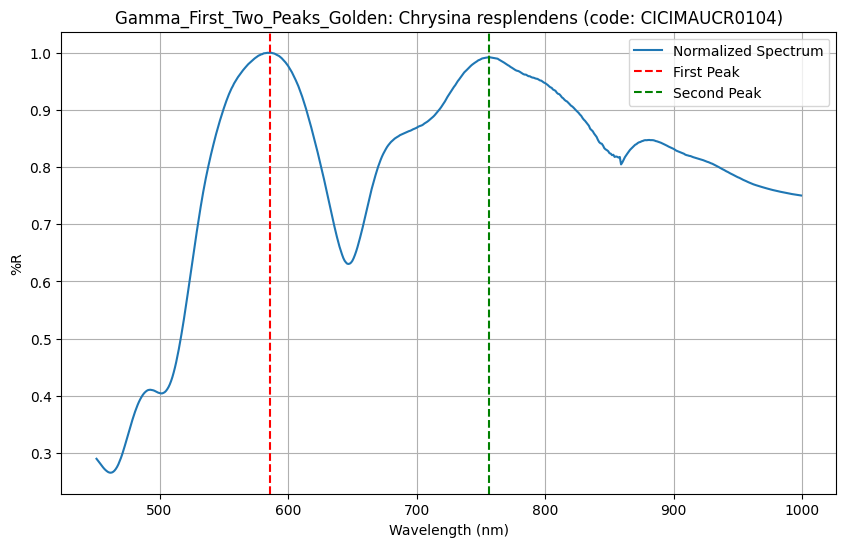

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

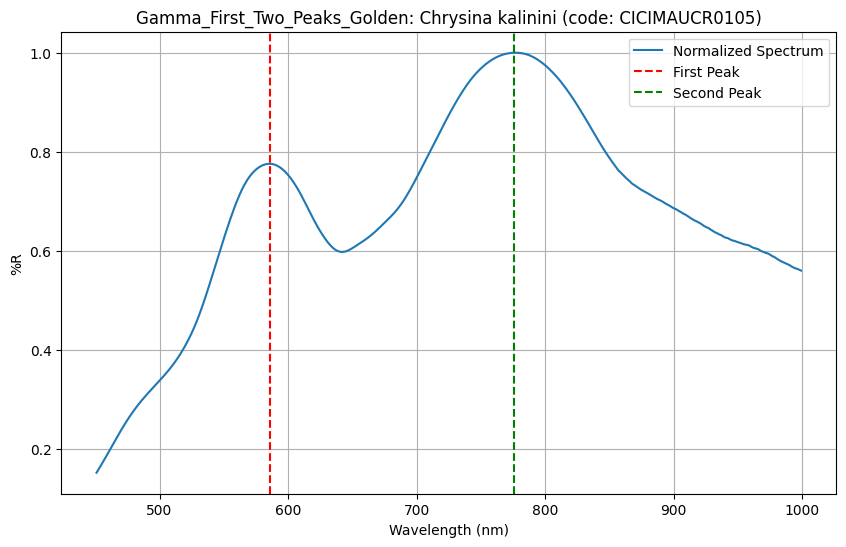

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

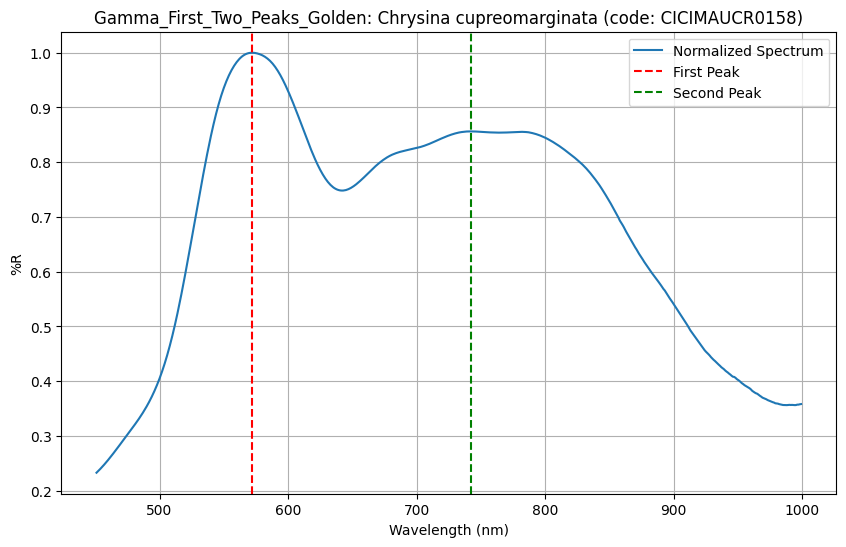

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

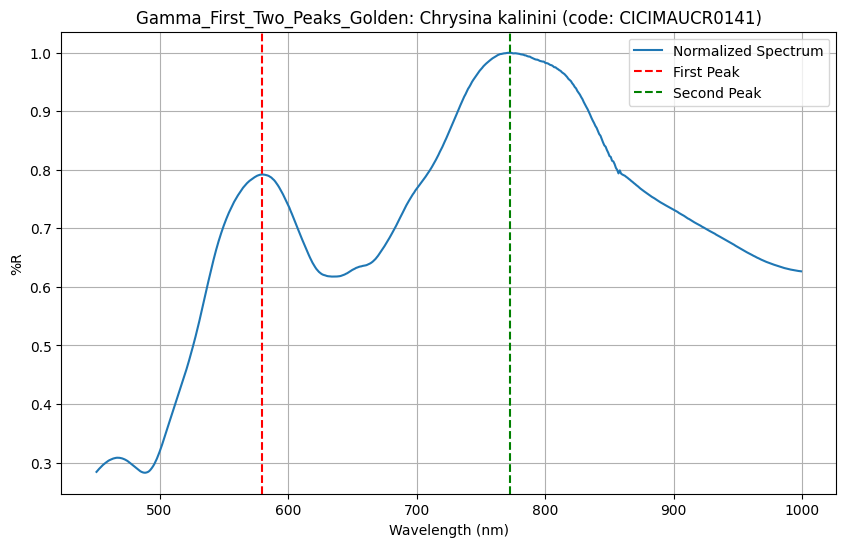

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

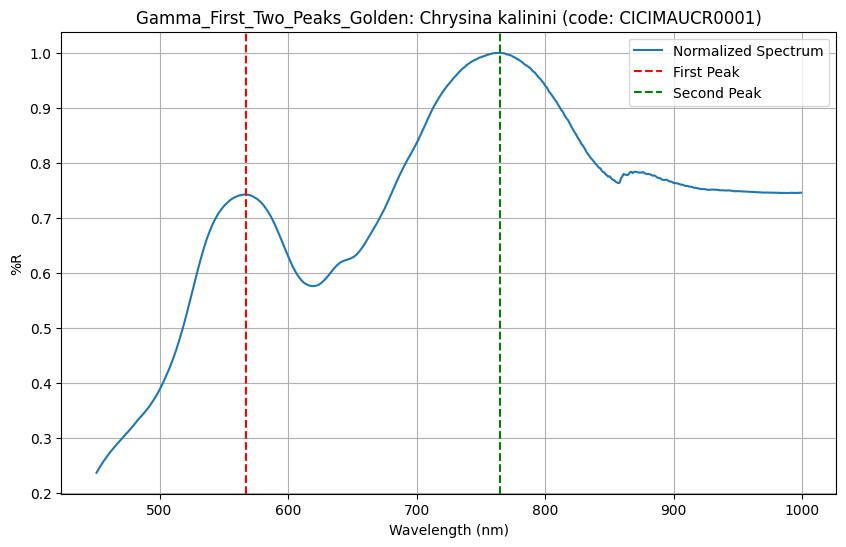

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

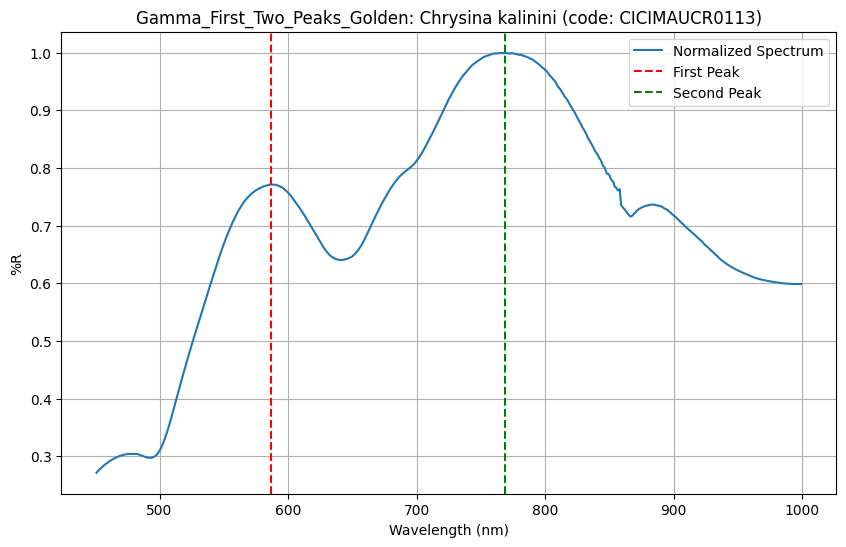

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

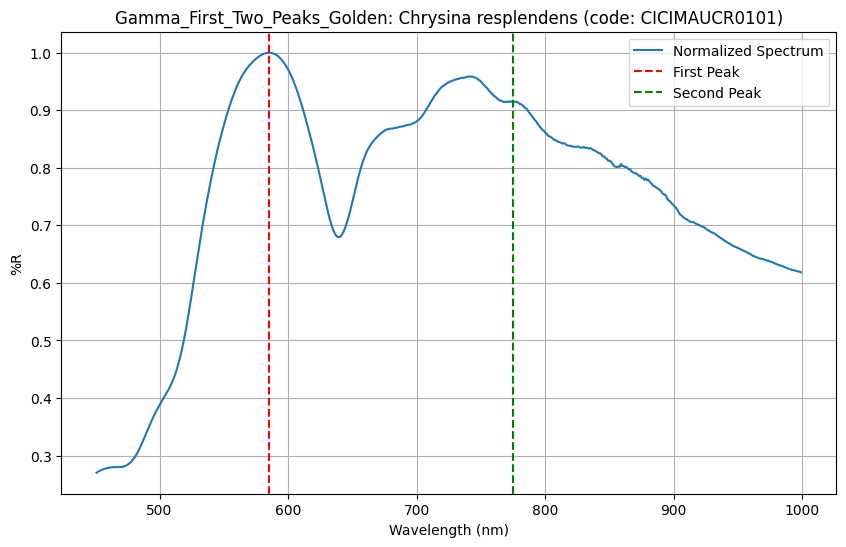

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

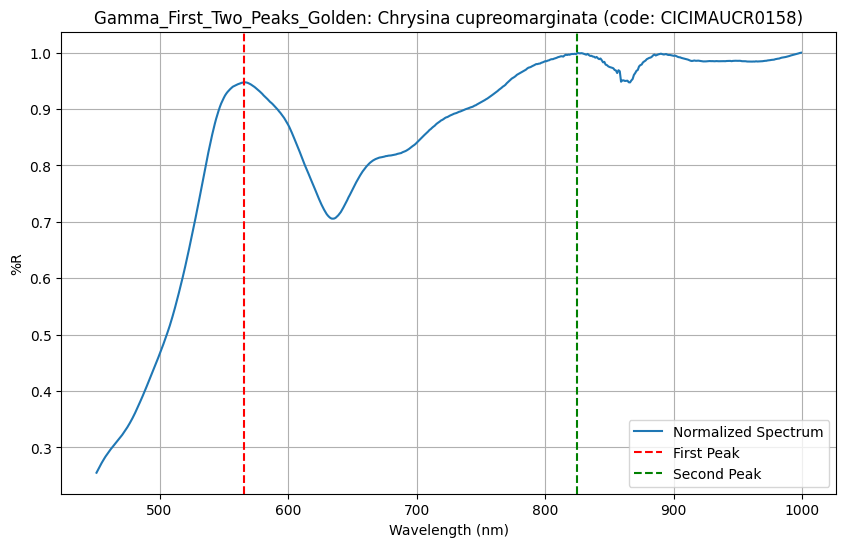

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

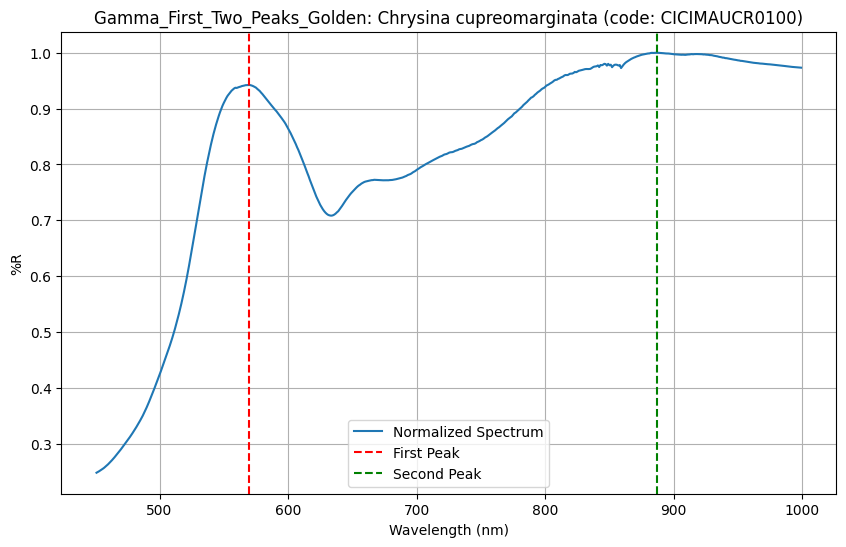

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

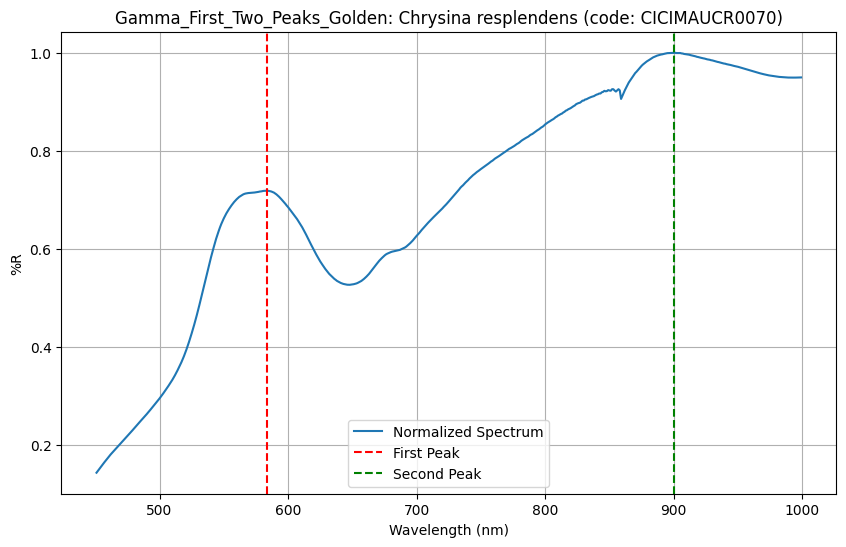

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

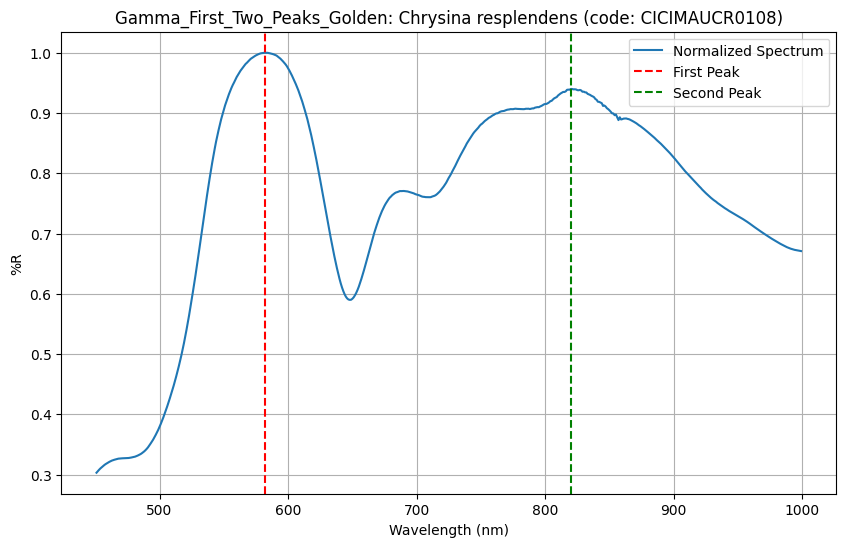

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

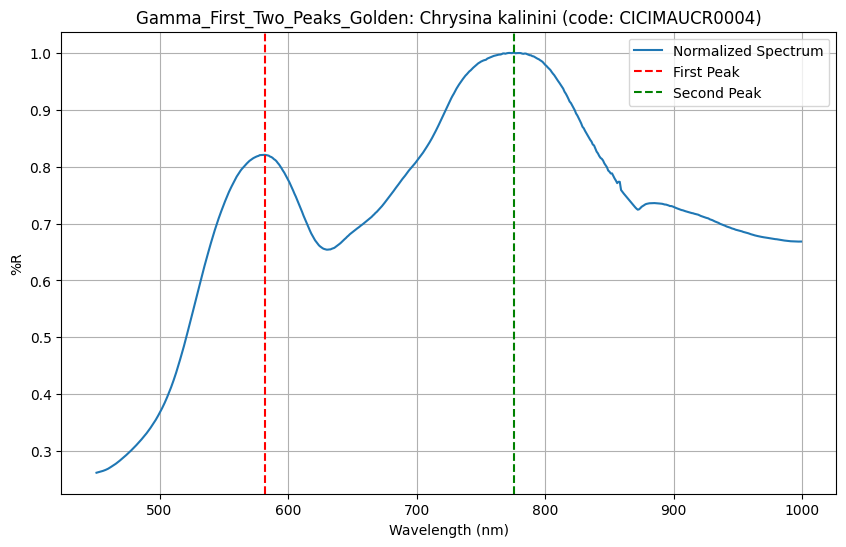

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

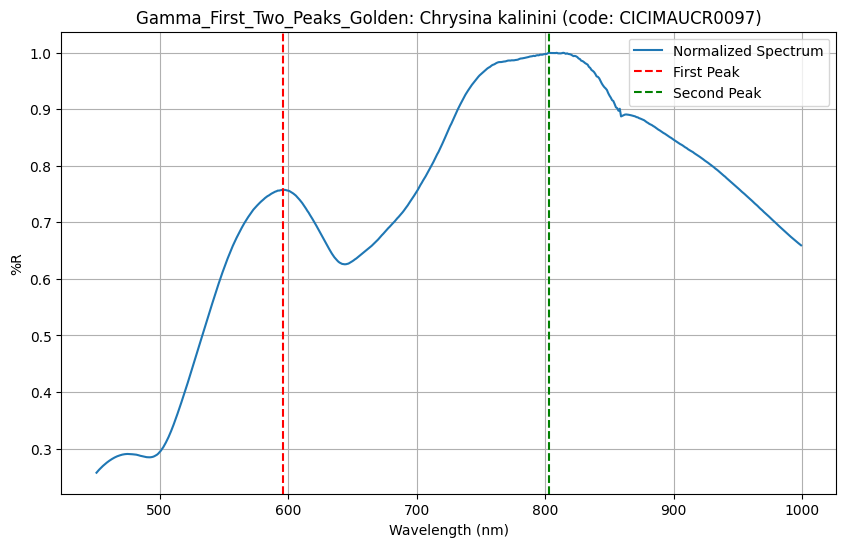

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

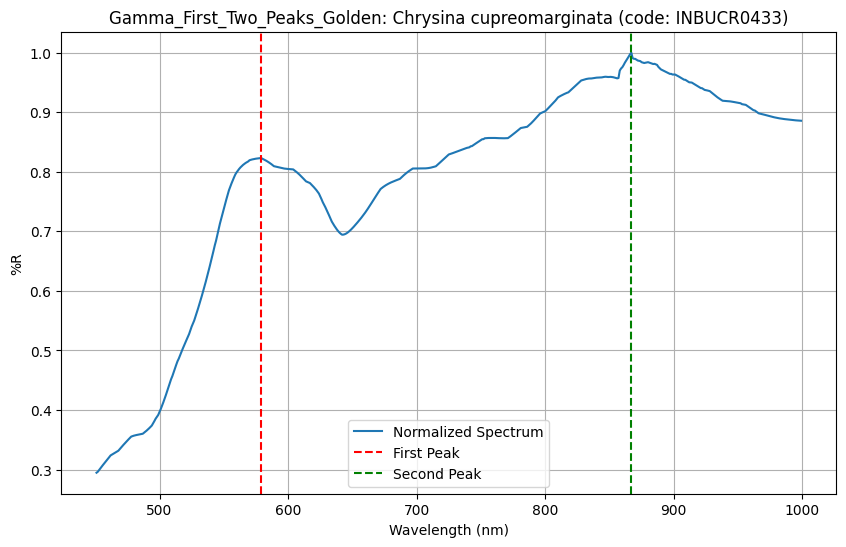

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

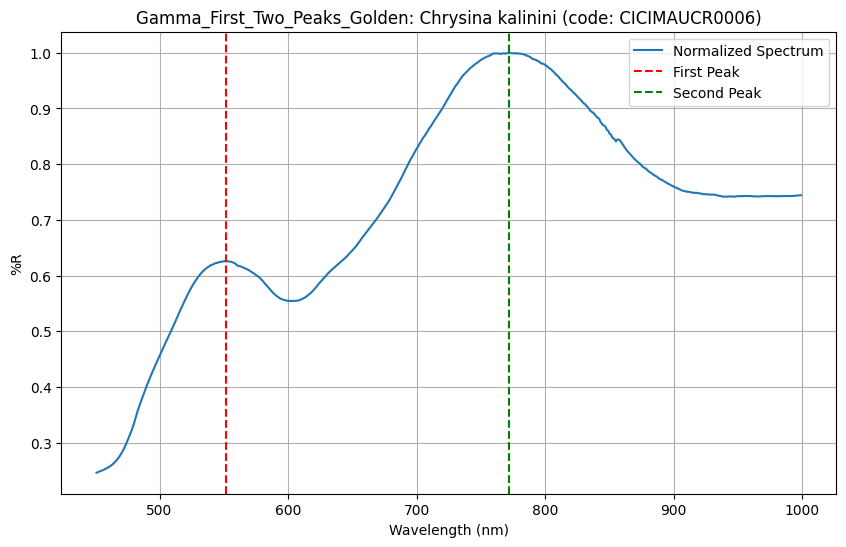

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

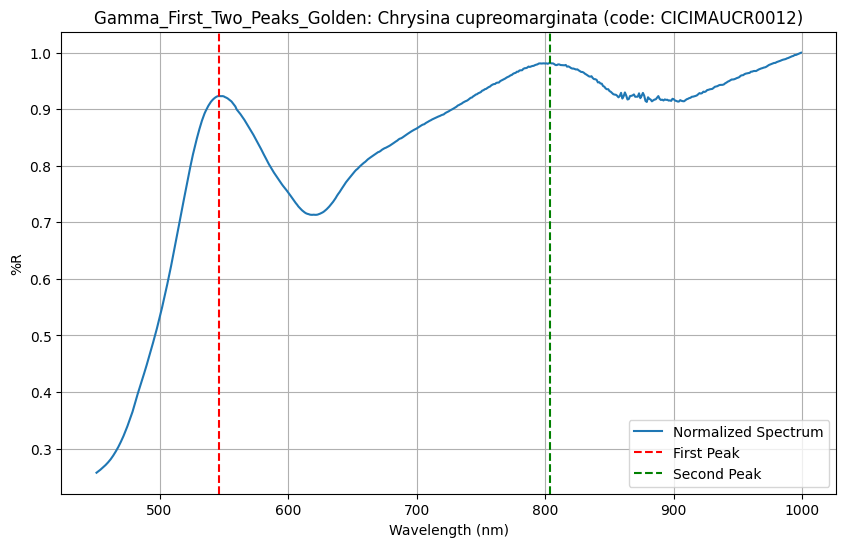

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

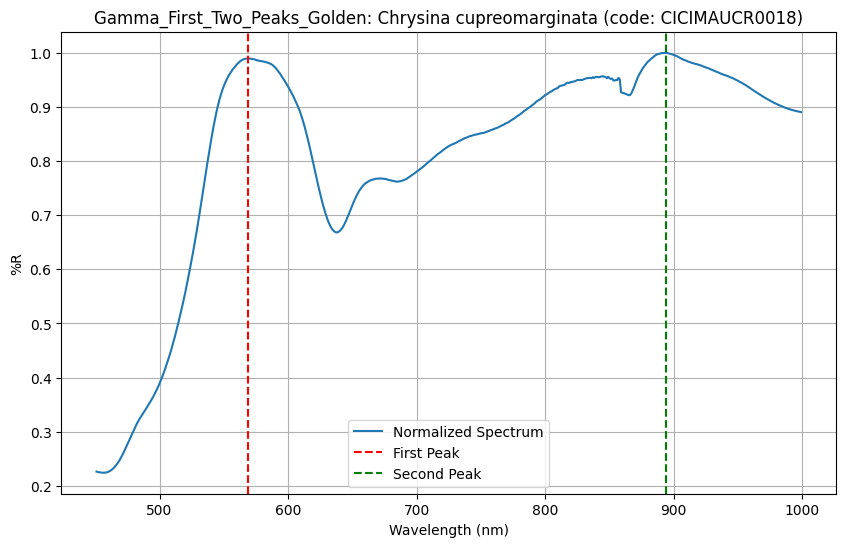

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

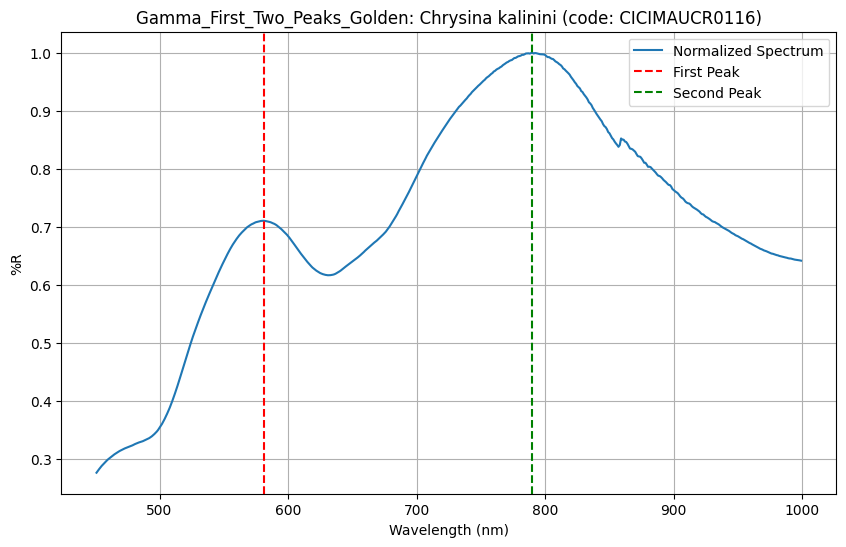

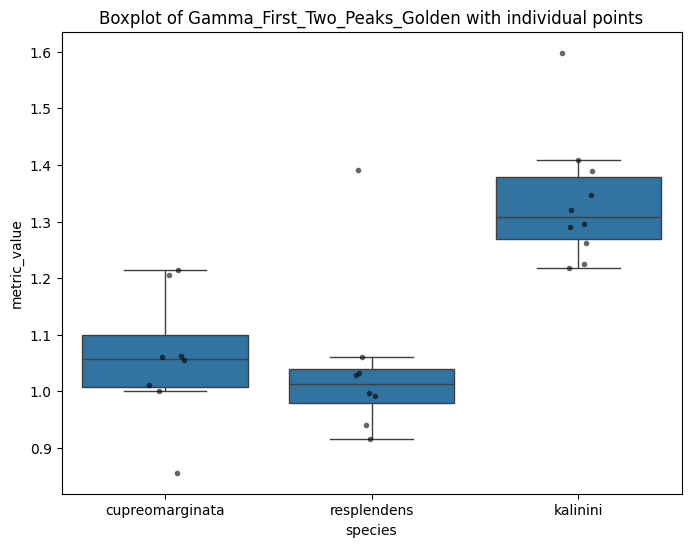

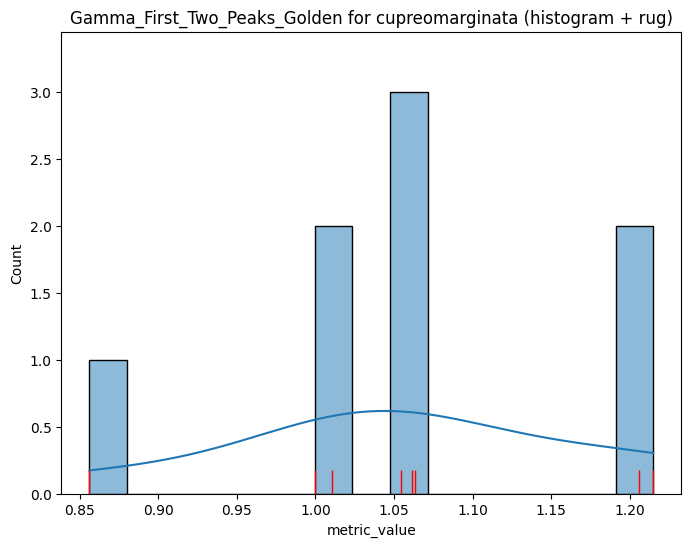

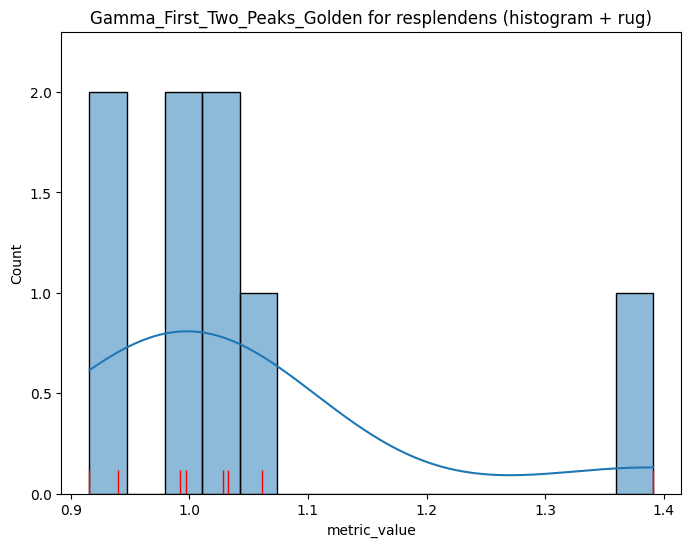

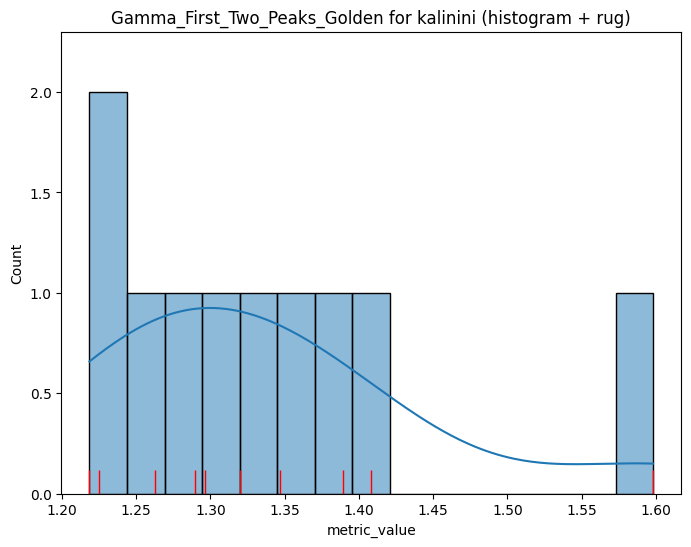

,mean,std,median,min,max,count,iqr,cv
species,,,,,,,,
cupreomarginata,1.0583,0.1151,1.0580,0.8563,1.2148,8,0.0910,0.1088
kalinini,1.3355,0.1117,1.3081,1.2186,1.5981,10,0.1097,0.0837
resplendens,1.0448,0.1479,1.0129,0.9158,1.3910,8,0.0607,0.1416


In [21]:
get_aggregated_data(Gamma_First_Two_Peaks_Golden,
                    config_file = metric_configuration_file, 
                    spectra =  train_spectra, 
                    collection_list = training_collection_list,
                    plot = True)

UV VIS MIN 450.0 UV VIS MAX: 675.0
POINT: 568.0 65.2613
ir_min_wavelength 450.0 ir_max_wavelength: 675.0
POINT: 845.0 65.2479
UV VIS MIN 450.0 UV VIS MAX: 675.0
POINT: 577.0 68.477267
ir_min_wavelength 450.0 ir_max_wavelength: 675.0
POINT: 917.0 82.571312
UV VIS MIN 450.0 UV VIS MAX: 675.0
POINT: 586.0 75.594599
ir_min_wavelength 450.0 ir_max_wavelength: 675.0
POINT: 781.0 77.695926
UV VIS MIN 450.0 UV VIS MAX: 675.0
POINT: 674.0 75.01465
ir_min_wavelength 450.0 ir_max_wavelength: 675.0
POINT: 781.0 95.61905
UV VIS MIN 450.0 UV VIS MAX: 675.0
POINT: 585.0 75.0878
ir_min_wavelength 450.0 ir_max_wavelength: 675.0
POINT: 784.0 77.23488
UV VIS MIN 450.0 UV VIS MAX: 675.0
POINT: 576.0 80.9293
ir_min_wavelength 450.0 ir_max_wavelength: 675.0
POINT: 781.0 99.0786
UV VIS MIN 450.0 UV VIS MAX: 675.0
POINT: 578.0 86.700367
ir_min_wavelength 450.0 ir_max_wavelength: 675.0
POINT: 795.0 89.5212
UV VIS MIN 450.0 UV VIS MAX: 675.0
POINT: 568.0 84.4716
ir_min_wavelength 450.0 ir_max_wavelength: 675.0


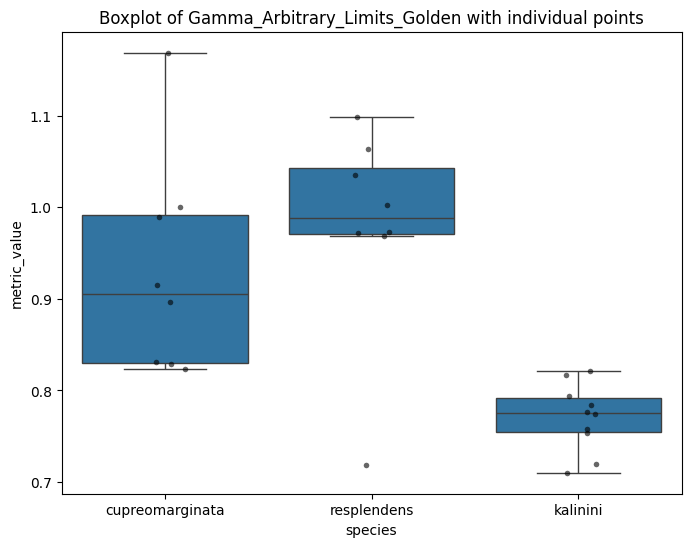

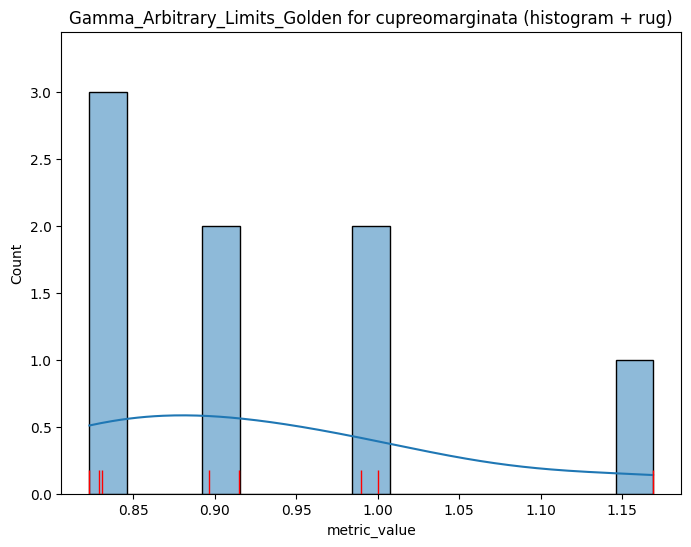

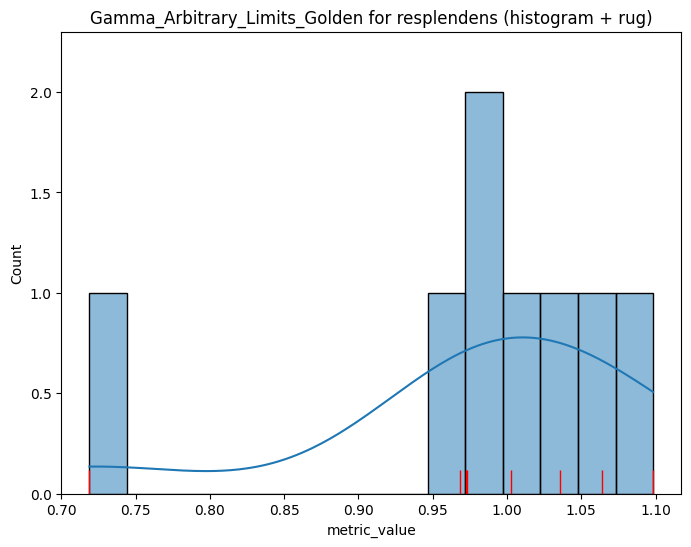

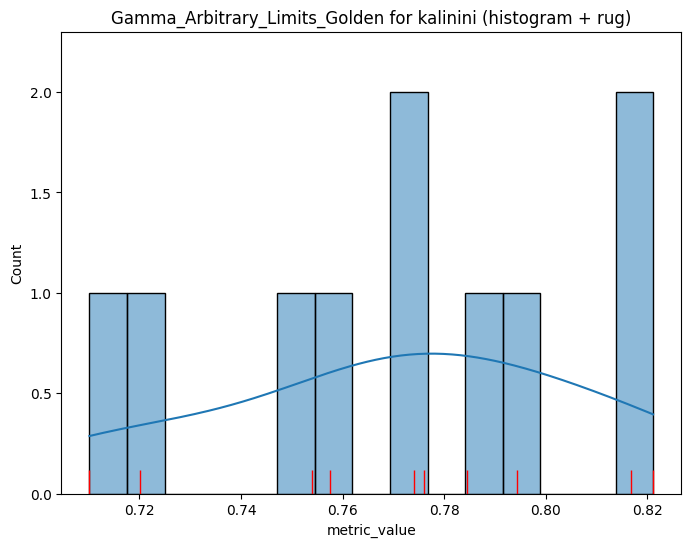

,mean,std,median,min,max,count,iqr,cv
species,,,,,,,,
cupreomarginata,0.9316,0.1185,0.9054,0.8232,1.1689,8,0.1617,0.1272
kalinini,0.7709,0.0367,0.7751,0.7102,0.8212,10,0.0370,0.0476
resplendens,0.9792,0.1153,0.9879,0.7189,1.0983,8,0.0715,0.1178


In [22]:
get_aggregated_data(Gamma_Arbitrary_Limits_Golden,
                    config_file = metric_configuration_file, 
                    spectra =  train_spectra, 
                    collection_list = training_collection_list,
                    plot = True)

Getting equipment. Spectrum


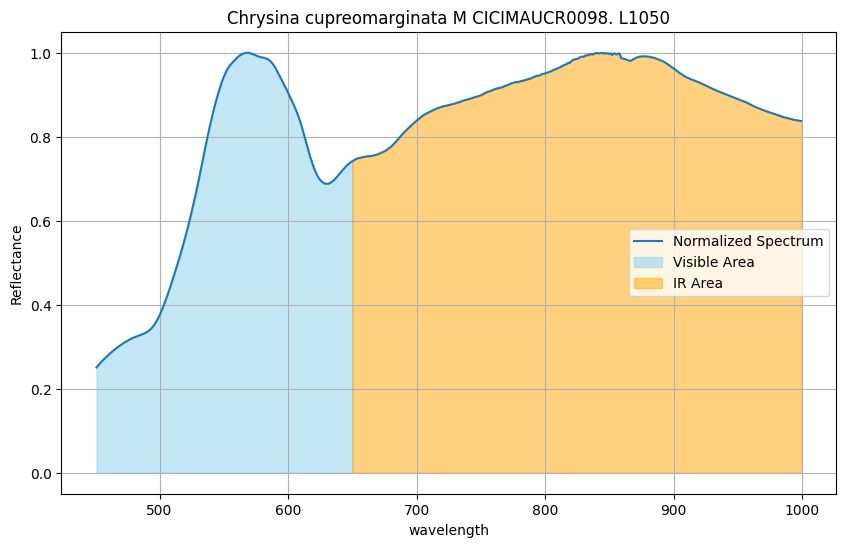

Getting equipment. Spectrum


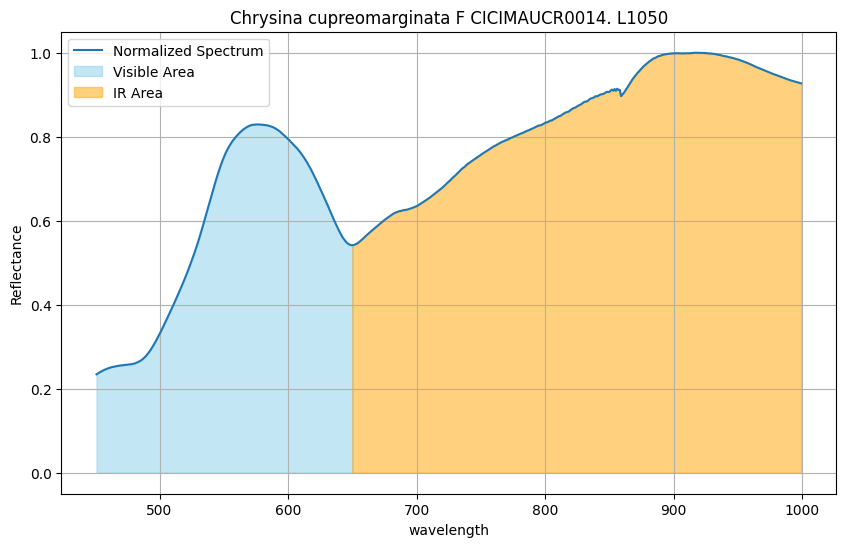

Getting equipment. Spectrum


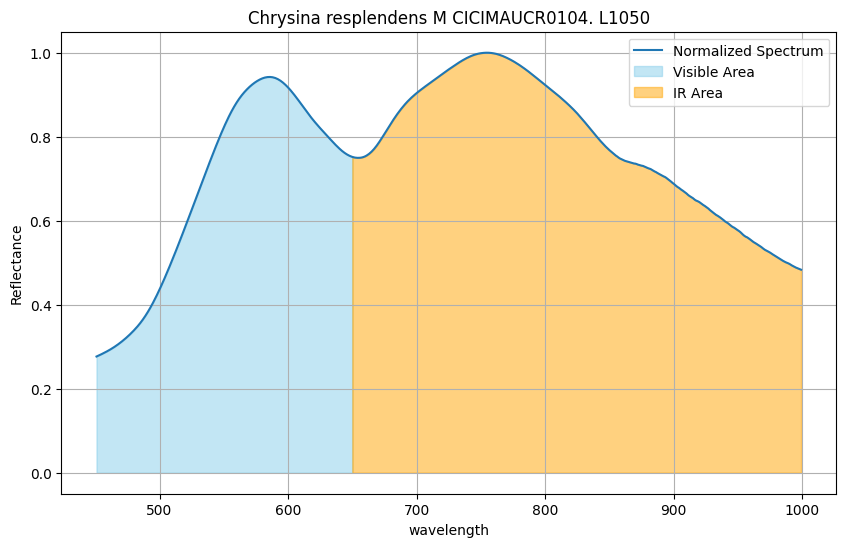

Getting equipment. Spectrum


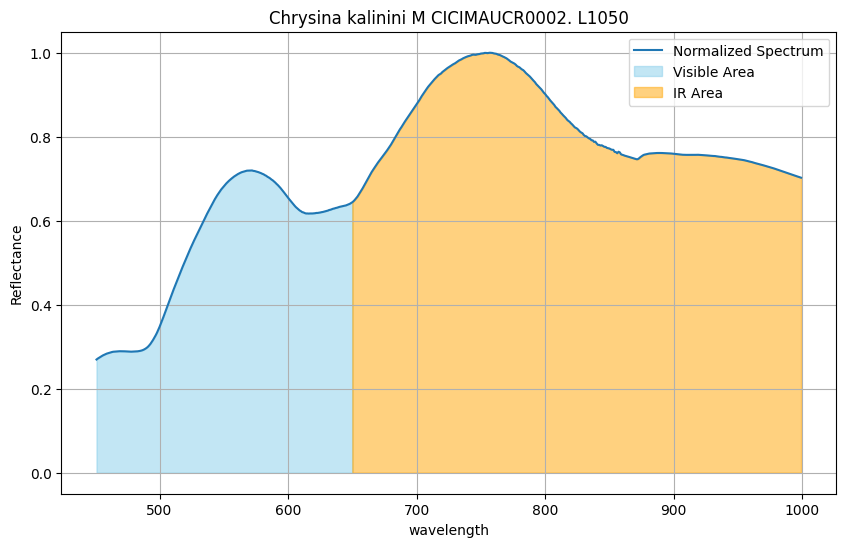

Getting equipment. Spectrum


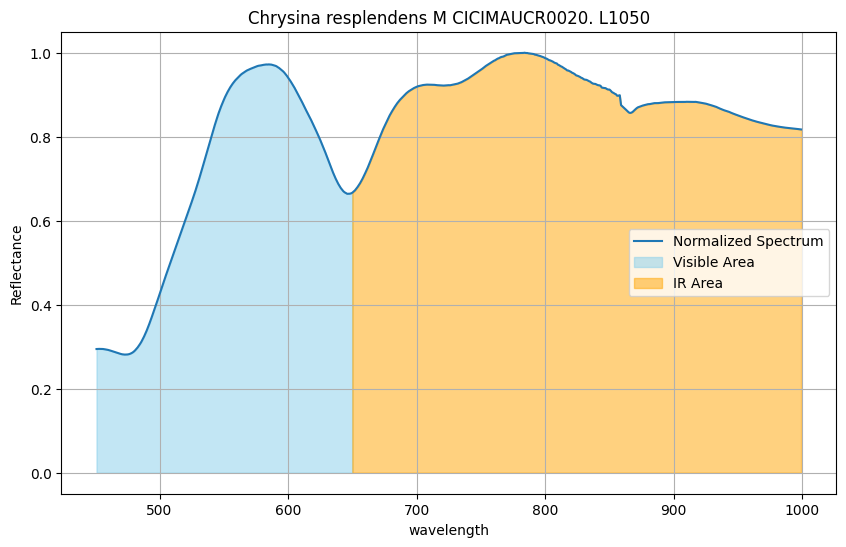

Getting equipment. Spectrum


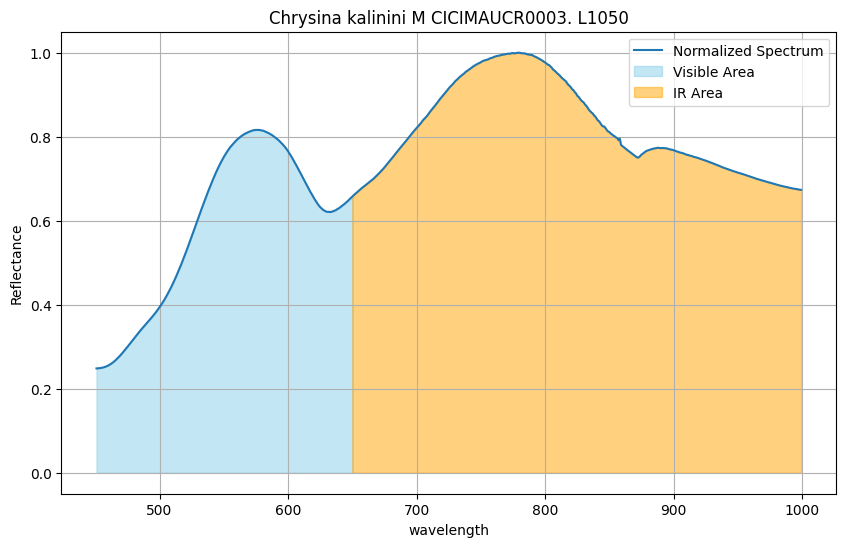

Getting equipment. Spectrum


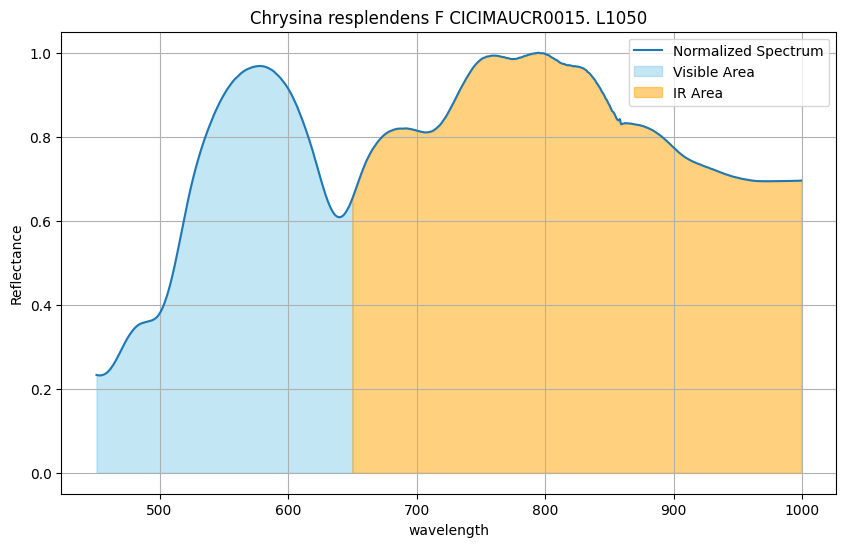

Getting equipment. Spectrum


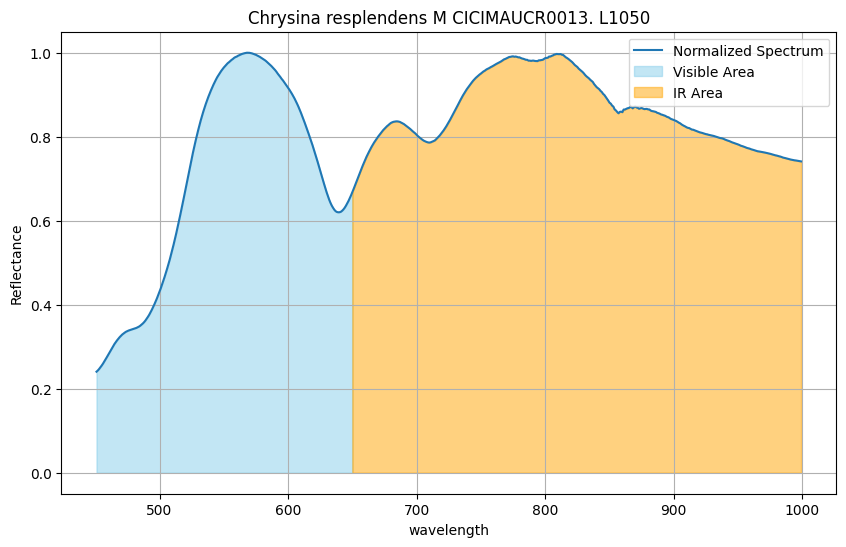

Getting equipment. Spectrum


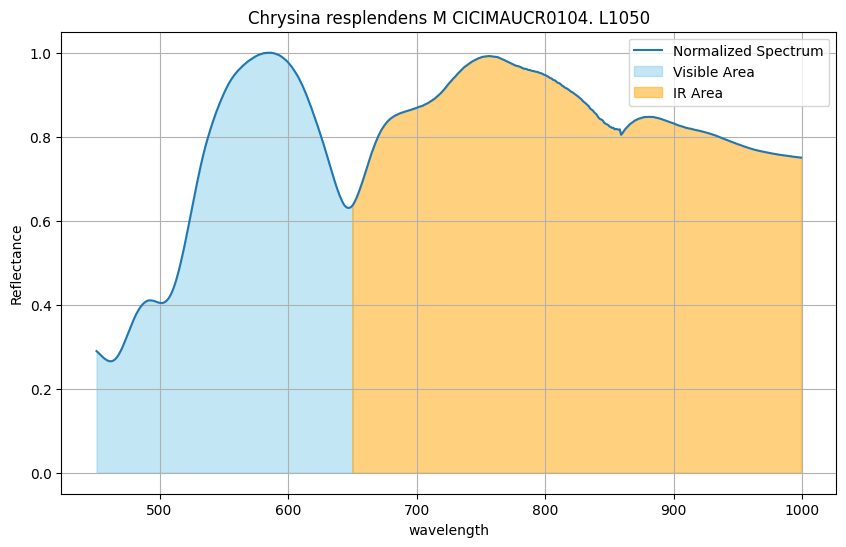

Getting equipment. Spectrum


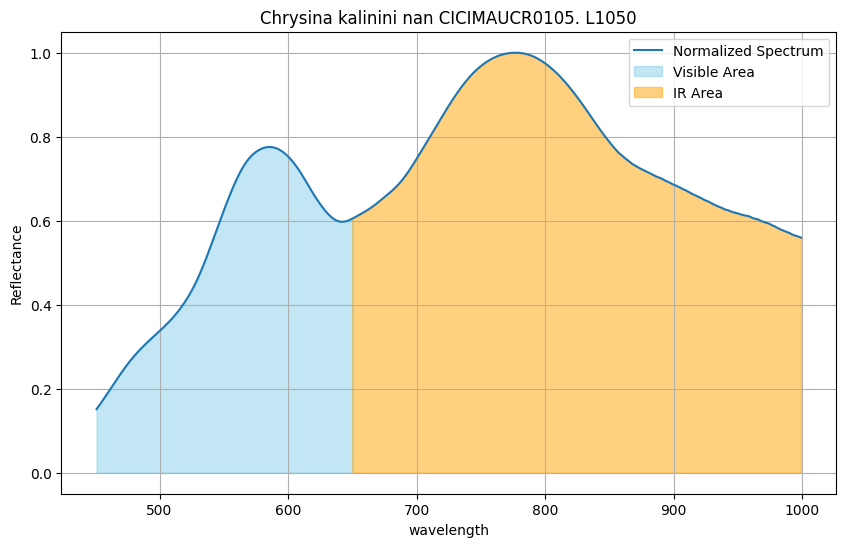

Getting equipment. Spectrum


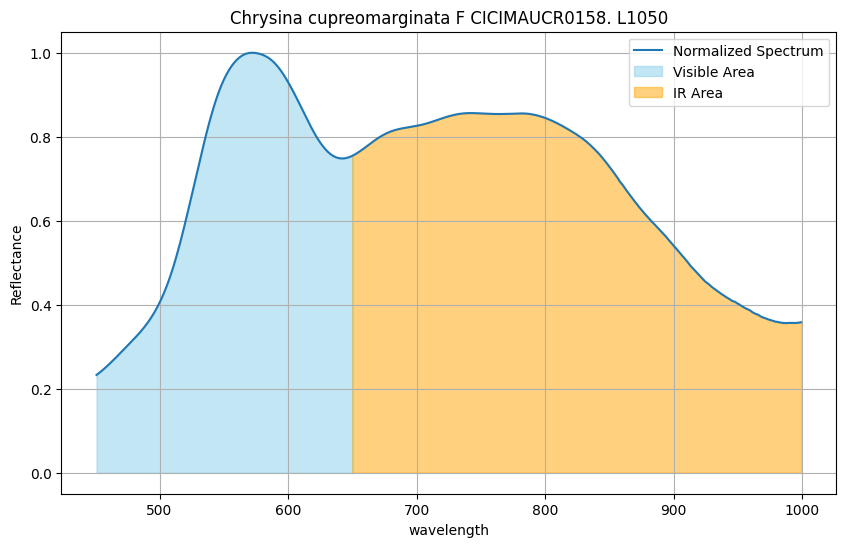

Getting equipment. Spectrum


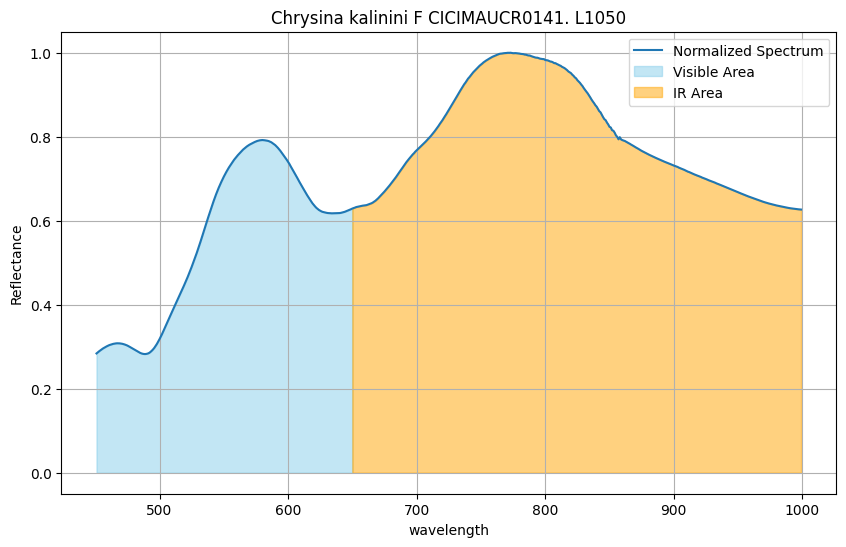

Getting equipment. Spectrum


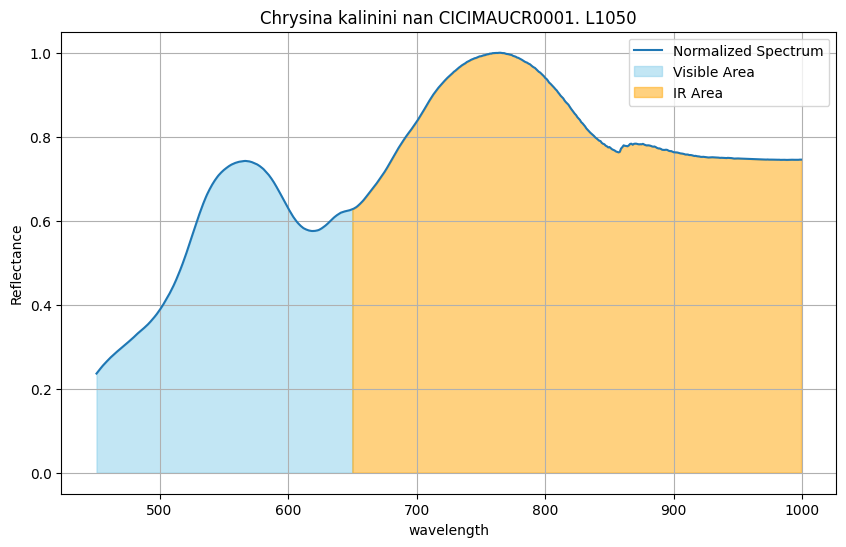

Getting equipment. Spectrum


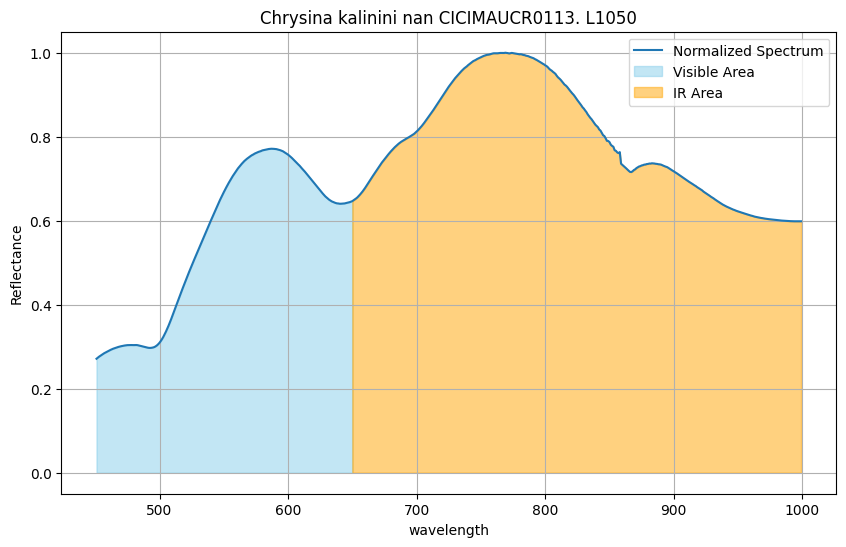

Getting equipment. Spectrum


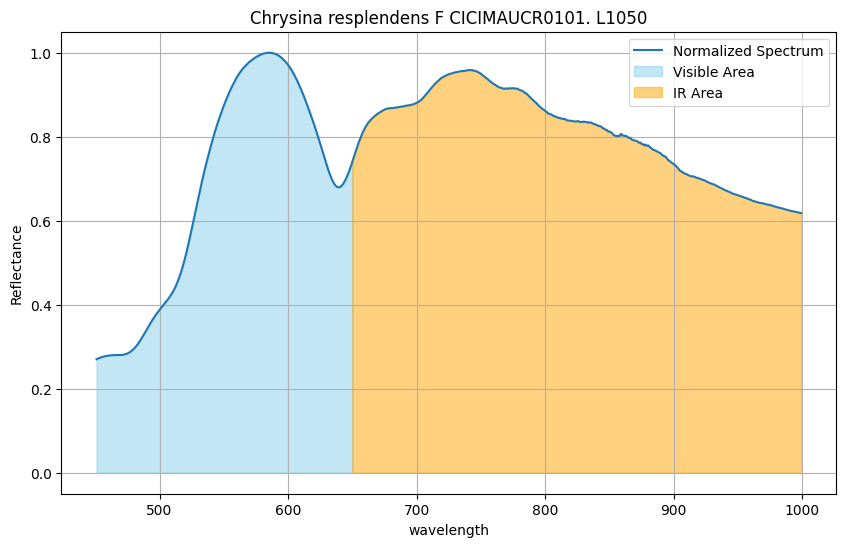

Getting equipment. Spectrum


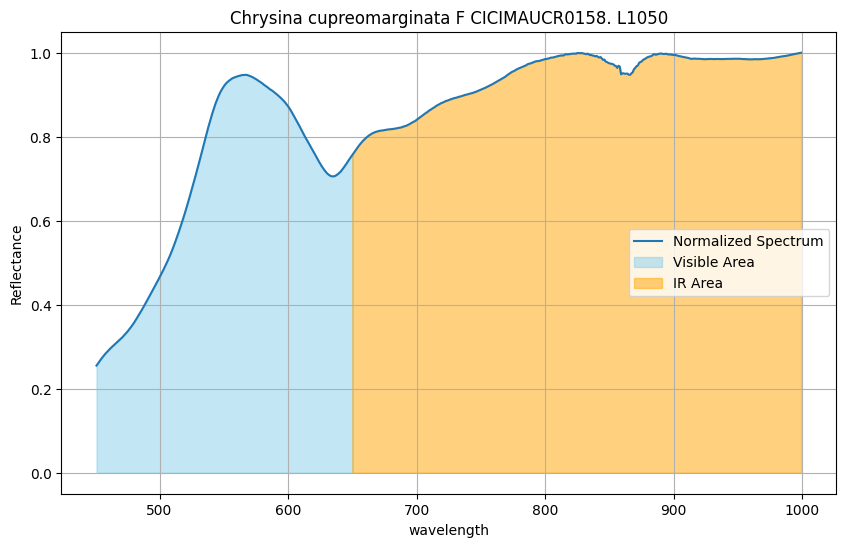

Getting equipment. Spectrum


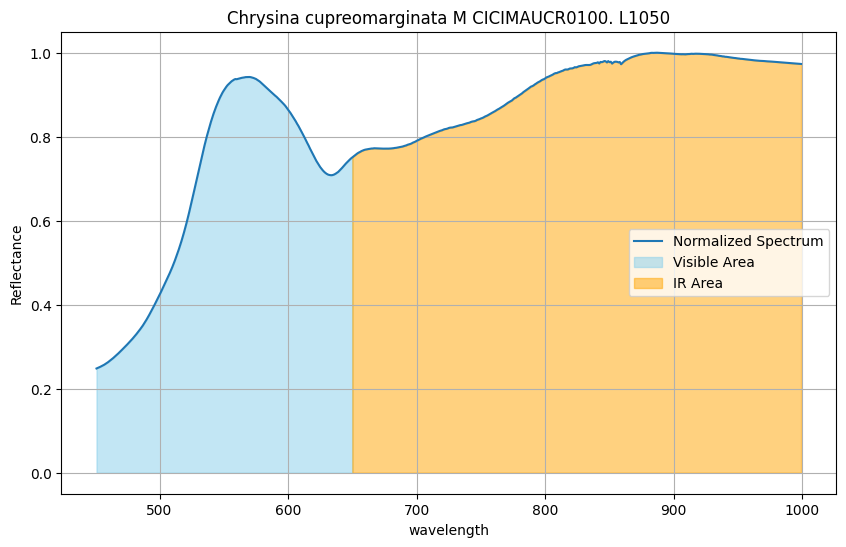

Getting equipment. Spectrum


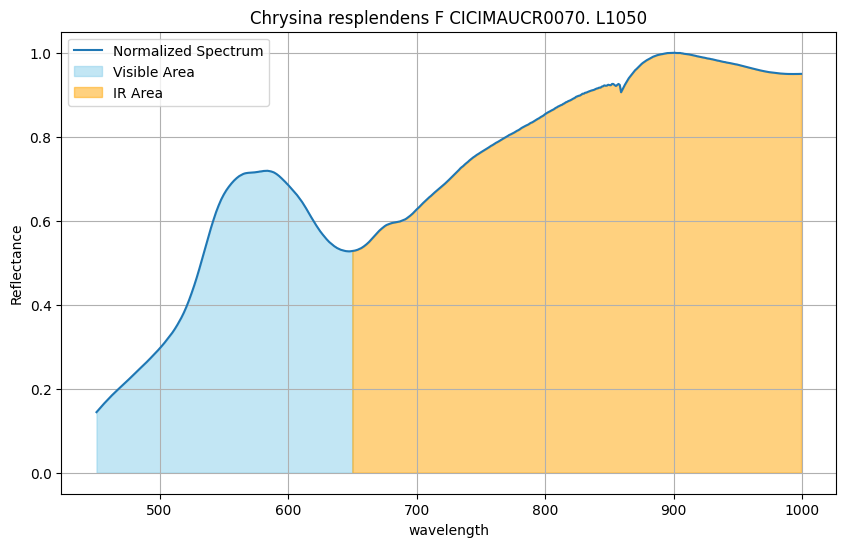

Getting equipment. Spectrum


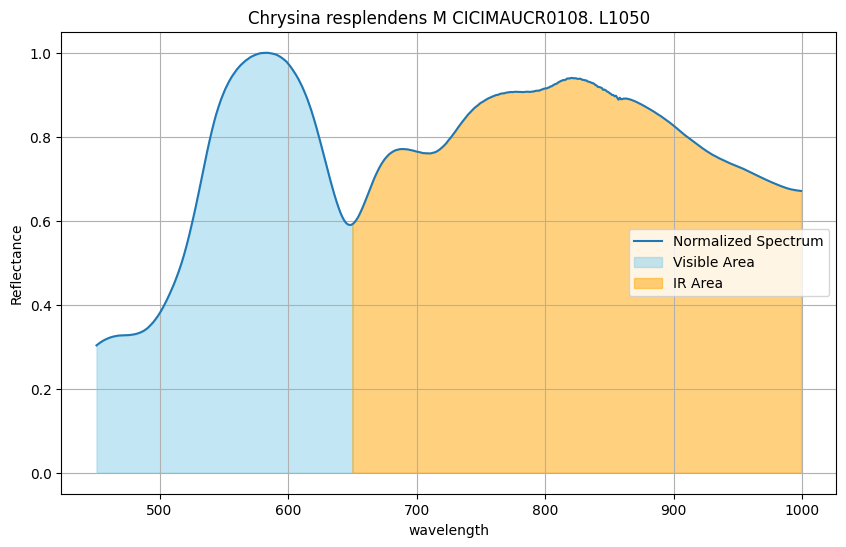

Getting equipment. Spectrum


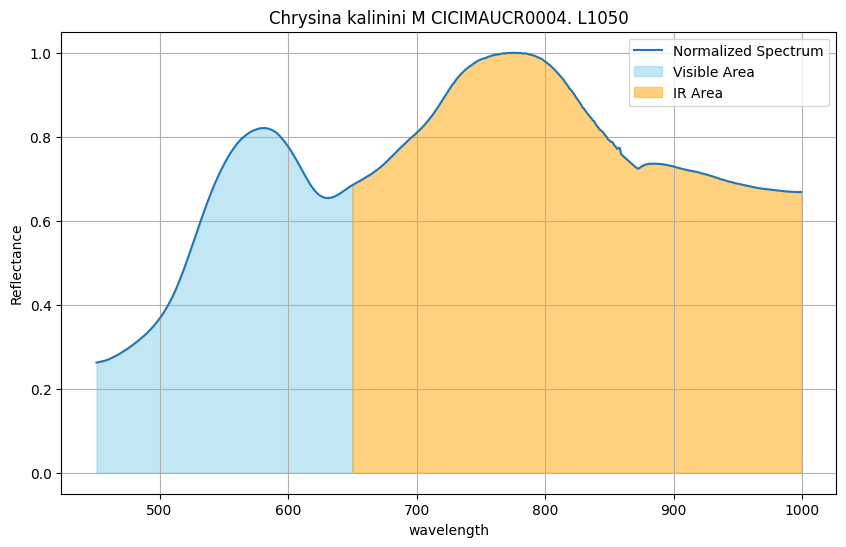

Getting equipment. Spectrum


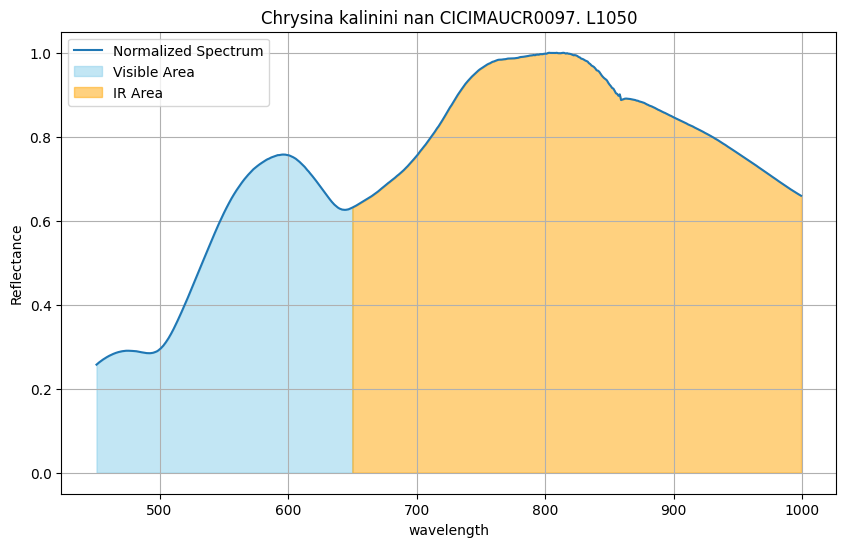

Getting equipment. Spectrum


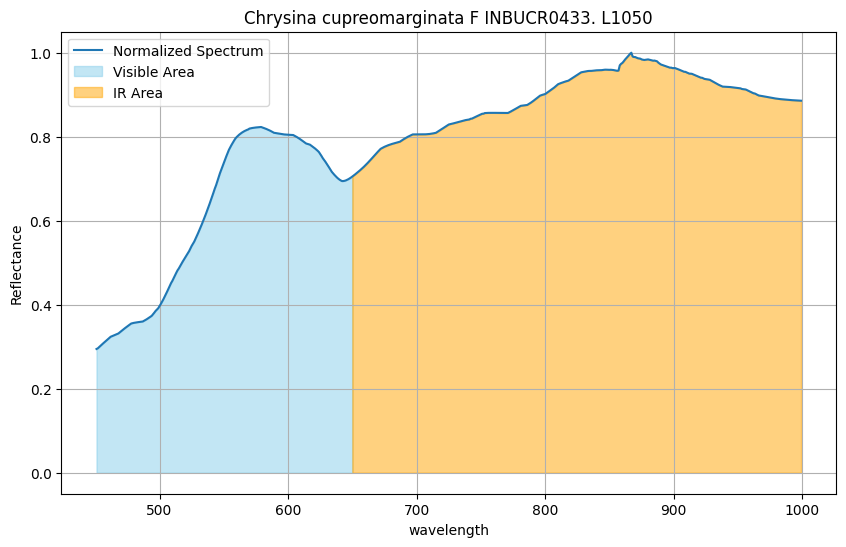

Getting equipment. Spectrum


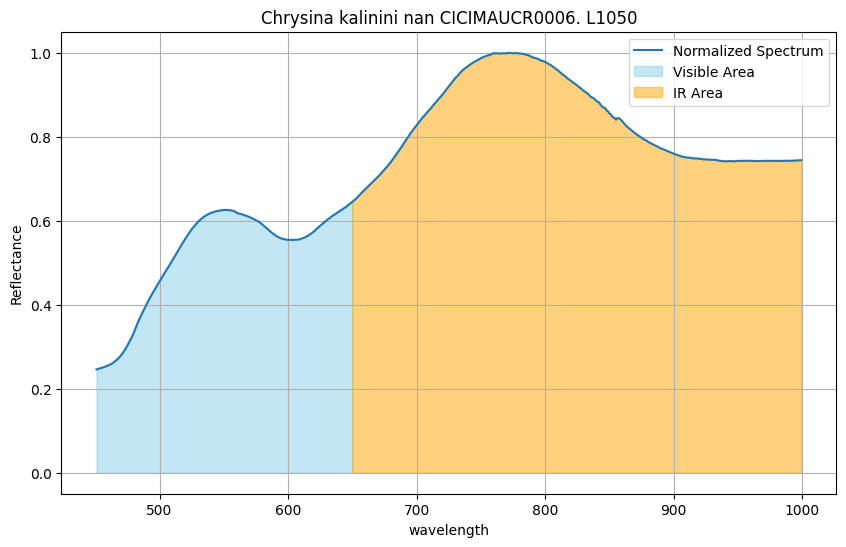

Getting equipment. Spectrum


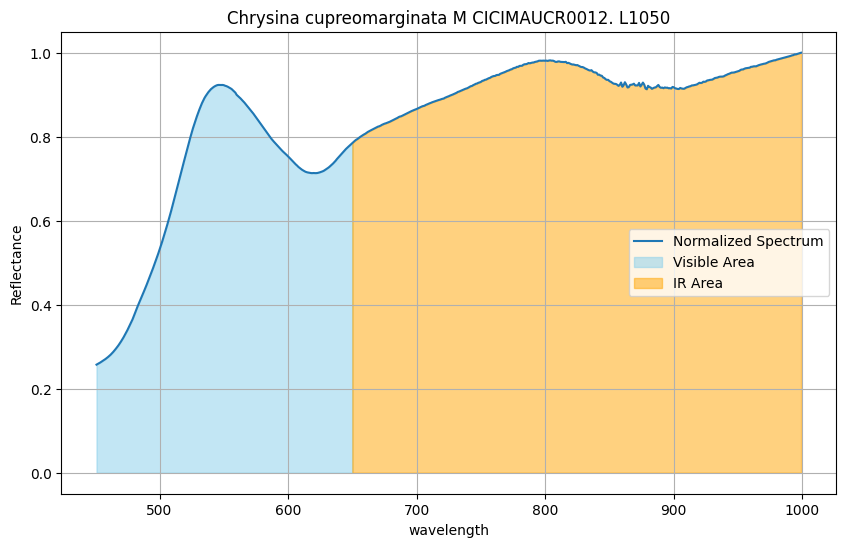

Getting equipment. Spectrum


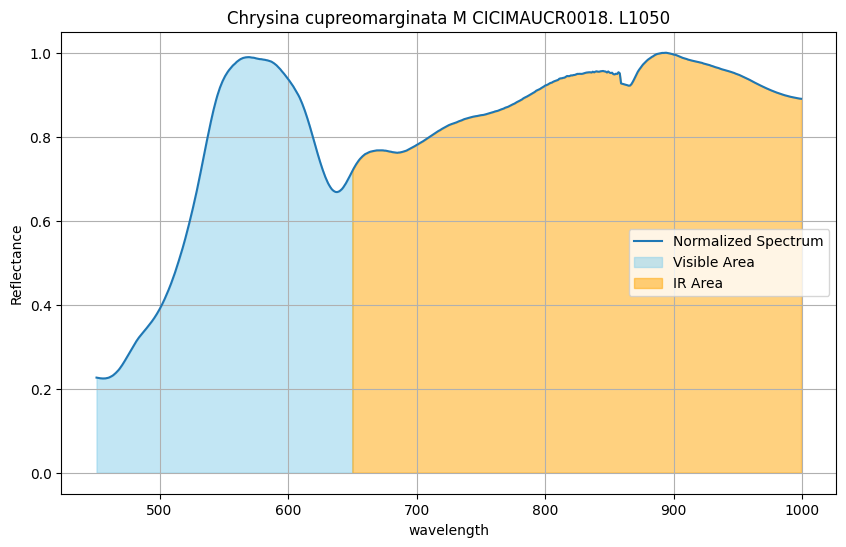

Getting equipment. Spectrum


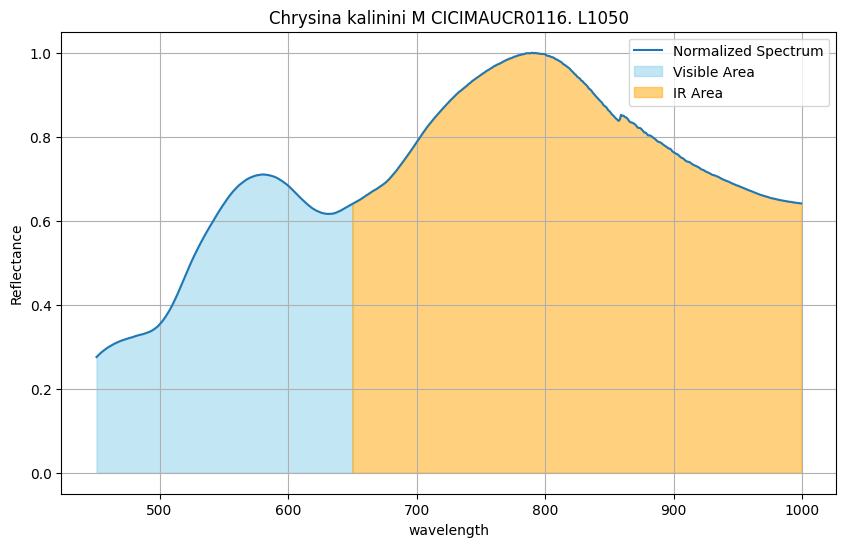

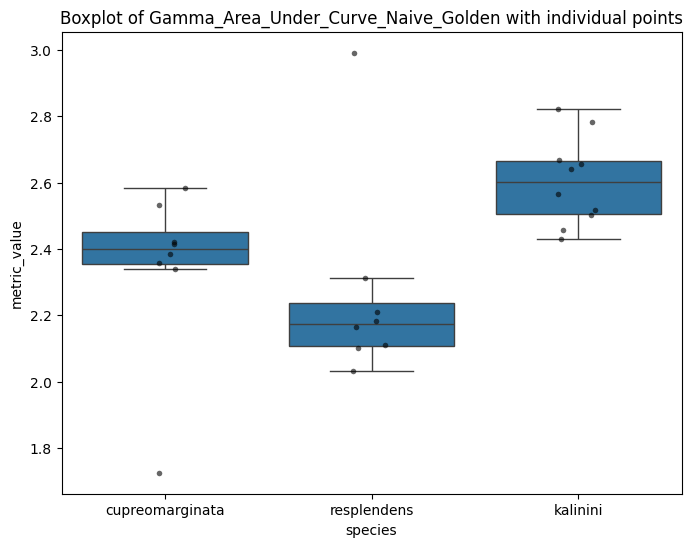

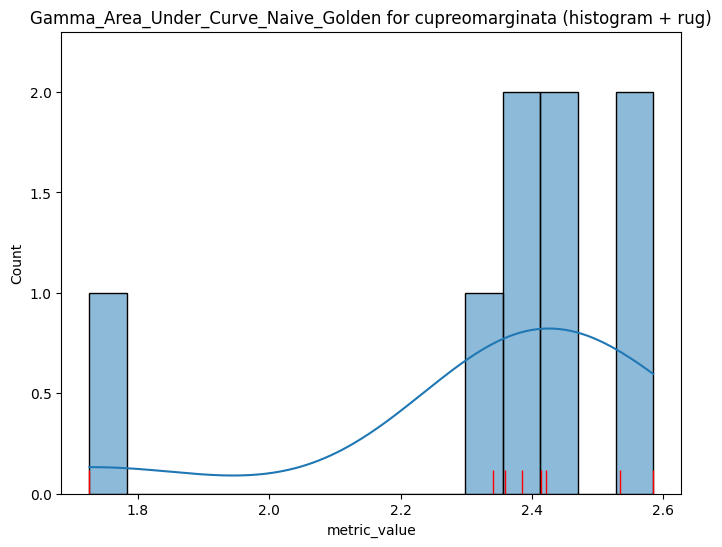

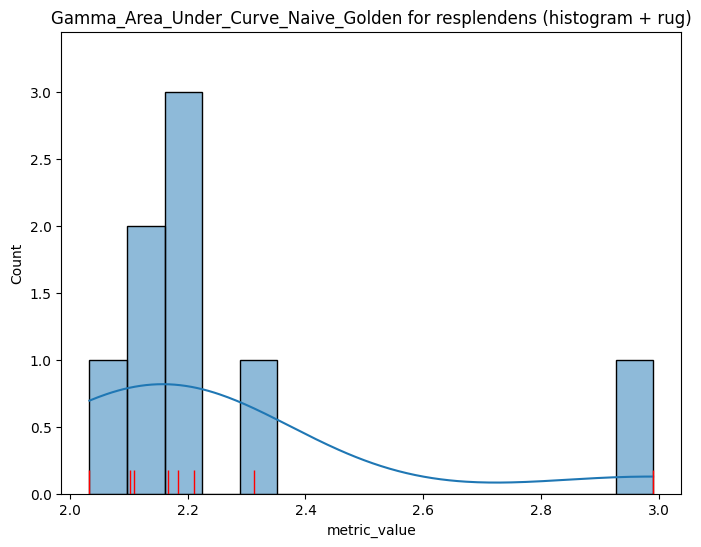

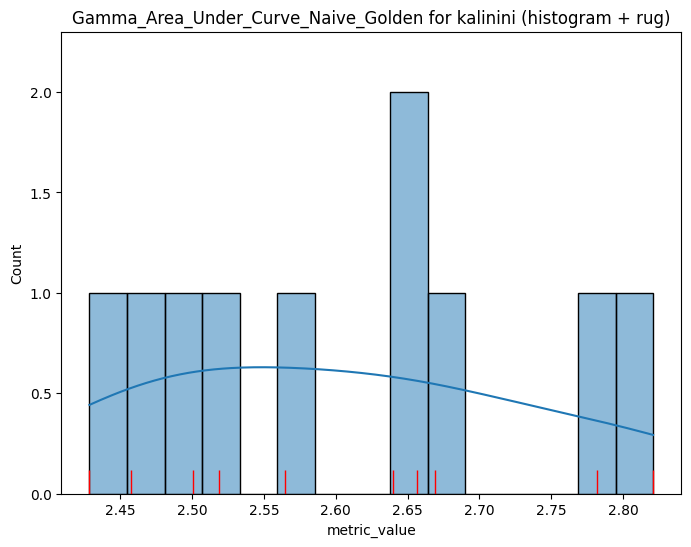

,mean,std,median,min,max,count,iqr,cv
species,,,,,,,,
cupreomarginata,2.3455,0.2641,2.3992,1.7262,2.5845,8,0.0954,0.1126
kalinini,2.6038,0.1327,2.6022,2.4287,2.8208,10,0.1607,0.0510
resplendens,2.2636,0.3054,2.1748,2.0329,2.9907,8,0.1288,0.1349


In [23]:
get_aggregated_data(Gamma_Area_Under_Curve_Naive_Golden,
                    config_file = metric_configuration_file, 
                    spectra =  train_spectra, 
                    collection_list = training_collection_list,
                    plot = True)

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.250804
202       452.0  0.254517
203       453.0  0.258051
204       454.0  0.261454
205       455.0  0.264814
..          ...       ...
745       995.0  0.839594
746       996.0  0.839097
747       997.0  0.838577
748       998.0  0.837956
749       999.0  0.837397

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.059033
1          251.0   6.052233
2          252.0   6.033967
3          253.0   6.025833
4          254.0   5.993167
...          ...        ...
1745      1995.0  11.156570
1746      1996.0  11.178961
1747      1997.0  11.205560
1748      1998.0  11.239035
1749      1999.0  11.260341

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [117 394] [568. 845.] [65.2613 65.2479]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=48.893533000000005, 
                  bottom_thr=0.0, top_thr=

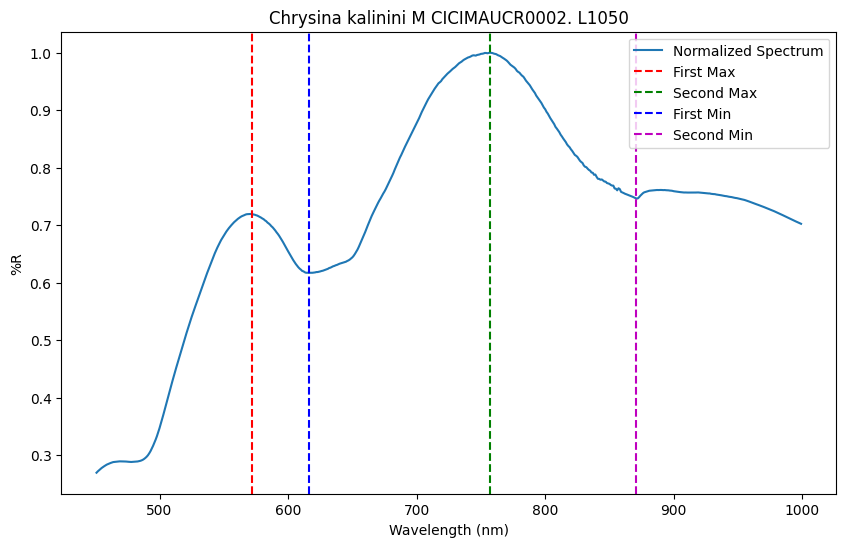

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.294518
202       452.0  0.294798
203       453.0  0.294848
204       454.0  0.294756
205       455.0  0.294713
..          ...       ...
745       995.0  0.818920
746       996.0  0.818662
747       997.0  0.818118
748       998.0  0.817665
749       999.0  0.817347

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   5.691060
1          251.0   5.661860
2          252.0   5.673480
3          253.0   5.679480
4          254.0   5.647980
...          ...        ...
1745      1995.0  18.102704
1746      1996.0  18.168534
1747      1997.0  18.218921
1748      1998.0  18.262135
1749      1999.0  18.307018

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [134 333 459] [585. 784. 910.] [75.0878   77.23488  68.210945]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=55.50916000000001, 
                  bo

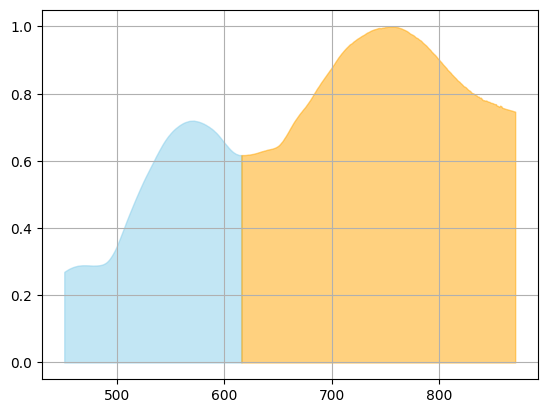

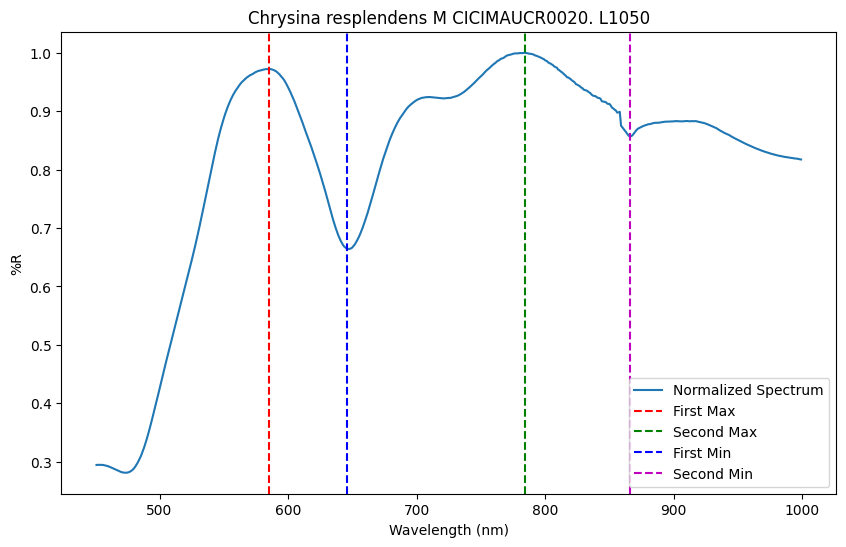

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.248321
202       452.0  0.248594
203       453.0  0.248813
204       454.0  0.249158
205       455.0  0.249765
..          ...       ...
745       995.0  0.675611
746       996.0  0.674960
747       997.0  0.674461
748       998.0  0.673890
749       999.0  0.673556

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.264300
1          251.0   6.269200
2          252.0   6.246400
3          253.0   6.215900
4          254.0   6.196933
...          ...        ...
1745      1995.0  21.554323
1746      1996.0  21.613598
1747      1997.0  21.652972
1748      1998.0  21.694313
1749      1999.0  21.724248

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [125 328 437] [576. 779. 888.] [80.9293   99.150667 76.711305]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=74.529467, 
                  bottom_thr

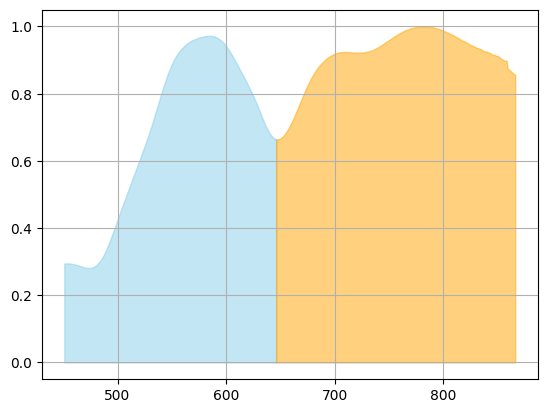

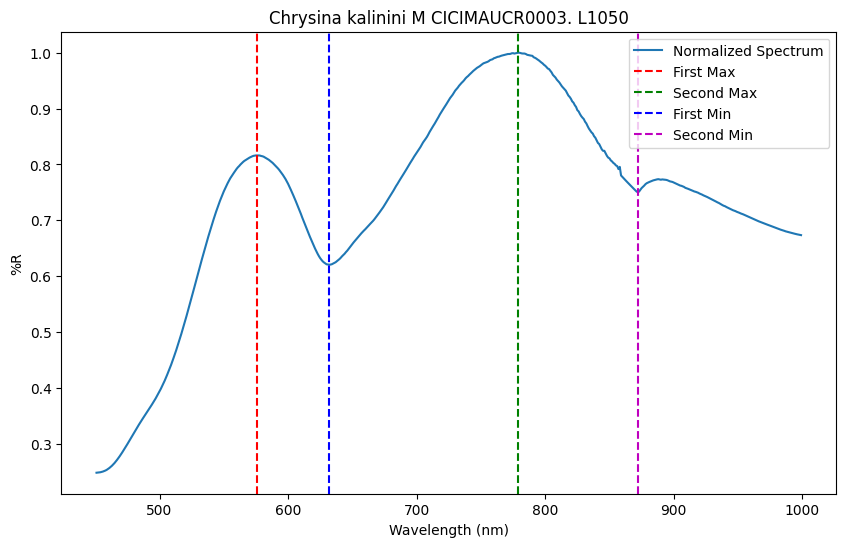

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.232822
202       452.0  0.232116
203       453.0  0.231735
204       454.0  0.231716
205       455.0  0.232214
..          ...       ...
745       995.0  0.694974
746       996.0  0.695055
747       997.0  0.695269
748       998.0  0.695421
749       999.0  0.695535

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.108967
1          251.0   6.101900
2          252.0   6.079567
3          253.0   6.068200
4          254.0   6.084167
...          ...        ...
1745      1995.0  21.369957
1746      1996.0  21.406533
1747      1997.0  21.467083
1748      1998.0  21.489857
1749      1999.0  21.513057

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [127 241 344 543] [578. 692. 795. 994.] [86.700367 73.402367 89.5212   62.225325]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=68.777667, 
         

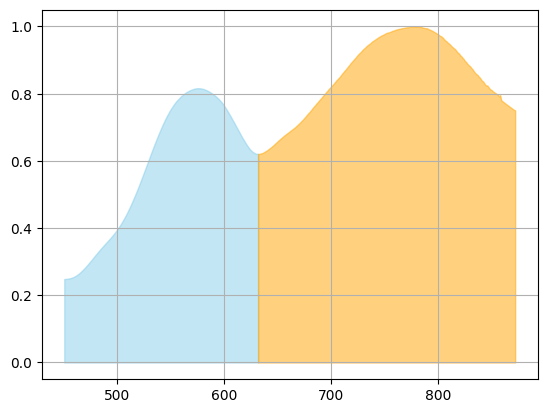

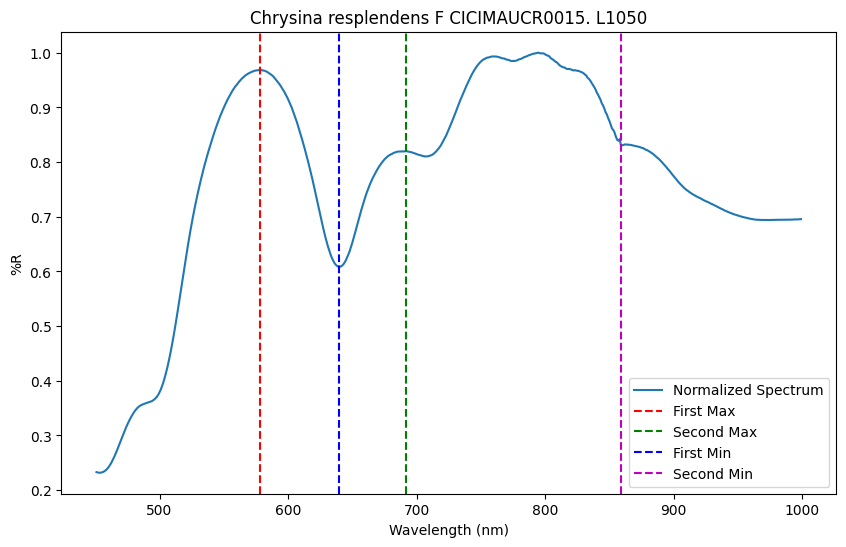

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.240541
202       452.0  0.243406
203       453.0  0.246896
204       454.0  0.250813
205       455.0  0.255074
..          ...       ...
745       995.0  0.743455
746       996.0  0.742815
747       997.0  0.742113
748       998.0  0.741787
749       999.0  0.741254

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.227900
1          251.0   6.212500
2          252.0   6.174433
3          253.0   6.191967
4          254.0   6.170433
...          ...        ...
1745      1995.0  19.510730
1746      1996.0  19.579398
1747      1997.0  19.636737
1748      1998.0  19.681657
1749      1999.0  19.693297

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [117 233 358] [568. 684. 809.] [84.4716   70.665633 84.228333]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=64.1527, 
                  bottom_thr=0

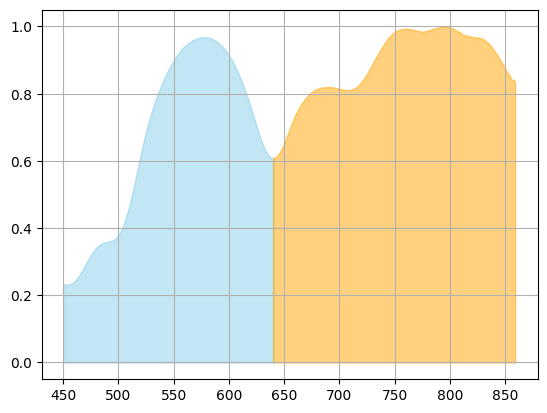

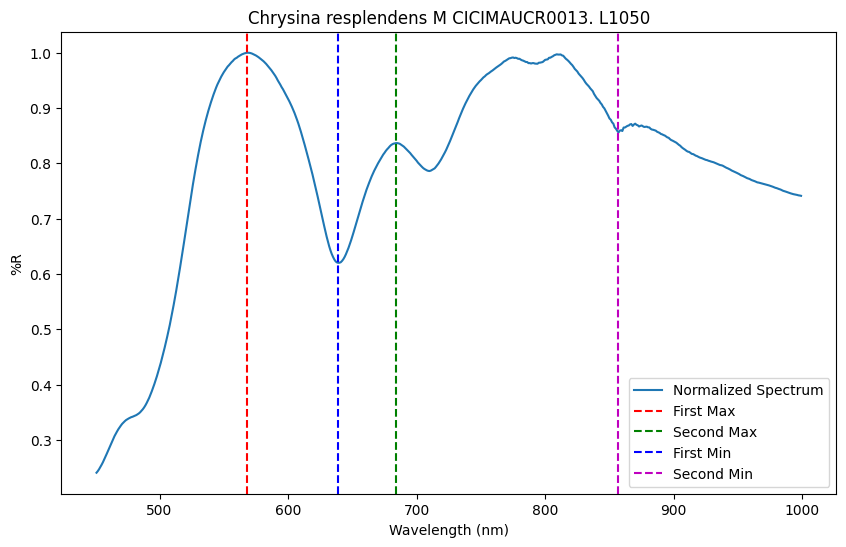

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.289721
202       452.0  0.286862
203       453.0  0.283899
204       454.0  0.280942
205       455.0  0.277948
..          ...       ...
745       995.0  0.751731
746       996.0  0.751282
747       997.0  0.750913
748       998.0  0.750612
749       999.0  0.750269

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.735933
1          251.0   6.753967
2          252.0   6.719933
3          253.0   6.718033
4          254.0   6.693367
...          ...        ...
1745      1995.0  25.450630
1746      1996.0  25.529126
1747      1997.0  25.583074
1748      1998.0  25.643778
1749      1999.0  25.706195

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [135 305 430] [586. 756. 881.] [93.416433 92.672367 79.160728]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=68.632466, 
                  bottom_thr

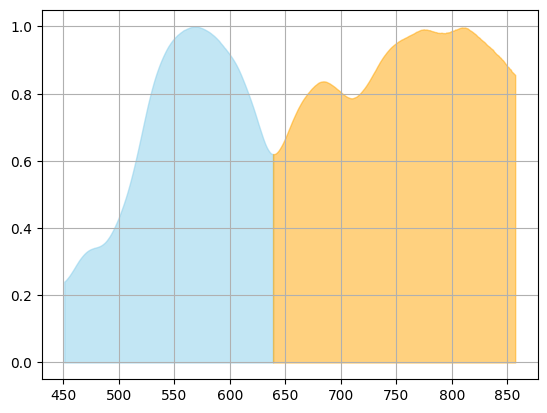

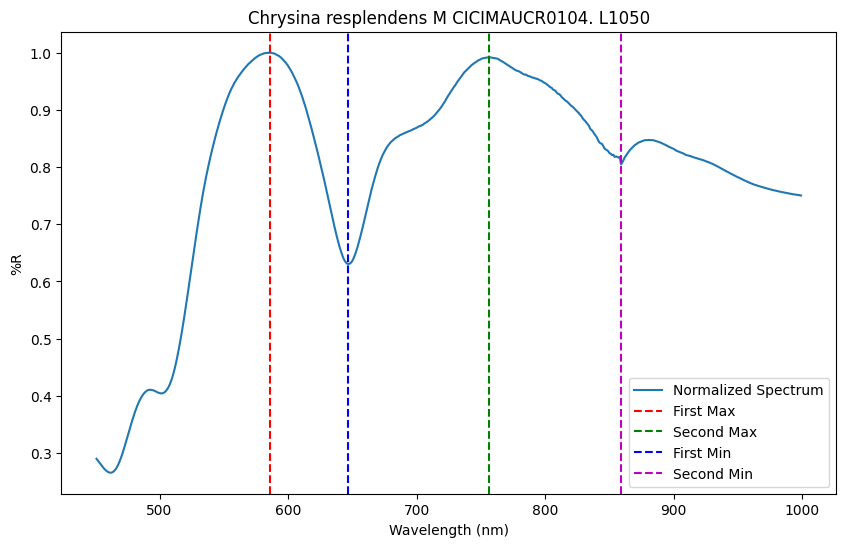

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
167       451.0  0.151221
168       452.0  0.155388
169       453.0  0.159644
170       454.0  0.163968
171       455.0  0.168357
..          ...       ...
711       995.0  0.564075
712       996.0  0.563258
713       997.0  0.561996
714       998.0  0.560905
715       999.0  0.559747

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          284.0   1.005921
1          285.0   1.130663
2          286.0   1.250340
3          287.0   1.369472
4          288.0   1.481847
...          ...        ...
1711      1995.0  18.162503
1712      1996.0  18.240729
1713      1997.0  18.277948
1714      1998.0  18.348353
1715      1999.0  18.375664

[1716 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [135 325] [586. 776.] [63.605839 82.017313]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=69.614549, 
                  bottom_thr=0.0, top_thr=69.61

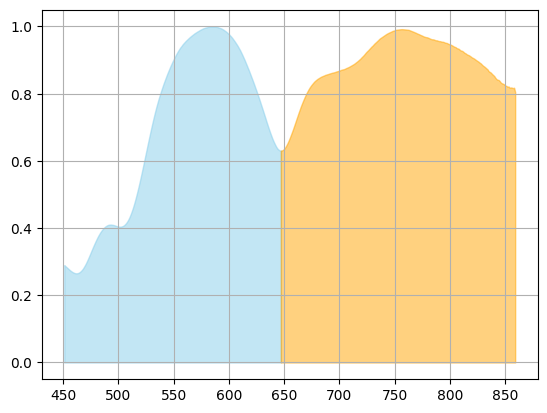

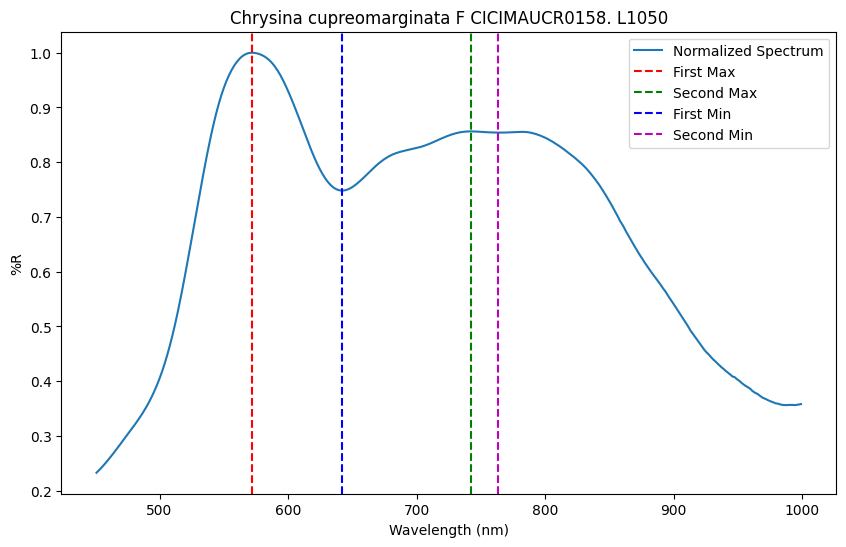

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.284006
202       452.0  0.286629
203       453.0  0.289090
204       454.0  0.291411
205       455.0  0.293722
..          ...       ...
745       995.0  0.627935
746       996.0  0.627558
747       997.0  0.627178
748       998.0  0.626884
749       999.0  0.626628

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.390333
1          251.0   6.389500
2          252.0   6.380300
3          253.0   6.354200
4          254.0   6.367300
...          ...        ...
1745      1995.0  21.051944
1746      1996.0  21.140525
1747      1997.0  21.215391
1748      1998.0  21.294900
1749      1999.0  21.366582

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [129 322] [580. 773.] [77.3671   97.670367]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=70.071434, 
                  bottom_thr=0.0, top_thr=70.07

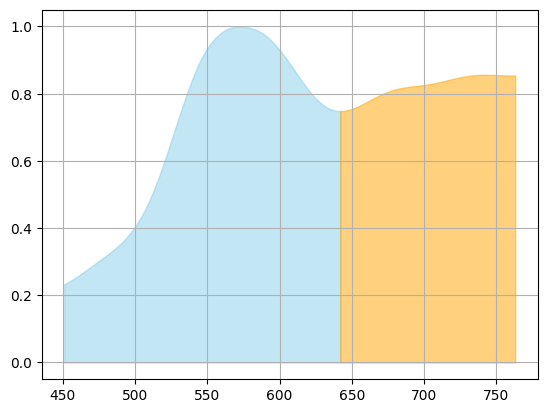

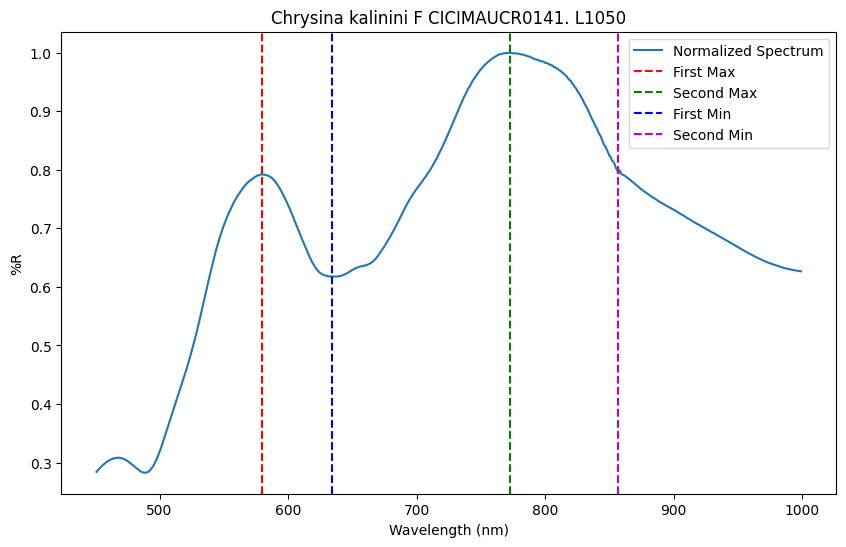

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.236114
202       452.0  0.240141
203       453.0  0.244019
204       454.0  0.247833
205       455.0  0.251590
..          ...       ...
745       995.0  0.745043
746       996.0  0.745027
747       997.0  0.745072
748       998.0  0.745450
749       999.0  0.745449

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   5.702700
1          251.0   5.706900
2          252.0   5.700400
3          253.0   5.654850
4          254.0   5.641550
...          ...        ...
1745      1995.0  26.643802
1746      1996.0  26.747612
1747      1997.0  26.857658
1748      1998.0  26.933957
1749      1999.0  26.996144

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [116 314 419 522] [567. 765. 870. 973.] [68.32725  92.041525 72.116726 68.648007]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=70.30927499999999, 
 

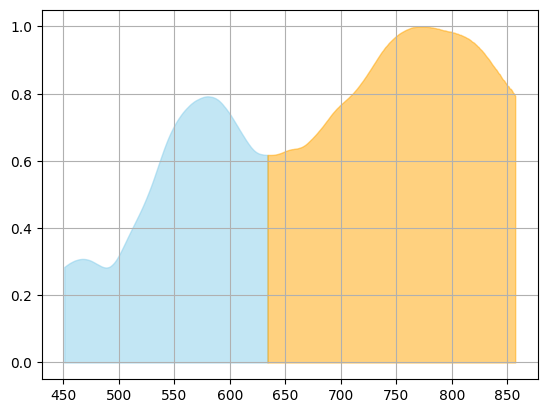

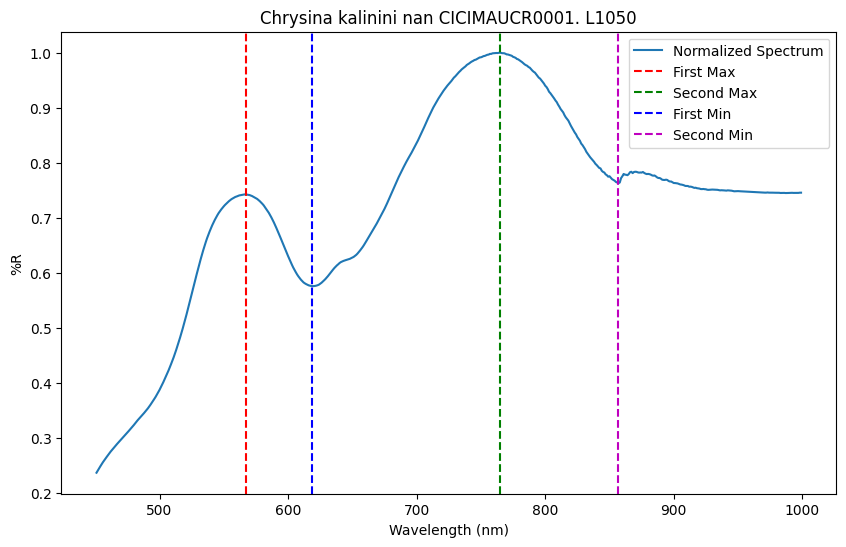

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.271377
202       452.0  0.273909
203       453.0  0.276355
204       454.0  0.278475
205       455.0  0.280605
..          ...       ...
745       995.0  0.598676
746       996.0  0.598629
747       997.0  0.598504
748       998.0  0.598511
749       999.0  0.598651

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.259033
1          251.0   6.240933
2          252.0   6.239333
3          253.0   6.206267
4          254.0   6.186733
...          ...        ...
1745      1995.0  14.655396
1746      1996.0  14.684346
1747      1997.0  14.717271
1748      1998.0  14.721940
1749      1999.0  14.748202

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [136 318 432 544] [587. 769. 883. 995.] [75.351167 97.681733 71.968049 58.479705]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=71.173166, 
         

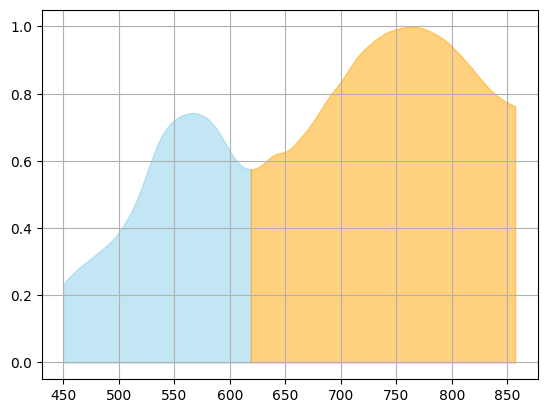

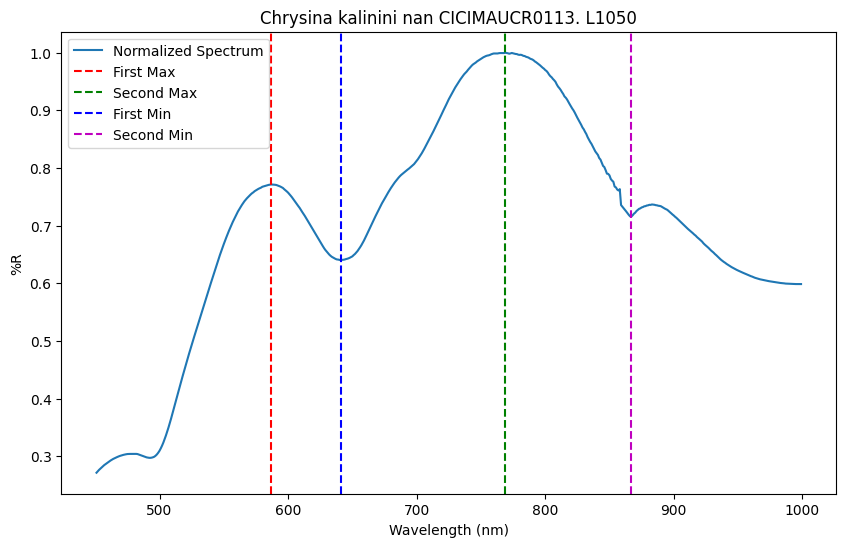

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.270238
202       452.0  0.271730
203       453.0  0.273022
204       454.0  0.274175
205       455.0  0.275005
..          ...       ...
745       995.0  0.620965
746       996.0  0.620320
747       997.0  0.619884
748       998.0  0.619229
749       999.0  0.618357

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.822967
1          251.0   6.775467
2          252.0   6.775167
3          253.0   6.801867
4          254.0   6.749833
...          ...        ...
1745      1995.0  12.911374
1746      1996.0  12.928366
1747      1997.0  12.949518
1748      1998.0  12.973254
1749      1999.0  12.961911

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [134 290 399] [585. 741. 850.] [92.031667 88.234667 74.780867]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=67.1612, 
                  bottom_thr=0

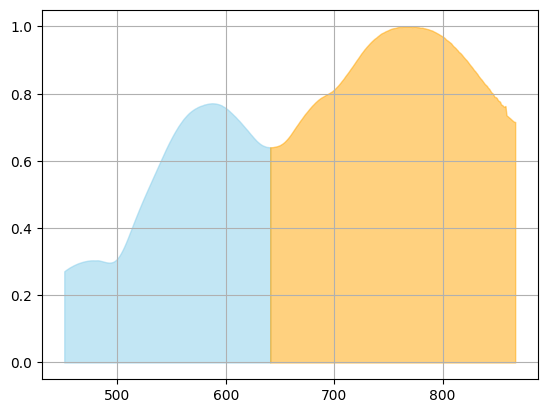

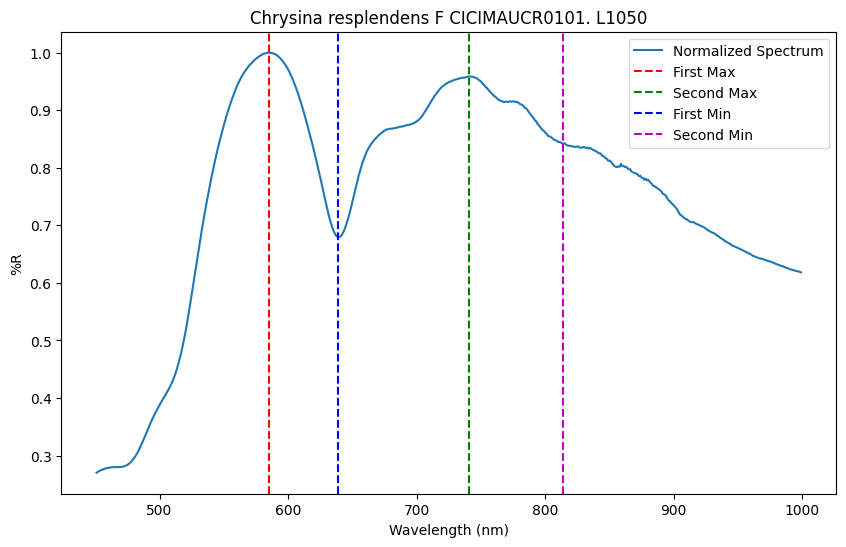

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.255107
202       452.0  0.259471
203       453.0  0.263991
204       454.0  0.268285
205       455.0  0.272403
..          ...       ...
745       995.0  0.997543
746       996.0  0.998148
747       997.0  0.998755
748       998.0  0.999492
749       999.0  1.000000

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.008450
1          251.0   5.972775
2          252.0   5.954625
3          253.0   5.952850
4          254.0   5.908875
...          ...        ...
1745      1995.0  29.522203
1746      1996.0  29.621899
1747      1997.0  29.713628
1748      1998.0  29.778892
1749      1999.0  29.870986

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [115 374 497] [566. 825. 948.] [64.537975 68.0696   67.139431]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=50.734972, 
                  bottom_thr

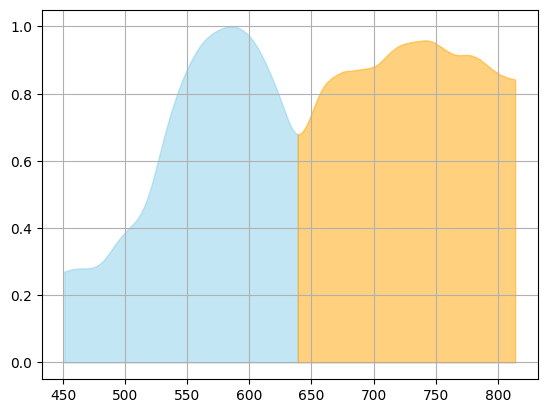

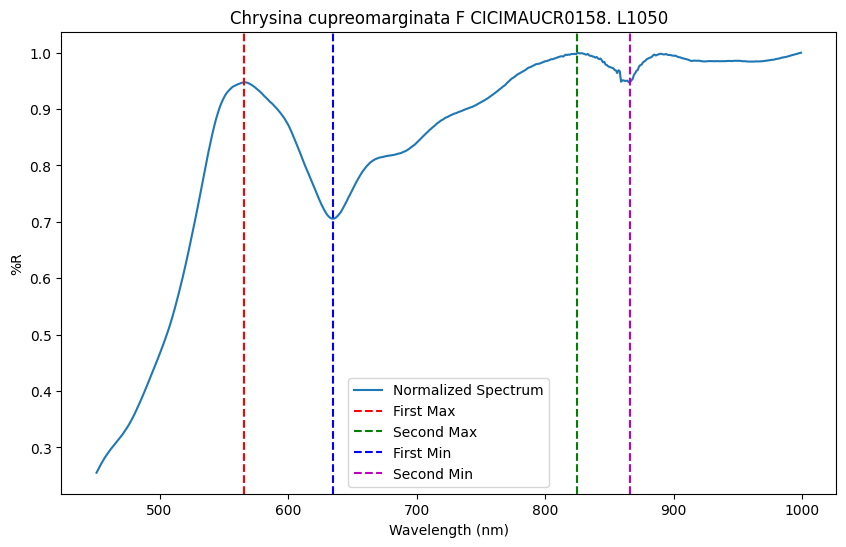

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.248185
202       452.0  0.249468
203       453.0  0.250788
204       454.0  0.252318
205       455.0  0.253867
..          ...       ...
745       995.0  0.974123
746       996.0  0.973917
747       997.0  0.973641
748       998.0  0.973452
749       999.0  0.973248

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   5.191600
1          251.0   5.191933
2          252.0   5.193233
3          253.0   5.187600
4          254.0   5.191667
...          ...        ...
1745      1995.0  21.857982
1746      1996.0  21.912365
1747      1997.0  21.975321
1748      1998.0  22.028556
1749      1999.0  22.073970

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [119 220 436] [570. 671. 887.] [61.9378   50.755933 65.735888]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=49.421255, 
                  bottom_thr

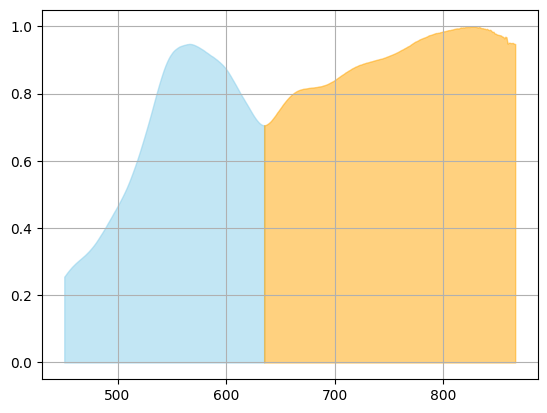

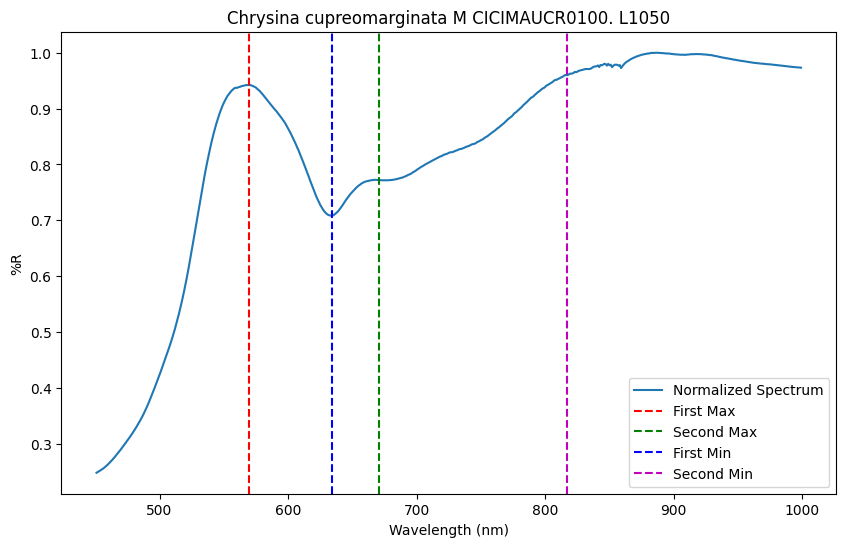

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.144195
202       452.0  0.147730
203       453.0  0.151315
204       454.0  0.154857
205       455.0  0.158380
..          ...       ...
745       995.0  0.949347
746       996.0  0.949369
747       997.0  0.949441
748       998.0  0.949492
749       999.0  0.949637

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.293233
1          251.0   6.296733
2          252.0   6.277967
3          253.0   6.295500
4          254.0   6.254967
...          ...        ...
1745      1995.0  39.886466
1746      1996.0  39.997934
1747      1997.0  40.090784
1748      1998.0  40.189198
1749      1999.0  40.271696

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [133 449] [584. 900.] [65.870167 91.62302 ]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=78.41141999999999, 
                  bottom_thr=0.0, top_t

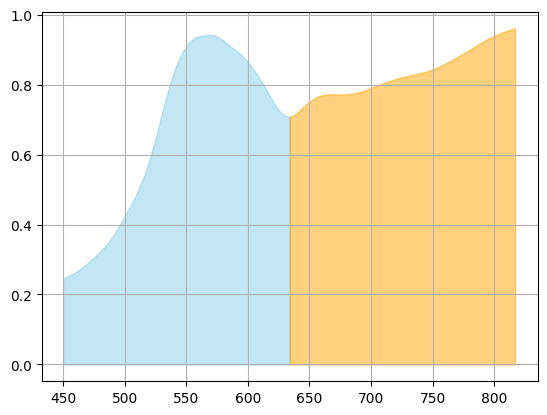

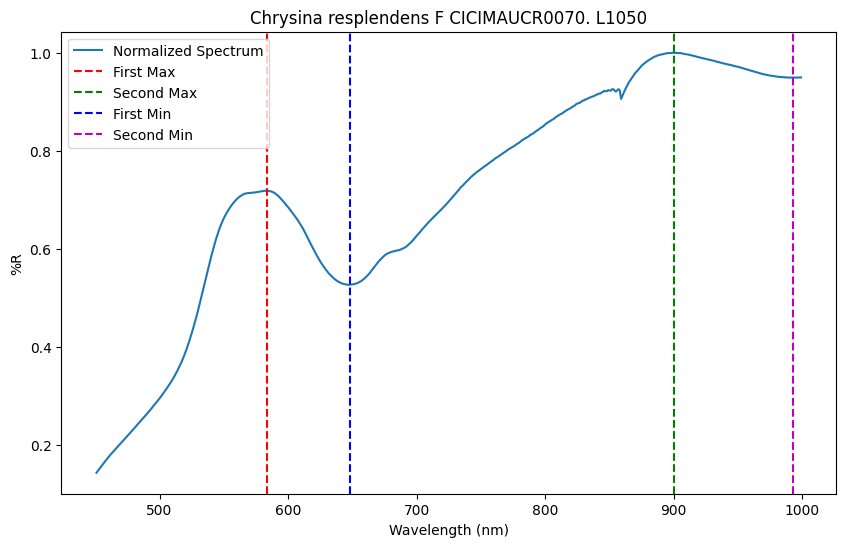

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.303192
202       452.0  0.305645
203       453.0  0.308070
204       454.0  0.310266
205       455.0  0.312147
..          ...       ...
745       995.0  0.672518
746       996.0  0.672118
747       997.0  0.671676
748       998.0  0.671264
749       999.0  0.670936

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   5.869533
1          251.0   5.887500
2          252.0   5.873467
3          253.0   5.862267
4          254.0   5.839167
...          ...        ...
1745      1995.0  21.380497
1746      1996.0  21.433174
1747      1997.0  21.484960
1748      1998.0  21.528167
1749      1999.0  21.580069

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [131 239 369] [582. 690. 820.] [87.7686   67.6363   82.497833]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=61.15786700000001, 
                  bo

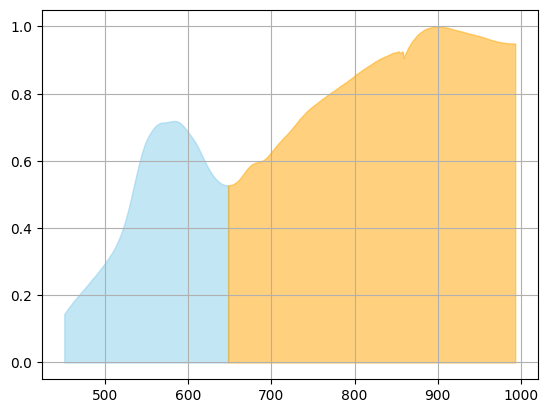

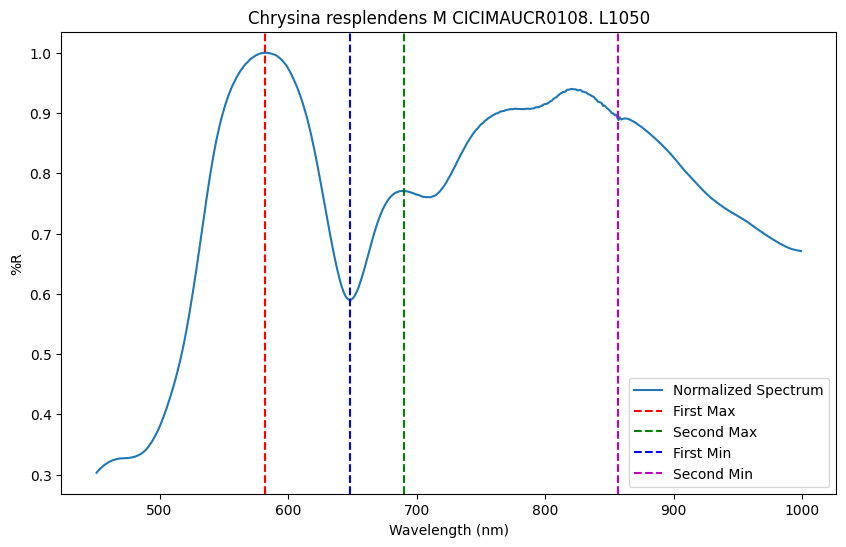

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.262282
202       452.0  0.262907
203       453.0  0.263421
204       454.0  0.264008
205       455.0  0.264688
..          ...       ...
745       995.0  0.668284
746       996.0  0.668207
747       997.0  0.668288
748       998.0  0.668279
749       999.0  0.668341

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.194200
1          251.0   6.197733
2          252.0   6.177767
3          253.0   6.188833
4          254.0   6.157033
...          ...        ...
1745      1995.0  22.713185
1746      1996.0  22.758276
1747      1997.0  22.786411
1748      1998.0  22.830100
1749      1999.0  22.854833

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [131 325 432 546] [582. 776. 883. 997.] [79.316367 96.655833 71.136403 64.59397 ]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=71.3047, 
           

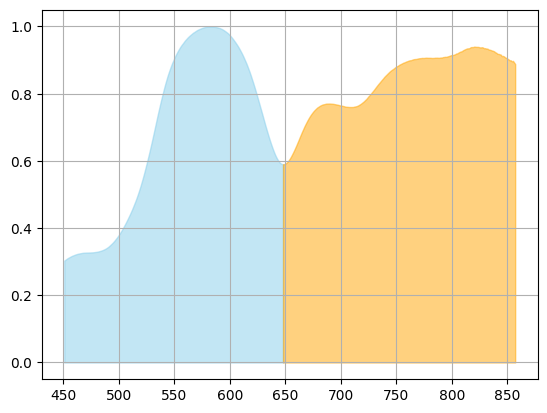

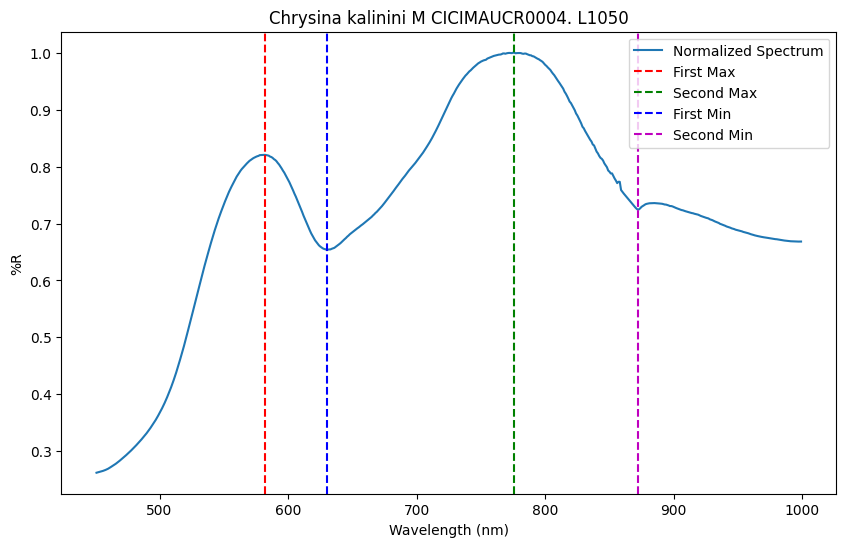

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.257340
202       452.0  0.260039
203       453.0  0.262594
204       454.0  0.264921
205       455.0  0.267197
..          ...       ...
745       995.0  0.666757
746       996.0  0.664854
747       997.0  0.663077
748       998.0  0.661286
749       999.0  0.659467

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   5.846467
1          251.0   5.821533
2          252.0   5.819633
3          253.0   5.814900
4          254.0   5.776500
...          ...        ...
1745      1995.0  25.560632
1746      1996.0  25.613848
1747      1997.0  25.674020
1748      1998.0  25.727900
1749      1999.0  25.779044

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [145 352] [596. 803.] [68.202033 90.0212  ]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=66.855167, 
                  bottom_thr=0.0, top_thr=66.85

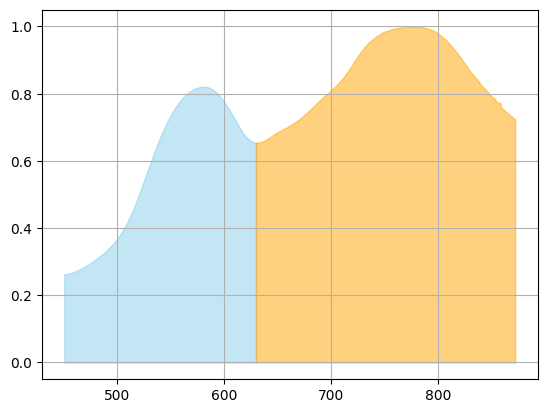

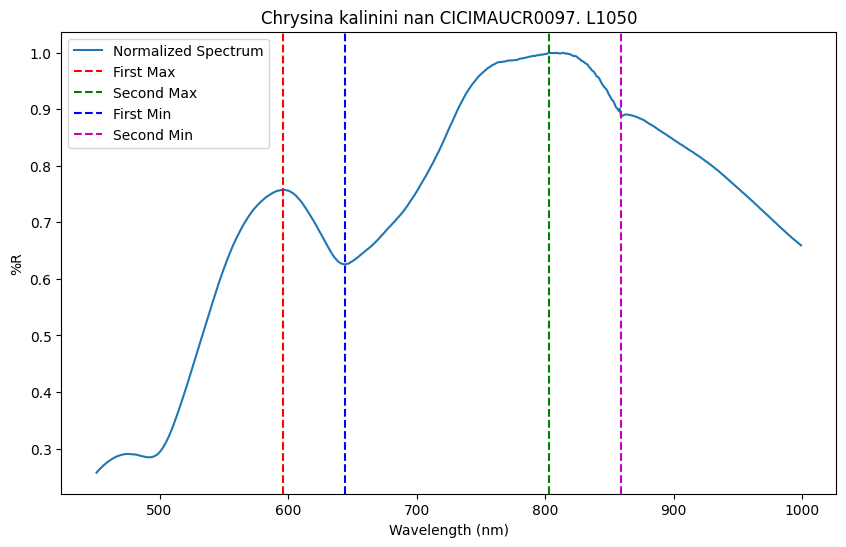

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
192       451.0  0.294595
193       452.0  0.296199
194       453.0  0.299093
195       454.0  0.301954
196       455.0  0.304765
..          ...       ...
736       995.0  0.886400
737       996.0  0.886241
738       997.0  0.886059
739       998.0  0.885927
740       999.0  0.885777

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          259.0   3.762066
1          260.0   3.759897
2          261.0   3.755702
3          262.0   3.752036
4          263.0   3.749770
...          ...        ...
1736      1995.0  10.968492
1737      1996.0  10.979798
1738      1997.0  11.014905
1739      1998.0  11.050137
1740      1999.0  11.059130

[1741 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [128 307 416] [579. 758. 867.] [18.157826 18.901424 22.058561]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=15.560224000000002, 
                  b

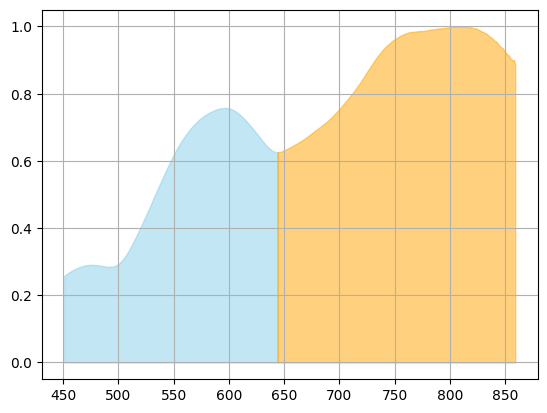

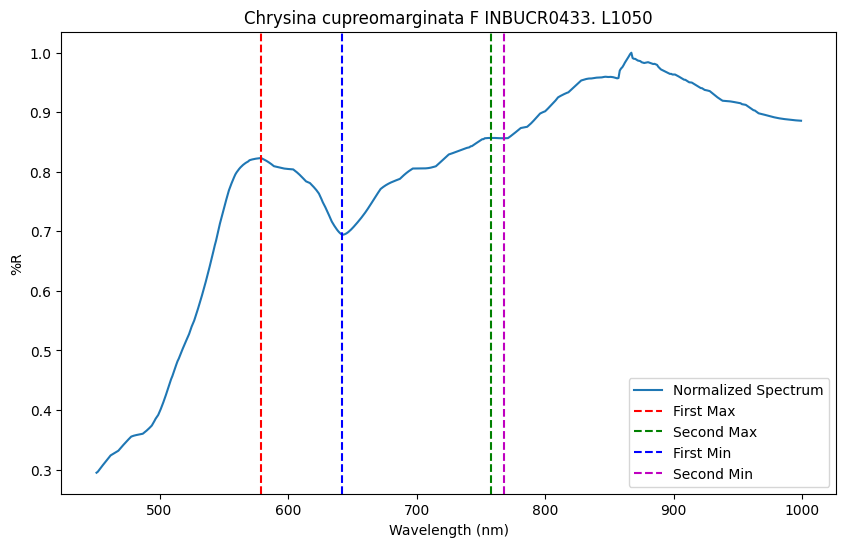

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.245954
202       452.0  0.246864
203       453.0  0.247939
204       454.0  0.248846
205       455.0  0.249678
..          ...       ...
745       995.0  0.743330
746       996.0  0.743598
747       997.0  0.743757
748       998.0  0.743964
749       999.0  0.744083

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   3.783033
1          251.0   3.775633
2          252.0   3.797833
3          253.0   3.752567
4          254.0   3.771033
...          ...        ...
1745      1995.0  14.908235
1746      1996.0  14.936671
1747      1997.0  14.975531
1748      1998.0  15.019068
1749      1999.0  15.052768

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [101 321 467] [552. 772. 918.] [38.339233 61.2709   45.859368]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=46.201066999999995, 
                  b

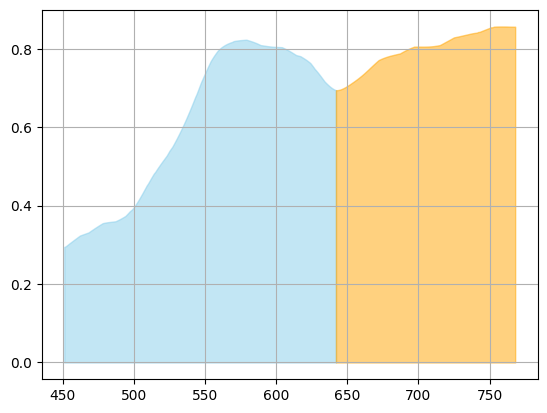

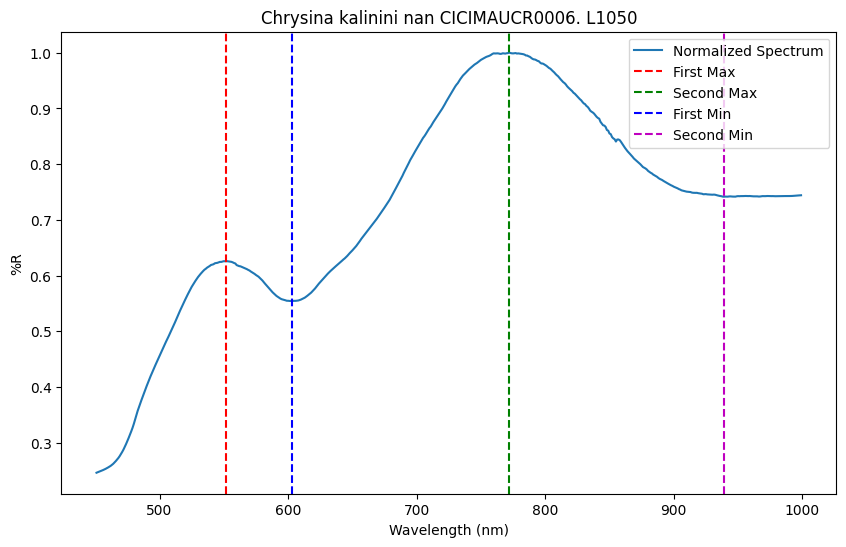

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.257333
202       452.0  0.259025
203       453.0  0.260838
204       454.0  0.262592
205       455.0  0.264601
..          ...       ...
745       995.0  0.996044
746       996.0  0.996987
747       997.0  0.998028
748       998.0  0.998680
749       999.0  1.000000

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   4.707333
1          251.0   4.727667
2          252.0   4.693633
3          253.0   4.685000
4          254.0   4.715367
...          ...        ...
1745      1995.0  13.829563
1746      1996.0  13.893894
1747      1997.0  13.916141
1748      1998.0  13.920316
1749      1999.0  13.955846

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [ 95 353 512] [546. 804. 963.] [46.767033 49.726467 49.015611]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=37.615502, 
                  bottom_thr

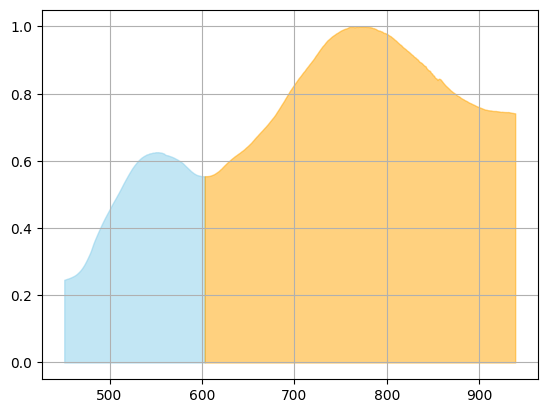

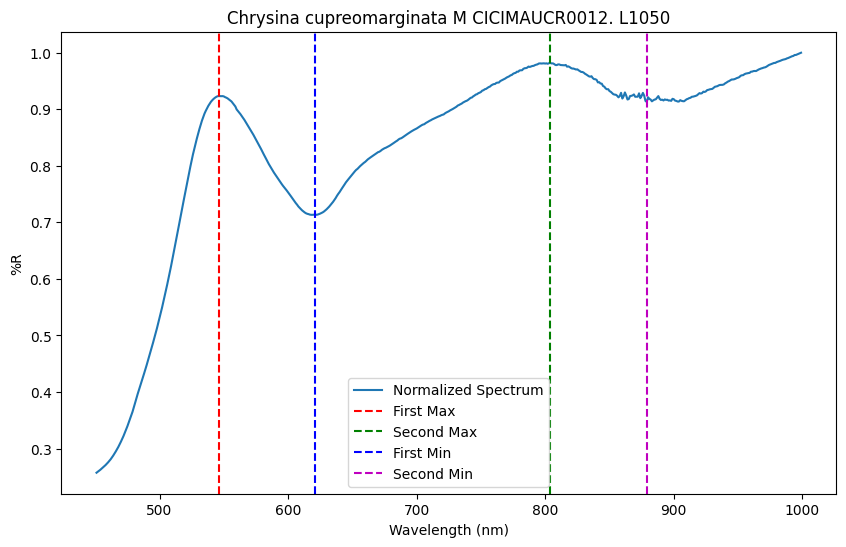

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.226461
202       452.0  0.225857
203       453.0  0.225260
204       454.0  0.224872
205       455.0  0.224605
..          ...       ...
745       995.0  0.892387
746       996.0  0.891848
747       997.0  0.891238
748       998.0  0.890729
749       999.0  0.890379

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.522400
1          251.0   6.509100
2          252.0   6.472900
3          253.0   6.470850
4          254.0   6.405500
...          ...        ...
1745      1995.0  15.842243
1746      1996.0  15.878753
1747      1997.0  15.918560
1748      1998.0  15.960838
1749      1999.0  15.995246

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [118 221 443] [569. 672. 894.] [70.669425 54.838825 71.421432]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=55.395157, 
                  bottom_thr

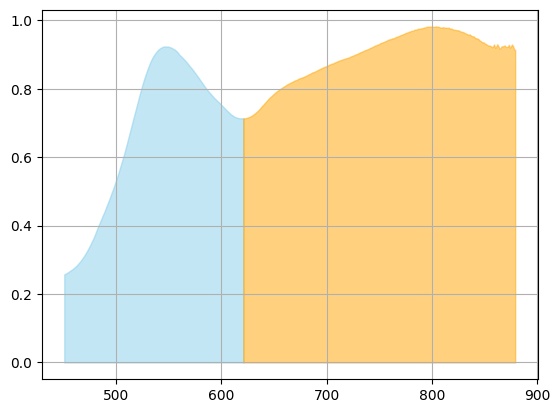

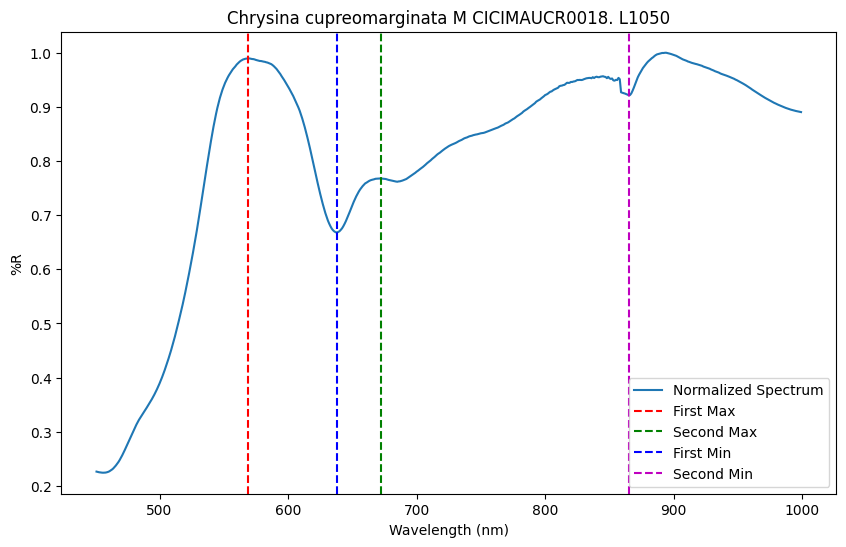

Gamma_Area_Under_Curve_First_Min_Cut min 450.0 max 1000.0
normalized:      wavelength        %R
201       451.0  0.275482
202       452.0  0.278677
203       453.0  0.281548
204       454.0  0.284380
205       455.0  0.287160
..          ...       ...
745       995.0  0.642810
746       996.0  0.642426
747       997.0  0.642305
748       998.0  0.641784
749       999.0  0.641297

[549 rows x 2 columns]
get_maxima
df peaklist get max       wavelength         %R
0          250.0   6.077967
1          251.0   6.042900
2          252.0   6.015433
3          253.0   6.005967
4          254.0   6.013433
...          ...        ...
1745      1995.0  22.518141
1746      1996.0  22.600915
1747      1997.0  22.618767
1748      1998.0  22.663347
1749      1999.0  22.726412

[1750 rows x 2 columns]
min 450.0 max 1000.0
max_i, max_xs, _  [130 339] [581. 790.] [69.402067 97.7267  ]
get_minima
min wav 450.0 max_wav 1000.0
get_minima: max_val=70.804767, 
                  bottom_thr=0.0, top_thr=70.80

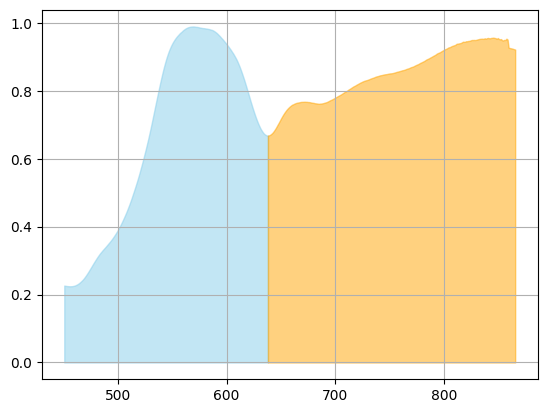

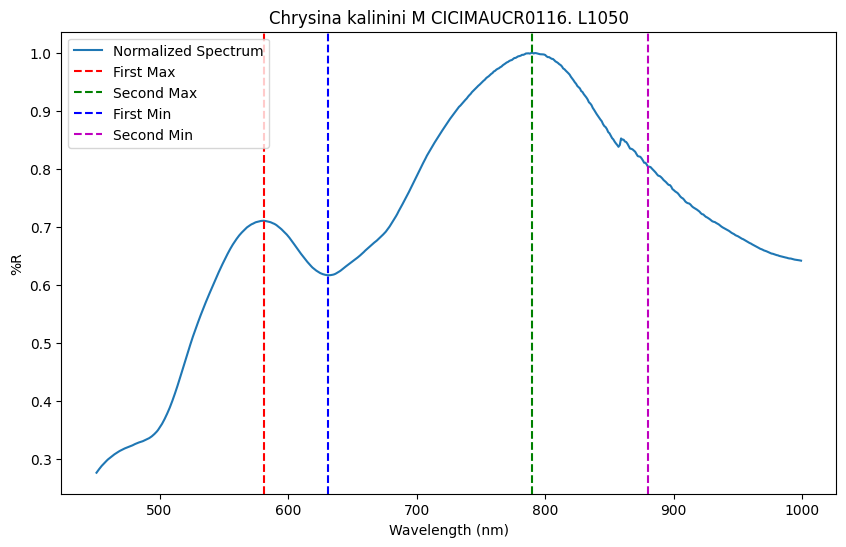

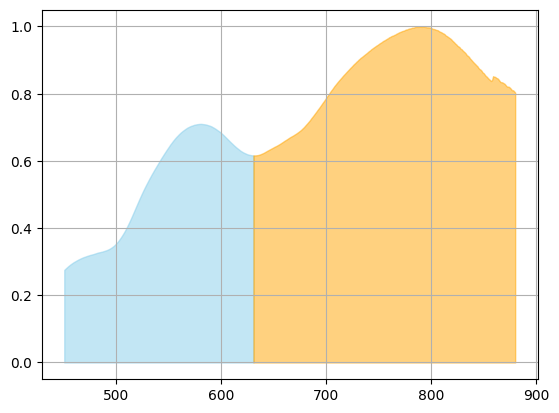

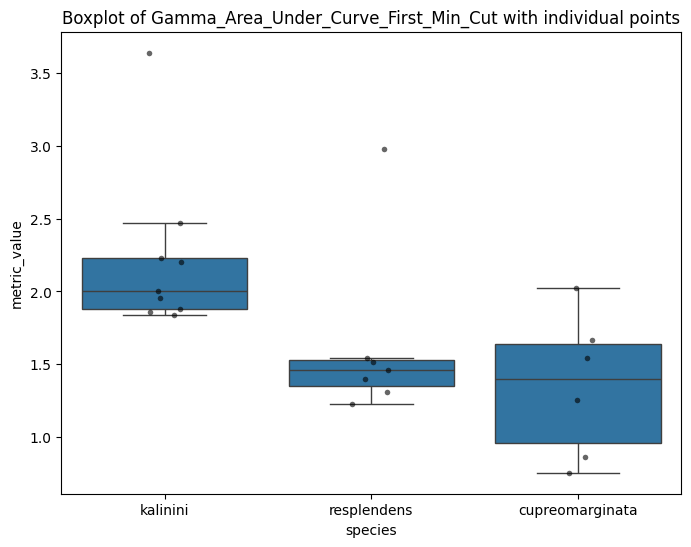

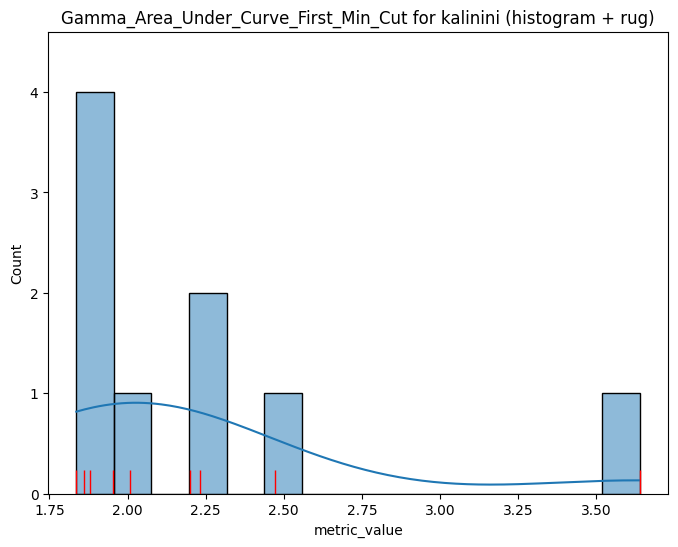

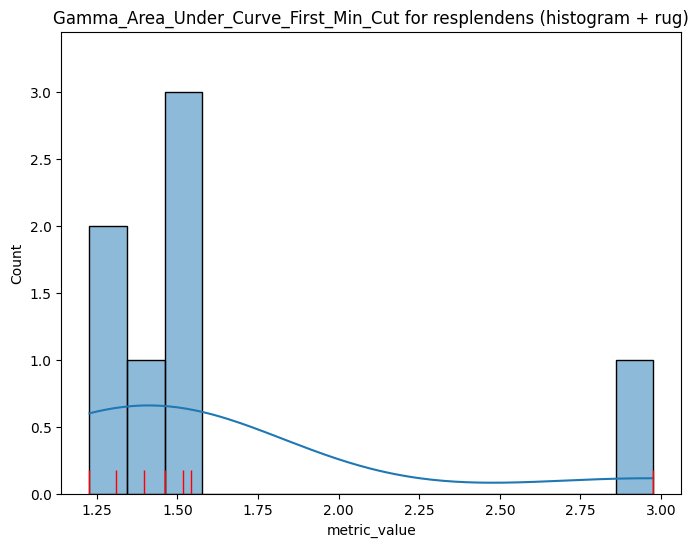

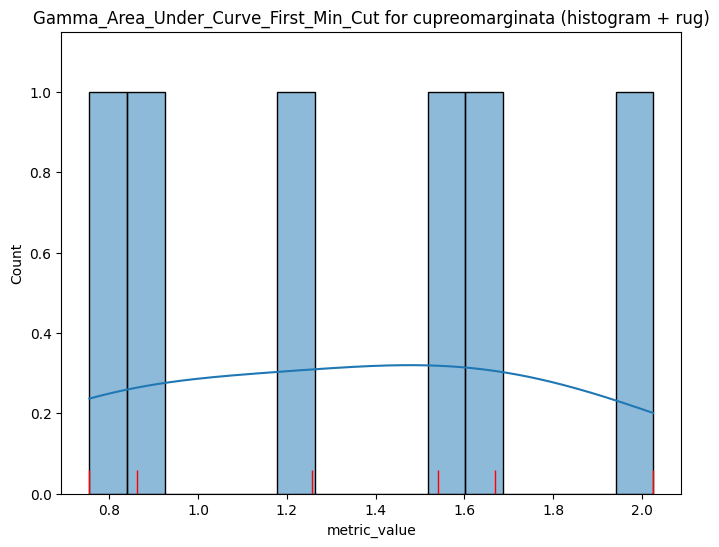

,mean,std,median,min,max,count,iqr,cv
species,,,,,,,,
cupreomarginata,1.3515,0.4886,1.3992,0.7551,2.0251,6,0.6753,0.3616
kalinini,2.2309,0.5687,2.0067,1.8361,3.6399,9,0.3520,0.2549
resplendens,1.6328,0.6026,1.4619,1.2272,2.9754,7,0.1771,0.3690


In [24]:
get_aggregated_data(Gamma_Area_Under_Curve_First_Min_Cut,
                    config_file = metric_configuration_file, 
                    spectra =  train_spectra, 
                    collection_list = training_collection_list,
                    plot = True)

df peaklist get max       wavelength         %R
0          250.0   6.059033
1          251.0   6.052233
2          252.0   6.033967
3          253.0   6.025833
4          254.0   5.993167
...          ...        ...
1745      1995.0  11.156570
1746      1996.0  11.178961
1747      1997.0  11.205560
1748      1998.0  11.239035
1749      1999.0  11.260341

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


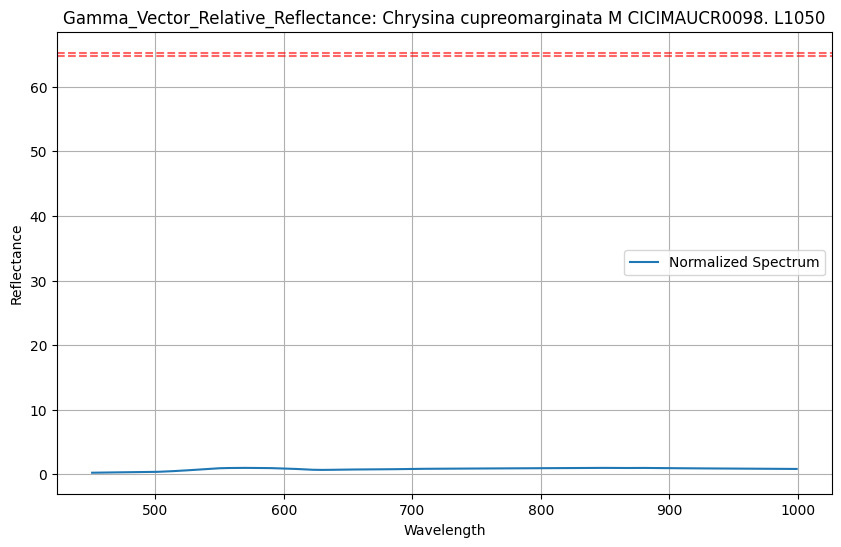

df peaklist get max       wavelength         %R
0          250.0   6.627333
1          251.0   6.592200
2          252.0   6.599233
3          253.0   6.566000
4          254.0   6.547600
...          ...        ...
1745      1995.0  19.848957
1746      1996.0  19.924566
1747      1997.0  19.976946
1748      1998.0  20.043284
1749      1999.0  20.093886

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


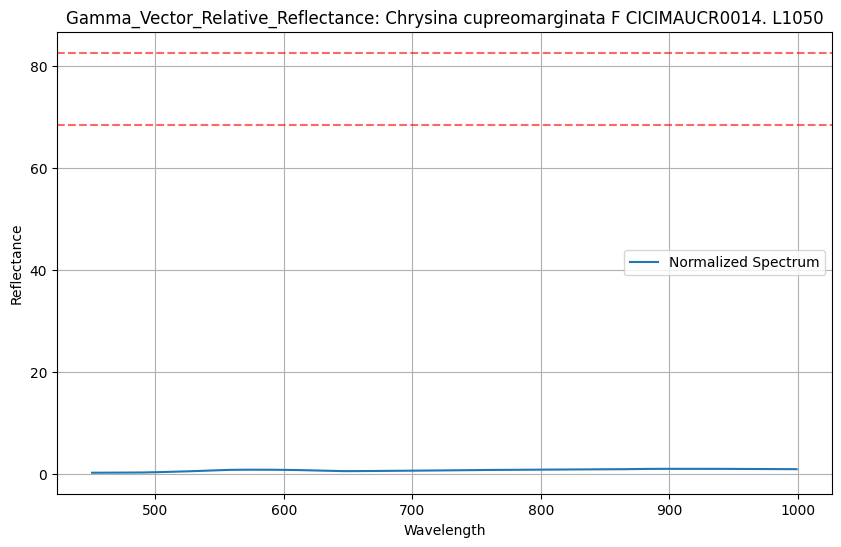

df peaklist get max       wavelength         %R
0          284.0   6.686712
1          285.0   6.674540
2          286.0   6.661835
3          287.0   6.651822
4          288.0   6.641055
...          ...        ...
1711      1995.0  14.717545
1712      1996.0  14.771121
1713      1997.0  14.844056
1714      1998.0  14.915941
1715      1999.0  14.952284

[1716 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


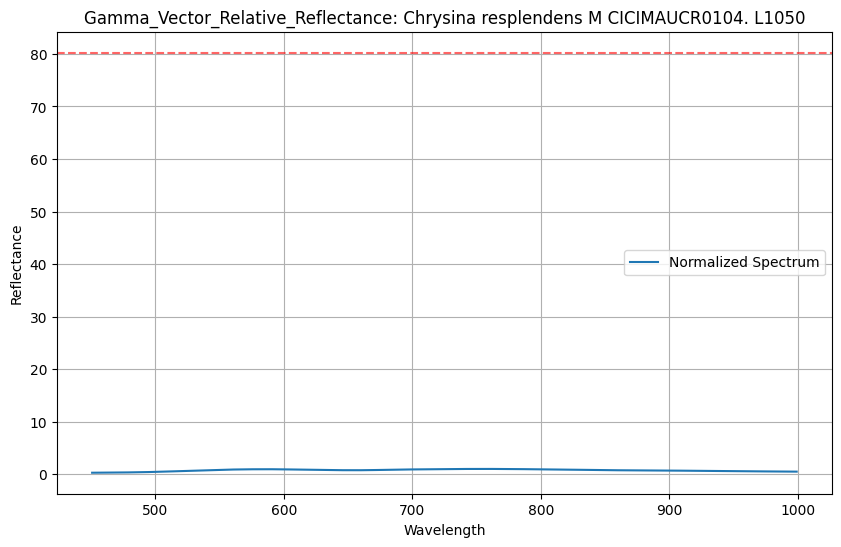

df peaklist get max       wavelength         %R
0          250.0   6.387750
1          251.0   6.331750
2          252.0   6.312100
3          253.0   6.257850
4          254.0   6.327550
...          ...        ...
1745      1995.0  18.687320
1746      1996.0  18.731023
1747      1997.0  18.770373
1748      1998.0  18.795870
1749      1999.0  18.845905

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


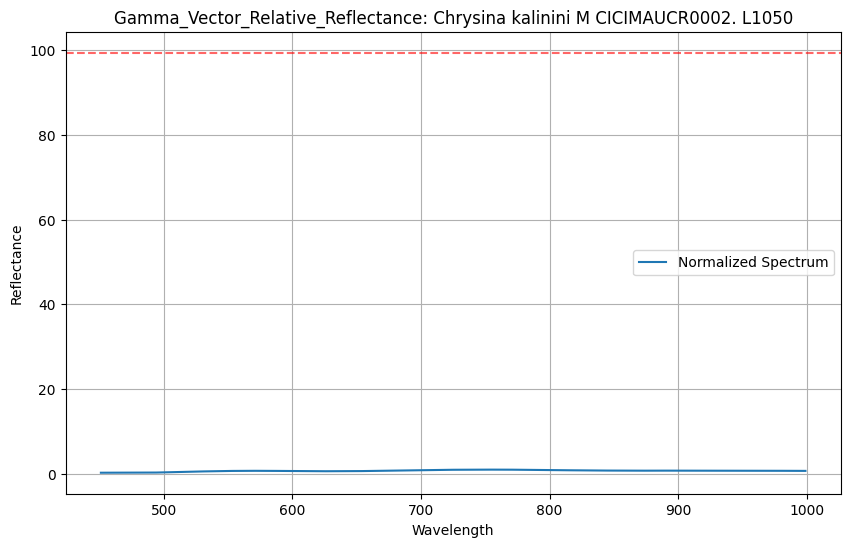

df peaklist get max       wavelength         %R
0          250.0   5.691060
1          251.0   5.661860
2          252.0   5.673480
3          253.0   5.679480
4          254.0   5.647980
...          ...        ...
1745      1995.0  18.102704
1746      1996.0  18.168534
1747      1997.0  18.218921
1748      1998.0  18.262135
1749      1999.0  18.307018

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


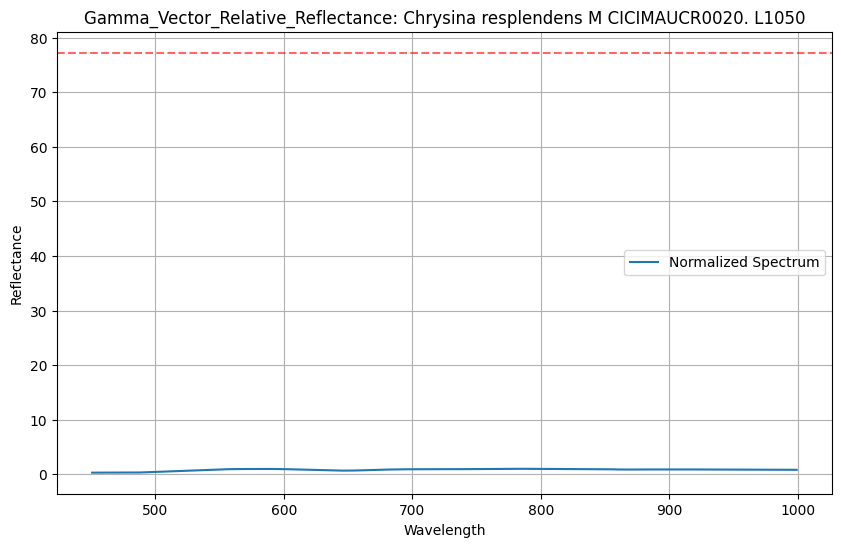

df peaklist get max       wavelength         %R
0          250.0   6.264300
1          251.0   6.269200
2          252.0   6.246400
3          253.0   6.215900
4          254.0   6.196933
...          ...        ...
1745      1995.0  21.554323
1746      1996.0  21.613598
1747      1997.0  21.652972
1748      1998.0  21.694313
1749      1999.0  21.724248

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


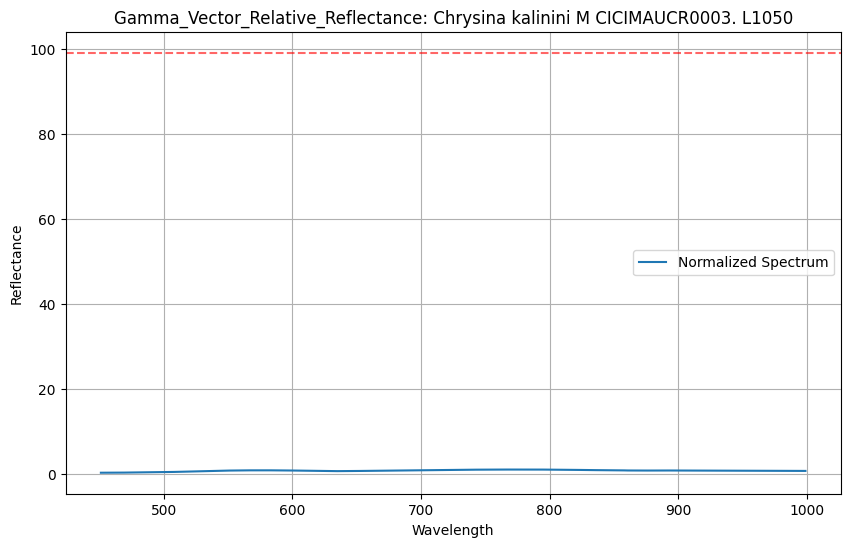

df peaklist get max       wavelength         %R
0          250.0   6.108967
1          251.0   6.101900
2          252.0   6.079567
3          253.0   6.068200
4          254.0   6.084167
...          ...        ...
1745      1995.0  21.369957
1746      1996.0  21.406533
1747      1997.0  21.467083
1748      1998.0  21.489857
1749      1999.0  21.513057

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


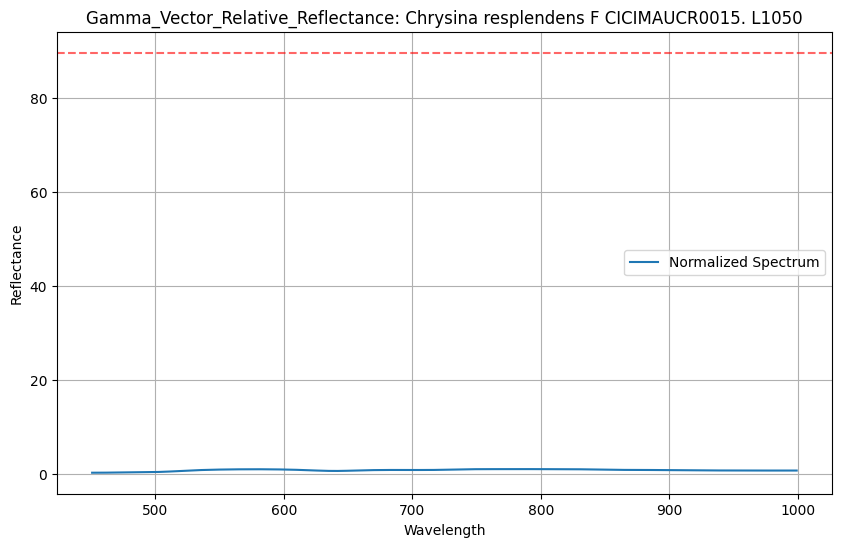

df peaklist get max       wavelength         %R
0          250.0   6.227900
1          251.0   6.212500
2          252.0   6.174433
3          253.0   6.191967
4          254.0   6.170433
...          ...        ...
1745      1995.0  19.510730
1746      1996.0  19.579398
1747      1997.0  19.636737
1748      1998.0  19.681657
1749      1999.0  19.693297

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


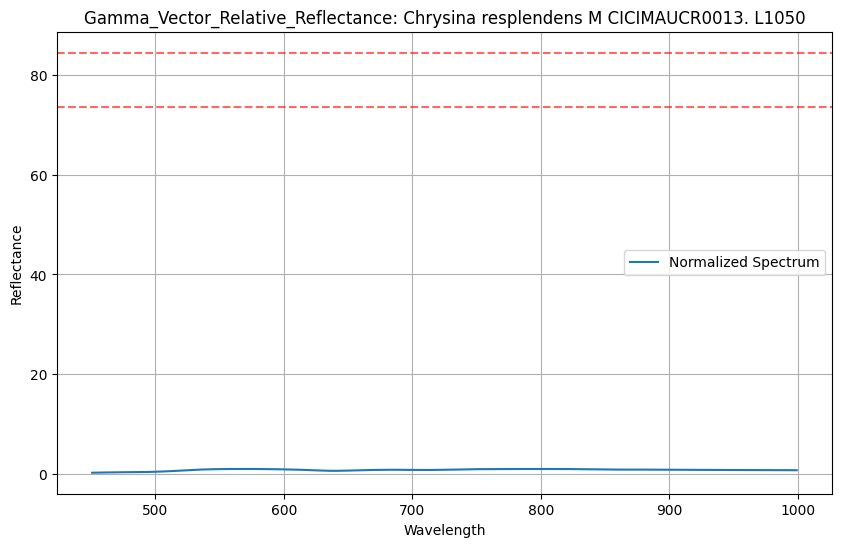

df peaklist get max       wavelength         %R
0          250.0   6.735933
1          251.0   6.753967
2          252.0   6.719933
3          253.0   6.718033
4          254.0   6.693367
...          ...        ...
1745      1995.0  25.450630
1746      1996.0  25.529126
1747      1997.0  25.583074
1748      1998.0  25.643778
1749      1999.0  25.706195

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


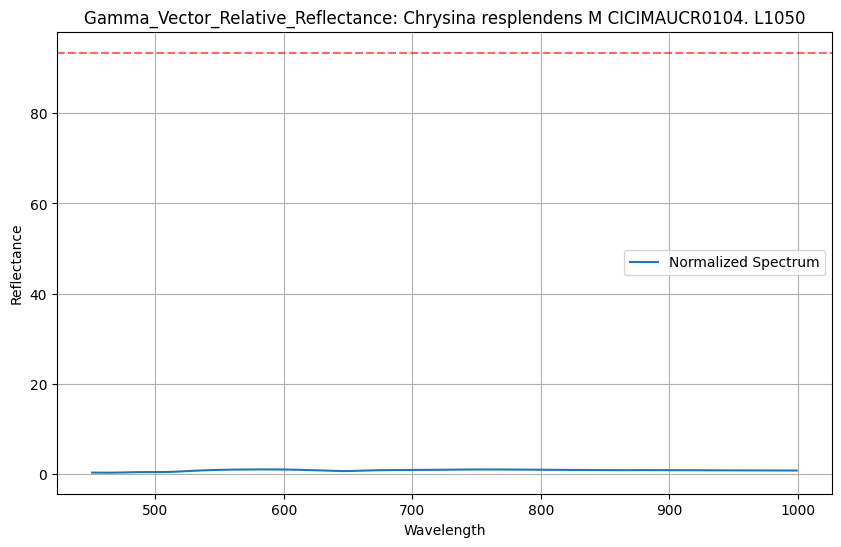

df peaklist get max       wavelength         %R
0          284.0   1.005921
1          285.0   1.130663
2          286.0   1.250340
3          287.0   1.369472
4          288.0   1.481847
...          ...        ...
1711      1995.0  18.162503
1712      1996.0  18.240729
1713      1997.0  18.277948
1714      1998.0  18.348353
1715      1999.0  18.375664

[1716 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


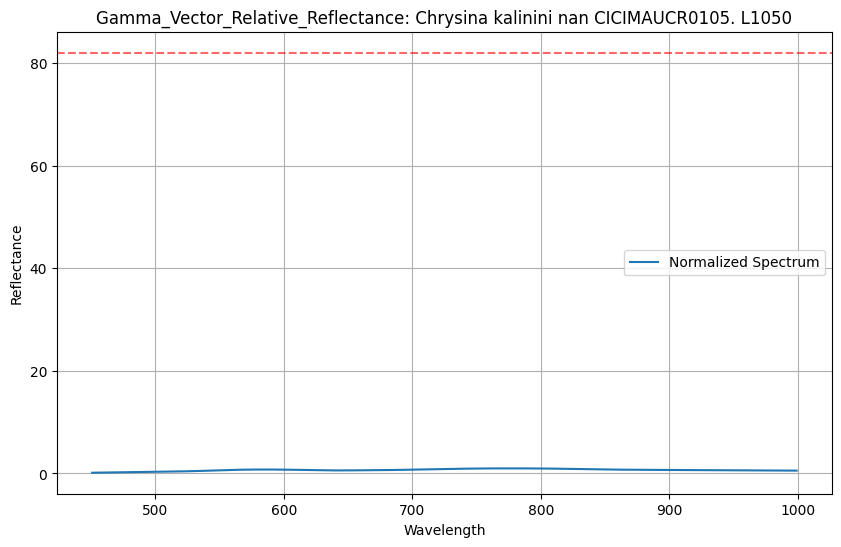

df peaklist get max       wavelength        %R
0          284.0  6.299151
1          285.0  6.281825
2          286.0  6.266644
3          287.0  6.251455
4          288.0  6.236319
...          ...       ...
1711      1995.0  9.722714
1712      1996.0  9.732779
1713      1997.0  9.714617
1714      1998.0  9.703111
1715      1999.0  9.703096

[1716 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


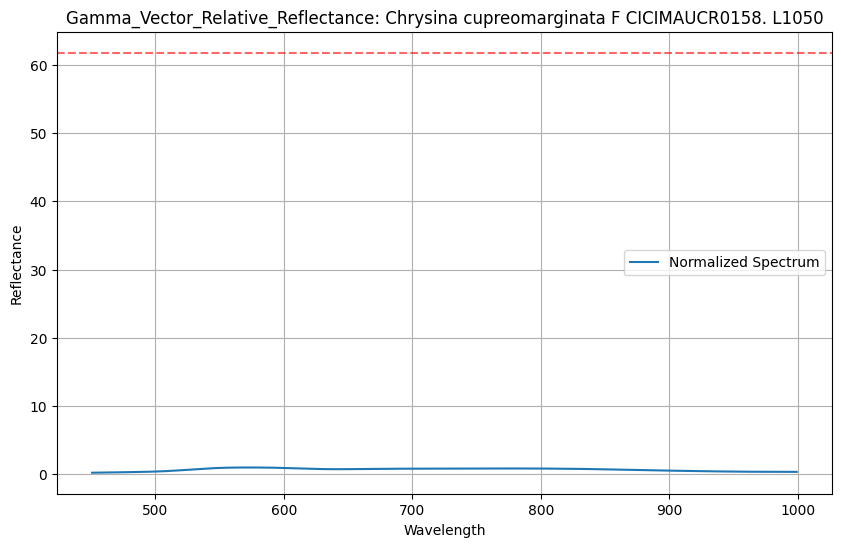

df peaklist get max       wavelength         %R
0          250.0   6.390333
1          251.0   6.389500
2          252.0   6.380300
3          253.0   6.354200
4          254.0   6.367300
...          ...        ...
1745      1995.0  21.051944
1746      1996.0  21.140525
1747      1997.0  21.215391
1748      1998.0  21.294900
1749      1999.0  21.366582

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


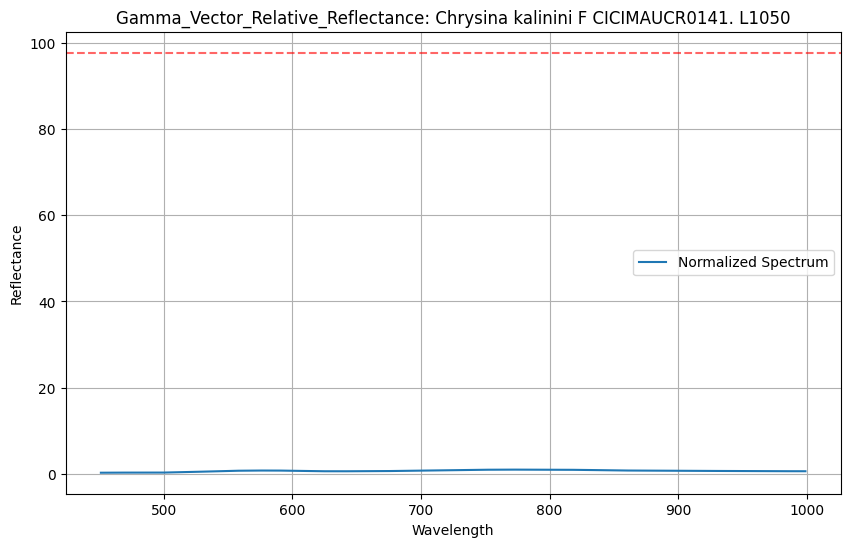

df peaklist get max       wavelength         %R
0          250.0   5.702700
1          251.0   5.706900
2          252.0   5.700400
3          253.0   5.654850
4          254.0   5.641550
...          ...        ...
1745      1995.0  26.643802
1746      1996.0  26.747612
1747      1997.0  26.857658
1748      1998.0  26.933957
1749      1999.0  26.996144

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


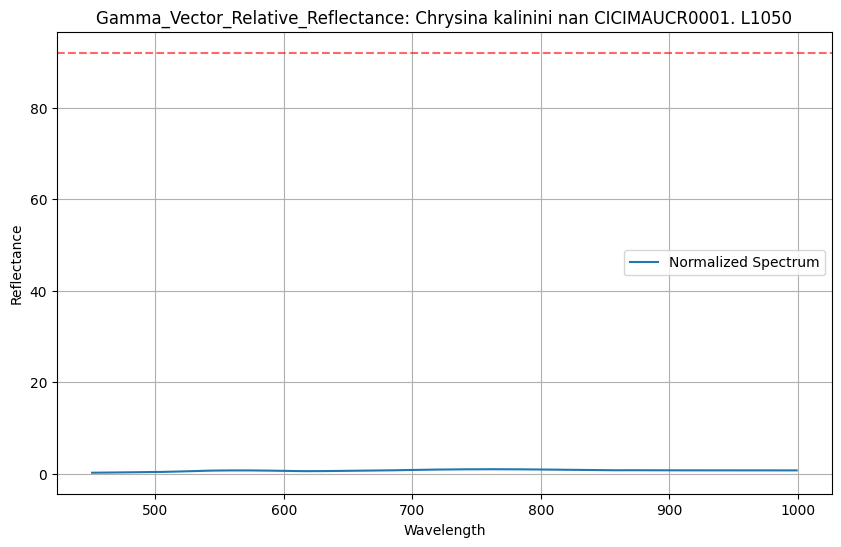

df peaklist get max       wavelength         %R
0          250.0   6.259033
1          251.0   6.240933
2          252.0   6.239333
3          253.0   6.206267
4          254.0   6.186733
...          ...        ...
1745      1995.0  14.655396
1746      1996.0  14.684346
1747      1997.0  14.717271
1748      1998.0  14.721940
1749      1999.0  14.748202

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


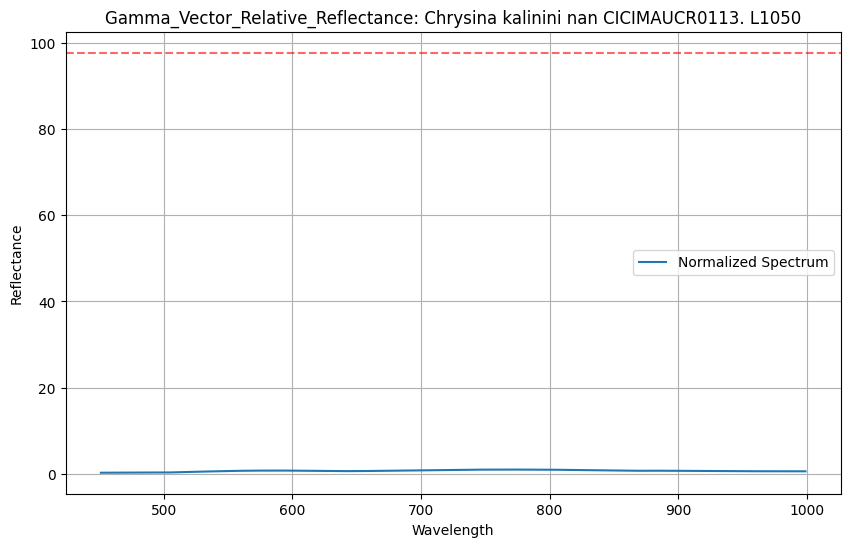

df peaklist get max       wavelength         %R
0          250.0   6.822967
1          251.0   6.775467
2          252.0   6.775167
3          253.0   6.801867
4          254.0   6.749833
...          ...        ...
1745      1995.0  12.911374
1746      1996.0  12.928366
1747      1997.0  12.949518
1748      1998.0  12.973254
1749      1999.0  12.961911

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


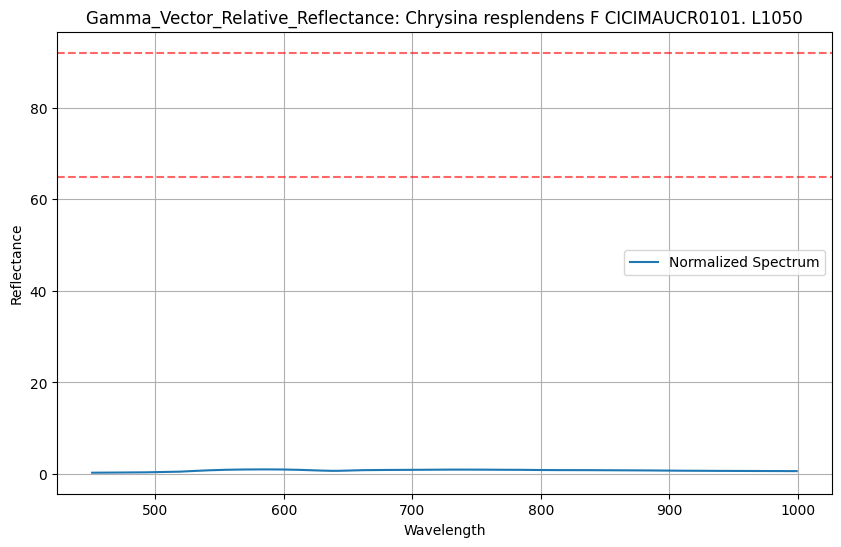

df peaklist get max       wavelength         %R
0          250.0   6.008450
1          251.0   5.972775
2          252.0   5.954625
3          253.0   5.952850
4          254.0   5.908875
...          ...        ...
1745      1995.0  29.522203
1746      1996.0  29.621899
1747      1997.0  29.713628
1748      1998.0  29.778892
1749      1999.0  29.870986

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


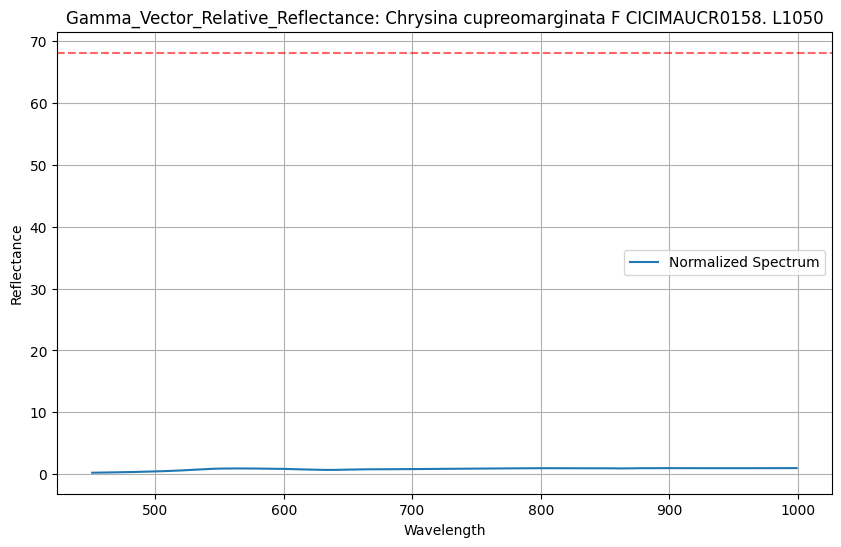

df peaklist get max       wavelength         %R
0          250.0   5.191600
1          251.0   5.191933
2          252.0   5.193233
3          253.0   5.187600
4          254.0   5.191667
...          ...        ...
1745      1995.0  21.857982
1746      1996.0  21.912365
1747      1997.0  21.975321
1748      1998.0  22.028556
1749      1999.0  22.073970

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


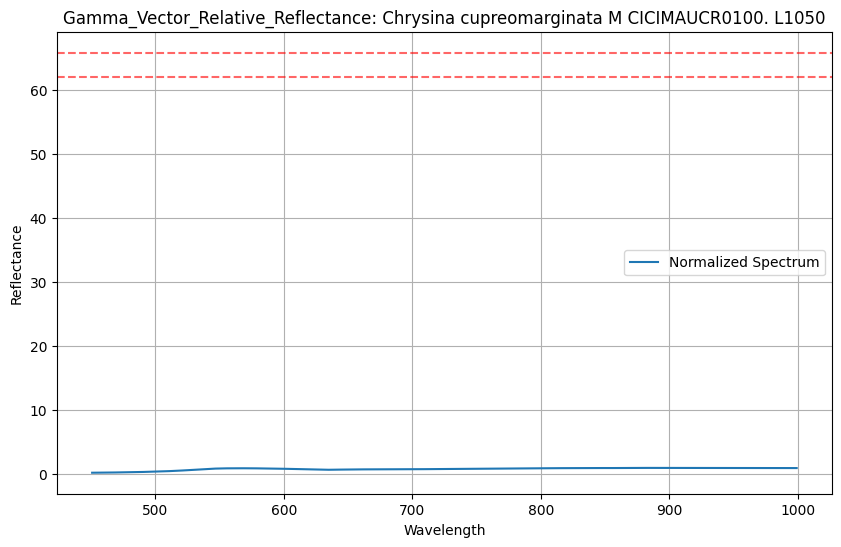

df peaklist get max       wavelength         %R
0          250.0   6.293233
1          251.0   6.296733
2          252.0   6.277967
3          253.0   6.295500
4          254.0   6.254967
...          ...        ...
1745      1995.0  39.886466
1746      1996.0  39.997934
1747      1997.0  40.090784
1748      1998.0  40.189198
1749      1999.0  40.271696

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


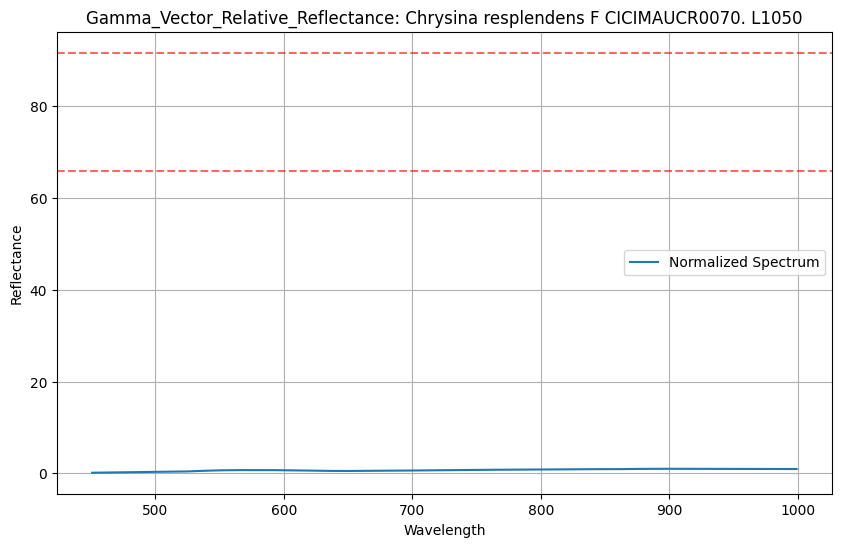

df peaklist get max       wavelength         %R
0          250.0   5.869533
1          251.0   5.887500
2          252.0   5.873467
3          253.0   5.862267
4          254.0   5.839167
...          ...        ...
1745      1995.0  21.380497
1746      1996.0  21.433174
1747      1997.0  21.484960
1748      1998.0  21.528167
1749      1999.0  21.580069

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


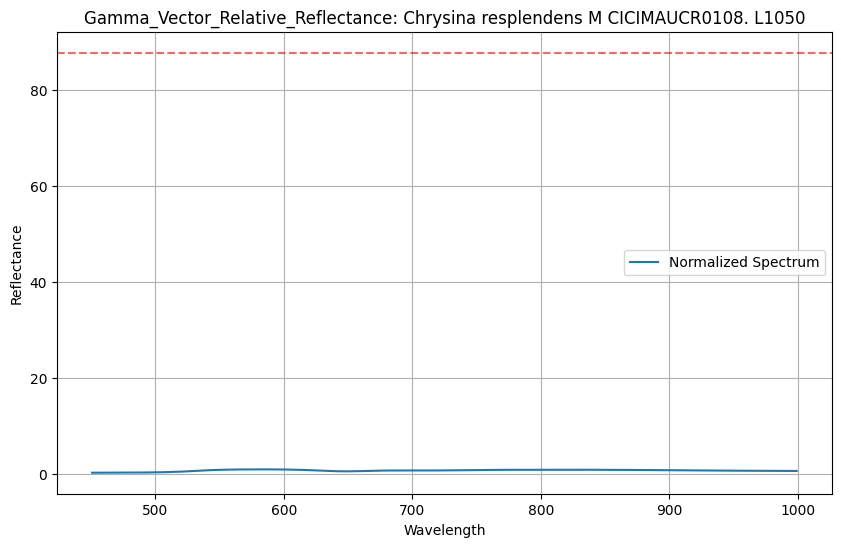

df peaklist get max       wavelength         %R
0          250.0   6.194200
1          251.0   6.197733
2          252.0   6.177767
3          253.0   6.188833
4          254.0   6.157033
...          ...        ...
1745      1995.0  22.713185
1746      1996.0  22.758276
1747      1997.0  22.786411
1748      1998.0  22.830100
1749      1999.0  22.854833

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


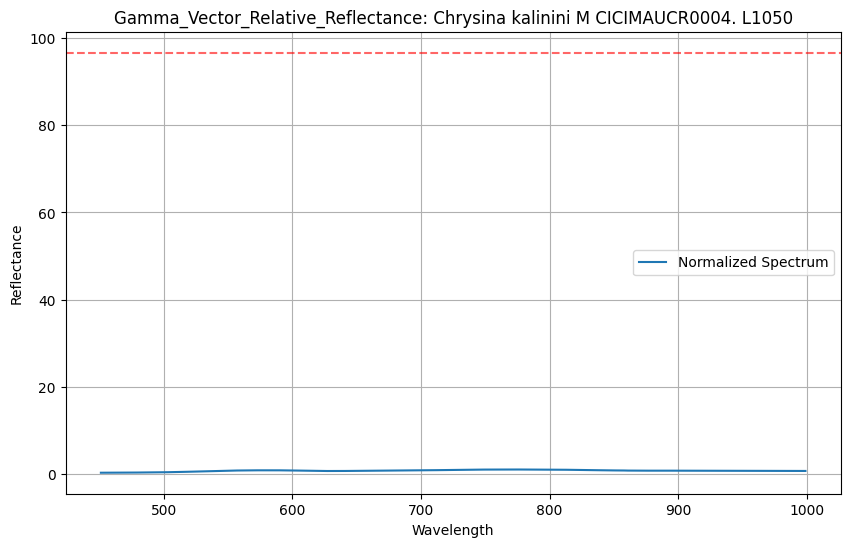

df peaklist get max       wavelength         %R
0          250.0   5.846467
1          251.0   5.821533
2          252.0   5.819633
3          253.0   5.814900
4          254.0   5.776500
...          ...        ...
1745      1995.0  25.560632
1746      1996.0  25.613848
1747      1997.0  25.674020
1748      1998.0  25.727900
1749      1999.0  25.779044

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


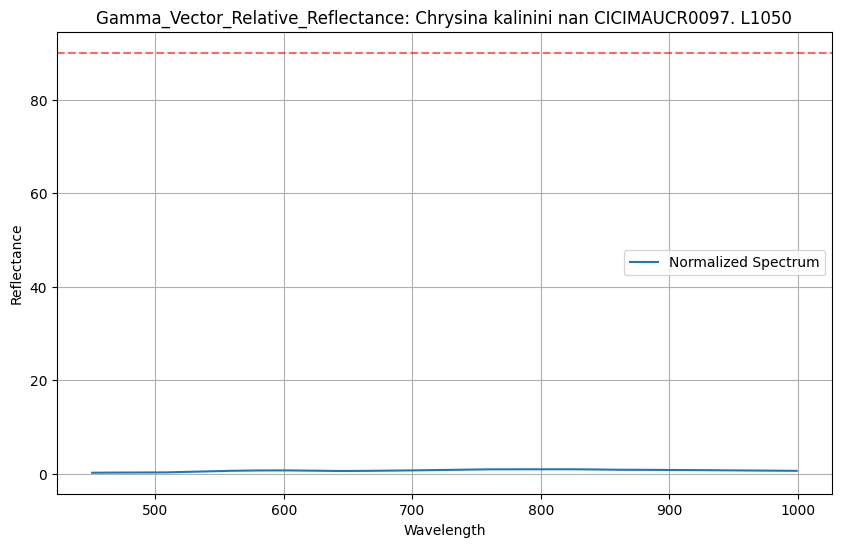

df peaklist get max       wavelength         %R
0          259.0   3.762066
1          260.0   3.759897
2          261.0   3.755702
3          262.0   3.752036
4          263.0   3.749770
...          ...        ...
1736      1995.0  10.968492
1737      1996.0  10.979798
1738      1997.0  11.014905
1739      1998.0  11.050137
1740      1999.0  11.059130

[1741 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


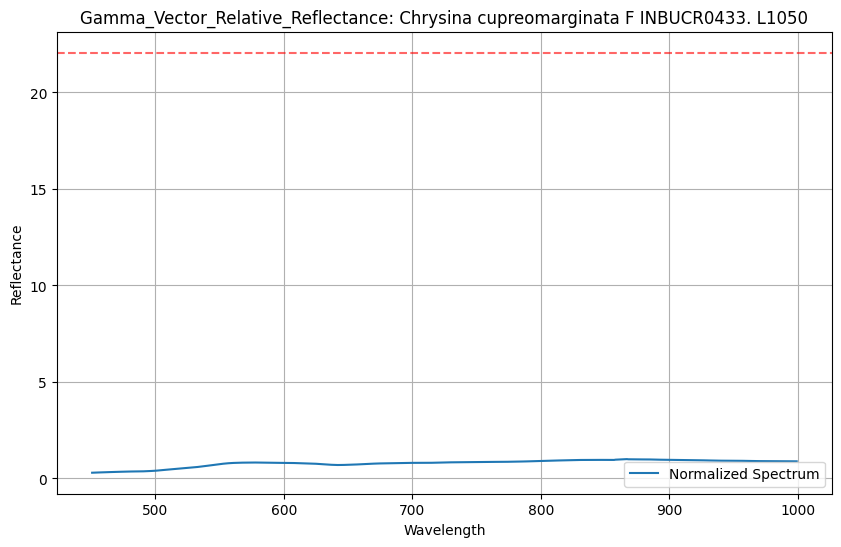

df peaklist get max       wavelength         %R
0          250.0   3.783033
1          251.0   3.775633
2          252.0   3.797833
3          253.0   3.752567
4          254.0   3.771033
...          ...        ...
1745      1995.0  14.908235
1746      1996.0  14.936671
1747      1997.0  14.975531
1748      1998.0  15.019068
1749      1999.0  15.052768

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


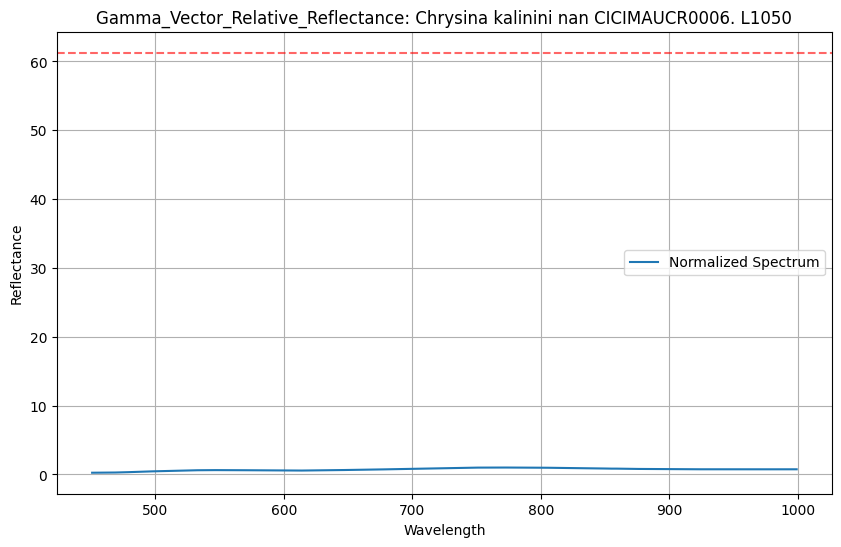

df peaklist get max       wavelength         %R
0          250.0   4.707333
1          251.0   4.727667
2          252.0   4.693633
3          253.0   4.685000
4          254.0   4.715367
...          ...        ...
1745      1995.0  13.829563
1746      1996.0  13.893894
1747      1997.0  13.916141
1748      1998.0  13.920316
1749      1999.0  13.955846

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


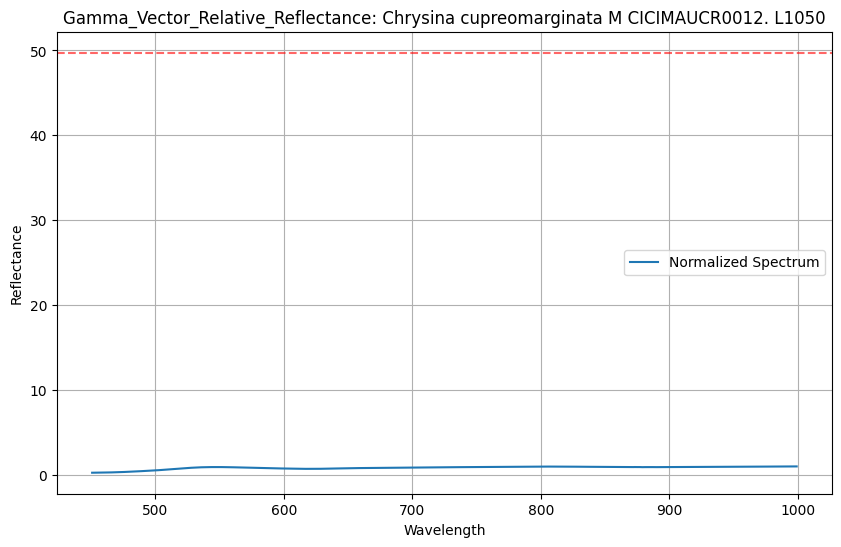

df peaklist get max       wavelength         %R
0          250.0   6.522400
1          251.0   6.509100
2          252.0   6.472900
3          253.0   6.470850
4          254.0   6.405500
...          ...        ...
1745      1995.0  15.842243
1746      1996.0  15.878753
1747      1997.0  15.918560
1748      1998.0  15.960838
1749      1999.0  15.995246

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


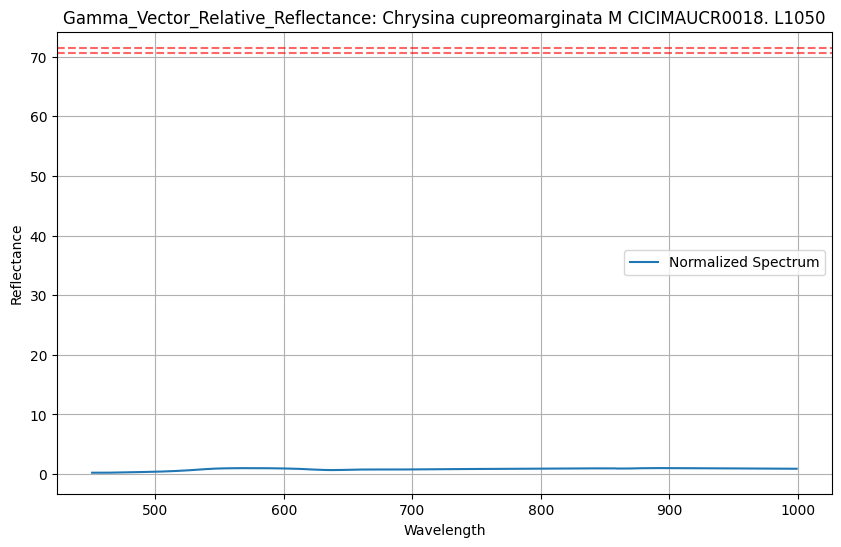

df peaklist get max       wavelength         %R
0          250.0   6.077967
1          251.0   6.042900
2          252.0   6.015433
3          253.0   6.005967
4          254.0   6.013433
...          ...        ...
1745      1995.0  22.518141
1746      1996.0  22.600915
1747      1997.0  22.618767
1748      1998.0  22.663347
1749      1999.0  22.726412

[1750 rows x 2 columns]
min 450.0 max 1000.0
Getting equipment. Spectrum


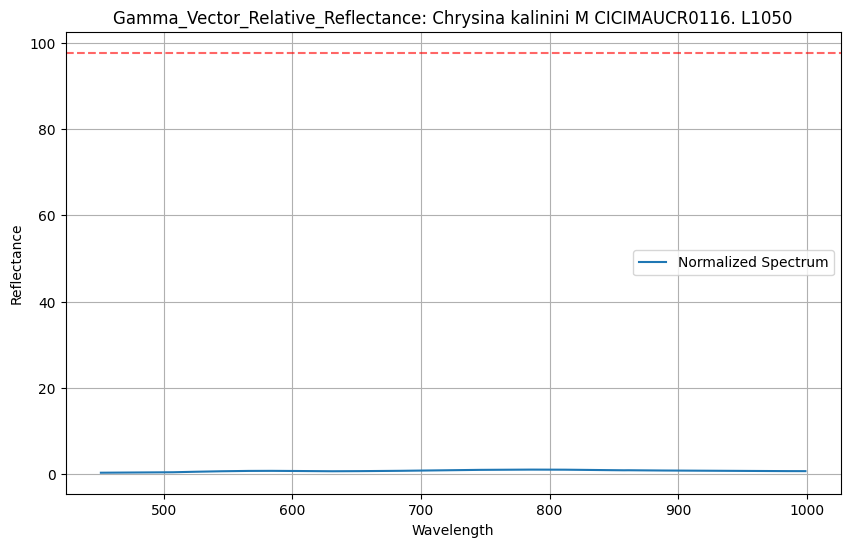

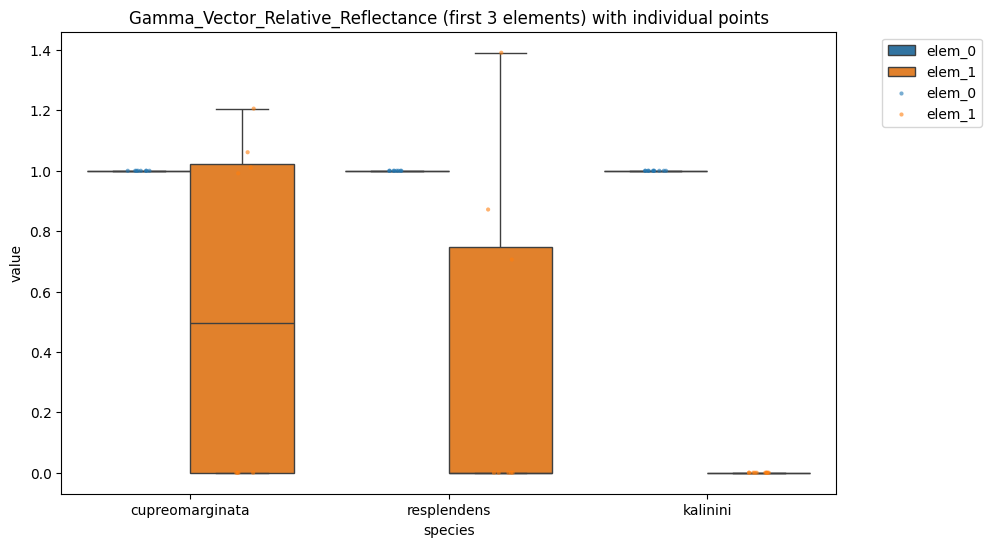

species cupreomarginata         kalinini resplendens        
metric           elem_0  elem_1   elem_0      elem_0  elem_1
mean                1.0  0.5337      1.0         1.0  0.3711
std                 0.0  0.5740      0.0         0.0  0.5466
median              1.0  0.4958      1.0         1.0  0.0000
min                 1.0  0.0000      1.0         1.0  0.0000
max                 1.0  1.2058      1.0         1.0  1.3910
iqr                 0.0  1.0233      0.0         0.0  0.7474
cv                  0.0  1.0756      0.0         0.0  1.4730

In [25]:
get_aggregated_data(Gamma_Vector_Relative_Reflectance,
                    config_file = metric_configuration_file, 
                    spectra =  train_spectra, 
                    collection_list = training_collection_list,
                    plot = True)

## Boxplots

UV VIS MIN 450.0 UV VIS MAX: 675.0
POINT: 568.0 65.2613
ir_min_wavelength 450.0 ir_max_wavelength: 675.0
POINT: 845.0 65.2479
UV VIS MIN 450.0 UV VIS MAX: 675.0
POINT: 577.0 68.477267
ir_min_wavelength 450.0 ir_max_wavelength: 675.0
POINT: 917.0 82.571312
UV VIS MIN 450.0 UV VIS MAX: 675.0
POINT: 586.0 75.594599
ir_min_wavelength 450.0 ir_max_wavelength: 675.0
POINT: 781.0 77.695926
UV VIS MIN 450.0 UV VIS MAX: 675.0
POINT: 674.0 75.01465
ir_min_wavelength 450.0 ir_max_wavelength: 675.0
POINT: 781.0 95.61905
UV VIS MIN 450.0 UV VIS MAX: 675.0
POINT: 585.0 75.0878
ir_min_wavelength 450.0 ir_max_wavelength: 675.0
POINT: 784.0 77.23488
UV VIS MIN 450.0 UV VIS MAX: 675.0
POINT: 576.0 80.9293
ir_min_wavelength 450.0 ir_max_wavelength: 675.0
POINT: 781.0 99.0786
UV VIS MIN 450.0 UV VIS MAX: 675.0
POINT: 578.0 86.700367
ir_min_wavelength 450.0 ir_max_wavelength: 675.0
POINT: 795.0 89.5212
UV VIS MIN 450.0 UV VIS MAX: 675.0
POINT: 568.0 84.4716
ir_min_wavelength 450.0 ir_max_wavelength: 675.0


C:\Users\esteb\escarabajos\libraries\metrics.py:1778: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(


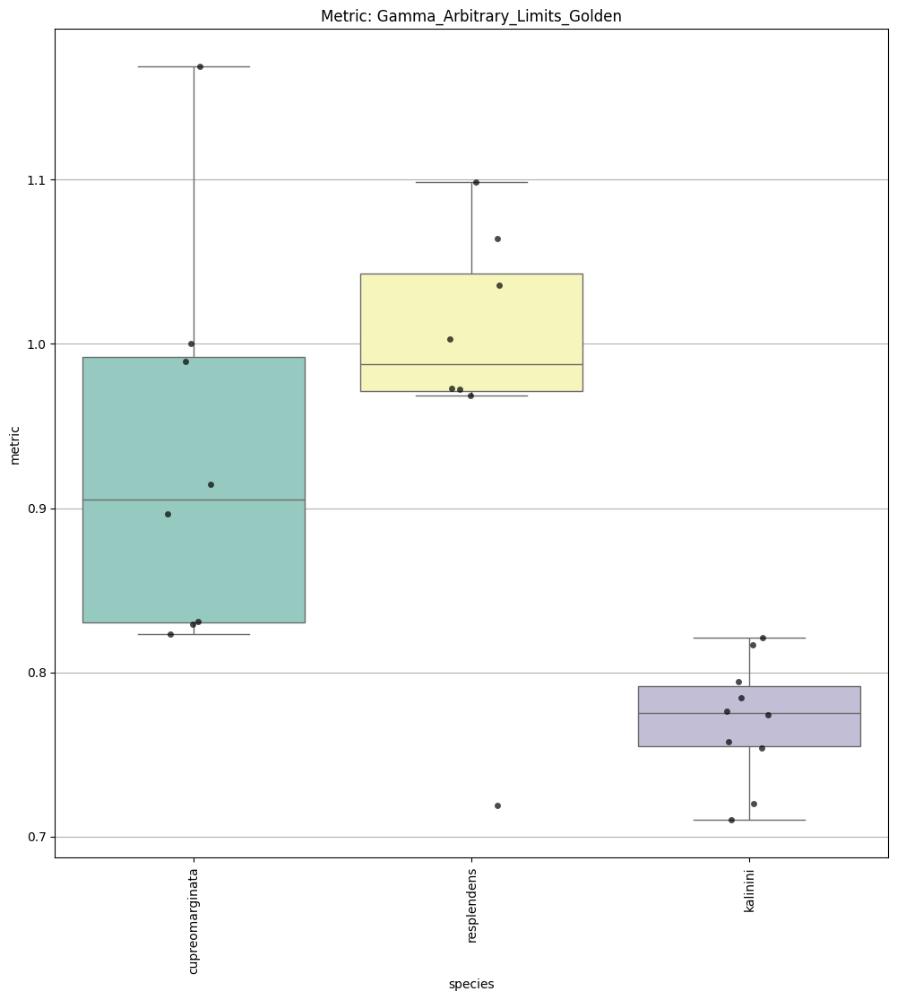

In [26]:
Metric_Testbench(Gamma_Arbitrary_Limits_Golden, spectra = train_spectra, config_file = metric_configuration_file, collection_list = training_collection_list)

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

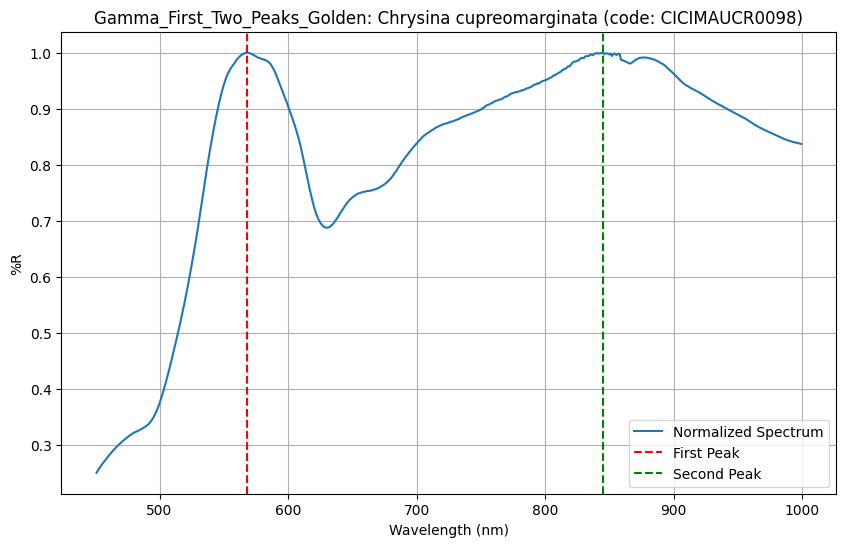

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

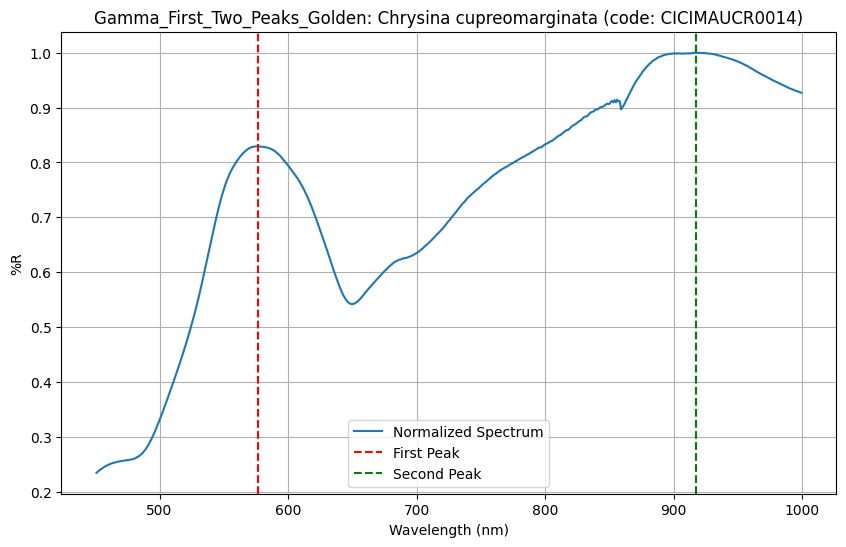

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

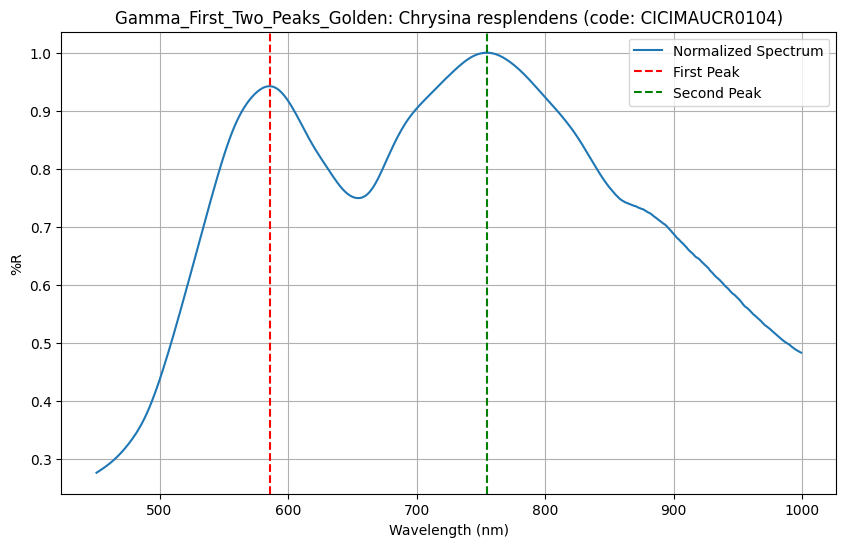

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

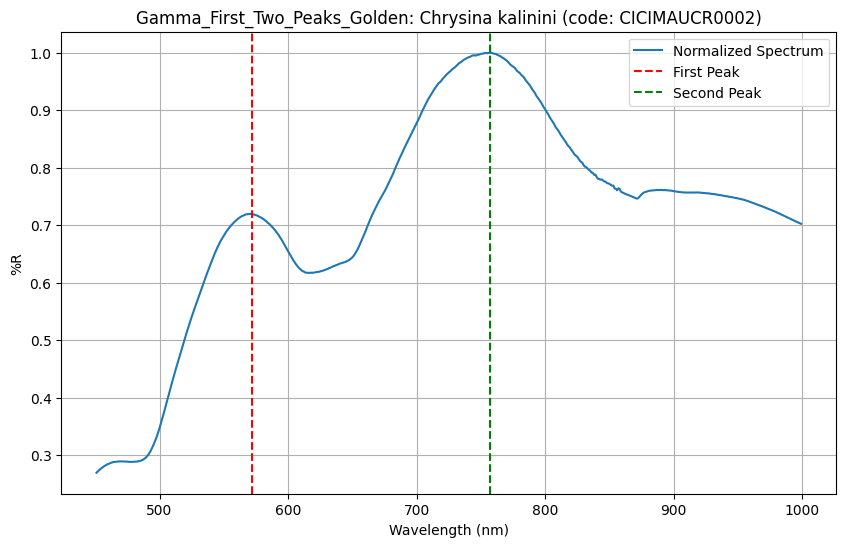

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

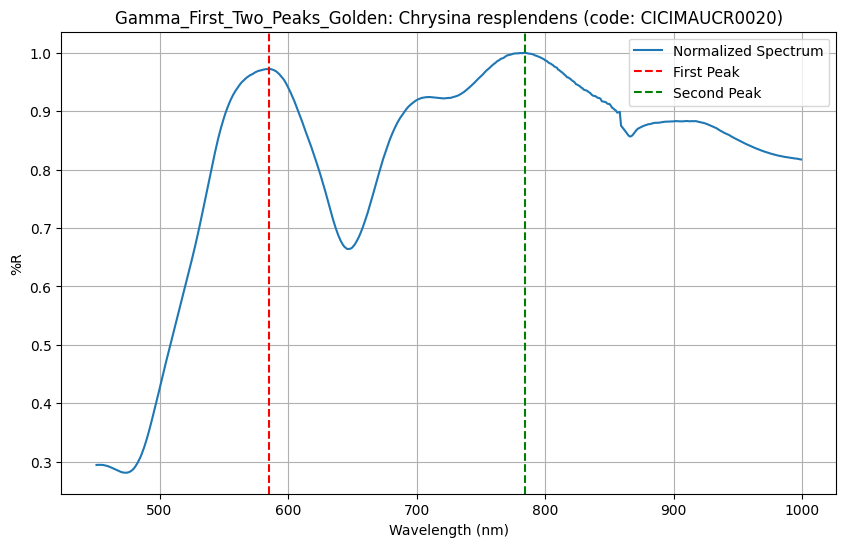

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

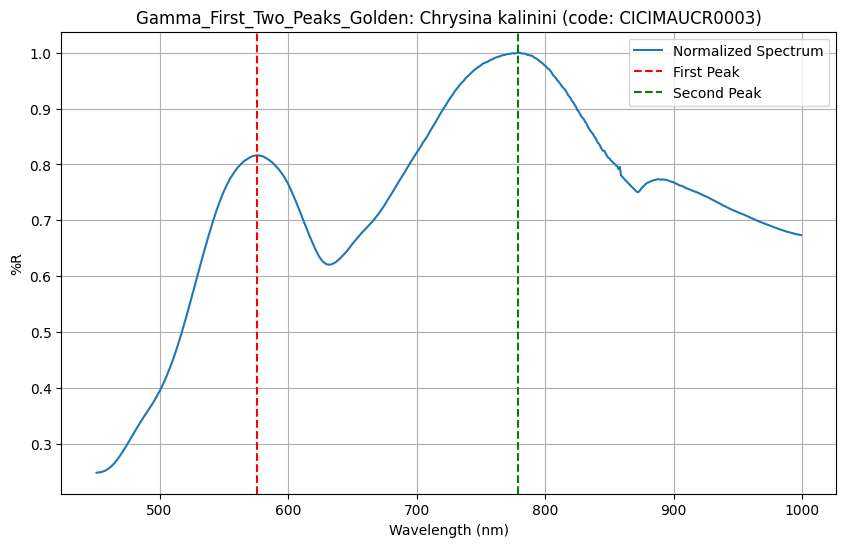

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

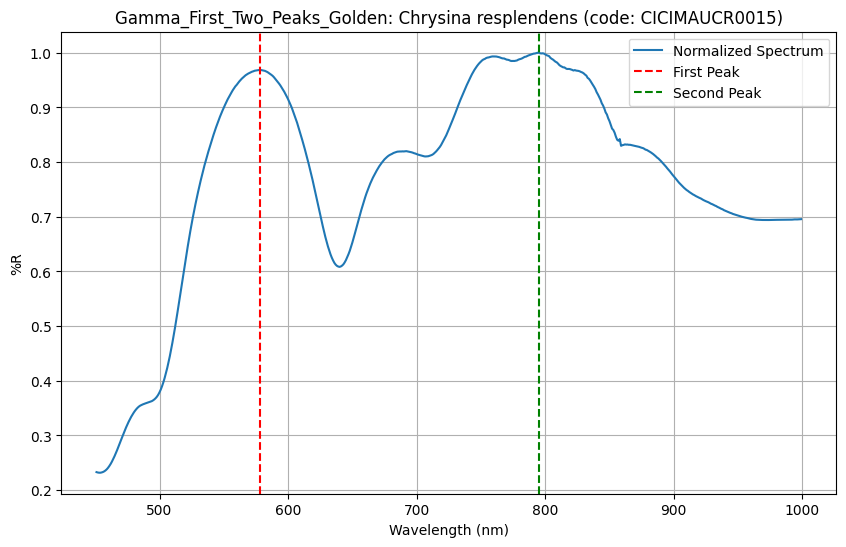

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

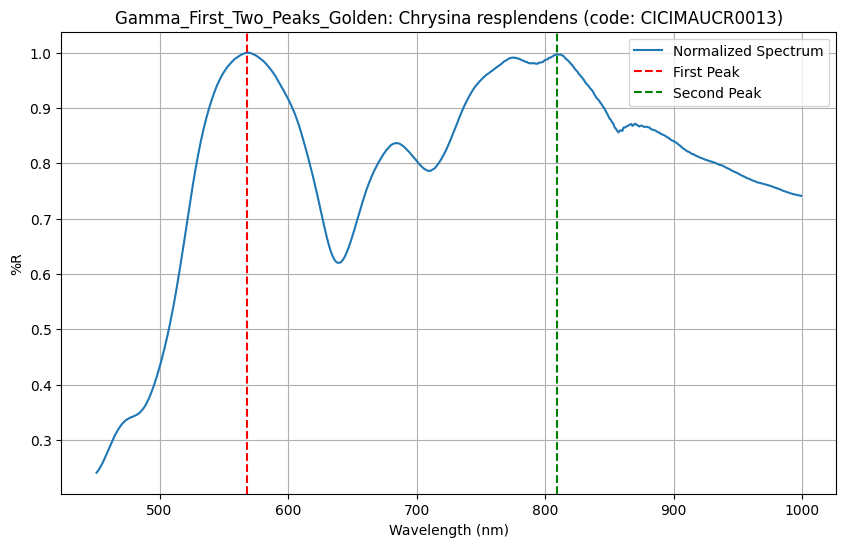

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

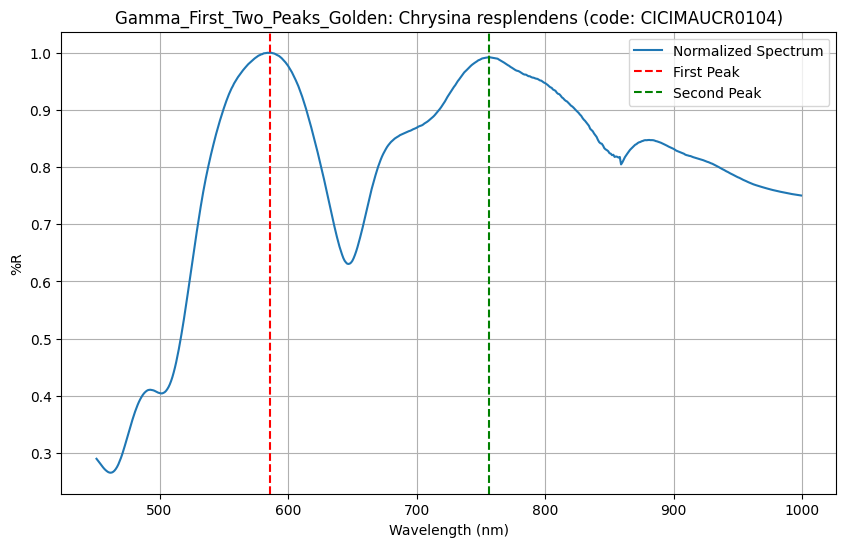

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

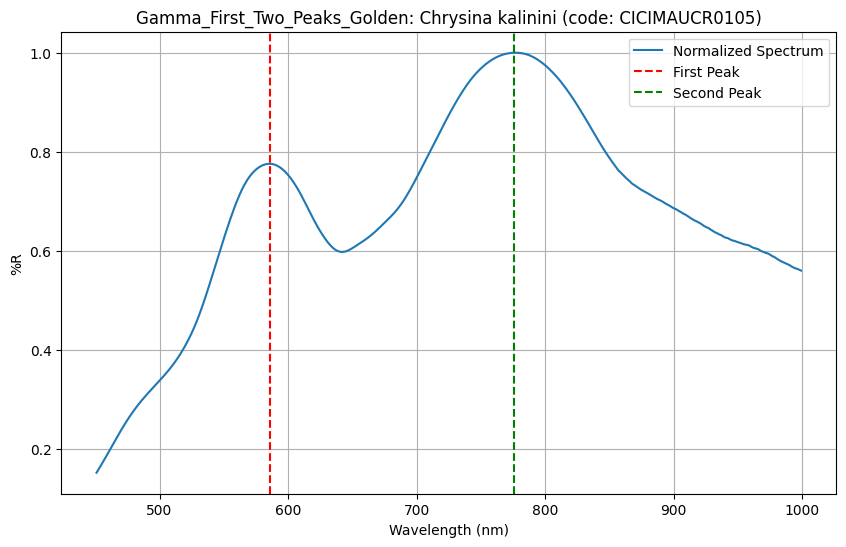

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

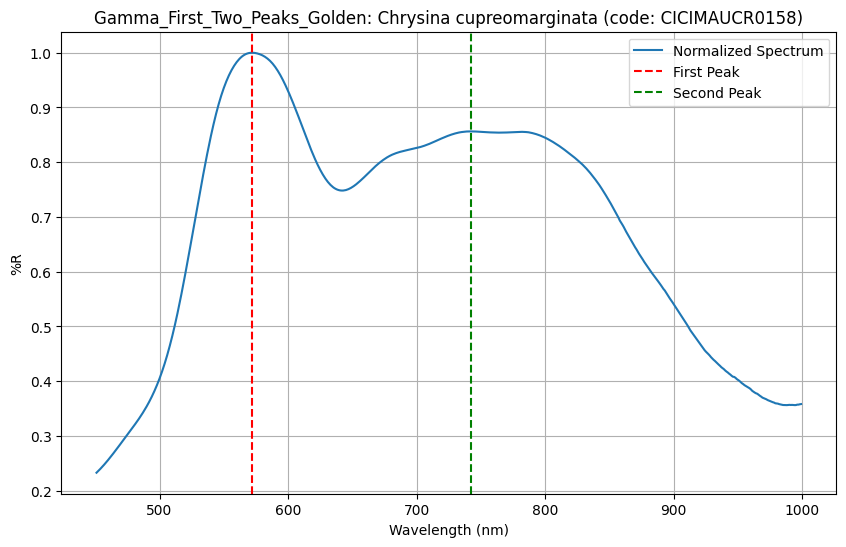

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

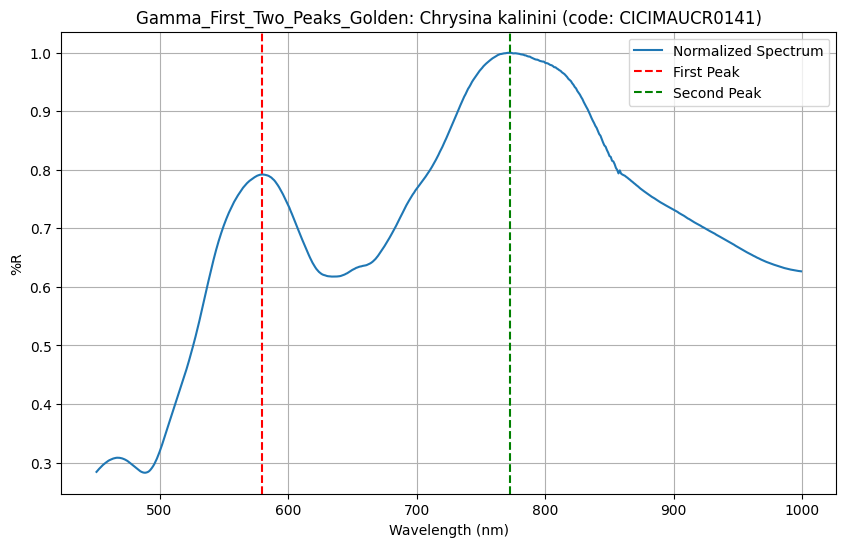

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

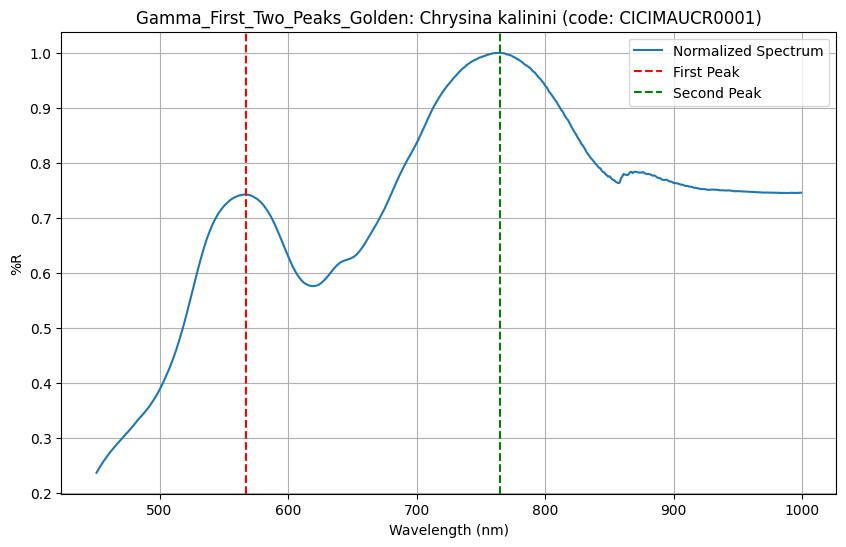

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

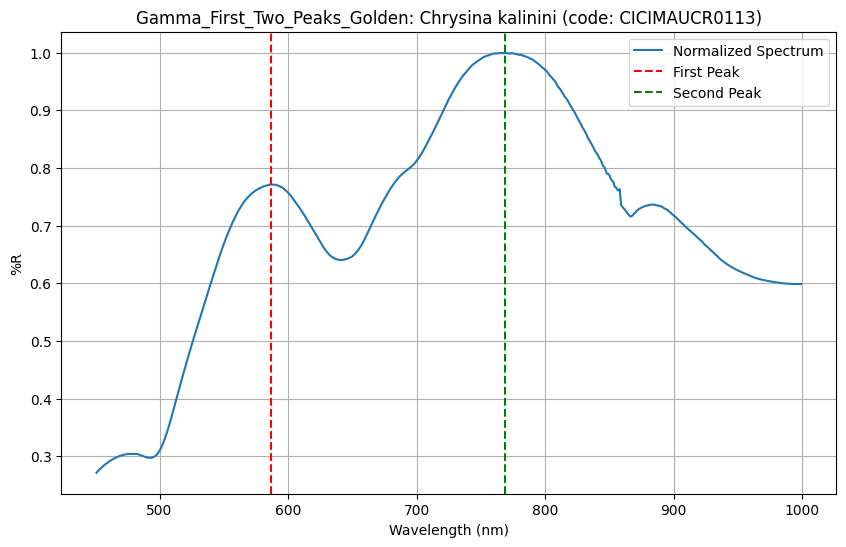

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

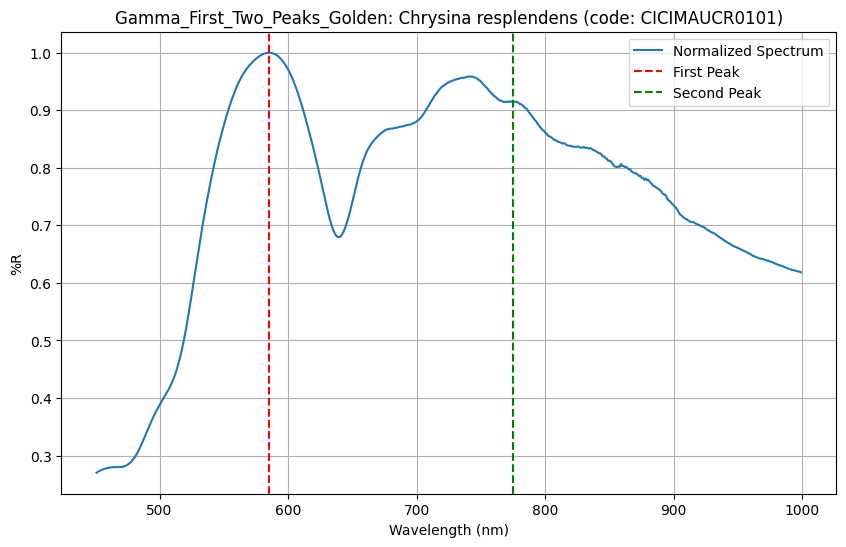

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

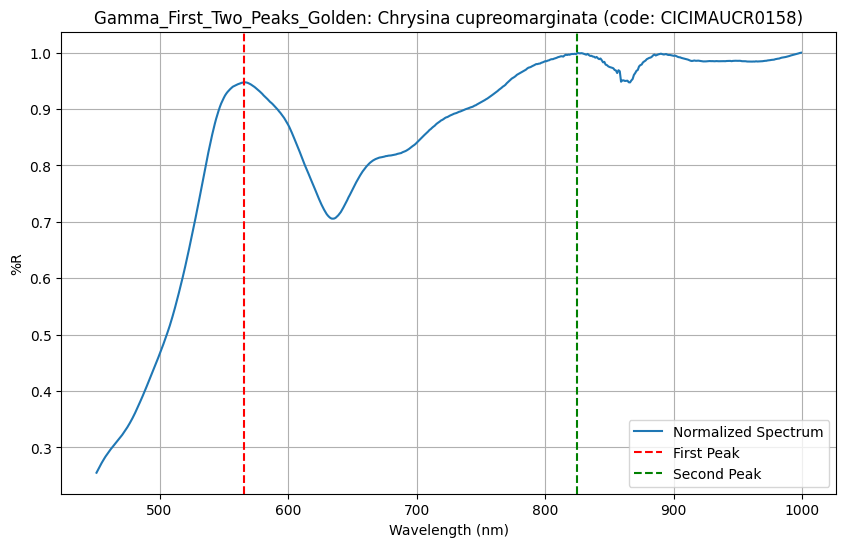

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

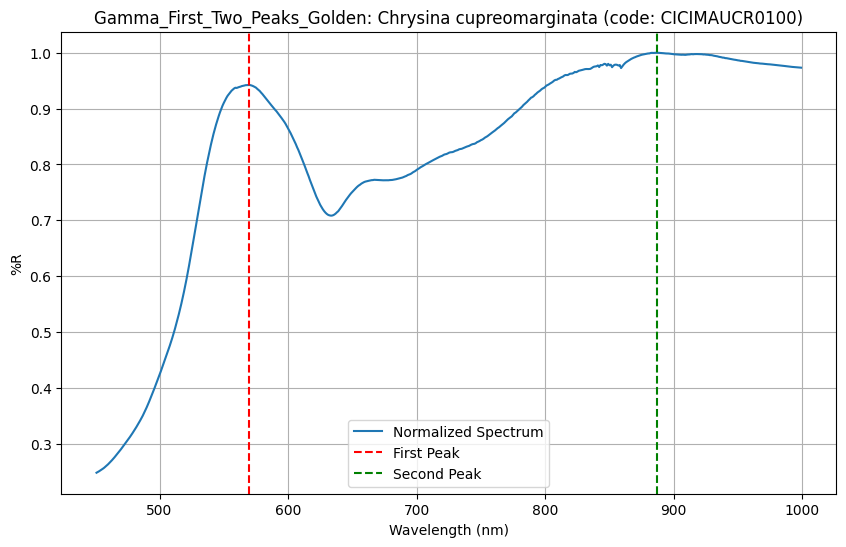

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

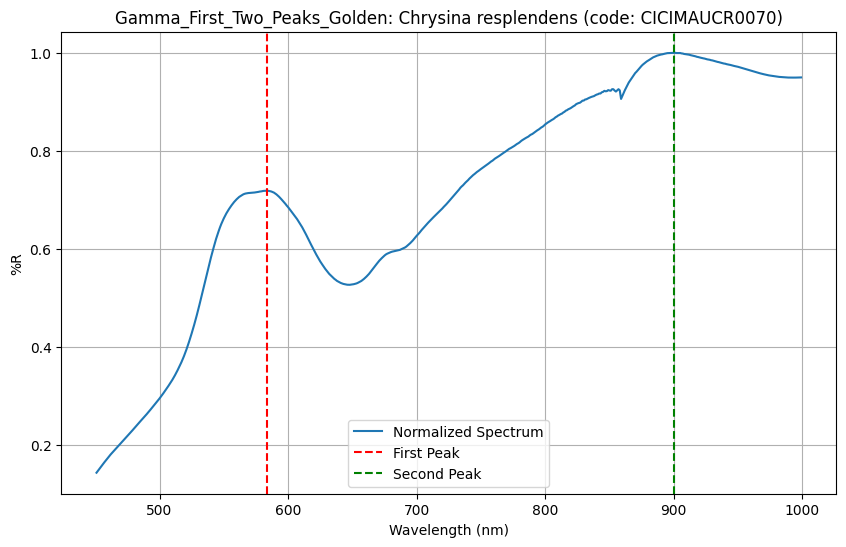

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

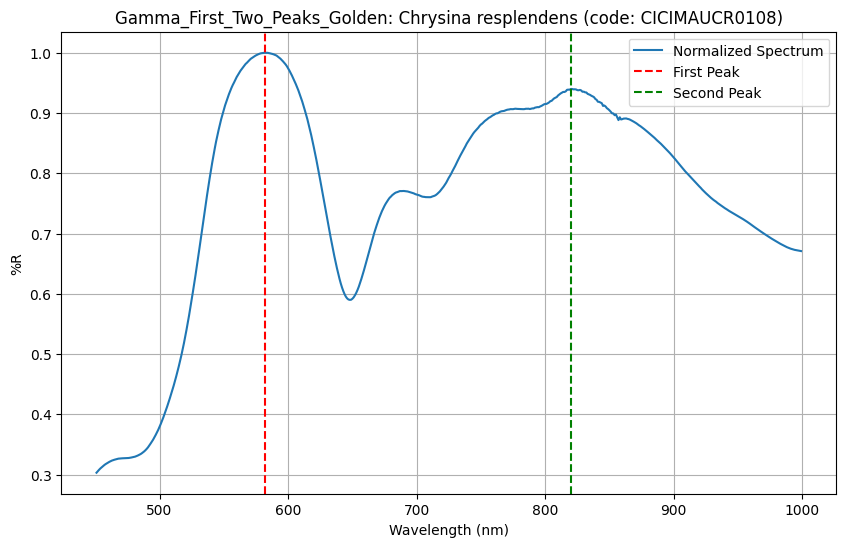

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

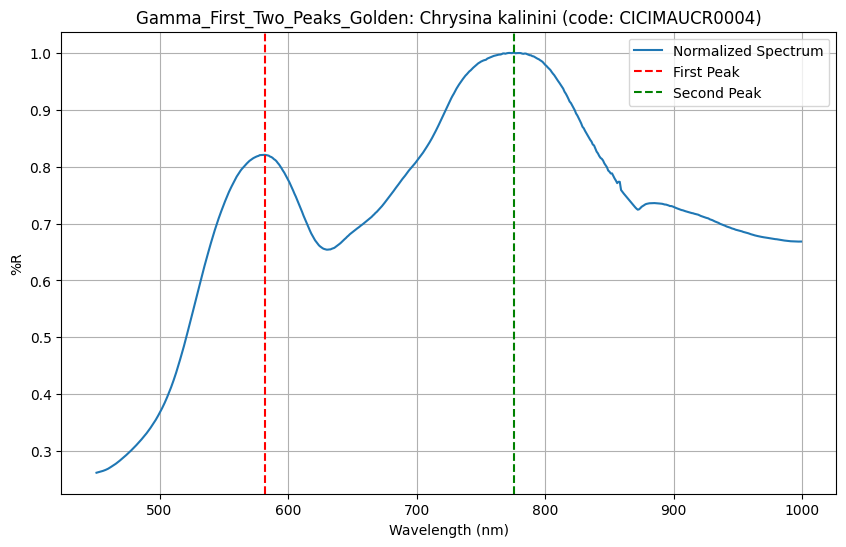

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

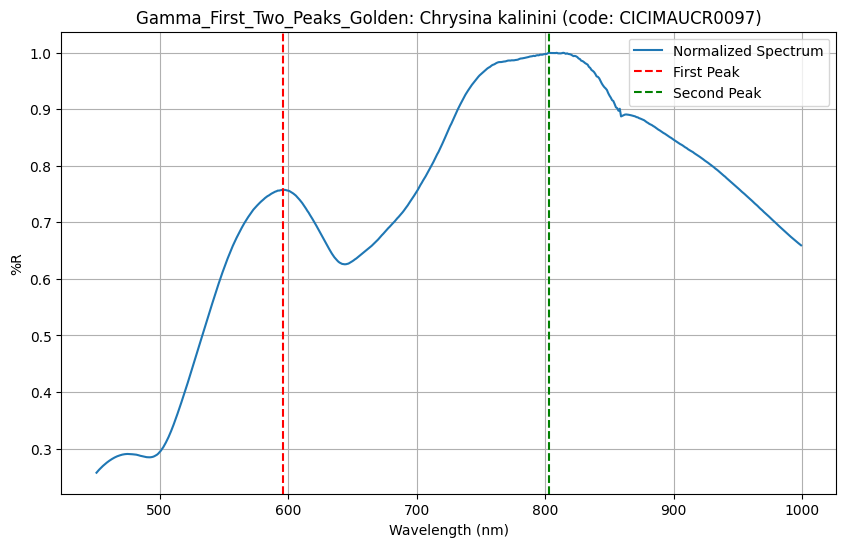

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

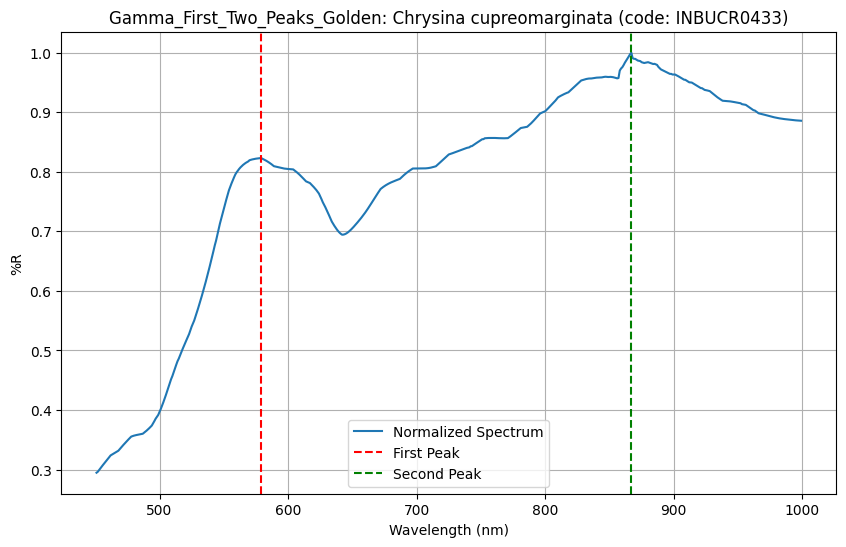

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

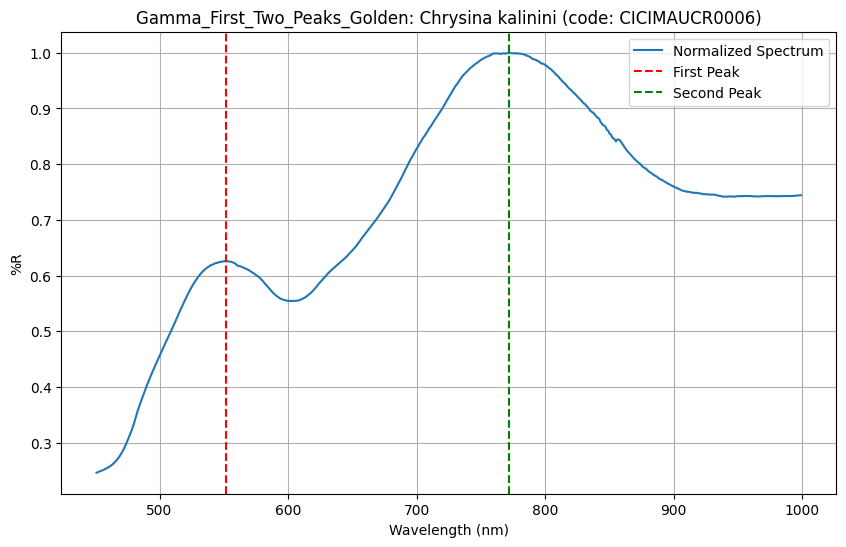

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

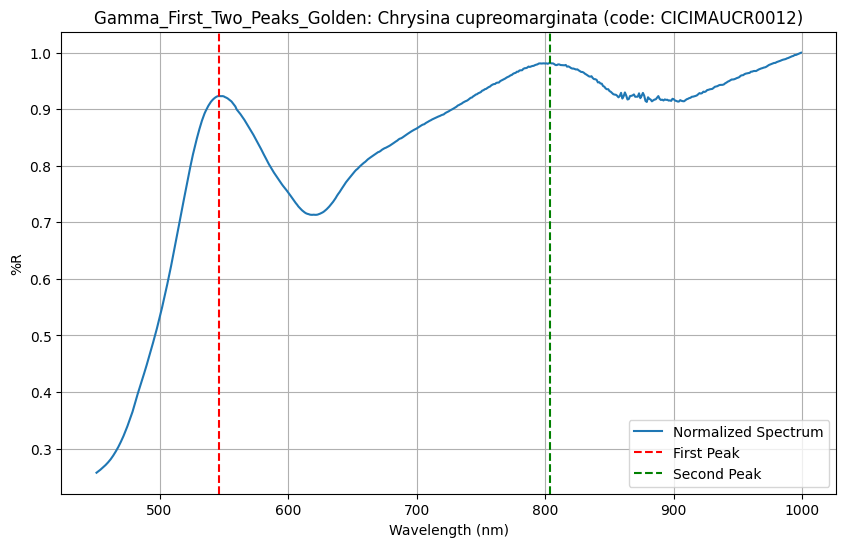

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

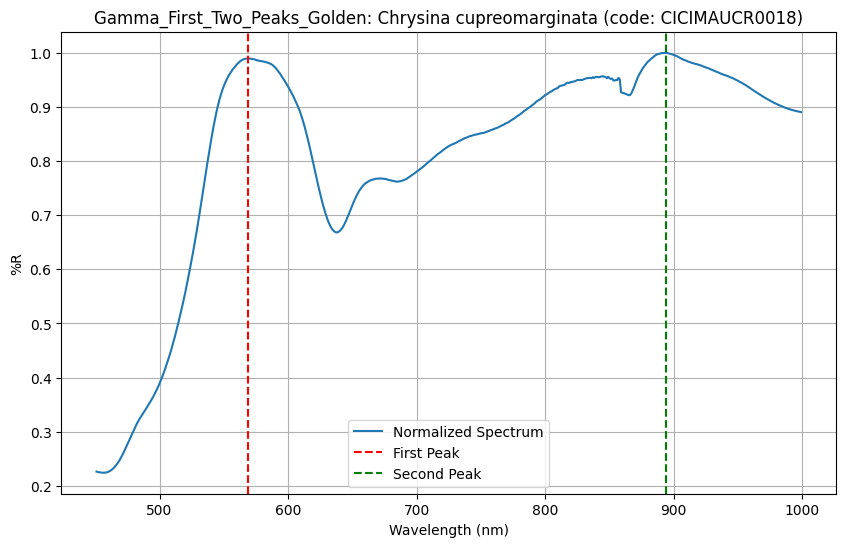

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

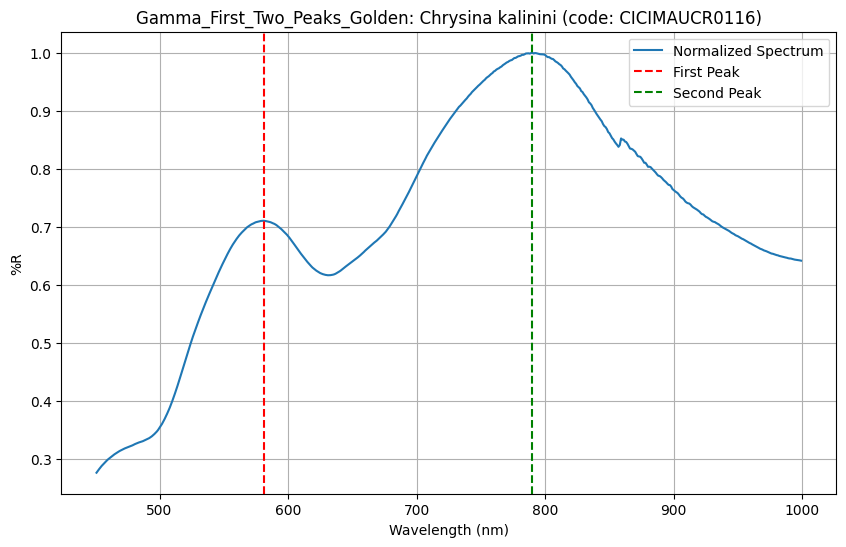

C:\Users\esteb\escarabajos\libraries\metrics.py:1778: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(


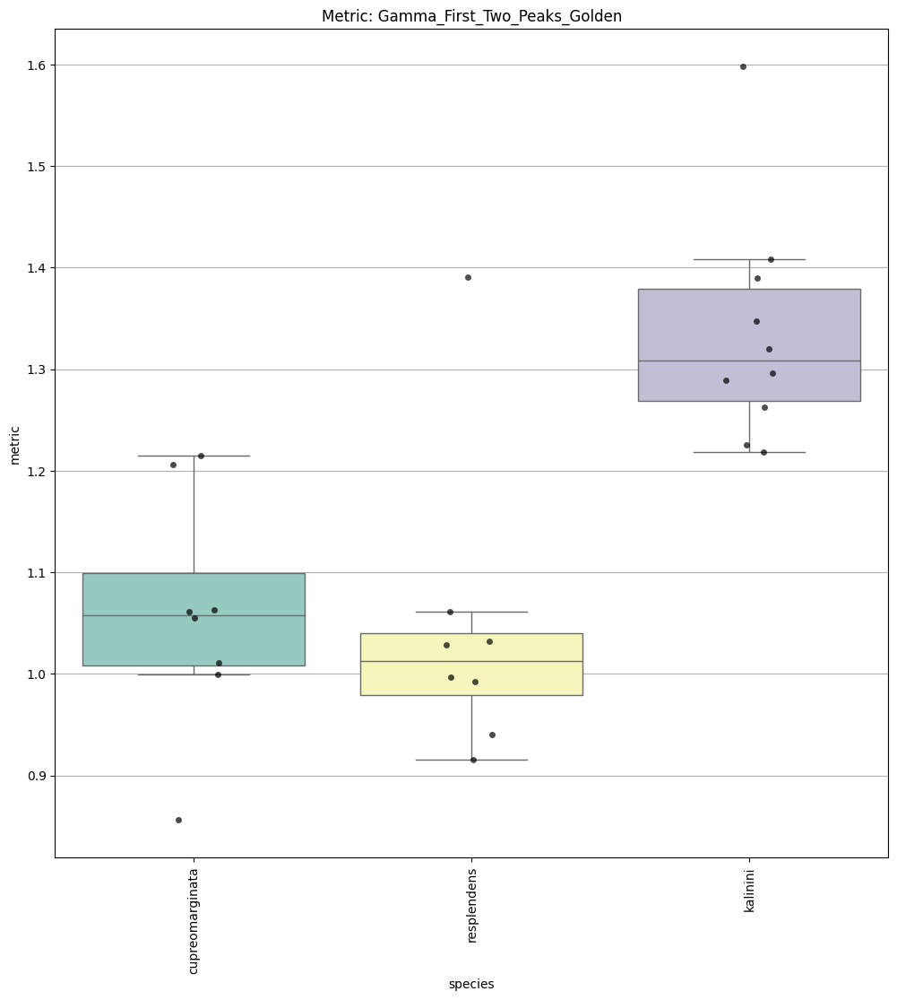

In [27]:
Metric_Testbench(Gamma_First_Two_Peaks_Golden, spectra = train_spectra, config_file = metric_configuration_file, collection_list = training_collection_list)

C:\Users\esteb\escarabajos\libraries\metrics.py:1778: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(


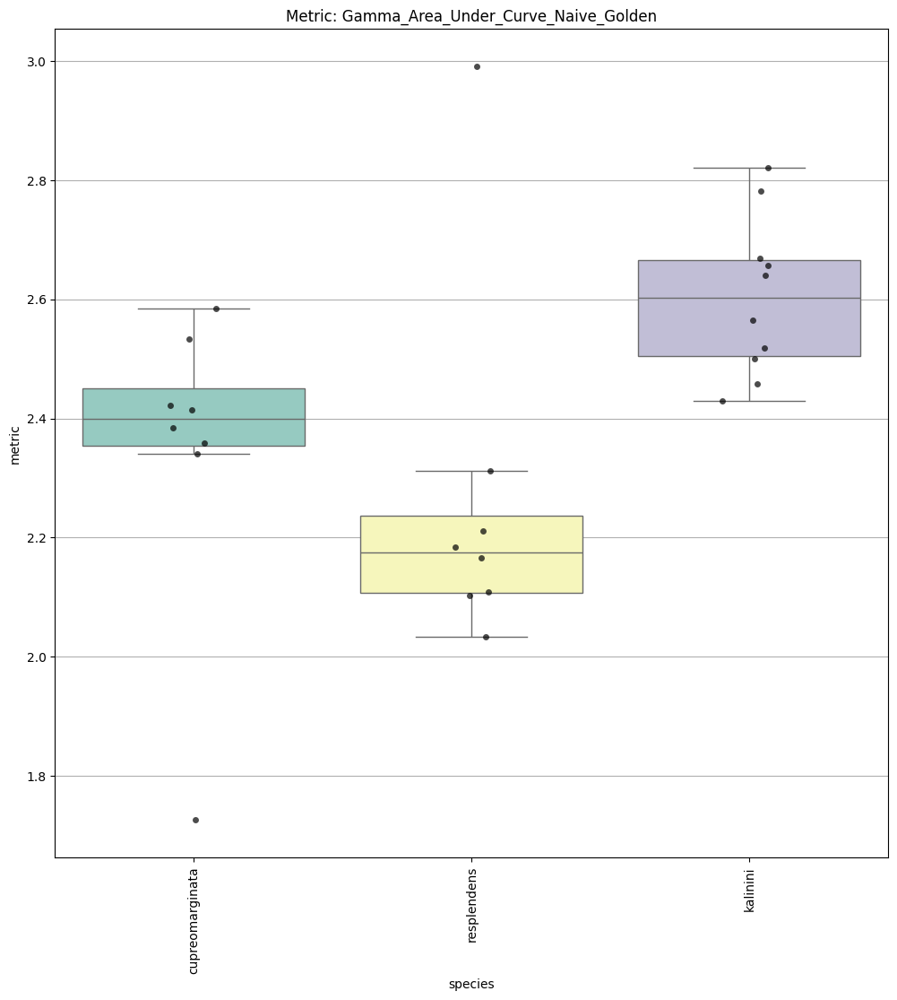

In [28]:
Metric_Testbench(Gamma_Area_Under_Curve_Naive_Golden, spectra = train_spectra, config_file = metric_configuration_file, collection_list = training_collection_list)

In [29]:
Metric_Testbench(Gamma_Area_Under_Curve_First_Min_Cut, 
                 spectra = train_spectra, 
                 config_file = metric_configuration_file, 
                 collection_list = training_collection_list)

Error computing metric for C:\Users\esteb\escarabajos\L1050_data\CICIMA-2024-03-REFLECTANCE\without iris nor lens\average\CICIMAUCR0098.txt: Gamma_Area_Under_Curve_First_Min_Cut.__init__() missing 1 required positional argument: 'plot'
Error computing metric for C:\Users\esteb\escarabajos\L1050_data\CICIMA-2024-03-REFLECTANCE\without iris nor lens\average\CICIMAUCR0014.txt: Gamma_Area_Under_Curve_First_Min_Cut.__init__() missing 1 required positional argument: 'plot'
Error computing metric for C:\Users\esteb\escarabajos\L1050_data\TRA_data_CICIMA_INBUCR\CICIMAUCR\reflectance\CICIMAUCR0104.txt: Gamma_Area_Under_Curve_First_Min_Cut.__init__() missing 1 required positional argument: 'plot'
Error computing metric for C:\Users\esteb\escarabajos\L1050_data\CICIMA-2024-03-REFLECTANCE\without iris nor lens\average\CICIMAUCR0002.txt: Gamma_Area_Under_Curve_First_Min_Cut.__init__() missing 1 required positional argument: 'plot'
Error computing metric for C:\Users\esteb\escarabajos\L1050_data\CIC

C:\Users\esteb\escarabajos\libraries\metrics.py:1750: UserWarning: No valid metrics computed — boxplot cannot be generated.
  warnings.warn("No valid metrics computed — boxplot cannot be generated.")


self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.uv_vis_min_wavelength=475.0
        self.uv_vis_max_wavelength=625.0
        self.ir_min_wavelength=700.0
        self.ir_max_wavelength=900.0
        self.prominence_threshold_for_min=0.15
        self.prominence_threshold_for_max=0.4
        self.height_bottom_threshold_for_minimum=0.6
        self.height_bottom_threshold_for_maximum=0.6
        self.smallest_distance_between_peaks_for_min=None
        self.smallest_distance_between_peaks_for_max=None
        1.0
range _fit_gaussian_peak:  475.0 625.0
range _fit_gaussian_peak:  700.0 900.0
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.uv_vis_min_wavelength=475.0
        self.uv_vis_max_wavelength=625.0
        self.ir_min_wavelength=700.0
        self.ir_max_wavelength=900.0
        self.prominence_threshold_for_min=0.15
        self

C:\Users\esteb\escarabajos\libraries\metrics.py:1778: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(


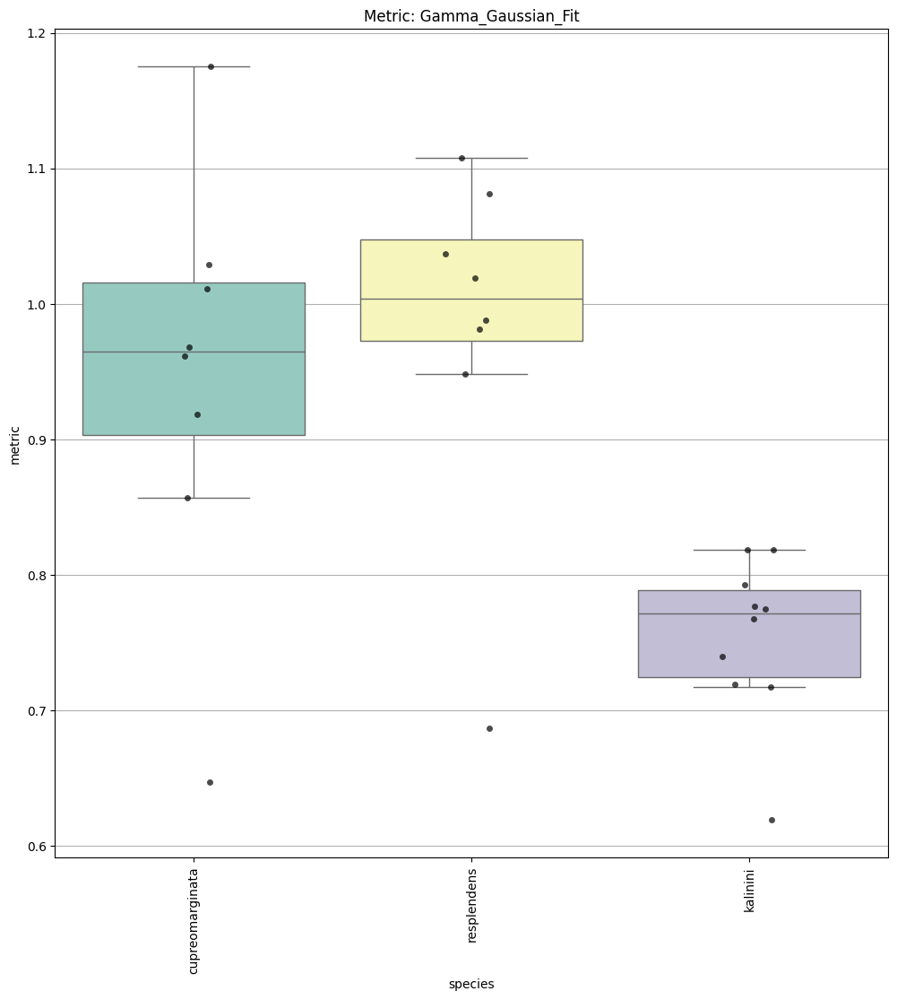

In [30]:
Metric_Testbench(Gamma_Gaussian_Fit, spectra = train_spectra, config_file = metric_configuration_file, collection_list = training_collection_list)

## Metric consolidation
### For each metric, saves the result on a single dataset, and liberates space. 
These metrics will be used one by one to train the neural network. This method will mark them as fit or unfit to be used in neural network training


📂 Using DB at C:\Users\esteb\escarabajos\gamma factor calculation and neural network training\metrics.sqlite
STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.sta

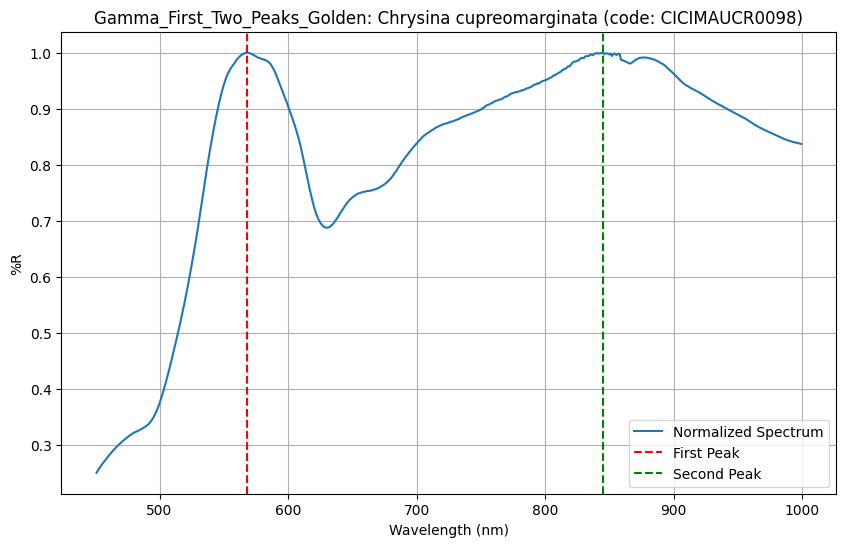

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

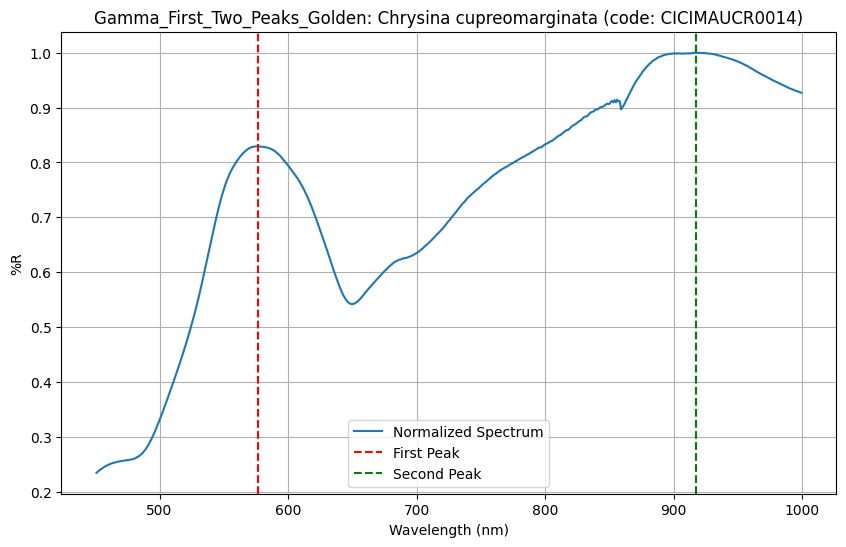

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

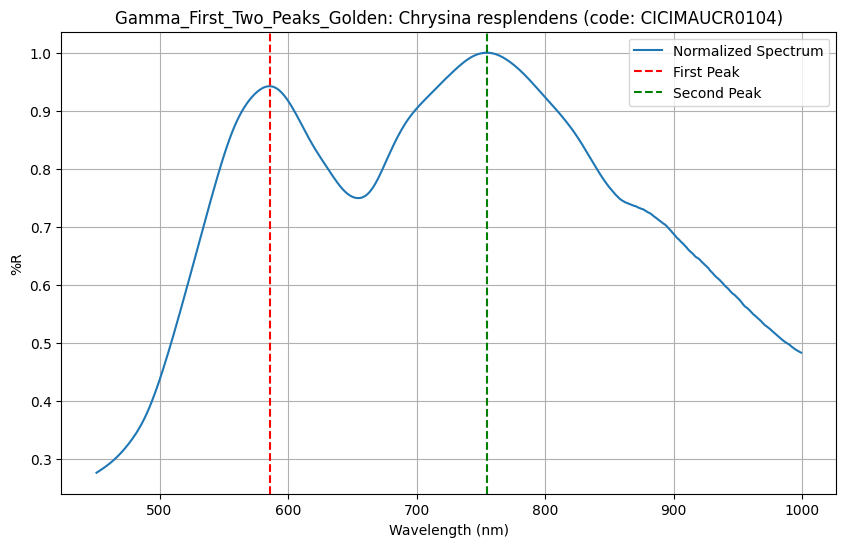

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

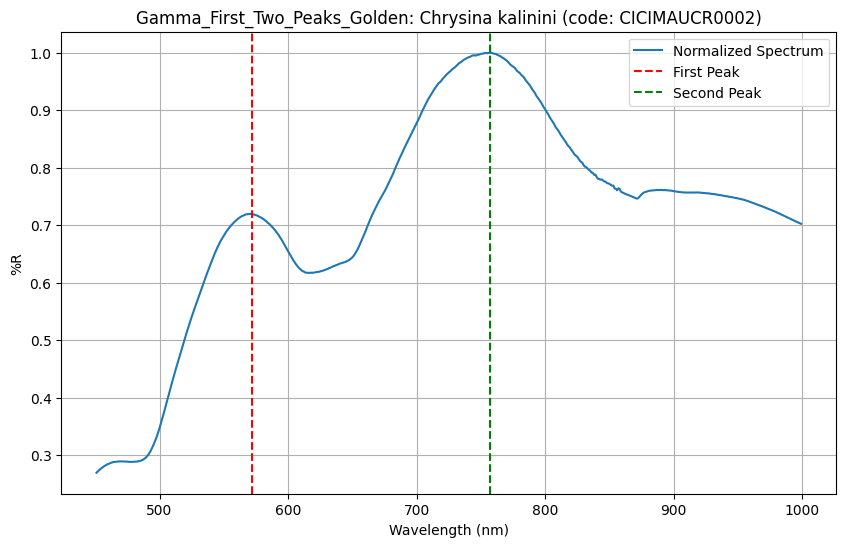

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

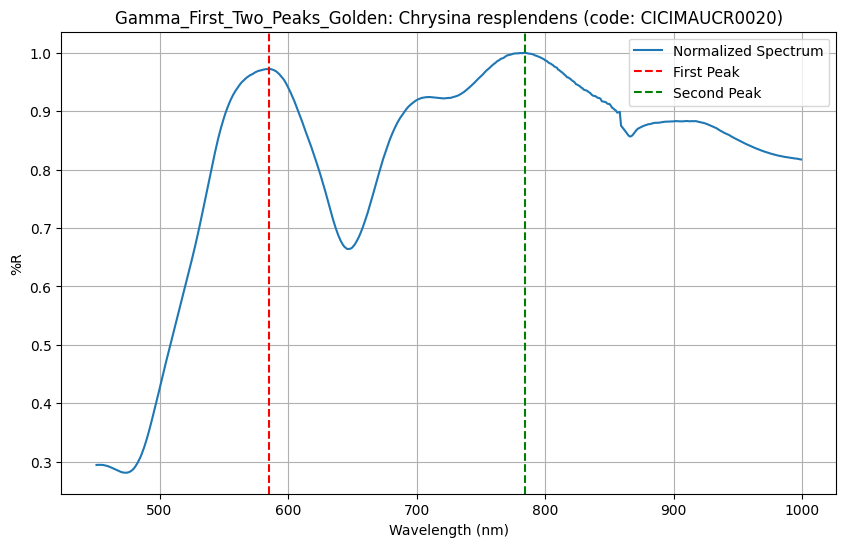

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

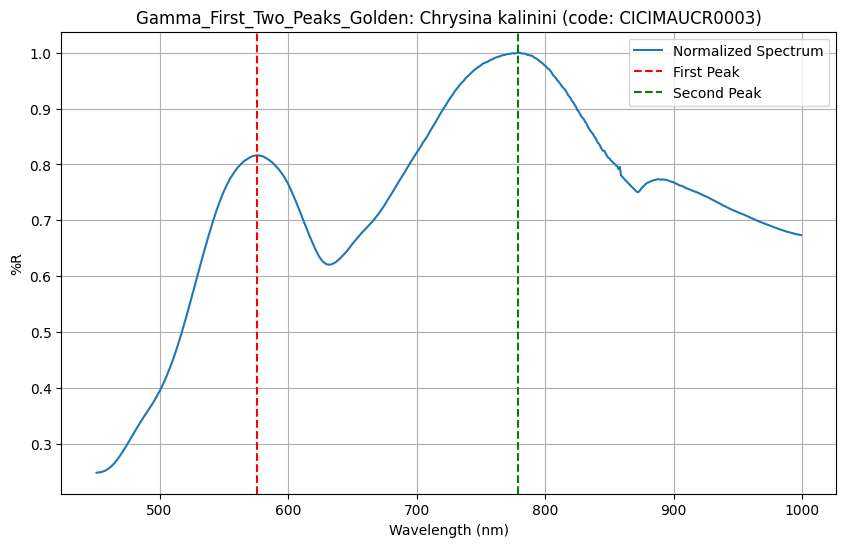

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

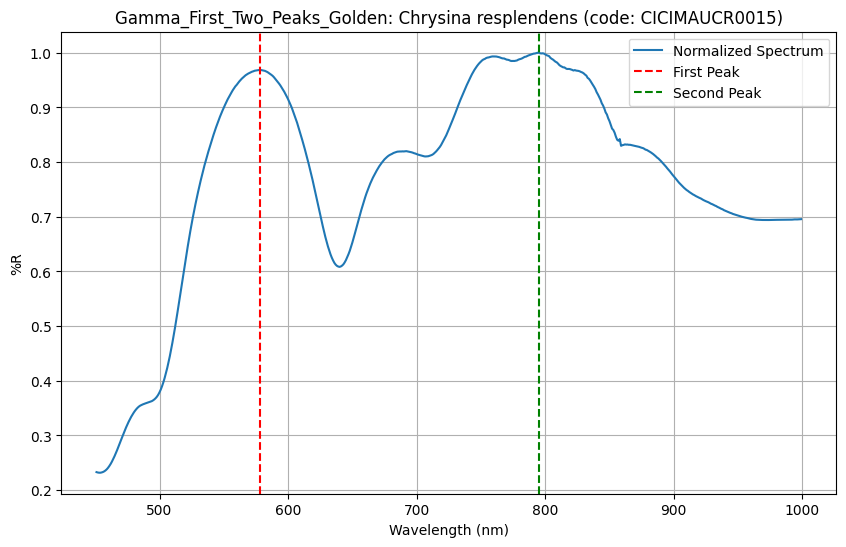

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

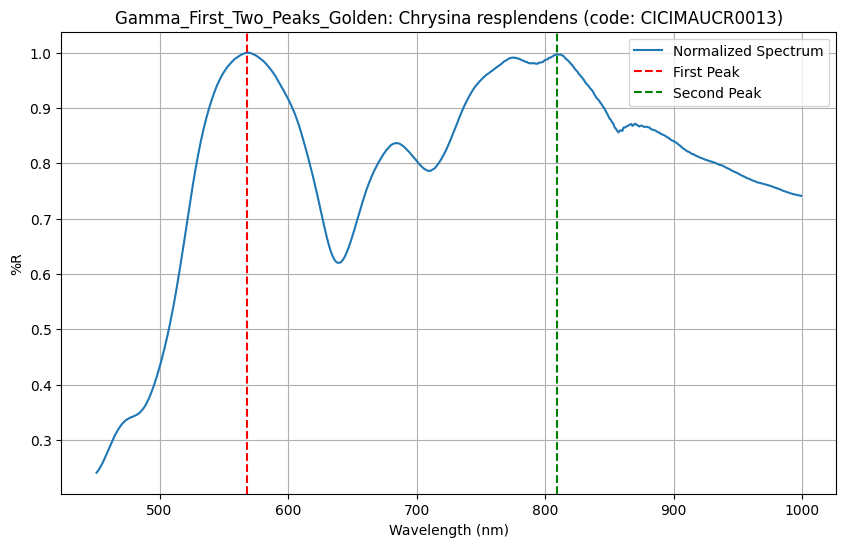

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

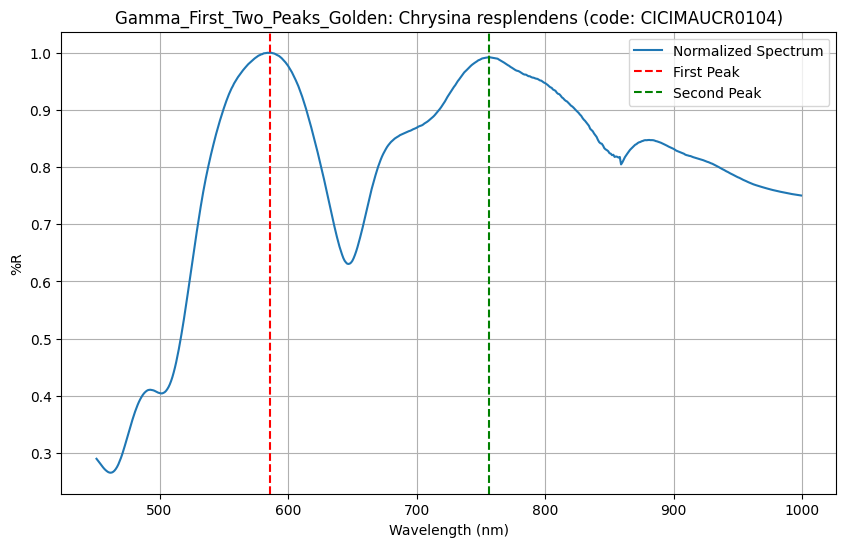

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

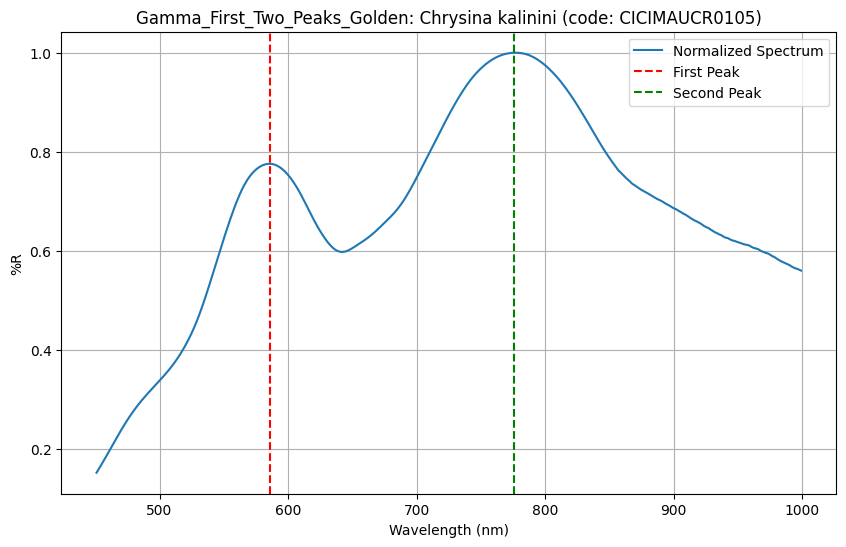

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

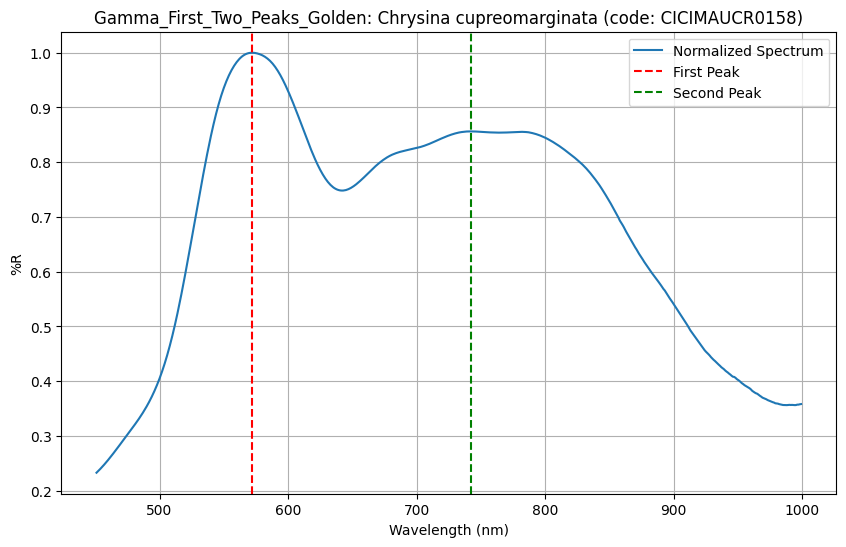

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

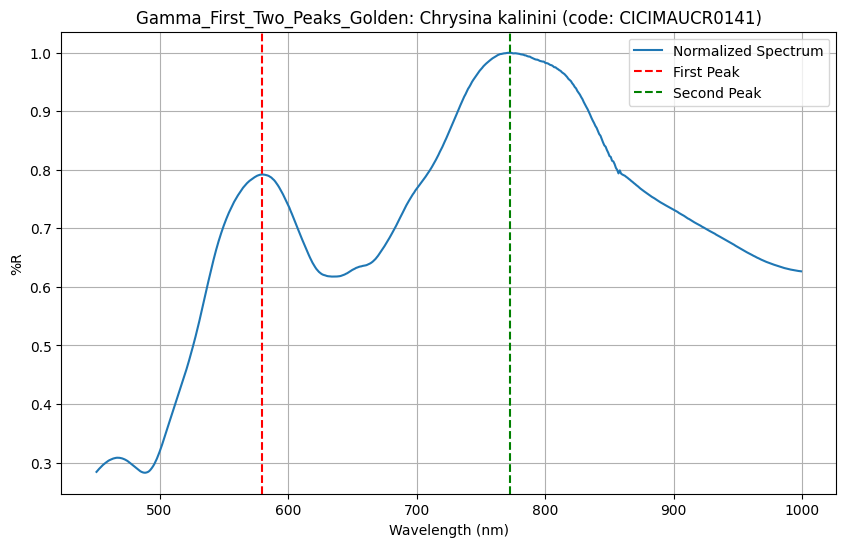

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

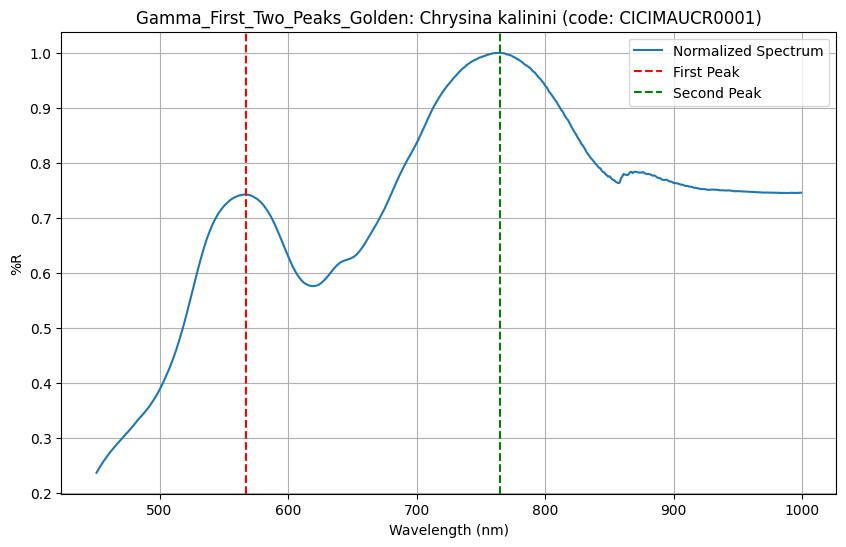

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

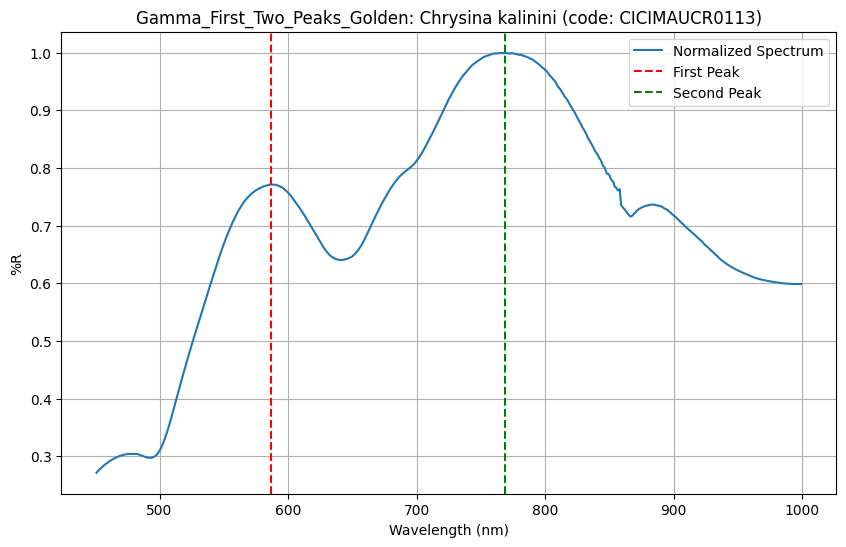

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

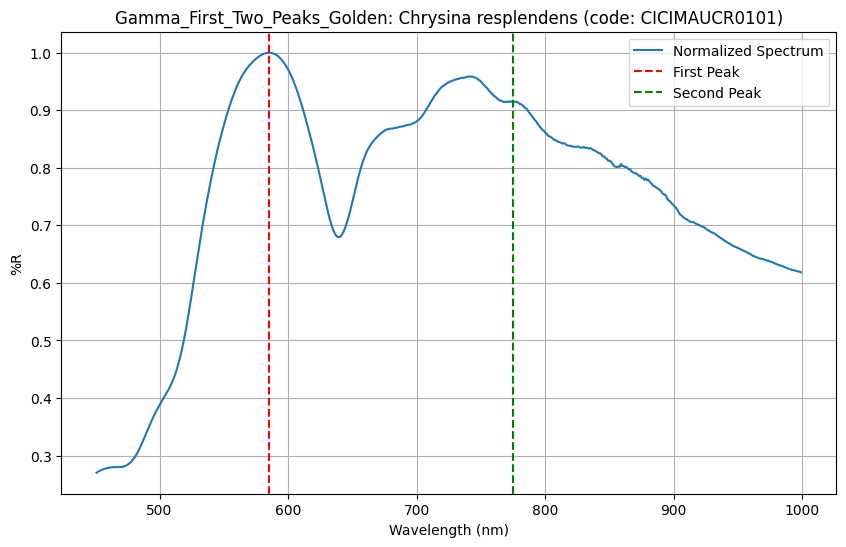

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

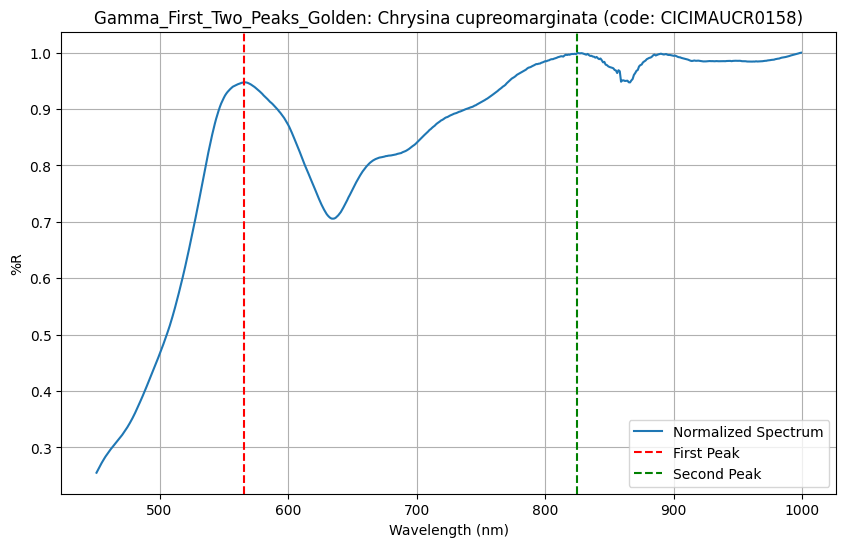

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

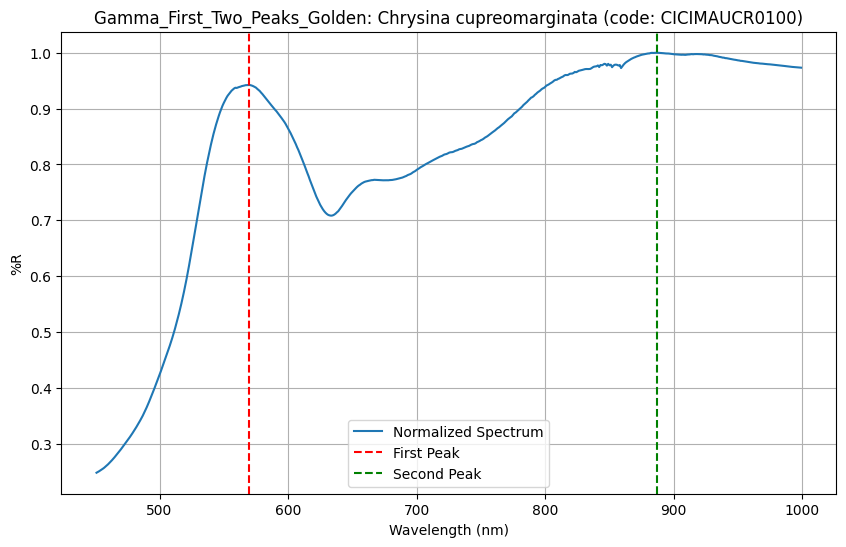

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

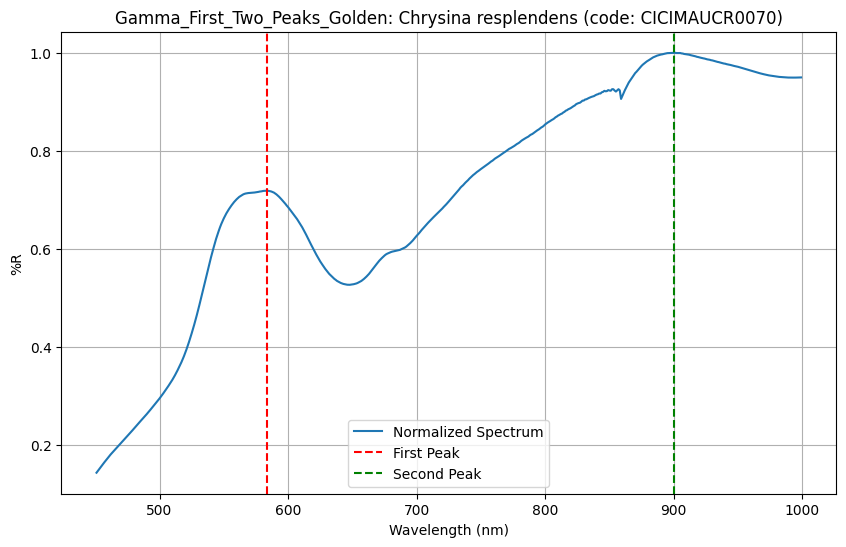

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

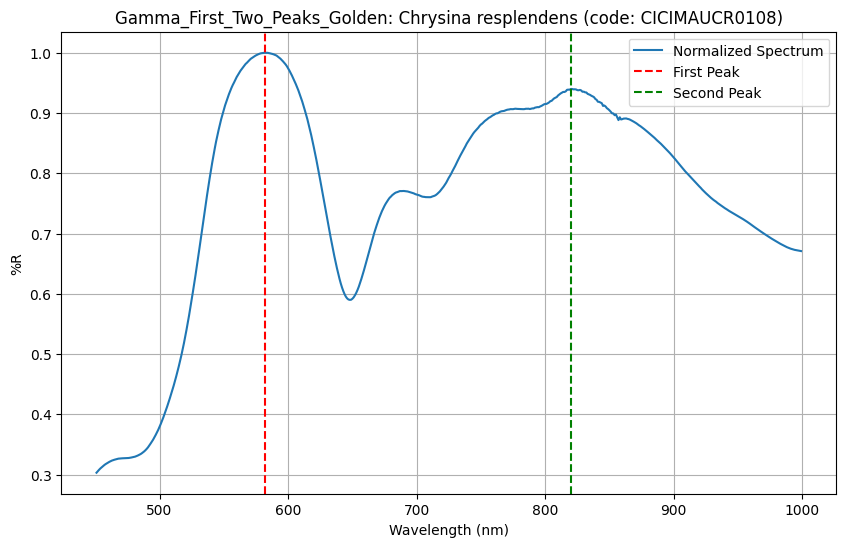

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

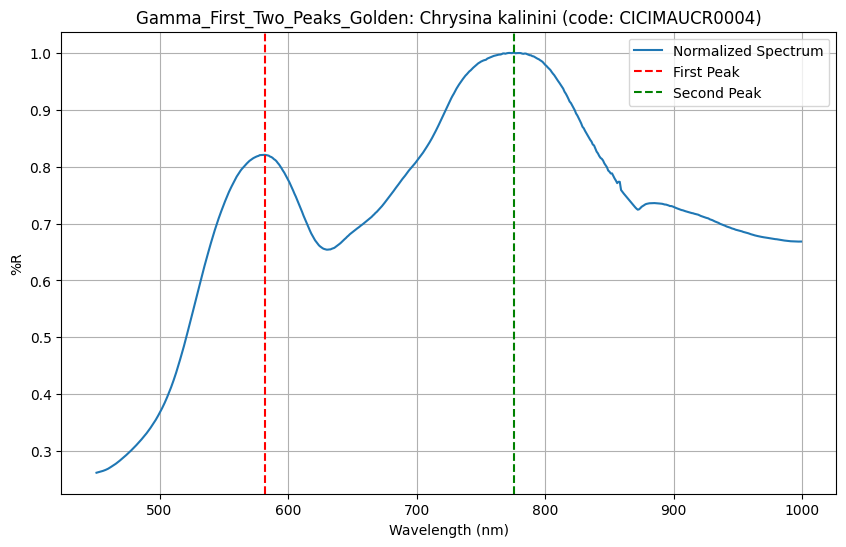

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

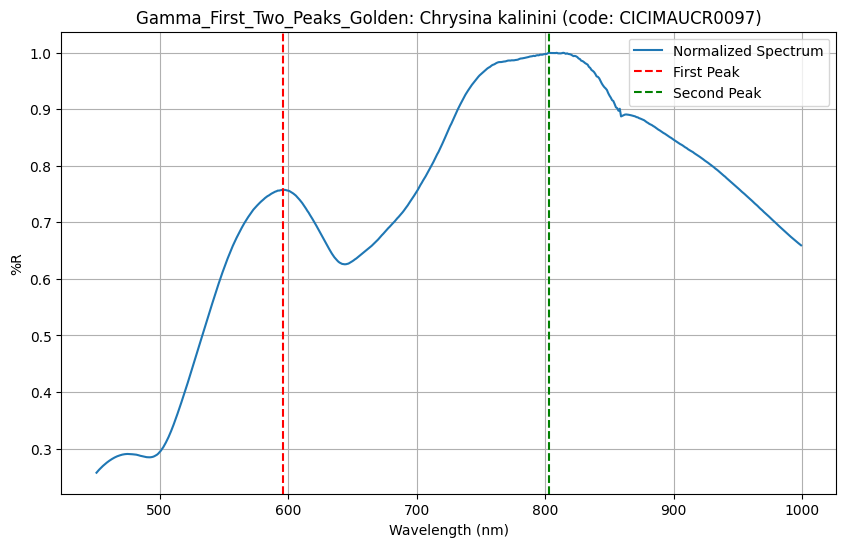

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

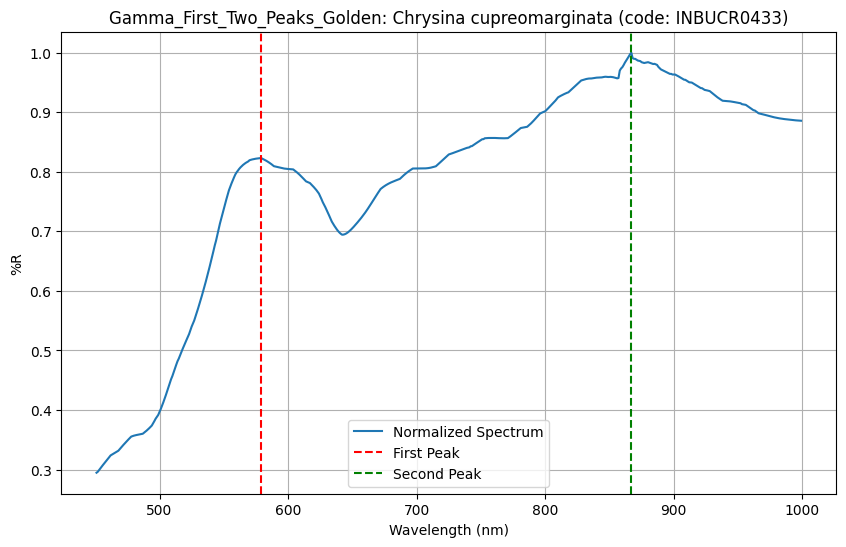

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

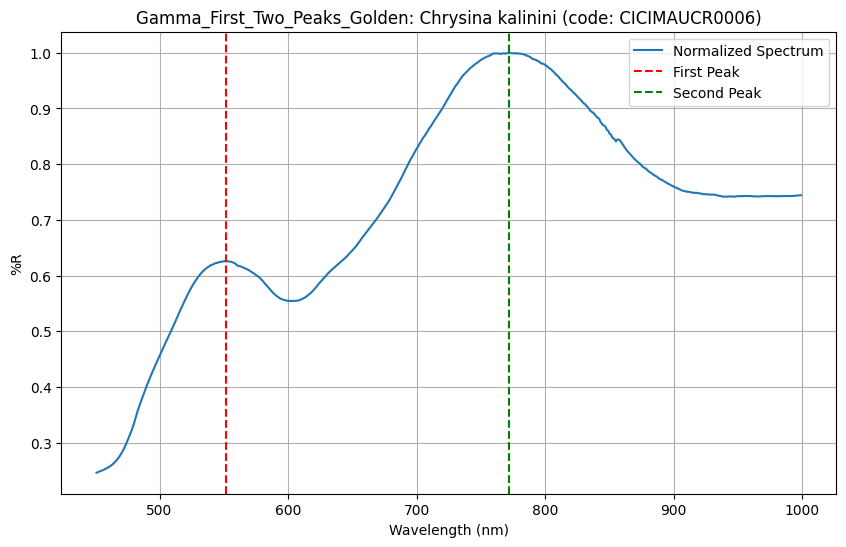

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

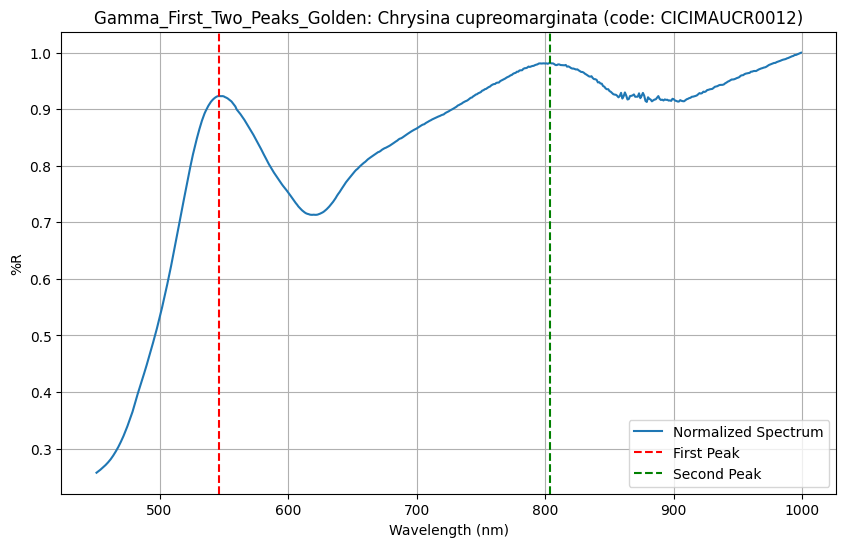

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

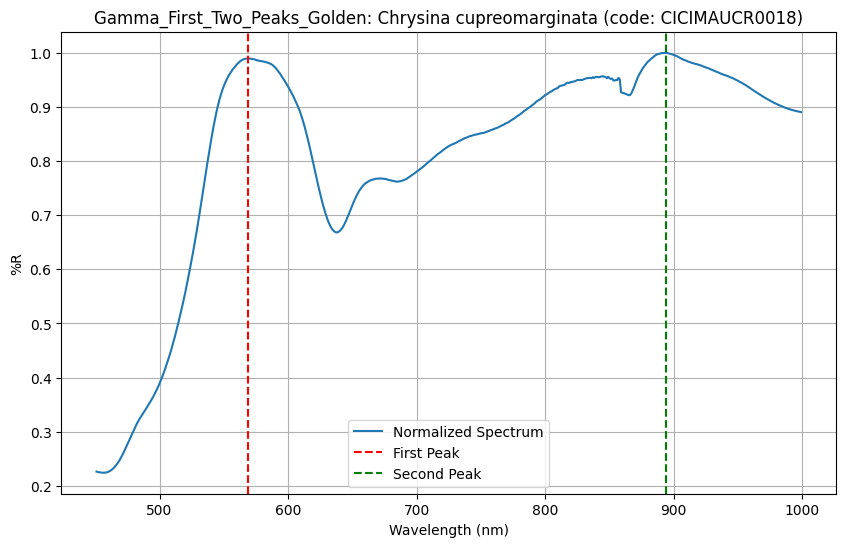

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

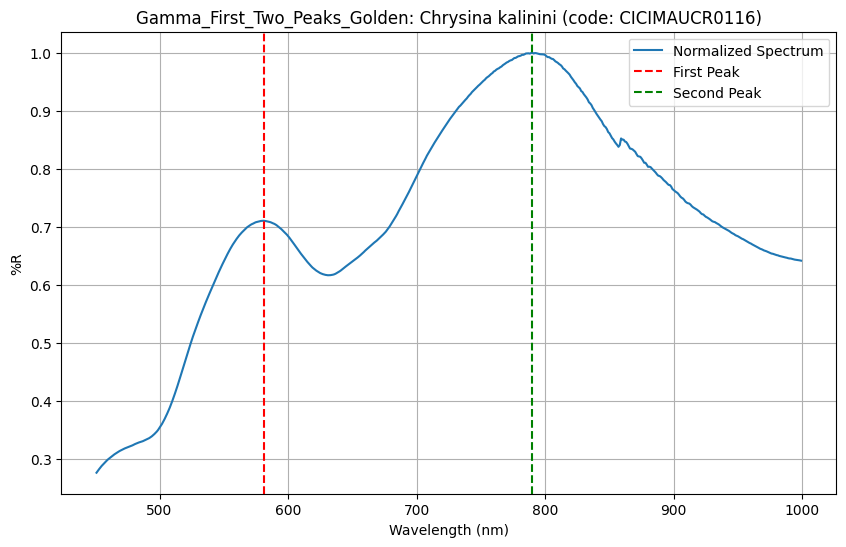

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

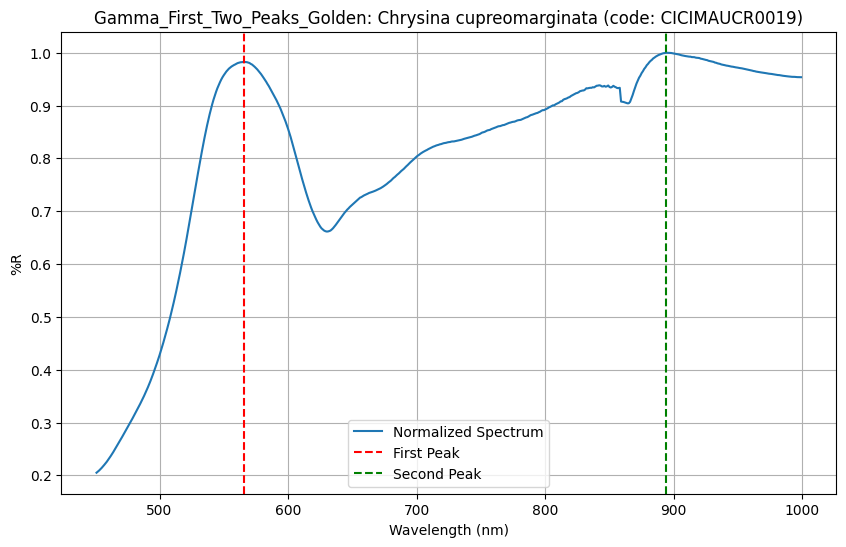

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

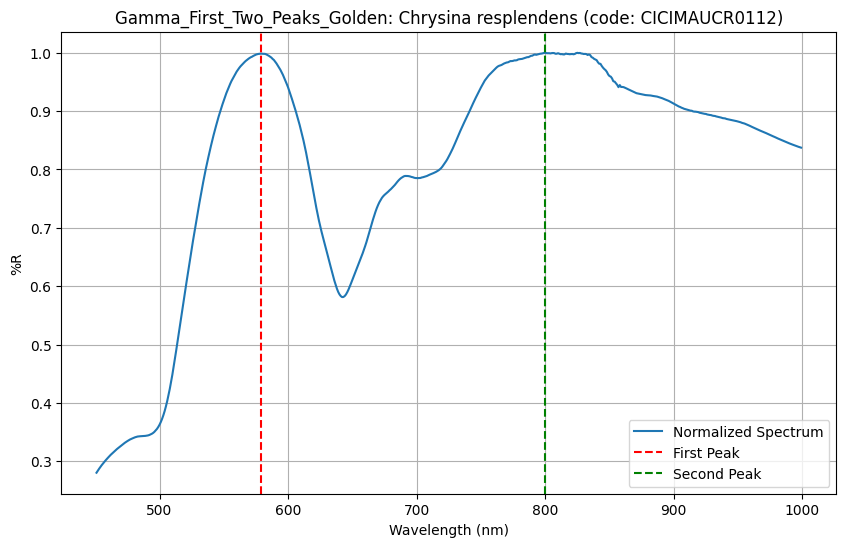

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

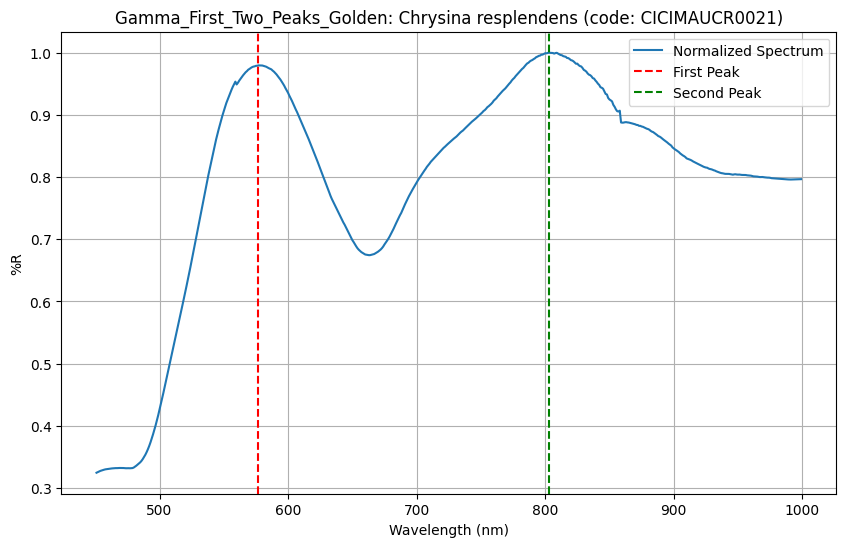

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

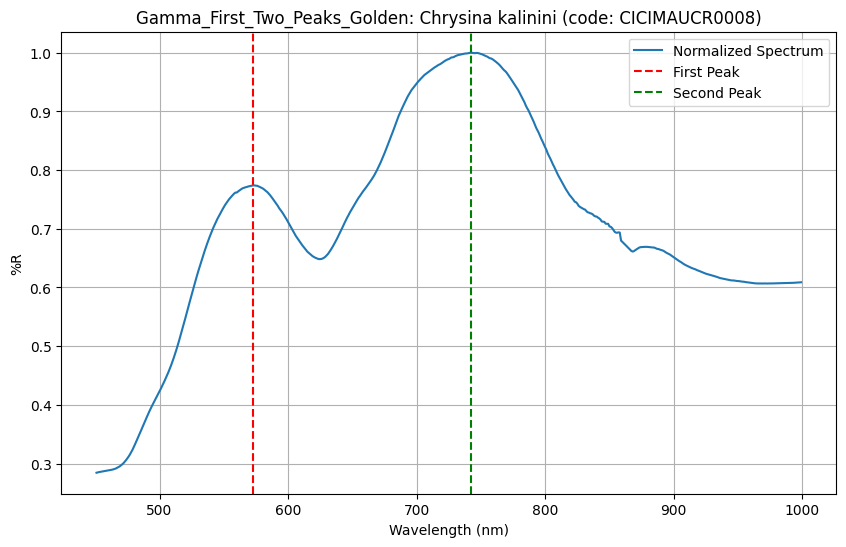

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

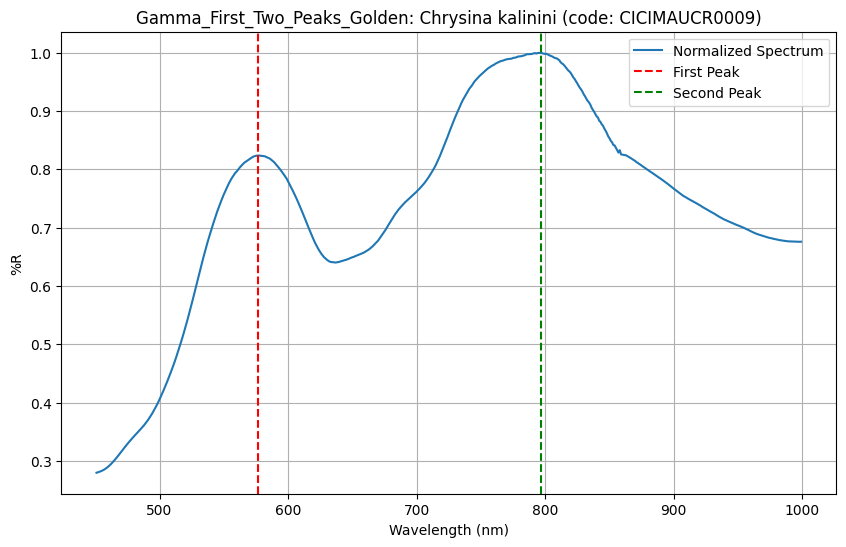

STARTING _load_config
config_file C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
config_file: C:\Users\esteb\escarabajos\libraries\metrics\spectral_config\metrics.ini
Available sections: ['Gamma_First_Two_Peaks', 'Gamma_First_Two_Peaks_Simple', 'Gamma_First_Two_Peaks_Golden', 'Gamma_Arbitrary_Limits_Silver', 'Gamma_Arbitrary_Limits', 'Gamma_Arbitrary_Limits_Golden', 'Gamma_Gaussian_Fit', 'Gamma_Area_Under_Curve_Naive', 'Gamma_Area_Under_Curve_Naive_Golden', 'Gamma_Area_Under_Curve_First_Min_Cut', 'Gamma_Vector_Relative_Reflectance', 'Wavelength_Vector', 'Critical_Points', 'Critical_Points_Golden', 'Minimum_Points', 'Maximum_Points', 'Minimum_Points_Normalized', 'Maximum_Points_Normalized']
Gamma_First_Two_Peaks_Golden cfg <Section: Gamma_First_Two_Peaks_Golden>
self.visible_range_start_wavelength=None
        self.start_wavelength=450.0
        self.start_wavelength=450.0
        self.end_wavelength=1000.0
        self.prominence_threshold_for_min=0.15
       

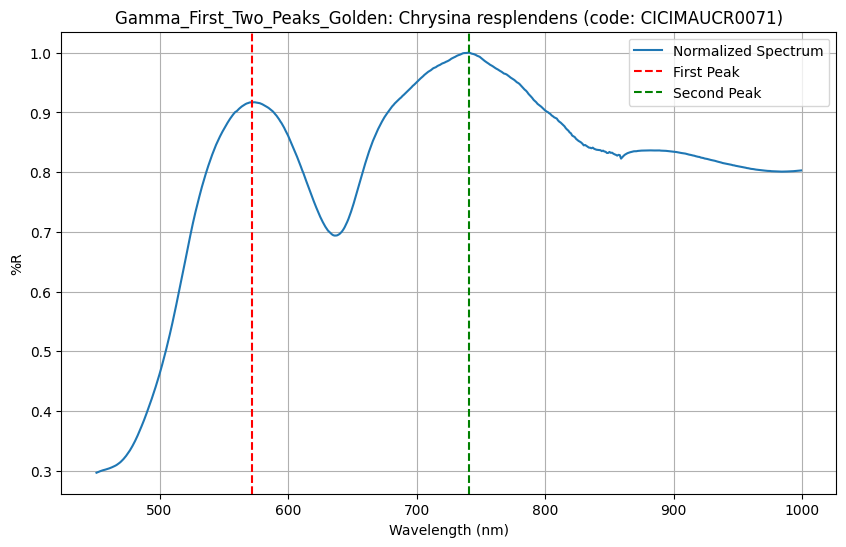

results {'metric': 'Gamma_First_Two_Peaks_Golden', 'train': [('CICIMAUCR0098', np.float64(0.9997946715741182), 'cupreomarginata'), ('CICIMAUCR0014', np.float64(1.2058207872110318), 'cupreomarginata'), ('CICIMAUCR0104', np.float64(1.061263556672878), 'resplendens'), ('CICIMAUCR0002', np.float64(1.3894857926038329), 'kalinini'), ('CICIMAUCR0020', np.float64(1.0285942589874786), 'resplendens'), ('CICIMAUCR0003', np.float64(1.2251516694200988), 'kalinini'), ('CICIMAUCR0015', np.float64(1.0325354216782034), 'resplendens'), ('CICIMAUCR0013', np.float64(0.9971201326836476), 'resplendens'), ('CICIMAUCR0104', np.float64(0.9920349559910941), 'resplendens'), ('CICIMAUCR0105', np.float64(1.2894620099264786), 'kalinini'), ('CICIMAUCR0158', np.float64(0.856289595722265), 'cupreomarginata'), ('CICIMAUCR0141', np.float64(1.2624276598192257), 'kalinini'), ('CICIMAUCR0001', np.float64(1.3470690683438888), 'kalinini'), ('CICIMAUCR0113', np.float64(1.2963532867380805), 'kalinini'), ('CICIMAUCR0101', np.fl

C:\Users\esteb\escarabajos\libraries\metrics.py:742: UserWarning: Gaussian fit failed in range 700.0-900.0 for CICIMAUCR0019 (Chrysina cupreomarginata): Optimal parameters not found: Number of calls to function has reached maxfev = 10000.. Falling back to quadratic approximation.
  warnings.warn(
C:\Users\esteb\escarabajos\libraries\metrics.py:89: UserWarning: Gamma_First_Two_Peaks_Simple: Could not get maxima for CICIMAUCR0098 (Chrysina cupreomarginata): 'Gamma_First_Two_Peaks_Simple' object has no attribute 'height_bottom_threshold_for_maximum'
  warnings.warn(
C:\Users\esteb\escarabajos\libraries\metrics.py:89: UserWarning: Gamma_First_Two_Peaks_Simple: Could not get maxima for CICIMAUCR0014 (Chrysina cupreomarginata): 'Gamma_First_Two_Peaks_Simple' object has no attribute 'height_bottom_threshold_for_maximum'
  warnings.warn(
C:\Users\esteb\escarabajos\libraries\metrics.py:89: UserWarning: Gamma_First_Two_Peaks_Simple: Could not get maxima for CICIMAUCR0104 (Chrysina resplendens): 

In [31]:
from metric_database import MetricDatabase
import os
import pprint

# Initialize database
db_path = os.path.abspath("metrics.sqlite")
db = MetricDatabase(db_path=db_path)
print(f"📂 Using DB at {db_path}")

# List of metrics to test
metrics_to_run = (
                    Gamma_First_Two_Peaks_Golden,
                    Gamma_Arbitrary_Limits_Golden, 
                    Gamma_Area_Under_Curve_Naive_Golden, 
                    Gamma_Area_Under_Curve_First_Min_Cut, 
                    Gamma_Vector_Relative_Reflectance,
                    Wavelength_Vector, 
                    Critical_Points_Golden,
                    Gamma_Gaussian_Fit, 
                    Gamma_First_Two_Peaks_Simple
)

# Run metrics
report, nn_training_bundle = db.add_multiple_metrics(
    metrics_to_run,
    config_file=metric_configuration_file,
    train_spectra=train_spectra,
    test_spectra=test_spectra,
    collection_list=training_collection_list
)

# Pretty print summary
pprint.pprint(report)

print("\n✅ All metrics processed and results saved in the database.")


In [32]:
#print(nn_training_bundle)

In [33]:
import os
import datetime
import pprint
import numpy as np
from reportlab.platypus import SimpleDocTemplate, Paragraph, Spacer, Table, TableStyle
from reportlab.lib.pagesizes import letter
from reportlab.lib.styles import getSampleStyleSheet
from reportlab.lib import colors

# List of species to include dynamically
target_species = ["kalinini", "resplendens", "cupreomarginata"]

# Helper function to convert complex objects to strings
def to_string(obj):
    if isinstance(obj, (np.ndarray, list)):
        return str(obj)
    elif isinstance(obj, (np.int64, np.float64)):
        return str(obj)
    elif isinstance(obj, dict):
        return "\n".join([f"{k}: {to_string(v)}" for k, v in obj.items()])
    elif isinstance(obj, (tuple, list)):
        return str([to_string(item) for item in obj])
    return str(obj)

# Pretty print to console
pprint.pprint(nn_training_bundle)

# Ensure report directory
report_dir = report_location
os.makedirs(report_dir, exist_ok=True)

# File name with today's date
today_str = datetime.date.today().strftime("%Y-%m-%d")
report_filename = f"silvery_beetle_classification_neural_network_{today_str}.pdf"
report_path = os.path.join(report_dir, report_filename)

styles = getSampleStyleSheet()
doc = SimpleDocTemplate(report_path, pagesize=letter)
story = [Paragraph("Golden Beetle Classification Neural Network Report", styles['Title']),
         Spacer(1, 12)]

# Loop over all metrics
for metric, details in nn_training_bundle.items():
    story.append(Paragraph(f"<b>{metric}</b>", styles['Heading2']))
    story.append(Paragraph(to_string(details), styles['Code']))
    story.append(Spacer(1, 12))

    # Aggregated Data
    if "aggregated" in details and details["aggregated"]:
        story.append(Paragraph("Aggregated Data:", styles['Heading3']))
        
        # Header row: "Metric" + all species dynamically
        table_data = [["Metric"] + target_species]
        
        # Add rows
        for key, values in details["aggregated"].items():
            row = [key]
            for sp in target_species:
                row.append(to_string(values.get(sp, "N/A")))
            table_data.append(row)
        
        table = Table(table_data)
        table.setStyle(TableStyle([
            ("BACKGROUND", (0, 0), (-1, 0), colors.grey),
            ("TEXTCOLOR", (0, 0), (-1, 0), colors.whitesmoke),
            ("ALIGN", (0, 0), (-1, -1), "CENTER"),
            ("GRID", (0, 0), (-1, -1), 0.5, colors.black)
        ]))
        story.append(table)
        story.append(Spacer(1, 12))

    # Train/Test datapoints summary
    train_count = len(details.get("train", []))
    test_count = len(details.get("test", []))
    if train_count > 0 or test_count > 0:
        story.append(Paragraph("Datapoints Summary:", styles['Heading3']))
        summary = {"train": train_count, "test": test_count}
        story.append(Paragraph(to_string(summary), styles['Code']))
        story.append(Spacer(1, 12))

    # Recommendation
    if "recommendation" in details and details["recommendation"]:
        story.append(Paragraph("Recommendation:", styles['Heading3']))
        story.append(Paragraph(to_string(details["recommendation"]), styles['Code']))
        story.append(Spacer(1, 12))

# Build PDF
doc.build(story)
print(f"\n✅ Report saved at: {os.path.abspath(report_path)}")


{'Critical_Points_Golden': {'aggregated': {},
                            'metric': 'Critical_Points_Golden',
                            'metric_name': 'Critical_Points_Golden',
                            'recommendation': {'class_distribution': {},
                                               'fit_for_training': False,
                                               'n_classes': 0,
                                               'n_invalid_metrics': np.int64(26),
                                               'n_samples': np.int64(0),
                                               'reason': ['Found 26 invalid '
                                                          '(NaN or infinite) '
                                                          'metric values',
                                                          'Too few valid '
                                                          'samples (0 < 20)',
                                                          'Too few clas

## Neural network training

### One variable approach

#### In this section, for every metric which is fit for training, we separate train data into a train and validation subgroups 
Then, we feed them into a neural network, and train it. Finally, we test the neural network with the test data and finally we return a dataframe
with the stats for each NN, true positives/negatives, false positives/negatives. 

In [34]:
import traceback
import pandas as pd
import numpy as np
import tensorflow as tf
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score
import matplotlib.pyplot as plt
import random

# Ensure Matplotlib backend for JupyterLab to prevent black cells
%matplotlib inline


import numpy as np
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import LabelEncoder

def fit_label_encoder(df, label_col="species"):
    """Fit LabelEncoder on the whole dataset."""
    encoder = LabelEncoder()
    encoder.fit(df[label_col])
    print("Global classes:", encoder.classes_)
    return encoder

def get_x_y(df, encoder):
    """Extract features and labels from DataFrame using a pre-fitted encoder."""
    print("=== get_x_y called ===")
    print("DataFrame shape:", df.shape)
    print("Columns:", list(df.columns))

    x_column_name_lst = [x for x in df.columns if x not in ["code", "species"]]
    if not x_column_name_lst:
        raise ValueError("No feature columns found")
    x_column_name = x_column_name_lst[0]
    print("Selected feature column:", x_column_name)

    # Features
    x = pd.to_numeric(df[x_column_name], errors="coerce").values.astype(np.float32)
    print("First 10 feature values:", x[:10])

    # Labels
    y = encoder.transform(df["species"].values)
    print("First 10 labels (encoded):", y[:10])

    return x, y


def permute_lists(list1, list2):
    """Permute two lists with the same random order."""
    random.seed(42)  # For reproducibility
    permutation_index = list(range(len(list1)))
    random.shuffle(permutation_index)
    permuted_list1 = [list1[i] for i in permutation_index]
    permuted_list2 = [list2[i] for i in permutation_index]
    return permuted_list1, permuted_list2

def partition_lists(list1, list2, train_frac=0.7, val_frac=0.2):
    """Partition two lists into train, validation, and test sets."""
    if train_frac + val_frac >= 1:
        raise ValueError("Sum of train_frac and val_frac must be less than 1")
    if train_frac < 0 or val_frac < 0:
        raise ValueError("Fractions must be positive")
    
    n_total = len(list1)
    n_train = int(n_total * train_frac)
    n_val = int(n_total * val_frac)
    
    train_list1 = list1[:n_train]
    train_list2 = list2[:n_train]
    val_list1 = list1[n_train:n_train + n_val]
    val_list2 = list2[n_train:n_train + n_val]
    test_list1 = list1[n_train + n_val:]
    test_list2 = list2[n_train + n_val:]
    
    return (train_list1, train_list2, val_list1, val_list2, test_list1, test_list2)

def create_model(my_learning_rate, x_train, y_train, hidden_units=[20, 20, 20], dropout_rate=0.2):
    """Create and compile a deep neural net."""
    if np.any(np.isnan(x_train)) or np.any(np.isinf(x_train)):
        raise ValueError("x_train contains NaN or infinite values")
    
    input_shape = (x_train.shape[1],) if len(x_train.shape) > 1 else (1,)
    num_classes = len(np.unique(y_train))
    if num_classes < 2:
        raise ValueError("y_train must contain at least 2 classes.")
    
    model = tf.keras.models.Sequential()
    if len(input_shape) > 1:
        model.add(tf.keras.layers.Flatten(input_shape=input_shape))
    else:
        model.add(tf.keras.layers.Input(shape=input_shape))
    
    for units in hidden_units:
        model.add(tf.keras.layers.Dense(units=units, activation="relu"))
    model.add(tf.keras.layers.Dropout(rate=dropout_rate))
    model.add(tf.keras.layers.Dense(units=num_classes, activation="softmax"))
    
    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=my_learning_rate),
        loss="sparse_categorical_crossentropy",
        metrics=["accuracy"],
    )
    return model

def train_model(model, train_features, train_label, val_features, val_label, epochs, batch_size, encoder=None):
    """Train the model with validation data."""
    if isinstance(train_features, pd.DataFrame):
        train_features = train_features.values
    if isinstance(train_label, (pd.Series, pd.DataFrame)):
        train_label = train_label.values.ravel()
    if isinstance(val_features, pd.DataFrame):
        val_features = val_features.values
    if isinstance(val_label, (pd.Series, pd.DataFrame)):
        val_label = val_label.values.ravel()
    
    if encoder is not None and train_label.dtype.kind in {"U", "S", "O"}:
        train_label = encoder.transform(train_label)
        val_label = encoder.transform(val_label)
    
    train_features = np.array(train_features, dtype=np.float32)
    train_label = np.array(train_label, dtype=np.int32)
    val_features = np.array(val_features, dtype=np.float32)
    val_label = np.array(val_label, dtype=np.int32)
    
    print(f"Training features shape: {train_features.shape}")
    print(f"Training labels shape: {train_label.shape}")
    print(f"Validation features shape: {val_features.shape}")
    print(f"Validation labels shape: {val_label.shape}")
    
    early_stopping = tf.keras.callbacks.EarlyStopping(
        monitor="val_loss",
        patience=10,
        restore_best_weights=True
    )
    
    history = model.fit(
        x=train_features,
        y=train_label,
        validation_data=(val_features, val_label),
        batch_size=batch_size,
        epochs=epochs,
        shuffle=True,
        verbose=1,
        callbacks=[early_stopping]
    )
    
    return history.epoch, pd.DataFrame(history.history)

from sklearn.metrics import classification_report, confusion_matrix

def evaluate_model_old(model, x_test, y_test, encoder, batch_size, labels=None):
    """Evaluate model and return metrics dictionary.
    
    Patches: tolerant of missing labels in y_test.
    """
    # Predict
    y_pred = model.predict(x_test, batch_size=batch_size)
    y_pred = np.argmax(y_pred, axis=1)

    # Always use the full label set from encoder
    all_labels = list(range(len(encoder.classes_))) if labels is None else labels

    # But limit to only those labels actually present in y_test ∪ y_pred
    present_labels = np.unique(np.concatenate([y_test, y_pred]))
    safe_labels = [l for l in all_labels if l in present_labels]

    # Confusion matrix
    cm = confusion_matrix(y_test, y_pred, labels=safe_labels)

    # Classification report
    report = classification_report(
        y_test,
        y_pred,
        labels=safe_labels,
        target_names=[encoder.classes_[i] for i in safe_labels],
        output_dict=True,
        zero_division=0  # avoids NaN when a class has no predictions
    )

    # Extract metrics
    test_loss, test_accuracy = model.evaluate(x_test, y_test, batch_size=batch_size, verbose=0)

    # Pull out TP, TN, FP, FN if binary
    if cm.shape == (2, 2):
        tn, fp, fn, tp = cm.ravel()
    else:
        tn = fp = fn = tp = 0  # multi-class or single-class fallback

    return {
        "test_loss": test_loss,
        "test_accuracy": test_accuracy,
        "true_positives": int(tp),
        "true_negatives": int(tn),
        "false_positives": int(fp),
        "false_negatives": int(fn),
        "precision": report["weighted avg"]["precision"],
        "recall": report["weighted avg"]["recall"],
        "f1_score": report["weighted avg"]["f1-score"]
    }

import numpy as np
import pandas as pd
from sklearn.metrics import classification_report, confusion_matrix

def evaluate_model(model, x_test, y_test, encoder, batch_size, labels=None):
    """Evaluate model and return metrics dictionary.
    
    Patches: tolerant of missing labels in y_test.
    Adds: 'proba_df' key with per-sample softmax probabilities.
    """
    # Predict (keep softmax for the proba table; top-1 for metrics)
    y_proba = model.predict(x_test, batch_size=batch_size)
    # If model is binary with sigmoid output, convert to 2-class proba
    if y_proba.ndim == 1:
        y_proba = np.vstack([1.0 - y_proba, y_proba]).T
    elif y_proba.shape[1] == 1:
        y_proba = np.hstack([1.0 - y_proba, y_proba])
    y_pred = np.argmax(y_proba, axis=1)

    # Always use the full label set from encoder
    all_labels = list(range(len(encoder.classes_))) if labels is None else labels

    # But limit to only those labels actually present in y_test ∪ y_pred
    present_labels = np.unique(np.concatenate([y_test, y_pred])) if len(y_test) else np.unique(y_pred)
    safe_labels = [l for l in all_labels if l in present_labels] or all_labels[:1]

    # Confusion matrix
    cm = confusion_matrix(y_test, y_pred, labels=safe_labels)

    # Classification report
    report = classification_report(
        y_test,
        y_pred,
        labels=safe_labels,
        target_names=[encoder.classes_[i] for i in safe_labels],
        output_dict=True,
        zero_division=0  # avoids NaN when a class has no predictions
    )

    # Extract metrics
    test_loss, test_accuracy = model.evaluate(x_test, y_test, batch_size=batch_size, verbose=0)

    # Pull out TP, TN, FP, FN if binary
    if cm.shape == (2, 2):
        tn, fp, fn, tp = cm.ravel()
    else:
        tn = fp = fn = tp = 0  # multi-class or single-class fallback

    # ---- NEW SECTION: build per-sample probability dataframe (softmax) ----
    class_names = list(encoder.classes_)
    proba_cols = [f"p({cls})" for cls in class_names]
    proba_df = pd.DataFrame(y_proba, columns=proba_cols)
    proba_df.insert(0, "true_label_id", y_test.astype(int))
    proba_df.insert(1, "true_label", encoder.inverse_transform(y_test))
    proba_df["pred_label_id"] = y_pred.astype(int)
    proba_df["pred_label"] = [class_names[i] for i in y_pred]
    proba_df["pred_confidence"] = y_proba[np.arange(len(y_proba)), y_pred]
    proba_df["correct"] = proba_df["true_label_id"] == proba_df["pred_label_id"]
    # ----------------------------------------------------------------------

    return {
        "test_loss": test_loss,
        "test_accuracy": test_accuracy,
        "true_positives": int(tp),
        "true_negatives": int(tn),
        "false_positives": int(fp),
        "false_negatives": int(fn),
        "precision": report["weighted avg"]["precision"],
        "recall": report["weighted avg"]["recall"],
        "f1_score": report["weighted avg"]["f1-score"],
        "proba_df": proba_df,  # <- added here without changing the signature
    }



def plot_curve(epochs, hist, list_of_metrics_to_plot):
    """Plot metrics vs epochs with safety checks."""
    if hist.empty or not epochs:
        print("⚠️ No valid history to plot")
        return
    plt.figure(figsize=(12, 6))
    for m in list_of_metrics_to_plot:
        if m in hist:
            plt.plot(epochs, hist[m], label=m)
        else:
            print(f"⚠️ Warning: metric '{m}' not in history")
    plt.xlabel("Epochs")
    plt.ylabel("Metric Value")
    plt.legend()
    plt.grid(True)
    plt.show()




In [ ]:
debug = True
import numpy as np
import pandas as pd
import traceback
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split

# configurable species list
target_species = ["kalinini", "resplendens", "cupreomarginata"]

def neural_network_training(nn_training_bundle):
    """Train a neural network for a single metric and return statistics."""
    metric = nn_training_bundle["metric_name"]
    train_data = nn_training_bundle["train"]
    test_data = nn_training_bundle["test"]
    recommendation = nn_training_bundle["recommendation"]

    # Early exit if dataset unsuitable
    if not recommendation["fit_for_training"]:
        print(f"❌ Dataset for {metric} unsuitable: {recommendation['reason']}")
        return pd.DataFrame([{
            "metric": metric,
            "fit_for_training": False,
            "reason": recommendation["reason"]
        }]), pd.DataFrame()

    # Convert train/test into DataFrames
    train_df = pd.DataFrame(train_data, columns=["code", "metric", "species"])
    test_df = pd.DataFrame(test_data, columns=["code", "metric", "species"])

    # Join train+test so encoder knows all possible labels
    full_df = pd.concat([train_df, test_df], ignore_index=True)
----
    try:
        if debug:
            print(f"{type(train_df)=}")
            print("train_df.info():")
            print(train_df.info())

        # Fit encoder globally (on all species present)
        encoder = LabelEncoder()
        encoder.fit(full_df["species"])
        print("Global classes:", encoder.classes_)

        # Transform train/test using same encoder
        x_train_full, y_train_full = get_x_y(train_df, encoder=encoder)
        x_test, y_test = get_x_y(test_df, encoder=encoder)

    except Exception as e:
        traceback.print_exc()
        print(f"❌ Failed to extract features/labels for {metric}: {e}")
        return pd.DataFrame([{
            "metric": metric,
            "fit_for_training": False,
            "reason": str(e)
        }]), pd.DataFrame()

    # Stratified train/validation split (from training set only)
    try:
        x_train, x_val, y_train, y_val = train_test_split(
            x_train_full, y_train_full,
            test_size=0.2,
            stratify=y_train_full if len(np.unique(y_train_full)) > 1 else None,
            random_state=42
        )

        # Convert to numpy arrays with consistent dtypes
        x_train, y_train = np.array(x_train, np.float32), np.array(y_train, np.int32)
        x_val, y_val = np.array(x_val, np.float32), np.array(y_val, np.int32)
        x_test, y_test = np.array(x_test, np.float32), np.array(y_test, np.int32)

        if debug:
            print(f"Training features shape: {x_train.shape}")
            print(f"Validation features shape: {x_val.shape}")
            print(f"Test features shape: {x_test.shape}")

    except Exception as e:
        print(f"❌ Failed to split data for {metric}: {e}")
        return pd.DataFrame([{
            "metric": metric,
            "fit_for_training": False,
            "reason": str(e)
        }]), pd.DataFrame()

    # Hyperparameters
    learning_rate = 0.008
    epochs = 200
    batch_size = 32
    list_of_metrics_to_plot = ["accuracy", "val_accuracy", "loss", "val_loss"]

    # Train model
    try:
        print(f"Training model for {metric}...")
        model = create_model(learning_rate, x_train, y_train)
        epochs_run, hist = train_model(
            model, x_train, y_train, x_val, y_val,
            epochs, batch_size, encoder
        )
        print(f"✅ Training completed for {metric}.")
    except Exception as e:
        print(f"❌ Training failed for {metric}: {e}")
        traceback.print_exc()
        return pd.DataFrame([{
            "metric": metric,
            "fit_for_training": False,
            "reason": str(e)
        }]), pd.DataFrame()

    # Plot curves (optional)
    try:
        plot_curve(epochs_run, hist, list_of_metrics_to_plot)
    except Exception as e:
        print(f"⚠️ Plotting failed for {metric}: {e}")
        traceback.print_exc()

    # Evaluate model
    try:
        print(f"Evaluating model for {metric}...")
        metrics = evaluate_model(model, x_test, y_test, encoder, batch_size)
        print(
            f"✅ Test metrics for {metric}: "
            f"Loss={metrics['test_loss']:.4f}, Accuracy={metrics['test_accuracy']:.4f}"
        )

        # Build probability dataframe
        proba_df = metrics["proba_df"].copy()
        proba_df.insert(0, "code", test_df["code"].values)

        # Rename probability columns dynamically
        proba_df = proba_df.rename(columns={
            f"p({cls})": f"probability_{cls}" for cls in encoder.classes_
        })

        # Build comparison columns dynamically
        comparison_cols = ["code", "true_label", "pred_label"]
        for sp in target_species:
            col = f"probability_{sp}"
            if col in proba_df.columns:
                comparison_cols.append(col)

        comparison = proba_df[comparison_cols]

        print("\nComparison table:")
        print(comparison.to_string(index=False))

        # Keep metrics dict without proba_df
        metrics_filtered = {k: v for k, v in metrics.items() if k != "proba_df"}
        metrics_df = pd.DataFrame([metrics_filtered])

        return metrics_df, proba_df

    except Exception as e:
        print(f"❌ Evaluation failed for {metric}: {e}")
        traceback.print_exc()
        metrics = {
            "metric": metric,
            "test_loss": np.nan,
            "test_accuracy": np.nan,
            "true_positives": 0,
            "true_negatives": 0,
            "false_positives": 0,
            "false_negatives": 0,
            "precision": np.nan,
            "recall": np.nan,
            "f1_score": np.nan
        }
        return pd.DataFrame([metrics]), pd.DataFrame()




Metric: Gamma_First_Two_Peaks_Golden
type(train_df)=<class 'pandas.core.frame.DataFrame'>
train_df.info():
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26 entries, 0 to 25
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   code     26 non-null     object 
 1   metric   26 non-null     float64
 2   species  26 non-null     object 
dtypes: float64(1), object(2)
memory usage: 756.0+ bytes
None
Global classes: ['cupreomarginata' 'kalinini' 'resplendens']
=== get_x_y called ===
DataFrame shape: (26, 3)
Columns: ['code', 'metric', 'species']
Selected feature column: metric
First 10 feature values: [0.99979466 1.2058208  1.0612636  1.3894858  1.0285943  1.2251517
 1.0325354  0.99712014 0.992035   1.289462  ]
First 10 labels (encoded): [0 0 2 1 2 1 2 2 2 1]
=== get_x_y called ===
DataFrame shape: (7, 3)
Columns: ['code', 'metric', 'species']
Selected feature column: metric
First 10 feature values: [      nan 1.017764  1.00149

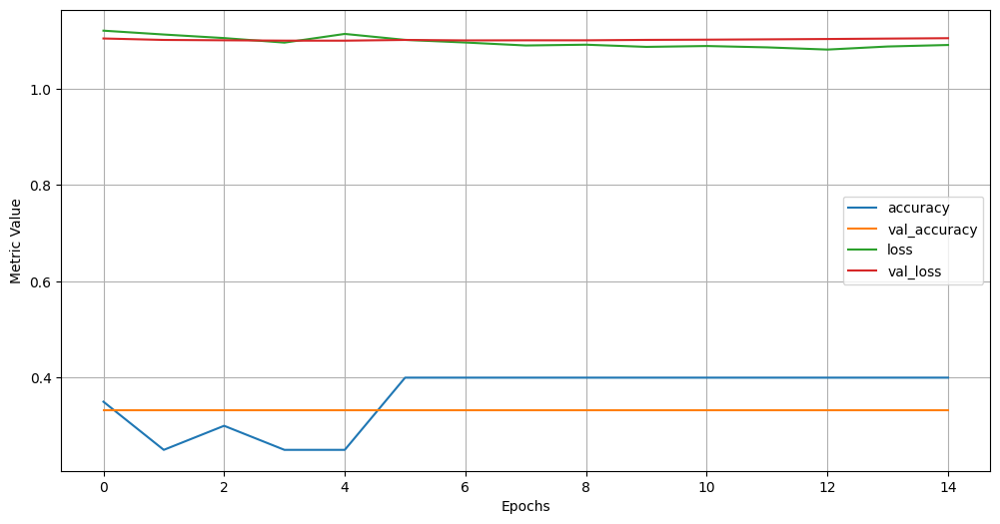

Evaluating model for Gamma_First_Two_Peaks_Golden...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
✅ Test metrics for Gamma_First_Two_Peaks_Golden: Loss=1.1105, Accuracy=0.2857

Comparison table:
         code      true_label pred_label  probability_kalinini  probability_resplendens  probability_cupreomarginata
   INBUCR0426     resplendens   kalinini              0.355899                 0.320990                     0.323110
CICIMAUCR0019 cupreomarginata   kalinini              0.355902                 0.316177                     0.327921
CICIMAUCR0112     resplendens   kalinini              0.355925                 0.316170                     0.327906
CICIMAUCR0021     resplendens   kalinini              0.355898                 0.316179                     0.327923
CICIMAUCR0008        kalinini   kalinini              0.355521                 0.316305                     0.328174
CICIMAUCR0009        kalinini   kalinini              0.355629                 0.316269                     0.

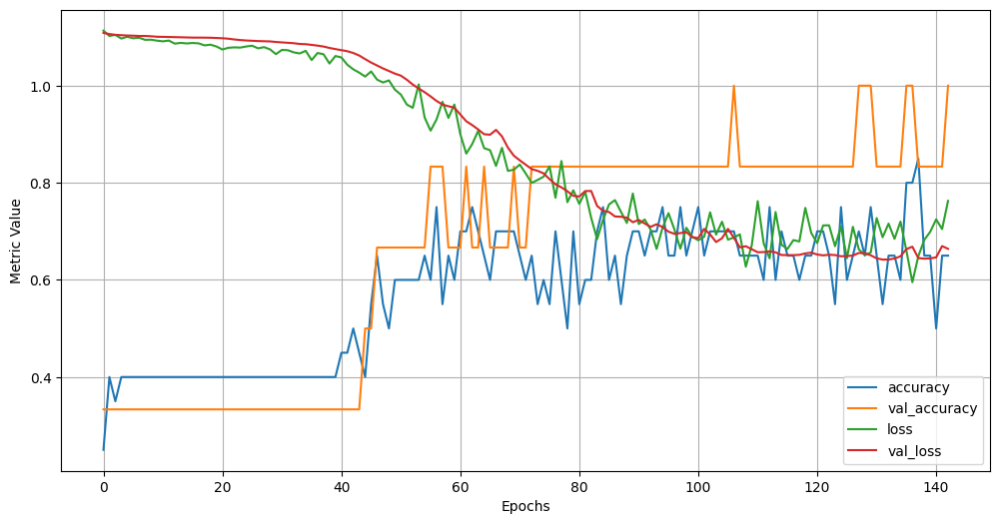

Evaluating model for Gamma_Arbitrary_Limits_Golden...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
✅ Test metrics for Gamma_Arbitrary_Limits_Golden: Loss=1.2170, Accuracy=0.5714

Comparison table:
         code      true_label      pred_label  probability_kalinini  probability_resplendens  probability_cupreomarginata
   INBUCR0426     resplendens        kalinini              0.820159                 0.078210                     0.101631
CICIMAUCR0019 cupreomarginata     resplendens              0.006305                 0.512451                     0.481244
CICIMAUCR0112     resplendens     resplendens              0.001770                 0.528547                     0.469683
CICIMAUCR0021     resplendens     resplendens              0.003142                 0.521627                     0.475231
CICIMAUCR0008        kalinini cupreomarginata              0.072462                 0.424809                     0.502729
CICIMAUCR0009        kalinini        kalinini              0.512408           

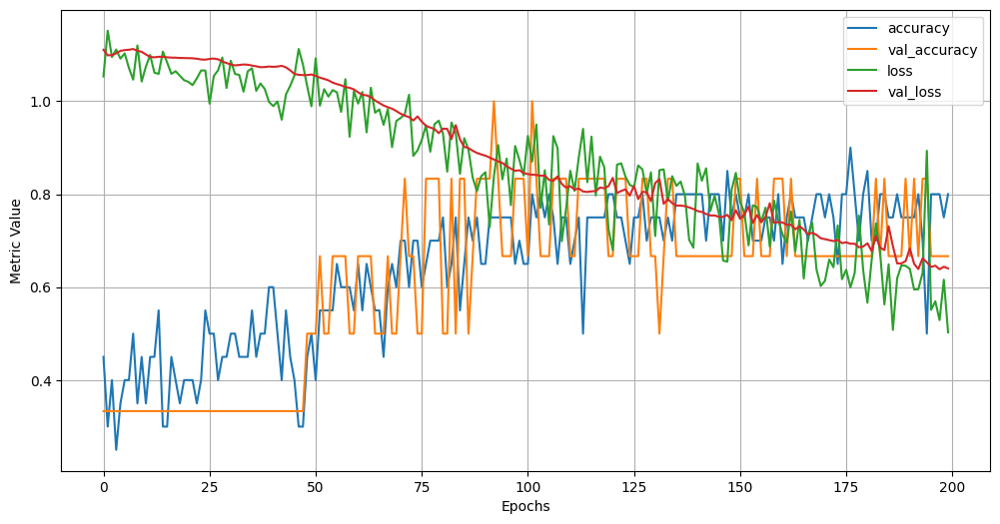

Evaluating model for Gamma_Area_Under_Curve_Naive_Golden...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
✅ Test metrics for Gamma_Area_Under_Curve_Naive_Golden: Loss=1.0864, Accuracy=0.5714

Comparison table:
         code      true_label      pred_label  probability_kalinini  probability_resplendens  probability_cupreomarginata
   INBUCR0426     resplendens     resplendens              0.314334                 0.684523                     0.001143
CICIMAUCR0019 cupreomarginata cupreomarginata              0.094221                 0.320915                     0.584863
CICIMAUCR0112     resplendens cupreomarginata              0.053792                 0.404101                     0.542107
CICIMAUCR0021     resplendens     resplendens              0.001180                 0.803607                     0.195213
CICIMAUCR0008        kalinini cupreomarginata              0.039759                 0.447173                     0.513068
CICIMAUCR0009        kalinini cupreomarginata              0.18086

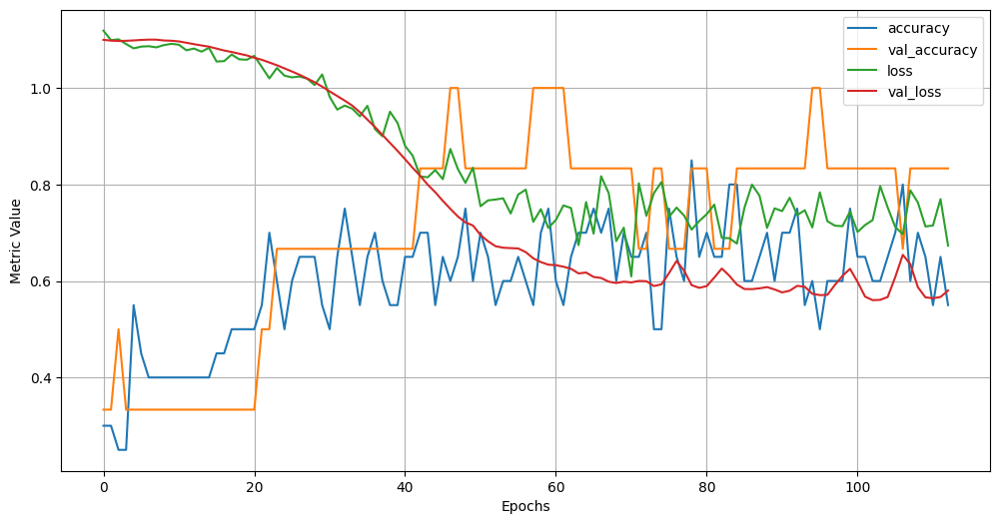

Evaluating model for Gamma_Gaussian_Fit...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
✅ Test metrics for Gamma_Gaussian_Fit: Loss=0.5326, Accuracy=0.7143

Comparison table:
         code      true_label      pred_label  probability_kalinini  probability_resplendens  probability_cupreomarginata
   INBUCR0426     resplendens     resplendens          5.424369e-31                 0.879300                     0.120700
CICIMAUCR0019 cupreomarginata     resplendens          3.135704e-07                 0.598173                     0.401827
CICIMAUCR0112     resplendens     resplendens          4.251797e-03                 0.528262                     0.467486
CICIMAUCR0021     resplendens     resplendens          7.688361e-03                 0.519323                     0.472989
CICIMAUCR0008        kalinini        kalinini          7.545534e-01                 0.099450                     0.145997
CICIMAUCR0009        kalinini        kalinini          7.319464e-01                 0.110513        

,test_loss,test_accuracy,true_positives,true_negatives,false_positives,false_negatives,precision,recall,f1_score
3,0.532623,0.714286,0,0,0,0,0.714286,0.714286,0.714286
1,1.217028,0.571429,0,0,0,0,0.571429,0.571429,0.571429
2,1.086352,0.571429,0,0,0,0,0.607143,0.571429,0.546939
0,1.110520,0.285714,0,0,0,0,0.081633,0.285714,0.126984


In [36]:
import pandas as pd
debug = True
def run_all_metrics(nn_training_bundle, debug=False):
    """Run training only for metrics marked fit_for_training and return a summary DataFrame."""
    results = []
    skipped = []

    for metric, bundle in nn_training_bundle.items():
        rec = bundle.get("recommendation", {})
        ok = bool(rec.get("fit_for_training", False))

        if not ok:
            skipped.append((metric, rec.get("reason", "No reason provided")))
            if debug:
                print(f"⏭️ Skipping {metric}: {rec.get('reason', 'No reason provided')}")
            continue

        print(f"\n\nMetric: {metric}")
        try:
            metrics, stats_df = neural_network_training(bundle)  # your function from above
            print("metrics", metrics)
            if not metrics.empty:
                results.append(metrics)
        except Exception as e:
            print(f"❌ Failed on {metric}: {e}")
            traceback.print_exc()

    # Build final comparison table
    if results:
        # Merge all results into a single DataFrame
        final_df = pd.concat(results, ignore_index=True)
    
        # Sort by test_accuracy (then f1_score), best first
        final_df = final_df.sort_values(
            by=["test_accuracy", "f1_score"],
            ascending=[False, False],
            na_position="last"
        )
    
        print("\n=== Final comparison ===")
        print(final_df.to_string(index=False))
    else:
        # Empty schema to keep downstream code happy
        final_df = pd.DataFrame(columns=[
            "metric","fit_for_training","reason","test_loss","test_accuracy",
            "true_positives","true_negatives","false_positives","false_negatives",
            "precision","recall","f1_score"
        ])

    if debug and skipped:
        print("\nSkipped metrics (not fit for training):")
        for m, r in skipped:
            print(f" - {m}: {r}")

    return final_df

run_all_metrics(nn_training_bundle, debug=True)

In [37]:
import sys

print(sys.version_info)

#@title Import relevant modules

from tensorflow.keras import layers


# The following lines adjust the granularity of reporting. 
pd.options.display.max_rows = 10
pd.options.display.float_format = "{:.1f}".format

# The following line improves formatting when ouputting NumPy arrays.
np.set_printoptions(linewidth = 200)

sys.version_info(major=3, minor=12, micro=7, releaselevel='final', serial=0)


## Prediction vectorial features

In [38]:
import numpy as np
print(list(gamma_vector_relative_reflectance_data[1]))
gamma_vector_relative_reflectance_data_np = np.array(gamma_vector_relative_reflectance_data[1])
gamma_vector_relative_reflectance_data_np

[array([1.       , 0.9915433]), array([1.        , 1.20582079]), array([1.]), array([1.]), array([1.]), array([1.]), array([1.]), array([1.       , 0.8717066]), array([1.]), array([1.]), array([1.]), array([1.]), array([1.]), array([1.]), array([1.        , 0.70593762]), array([1.]), array([1.      , 1.061321]), array([1.        , 1.39096383]), array([1.]), array([1.]), array([1.]), array([1.]), array([1.]), array([1.]), array([1.        , 1.01064119]), array([1.])]


ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 1 dimensions. The detected shape was (26,) + inhomogeneous part.

In [ ]:
#gvrrd_df = pd.DataFrame(transpose_list(gamma_vector_relative_reflectance_data), columns =["code", "g_arbitrary_limits", "species"])
gvrrd_df = pd.DataFrame(transpose_list(gamma_vector_relative_reflectance_data), columns =["code", "g_arbitrary_limits", "species"])
gvrrd_df


In [ ]:
def get_x_y(df):
    columns = df.columns
    x_column_name = [x for x in columns if x not in ["code", "species"]]
    x = df[x_column_name].values
    x2 = []
    for element in x:
        xp = str(element).replace("[array(", "").replace(")]", "")
        ev = eval(xp)
        x2.append(ev)
    x2 = np.array(x2)
    
    y = df["species"].values
    y= replace_strings(y)
    y= np.array(y)
    #print(y)
    #print(df.dtypes)
    return x2, y

x,y_p = get_x_y(gvrrd_df)


In [ ]:
x_train, y_train,x_test, y_test  = get_training_and_test_data(x, y_p, 0.4)

In [ ]:
x_train[0]


In [ ]:
def create_model_2(my_learning_rate):
  """Create and compile a deep neural net."""
  
  # All models in this course are sequential.
  model = tf.keras.models.Sequential()

  # The features are stored in a two-dimensional 28X28 array. 
  # Flatten that two-dimensional array into a one-dimensional 
  # 784-element array.
  model.add(tf.keras.layers.Flatten(input_shape=(9,)))

  # Define the first hidden layer.   
  model.add(tf.keras.layers.Dense(units=40, activation='relu'))

  # Define the first hidden layer.   
  model.add(tf.keras.layers.Dense(units=20, activation='relu'))

  # Define the first hidden layer.   
  #model.add(tf.keras.layers.Dense(units=20, activation='relu'))
  
  # Define a dropout regularization layer. 
  model.add(tf.keras.layers.Dropout(rate=0.4))

  # Define the output layer. The units parameter is set to 10 because
  # the model must choose among 10 possible output values (representing
  # the digits from 0 to 9, inclusive).
  #
  # Don't change this layer.
  model.add(tf.keras.layers.Dense(units=3, activation='softmax'))     
                           
  # Construct the layers into a model that TensorFlow can execute.  
  # Notice that the loss function for multi-class classification
  # is different than the loss function for binary classification.  
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=my_learning_rate),
                loss="sparse_categorical_crossentropy",
                metrics=['accuracy'])
  
  return model    


def train_model(model, train_features, train_label, epochs,
                batch_size=None, validation_split=0.1):
  """Train the model by feeding it data."""

  history = model.fit(x=train_features, y=train_label, batch_size=batch_size,
                      epochs=epochs, shuffle=True,
                      validation_split=validation_split)
 
  # To track the progression of training, gather a snapshot
  # of the model's metrics at each epoch. 
  epochs = history.epoch
  hist = pd.DataFrame(history.history)

  return epochs, hist    

In [ ]:
# The following variables are the hyperparameters.
learning_rate = 0.003
epochs = 150
batch_size = 1
validation_split = 0.0

# Establish the model's topography.
my_model = create_model_2(learning_rate)

# Train the model on the normalized training set.
epochs, hist = train_model(my_model, x_train, y_train, 
                           #epochs, batch_size, validation_split)
#epochs, hist = train_model(my_model, x_train, y_train, 
                           epochs, batch_size)

# Plot a graph of the metric vs. epochs.
list_of_metrics_to_plot = ['accuracy']
plot_curve(epochs, hist, list_of_metrics_to_plot)

# Evaluate against the test set.
print("\n Evaluate the new model against the test set:")
my_model.evaluate(x=x_test, y=y_test, batch_size=batch_size)

#amplitud en IR vs amplitud en el visible
#700 nm
visible horizontal, IR vertical. 
#gamma vertical, amplitud pico IR horizontal 
#y es amplitud en el IR, x es el gamma

## Prediction 2 variables

In [ ]:
#@title Import relevant modules
import numpy as np
import pandas as pd
import tensorflow as tf
from matplotlib import pyplot as plt
import seaborn as sns

# The following lines adjust the granularity of reporting.
pd.options.display.max_rows = 10
pd.options.display.float_format = "{:.1f}".format

print("Imported modules.")

#first scenario Gamma_First_Two_Peaks_Golden and gamma_area_under_curve_first_minimum
#Definicion de las variables
gal_df 
gftp_df 
gaucfmc_df 
gauc_df 


In [ ]:
#define the dataframe

complete_df = pd.merge(gal_df, gftp_df, on=["species","code"], how="inner")
complete_df = pd.merge(complete_df, gaucfmc_df, on=["species","code"], how="inner")
complete_df = pd.merge(complete_df, gauc_df, on=["species","code"], how="inner")
complete_df.drop(columns=['code'], inplace=True)

fraction = 0.8

def substitute_species(df):
    df.loc[df["species"] == "kalinini"] = -100.0
    df.loc[df["species"] == "resplendens"] = 0.0
    df.loc[df["species"] == "cupreomarginata"] = 100.0
    return df 

complete_df = substitute_species(complete_df)


def split_train_test(df, fraction):
    # Shuffle the DataFrame
    shuffled_df = df.sample(frac=1, random_state=0)
    
    # Calculate the number of rows for the training set
    train_size = int(fraction * len(df))
    
    # Split the DataFrame
    train_df = shuffled_df[:train_size]
    test_df = shuffled_df[train_size:]
    
    return train_df, test_df
    
train_df, test_df =split_train_test(complete_df, fraction)
#print(complete_df)
#print(train_df)
#print(test_df)

In [ ]:
# Keras Input tensors of float values.
inputs = {
    'g_arbitrary_limits':
        tf.keras.layers.Input(shape=(1,), dtype=tf.float32,
                              name='g_arbitrary_limits '),
    'g_first_2_peaks':
        tf.keras.layers.Input(shape=(1,), dtype=tf.float32,
                              name='g_first_2_peaks'),
    'g_area_und_curve_first_min':
        tf.keras.layers.Input(shape=(1,), dtype=tf.float32,
                              name='g_area_und_curve_first_min'),
    'g_area_und_curve':
        tf.keras.layers.Input(shape=(1,), dtype=tf.float32,
                              name='g_area_und_curve')
}

# Create a Normalization layer to normalize the median_income data.
g_area_und_curve_first_min = tf.keras.layers.Normalization(
    name='normalization_g_area_und_curve_first_min',
    axis=None)
g_area_und_curve_first_min.adapt(train_df['g_area_und_curve_first_min'])
g_area_und_curve_first_min = g_area_und_curve_first_min(inputs.get('g_area_und_curve_first_min'))

# Create a Normalization layer to normalize the population data.
g_area_und_curve = tf.keras.layers.Normalization(
    name='normalization_g_area_und_curve',
    axis=None)
g_area_und_curve.adapt(train_df['g_area_und_curve_first_min'])
g_area_und_curve = g_area_und_curve(inputs.get('g_area_und_curve'))


# Create a Normalization layer to normalize the latitude data.
g_arbitrary_limits = tf.keras.layers.Normalization(
    name='normalization_g_arbitrary_limits',
    axis=None)
g_arbitrary_limits.adapt(train_df['g_arbitrary_limits'])
g_arbitrary_limits = g_arbitrary_limits(inputs.get('g_arbitrary_limits'))


# Create a Normalization layer to normalize the longitude data.
g_first_2_peaks = tf.keras.layers.Normalization(
    name='normalization_g_first_2_peaks',
    axis=None)
g_first_2_peaks.adapt(train_df['g_first_2_peaks'])
g_first_2_peaks = g_first_2_peaks(inputs.get('g_first_2_peaks'))

# Concatenate our inputs into a single tensor.
preprocessing_layers = tf.keras.layers.Concatenate()(
    [g_arbitrary_limits, g_first_2_peaks, g_area_und_curve, g_area_und_curve_first_min])

print("Preprocessing layers defined.")

In [ ]:


def plot_the_loss_curve(epochs, mse_training, mse_validation):
  """Plot a curve of loss vs. epoch."""

  plt.figure()
  plt.xlabel("Epoch")
  plt.ylabel("Mean Squared Error")

  plt.plot(epochs, mse_training, label="Training Loss")
  plt.plot(epochs, mse_validation, label="Validation Loss")

  # mse_training is a pandas Series, so convert it to a list first.
  merged_mse_lists = mse_training.tolist() + mse_validation
  highest_loss = max(merged_mse_lists)
  lowest_loss = min(merged_mse_lists)
  top_of_y_axis = highest_loss * 1.03
  bottom_of_y_axis = lowest_loss * 0.97

  plt.ylim([bottom_of_y_axis, top_of_y_axis])
  plt.legend()
  plt.show()

print("Defined the plot_the_loss_curve function.")

In [ ]:
from tensorflow import Tensor

In [ ]:
#@title Define functions to create and train a linear regression model
def create_model(my_inputs, my_outputs, my_learning_rate):
  """Create and compile a simple linear regression model."""
  model = tf.keras.Model(inputs=my_inputs, outputs=my_outputs)

  # Construct the layers into a model that TensorFlow can execute.
  model.compile(optimizer=tf.keras.optimizers.Adam(
      learning_rate=my_learning_rate),
      loss="mean_squared_error",
      metrics=[tf.keras.metrics.MeanSquaredError()])

  return model


def train_model(model, dataset, epochs, batch_size, label_name, validation_split=0.1):
  """Feed a dataset into the model in order to train it."""

  # Split the dataset into features and label.
  features = {name:np.array(value) for name, value in dataset.items()}
  print(features)
 
  #Considering y variable holds numpy array
  train_features_tensor = tf.convert_to_tensor(np.array(features.pop(label_name)), dtype=tf.int64) 
  label = train_median_house_value_normalized(train_features_tensor)

  for element in features:
      features[element] =  tf.convert_to_tensor(np.array(features[element]), dtype=tf.int64) 
      
  print(f"{label=}")
  history = model.fit(x=features, y=label, batch_size=batch_size,
                      epochs=epochs, shuffle=True, validation_split=validation_split)

  # Get details that will be useful for plotting the loss curve.
  epochs = history.epoch
  hist = pd.DataFrame(history.history)
  mse = hist["mean_squared_error"]

  return epochs, mse, history.history

print("Defined the create_model and train_model functions.")

In [ ]:
train_df.fillna(value='', inplace=True)
test_df.fillna(value='', inplace=True)

x_train = np.asarray(train_df['species']).astype('float32')
x_test = np.asarray(test_df['species']).astype('float32')

x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
#@title Define normalized label columns
# Create Normalization layers to normalize the median_house_value data.
# Because median_house_value is our label (i.e., the target value we're
# predicting), these layers won't be added to our model.
train_median_house_value_normalized = tf.keras.layers.Normalization(axis=None)
train_median_house_value_normalized.adapt(x_train)
print(train_median_house_value_normalized)

test_median_house_value_normalized = tf.keras.layers.Normalization(axis=None)
test_median_house_value_normalized.adapt(x_test)
print(test_median_house_value_normalized)

In [ ]:
#@title Define linear regression model outputs
def get_outputs_linear_regression():
  # Create the Dense output layer.
  dense_output = tf.keras.layers.Dense(units=1,
                              name='dense_output')(preprocessing_layers)

  # Define an output dictionary we'll send to the model constructor.
  outputs = {
    'dense_output': dense_output
  }
  return outputs

In [ ]:
# The following variables are the hyperparameters.
learning_rate = 0.01
epochs = 15
batch_size = 1000
label_name = "species"

# Split the original training set into a reduced training set and a
# validation set.
validation_split = 0.2

outputs = get_outputs_linear_regression()

# Establish the model's topography.
my_model = create_model(inputs, outputs, learning_rate)

# Train the model on the normalized training set.
epochs, mse, history = train_model(my_model, train_df, epochs, batch_size,
                          label_name, validation_split)
plot_the_loss_curve(epochs, mse, history["val_mean_squared_error"])

test_features = {name:np.array(value) for name, value in test_df.items()}

test_features_tensor = tf.convert_to_tensor(np.array(test_features.pop(label_name)), dtype=tf.int64) 

test_label = test_median_house_value_normalized(test_features_tensor) # isolate the label
print("\n Evaluate the linear regression model against the test set:")
my_model.evaluate(x = test_features, y = test_label, batch_size=batch_size, return_dict=True)

In [ ]:
def get_outputs_dnn():
  # Create a Dense layer with 20 nodes.
  dense_output = tf.keras.layers.Dense(units=20,
                              activation='relu',
                              name='hidden_dense_layer_1')(preprocessing_layers)
  # Create a Dense layer with 12 nodes.
  dense_output = tf.keras.layers.Dense(units=12,
                              activation='relu',
                              name='hidden_dense_layer_2')(dense_output)
  # Create the Dense output layer.
  dense_output = tf.keras.layers.Dense(units=1,
                              name='dense_output')(dense_output)

  # Define an output dictionary we'll send to the model constructor.
  outputs = {
    'dense_output': dense_output
  }

  return outputs

In [ ]:
# The following variables are the hyperparameters.
learning_rate = 0.01
epochs = 20
batch_size = 1000

# Specify the label
label_name = "species"

# Split the original training set into a reduced training set and a
# validation set.
validation_split = 0.2

dnn_outputs = get_outputs_dnn()

# Establish the model's topography.
my_model = create_model(
    inputs,
    dnn_outputs,
    learning_rate)

# Train the model on the normalized training set. We're passing the entire
# normalized training set, but the model will only use the features
# defined in our inputs.
epochs, mse, history = train_model(my_model, train_df, epochs,
                                   batch_size, label_name, validation_split)
plot_the_loss_curve(epochs, mse, history["val_mean_squared_error"])

# After building a model against the training set, test that model
# against the test set.
test_features = {name:np.array(value) for name, value in test_df.items()}

train_features_tensor = tf.convert_to_tensor(np.array(test_features.pop(label_name)), dtype=tf.int64) 

test_label = test_median_house_value_normalized(train_features_tensor) # isolate the label

print("\n Evaluate the new model against the test set:")
my_model.evaluate(x = test_features, y = test_label, batch_size=batch_size, return_dict=True)

In [ ]:
#Save model 

# Define the file path where you want to save your model
model_file_path = 'trained_model.h5'

# Save the model
my_model.save(model_file_path)

print("Model saved successfully at:", model_file_path)

In [ ]:
# Load the saved model
model_file_path = 'trained_model.h5'
loaded_model = tf.keras.models.load_model(model_file_path)

#load prediction data
#test_spectra

prediction_gamma_arbitrary_limits_data = feature_and_label_extractor(Gamma_Arbitrary_Limits_Golden, test_spectra)
prediction_gamma_first_two_peaks_data = feature_and_label_extractor(Gamma_First_Two_Peaks_Golden, test_spectra)
prediction_gamma_area_under_curve_data = feature_and_label_extractor(Gamma_Area_Under_Curve_Naive_Golden, test_spectra)
prediction_gamma_area_under_curve_first_min_cut_data = feature_and_label_extractor(Gamma_Area_Under_Curve_First_Min_Cut, test_spectra)

prediction_gamma_vector_relative_reflectance_data = feature_and_label_extractor(Gamma_Vector_Relative_Reflectance, test_spectra)
prediction_Critical_Points_Golden_data = feature_and_label_extractor(Critical_Points_Golden, test_spectra)

#Definicion de las variables
pred_gal_df = pd.DataFrame(transpose_list(prediction_gamma_arbitrary_limits_data), columns =["code", "g_arbitrary_limits", "real_species"]) 
pred_gftp_df = pd.DataFrame(transpose_list(prediction_gamma_first_two_peaks_data), columns =["code", "g_first_2_peaks", "real_species"])
pred_gaucfmc_df = pd.DataFrame(transpose_list(prediction_gamma_area_under_curve_first_min_cut_data), columns =["code", "g_area_und_curve_first_min", "real_species"]) 
pred_gauc_df = pd.DataFrame(transpose_list(prediction_gamma_area_under_curve_data), columns =["code", "g_area_und_curve", "real_species"])


#drop species

drop_pred_gal_df = pred_gal_df.copy()

drop_pred_gal_df.drop(columns=[ "real_species"], inplace=True)


drop_pred_gftp_df = pred_gftp_df.copy()
drop_pred_gftp_df.drop(columns=[ "real_species"], inplace=True)


drop_pred_gauc_df= pred_gauc_df.copy()
drop_pred_gauc_df.drop(columns=[ "real_species"], inplace=True)

drop_pred_gaucfmc_df=pred_gaucfmc_df.copy()
drop_pred_gaucfmc_df.drop(columns=[ "real_species"], inplace=True)


#merge on code
pred_complete_df = pd.merge(drop_pred_gal_df, drop_pred_gftp_df, on=["code"], how="inner")
print(pred_complete_df)
pred_complete_df = pd.merge(pred_complete_df, drop_pred_gauc_df, on=["code"], how="inner")
pred_complete_df = pd.merge(pred_complete_df, drop_pred_gaucfmc_df, on=["code"], how="inner")

pred_complete_df.drop(columns=[ "code"], inplace=True)
pred_complete_df


In [ ]:

# Assuming `features_to_predict` contains the features you want to use for prediction
prediction_features = {name:np.array(value) for name, value in pred_complete_df.items()}

#convert prediction_features to tensor
for element in prediction_features:
    prediction_features[element] = tf.convert_to_tensor(np.array(prediction_features[element]), dtype=tf.int64) 


# Predict using the loaded model
predictions = loaded_model.predict(prediction_features)

# Print the predictions
print(predictions)

In [ ]:
# Calculate the mean and standard deviation used for normalization
original_mean = train_df[label_name].mean()
original_stddev = train_df[label_name].std()
print(predictions['dense_output'])
predictions_unnormalized = (predictions['dense_output'] * original_stddev) + original_mean
predictions_unnormalized = predictions_unnormalized
print(predictions_unnormalized)

In [ ]:

def replace_back_strings(lst):
    lst = [int(x) for x in lst]
    mapping = {"kalinini": 0, "resplendens": 1, "cupreomarginata": 2, "unk1":3, "unk2":4}
    reverse_mapping = {value: key for key, value in mapping.items()}
    return [reverse_mapping.get(item, item) for item in lst]
    
predictions_labels = replace_back_strings(predictions_unnormalized)

print(predictions_labels)
print((pred_gal_df))

## Prediction 4 variables vector

In [ ]:
import sys

print(sys.version_info)

In [ ]:
#@title Import relevant modules

from tensorflow.keras import layers

# The following lines adjust the granularity of reporting. 
pd.options.display.max_rows = 10
pd.options.display.float_format = "{:.1f}".format

# The following line improves formatting when ouputting NumPy arrays.
np.set_printoptions(linewidth = 200)

In [ ]:
def replace_strings_3(lst):
    mapping = {"kalinini": 0, "resplendens": 1, "cupreomarginata": 2}
    return [mapping.get(item, item) for item in lst]

In [ ]:

complete_df = pd.merge(gal_df, gftp_df, on=["species","code"], how="inner")
complete_df = pd.merge(complete_df, gauc_df, on=["species","code"], how="inner")
complete_df = pd.merge(complete_df, gaucfmc_df, on=["species","code"], how="inner")
complete_df.drop(columns=['code'], inplace=True)

def replace_species_with_categorical(df):
    
    df.loc[df["species"]=="kalinini","species"] = 0
    df.loc[df["species"]=="resplendens", "species"] = 1
    df.loc[df["species"]=="cupreomarginata", "species"] = 2

    df.loc[df["species"]=="kalinini", "species"] = 0
    df.loc[df["species"]=="resplendens", "species"] = 1
    df.loc[df["species"]=="cupreomarginata", "species"] = 2

    df.loc[df["species"]=="kalinini", "species"] = 0
    df.loc[df["species"]=="resplendens", "species"] = 1
    df.loc[df["species"]=="cupreomarginata", "species"] = 1
    return df

complete_df = replace_species_with_categorical(complete_df)
#complete_df.drop(columns=['species'], inplace=True)
complete_df

In [ ]:

shuffled_df = complete_df.sample(frac=1, random_state=42)  # Random_state for reproducibility

# Define the fraction of data to be used for training
train_fraction = 0.66  # For example, 80% for training, 20% for testing

# Calculate the number of rows for the training set
train_size = int(train_fraction * len(complete_df))

# Split the shuffled DataFrame into train and test sets
train_data = shuffled_df.iloc[:train_size]
test_data = shuffled_df.iloc[train_size:]

# Split the shuffled DataFrame into features and labels
train_data_features = train_data.drop(columns=['species'], inplace=False)
train_data_labels =  train_data.drop(columns=['g_arbitrary_limits','g_first_2_peaks','g_area_und_curve_first_min','g_area_und_curve'], inplace=False)
test_data_features =  test_data.drop(columns=['species'], inplace=False)
test_data_labels =  test_data.drop(columns=['g_arbitrary_limits','g_first_2_peaks','g_area_und_curve_first_min','g_area_und_curve'], inplace=False)

from tensorflow.keras.utils import to_categorical

# Assuming y_train and y_test are your integer labels
train_data_labels_one_hot = to_categorical(train_data_labels, num_classes=3)
test_data_labels_one_hot = to_categorical(test_data_labels, num_classes=3)


print(train_data_features)
print(len(train_data))
print(len(test_data))
#print(test_features)
#print(test_labels)

In [ ]:
# Select 2
train_data_features = train_data_features.drop(columns=['g_arbitrary_limits',"g_area_und_curve"], inplace=False)
test_data_features =  test_data_features.drop(columns=['g_arbitrary_limits',"g_area_und_curve"], inplace=False)

print(train_data_features)
print(test_data_features)

In [ ]:
def plot_curve(epochs, hist, list_of_metrics):
  """Plot a curve of one or more classification metrics vs. epoch."""  
  # list_of_metrics should be one of the names shown in:
  # https://www.tensorflow.org/tutorials/structured_data/imbalanced_data#define_the_model_and_metrics  

  plt.figure()
  plt.xlabel("Epoch")
  plt.ylabel("Value")

  for m in list_of_metrics:
    x = hist[m]
    plt.plot(epochs[1:], x[1:], label=m)

  plt.legend()

print("Loaded the plot_curve function.")

In [ ]:
def create_model_3(my_learning_rate):
  """Create and compile a deep neural net."""
  
  # All models in this course are sequential.
  model = tf.keras.models.Sequential()

  # The features are stored in a two-dimensional 28X28 array. 
  # Flatten that two-dimensional array into a one-dimensional 
  # 784-element array.
  model.add(tf.keras.layers.Flatten(input_shape=(2,)))

  # Define the first hidden layer.   
  model.add(tf.keras.layers.Dense(units=20, activation='relu'))

  # Define the first hidden layer.   
  model.add(tf.keras.layers.Dense(units=20, activation='relu'))

  # Define the first hidden layer.   
  model.add(tf.keras.layers.Dense(units=20, activation='relu'))
  
  # Define a dropout regularization layer. 
  model.add(tf.keras.layers.Dropout(rate=0.2))

  # Define the output layer. The units parameter is set to 10 because
  # the model must choose among 10 possible output values (representing
  # the digits from 0 to 9, inclusive).
  #
  # Don't change this layer.
  model.add(tf.keras.layers.Dense(units=3, activation='softmax'))     
                           
  # Construct the layers into a model that TensorFlow can execute.  
  # Notice that the loss function for multi-class classification
  # is different than the loss function for binary classification.  
  #model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=my_learning_rate),loss="sparse_categorical_crossentropy", metrics=['accuracy'])
  model.compile(loss='categorical_crossentropy',optimizer='adam',metrics=['accuracy'])
  return model    


def train_model(model, train_features, train_label, epochs,
                batch_size=None, validation_split=0.1):
  """Train the model by feeding it data."""

  history = model.fit(x=train_features, y=train_label, batch_size=batch_size,
                      epochs=epochs, shuffle=True)
                      #validation_split=validation_split)
 
  # To track the progression of training, gather a snapshot
  # of the model's metrics at each epoch. 
  epochs = history.epoch
  hist = pd.DataFrame(history.history)

  return epochs, hist    

In [ ]:
# The following variables are the hyperparameters.
learning_rate = 0.008
epochs = 150
batch_size = 3
validation_split = 0.2

# Establish the model's topography.
my_model = create_model_3(learning_rate)

# Train the model on the normalized training set.
#epochs, hist = train_model(my_model, x_train, y_train, 
                           #epochs, batch_size, validation_split)
epochs, hist = train_model(my_model, train_data_features, train_data_labels_one_hot, 
                           epochs, batch_size)

# Plot a graph of the metric vs. epochs.
list_of_metrics_to_plot = ['accuracy']
plot_curve(epochs, hist, list_of_metrics_to_plot)

# Evaluate against the test set.
print("\n Evaluate the new model against the test set:")
my_model.evaluate(x=test_data_features, y=test_data_labels_one_hot, batch_size=batch_size)


In [ ]:
#Save model 

# Define the file path where you want to save your model
model_file_path = 'trained_model_4_var.h5'

# Save the model
my_model.save(model_file_path)

print("Model saved successfully at:", model_file_path)

In [ ]:
# Load the saved model
model_file_path = 'trained_model_4_var.h5'
loaded_model2 = tf.keras.models.load_model(model_file_path)

#load prediction data
#test_spectra

prediction_gamma_arbitrary_limits_data = feature_and_label_extractor(Gamma_Arbitrary_Limits_Golden, test_spectra)
prediction_gamma_first_two_peaks_data = feature_and_label_extractor(Gamma_First_Two_Peaks_Golden, test_spectra)
prediction_gamma_area_under_curve_data = feature_and_label_extractor(Gamma_Area_Under_Curve_Naive_Golden, test_spectra)
prediction_gamma_area_under_curve_first_min_cut_data = feature_and_label_extractor(Gamma_Area_Under_Curve_First_Min_Cut, test_spectra)

#prediction_gamma_vector_relative_reflectance_data = feature_and_label_extractor(Gamma_Vector_Relative_Reflectance, test_spectra)
#prediction_Critical_Points_Golden_data = feature_and_label_extractor(Critical_Points_Golden, test_spectra)

#Definicion de las variables
pred_gal_df = pd.DataFrame(transpose_list(prediction_gamma_arbitrary_limits_data), columns =["code", "g_arbitrary_limits", "real_species"]) 
pred_gftp_df = pd.DataFrame(transpose_list(prediction_gamma_first_two_peaks_data), columns =["code", "g_first_2_peaks", "real_species"])
pred_gauc_df = pd.DataFrame(transpose_list(prediction_gamma_area_under_curve_data), columns =["code", "g_area_und_curve", "real_species"])
pred_gaucfmc_df = pd.DataFrame(transpose_list(prediction_gamma_area_under_curve_first_min_cut_data), columns =["code", "g_area_und_curve_first_min", "real_species"]) 


#drop species

drop_pred_gal_df = pred_gal_df.copy()
drop_pred_gal_df.drop(columns=[ "real_species"], inplace=True)


drop_pred_gftp_df = pred_gftp_df.copy()
drop_pred_gftp_df.drop(columns=[ "real_species"], inplace=True)


drop_pred_gauc_df= pred_gauc_df.copy()
drop_pred_gauc_df.drop(columns=[ "real_species"], inplace=True)

drop_pred_gaucfmc_df=pred_gaucfmc_df.copy()
drop_pred_gaucfmc_df.drop(columns=[ "real_species"], inplace=True)


#merge on code
pred_complete_df = pd.merge(drop_pred_gal_df, drop_pred_gftp_df, on=["code"], how="inner")
#print(pred_complete_df)
pred_complete_df = pd.merge(pred_complete_df, drop_pred_gauc_df, on=["code"], how="inner")
pred_complete_df = pd.merge(pred_complete_df, drop_pred_gaucfmc_df, on=["code"], how="inner")

no_code_pred_complete_df= pred_complete_df.copy()
no_code_pred_complete_df.drop(columns=[ "code"], inplace=True)
pred_complete_df

In [ ]:
# Select 2
no_code_pred_complete_df = no_code_pred_complete_df.drop(columns=['g_arbitrary_limits',"g_area_und_curve"], inplace=False)

print(no_code_pred_complete_df)


In [ ]:
# Assuming `features_to_predict` contains the features you want to use for prediction
prediction_features = pd.DataFrame({name:np.array(value) for name, value in no_code_pred_complete_df.items()})

#print(prediction_features)
#print(pred_complete_df)
#convert prediction_features to tensor
for element in prediction_features:
    prediction_features[element] = tf.convert_to_tensor(np.array(prediction_features[element]), dtype=tf.int64) 


# Predict using the loaded model
predictions = loaded_model2.predict(prediction_features)

# Print the predictions
#print(predictions)
prediction_df = pd.DataFrame(predictions, columns=["kalinini", "resplendens", "cupreomarginata"])
prediction_df

In [ ]:
#pred_gal_df = pd.DataFrame(transpose_list(prediction_gamma_arbitrary_limits_data), columns =["code", "g_arbitrary_limits", "real_species"]) 
#pred_gftp_df = pd.DataFrame(transpose_list(prediction_gamma_first_two_peaks_data), columns =["code", "g_first_2_peaks", "real_species"])
#pred_gaucfmc_df = pd.DataFrame(transpose_list(prediction_gamma_area_under_curve_first_min_cut_data), columns =["code", "g_area_und_curve_first_min", "real_species"]) 
#pred_gauc_df = pd.DataFrame(transpose_list(prediction_gamma_area_under_curve_data), columns =["code", "g_area_und_curve", "real_species"])

merged_prediction_data = pd.merge(pred_gal_df, pred_gftp_df , on=["code","real_species"], how="inner")
merged_prediction_data = pd.merge(merged_prediction_data, pred_gauc_df , on=["code","real_species"], how="inner")
merged_prediction_data = pd.merge(merged_prediction_data, pred_gaucfmc_df , on=["code","real_species"], how="inner")
merged_prediction_data